In [1]:
import biocharStability as bs
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes, inset_axes
import matplotlib.cm as cm
from inspect import getfullargspec
from ast import literal_eval
import re
import ipywidgets as widgets
from scipy.optimize import curve_fit
import itertools
import seaborn as sns
%load_ext autoreload

In [2]:
%autoreload 3

In [3]:
%reload_ext autoreload

## Load data & compute general statistics

In [3]:
fp = '../biocharStability/database/biochar_incubation_database_2022-03-22_live.xlsx'
metadata, schema, metadata_column_sets = bs.load_metadata(filepath=fp)
data = bs.load_data(filepath=fp)
articles = bs.load_articles(filepath=fp)
validation = bs.load_validation(filepath=fp)

Metadata loaded, with 181 rows
Data loaded, with 2836 rows
Articles loaded, with 75 rows
Validation loaded, with 128 rows


In [7]:
bs.print_database_completion_stats(articles, data, metadata, validation, schema)

** Completion statistics **
	** table: articles **
Number of data cells : 1065 ( 100.0 % )
Number of cells with 'available' information : 710 ( 66.7 % )
Number of cells with 'not available' information : 0 ( 0.0 % )
Number of empty cells (NaN) : 355 ( 33.3 % )
	** table: data **
Number of data cells : 71344 ( 100.0 % )
Number of cells with 'available' information : 21519 ( 30.2 % )
Number of cells with 'not available' information : 0 ( 0.0 % )
Number of empty cells (NaN) : 49825 ( 69.8 % )
	** table: metadata **
Number of data cells : 10624 ( 100.0 % )
Number of cells with 'available' information : 6530 ( 61.5 % )
Number of cells with 'not available' information : 2085 ( 19.6 % )
Number of empty cells (NaN) : 2009 ( 18.9 % )
	** table: validation **
Number of data cells : 13589 ( 100.0 % )
Number of cells with 'available' information : 2976 ( 21.9 % )
Number of cells with 'not available' information : 2488 ( 18.3 % )
Number of empty cells (NaN) : 8125 ( 59.8 % )

** Number of articles 

In [8]:
bs.print_metadata_stats(metadata)

Biomass types included:
|           |   Counts |    % |
|-----------|----------|------|
| wood      |       74 | 44.6 |
| nan       |       38 | 22.9 |
| crop      |       29 | 17.5 |
| grass     |       18 | 10.8 |
| manure    |        4 |  2.4 |
| leaf      |        2 |  1.2 |
| biosolids |        1 |  0.6 |


Pyrolysis types included:
|           |   Counts |    % |
|-----------|----------|------|
| pyr-slow  |      119 | 71.7 |
| nan       |       38 | 22.9 |
| gas       |        4 |  2.4 |
| no-treat  |        2 |  1.2 |
| htc       |        2 |  1.2 |
| pyr-flash |        1 |  0.6 |




## Testing: Visalize.py

In [5]:
months_cutoffs, sets_incubations, sets_labels = bs.classify_observations_by_duration(metadata)
sets_labels

Incubation longer than 30 months --->  17  observations
Incubation longer than 20 months --->  44  observations
Incubation longer than 12 months --->  15  observations
Incubation longer than 0 months --->  58  observations


['Incubations longer than 30 months (17 obs)',
 'Incubations longer than 20 months (44 obs)',
 'Incubations longer than 12 months (15 obs)',
 'Incubations longer than 0 months (58 obs)']

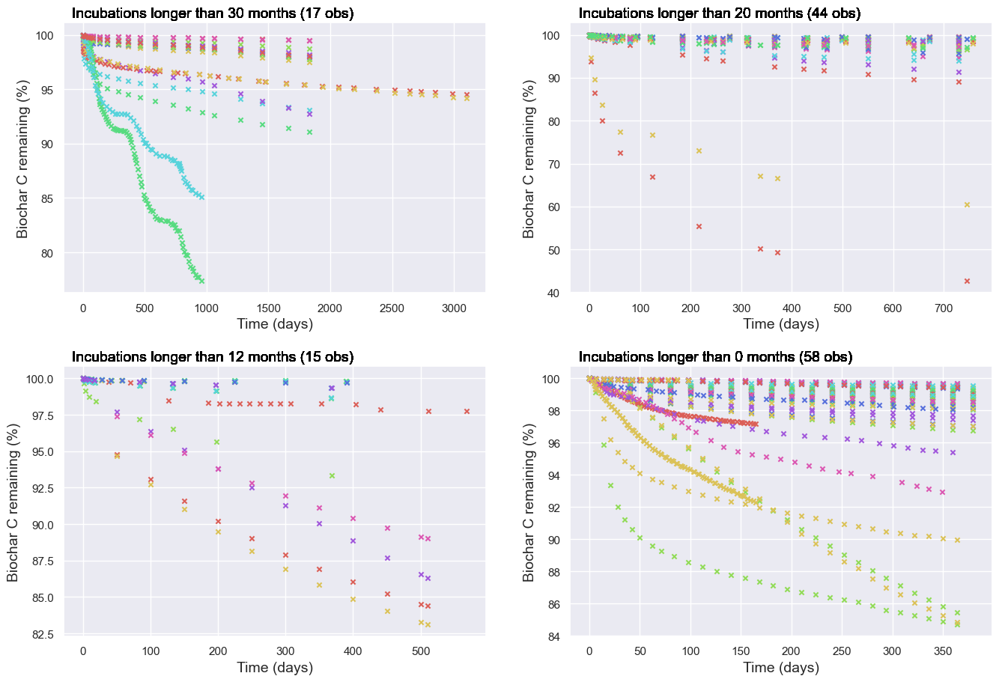

In [6]:
fig, axes, axl = bs.plot_timeseries_by_group(data, metadata, sets_incubations, 'C_bc_rem_rel', titles=sets_labels,
                                             ylabel="Biochar C remaining (%)", factor=100,
                                             saveFig=False)

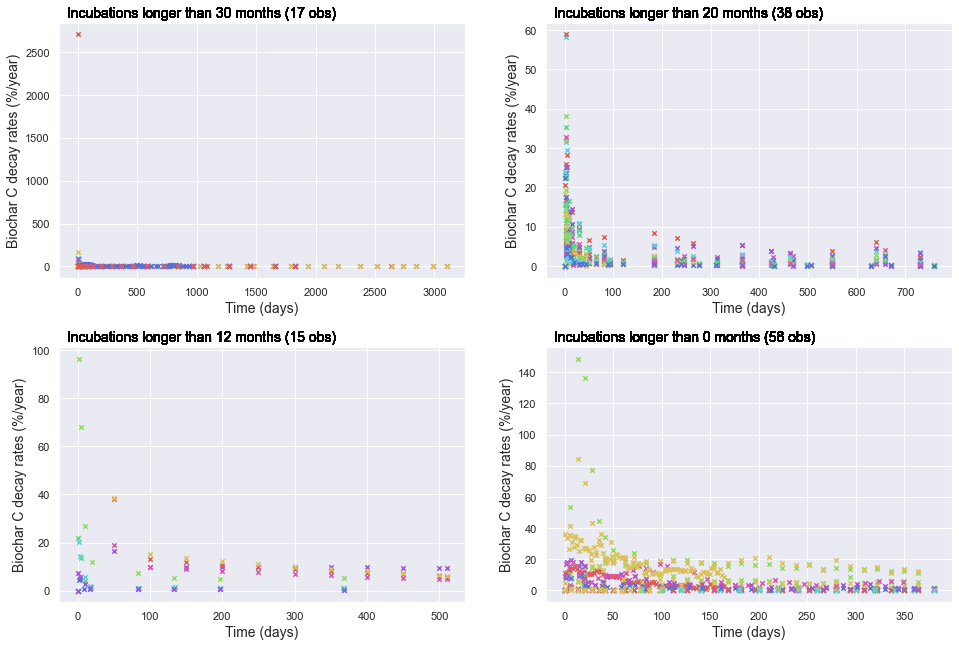

In [8]:
fig, axes, axl = bs.plot_timeseries_by_group(data, metadata, sets_incubations, 'k_bc_reld', titles=sets_labels,
                                             ylabel="Biochar C decay rates (%/year)", factor=100*365.25,
                                             saveFig=False)

## Testing: Analyse.py (fit a single observation, with one strategy)

In [64]:
x, y = bs.select_timeseries(23, data, 'C_bc_rem_rel', factor=100)

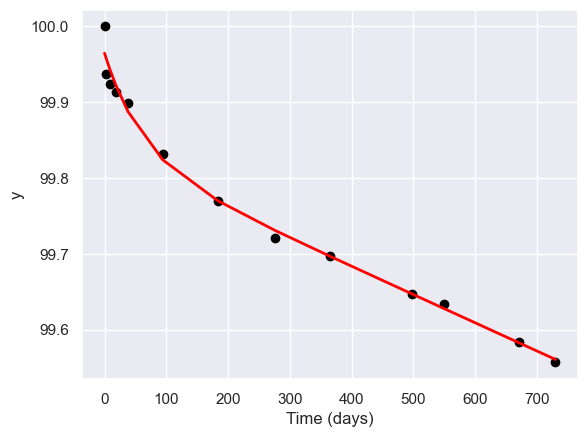

[[Fit Statistics]]
    # data points:  13
    # variables:  4
    chi-square:  0.00242315475976115
    reduced chi-square:  0.0002692394177512389
    Akaike info crit:  -103.63924623167587
    Bayesian info crit:  -101.37944880182972
[[Variables]]
    k1: 3.7372125863072e-06 +/- 3.932075292827605e-07 (10.521411886587249 %)
    k2: 0.01702672744017094 +/- 0.006855074787920536 (40.26067141796988 %)
    c1: 99.8325848053546 +/- 0.02082638225203369 (0.020861307250172142 %)
    c2: 0.13211619428191118 +/- 0.021257925365481878 (16.09032524818377 %)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.9487241818727303
    C(c1, c2) = -0.8689052836335005
    C(k1, c2) = -0.8315539133471557
    C(k2, c1) = 0.743677026050628
    C(k1, k2) = 0.6784763939125745
    C(k2, c2) = -0.46369853468388395


In [67]:
p_opt, p_cov, p_std, r2, _, _, _= bs.do_the_fit(f_model=bs.doubleExp_u, xdata=x, ydata=y,
                                              p0=[0.0001, 0.1, 100, 50], method='trf', bounds=(-np.Inf,np.Inf), showPlot=True)

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 954
    # data points      = 13
    # variables        = 5
    chi-square         = 3.0608e-04
    reduced chi-square = 3.8259e-05
    Akaike info crit   = -128.536163
    Bayesian info crit = -125.711417
[[Variables]]
    k1:  0.01025185 +/- 0.00126561 (12.35%) (init = 0)
    k2:  7.54404186 +/- 229872.455 (3047072.90%) (init = 0)
    k3:  3.5077e-06 +/- 5.3618e-08 (1.53%) (init = 0)
    c1:  0.12380582 +/- 0.00551228 (4.45%) (init = 0)
    c2:  0.05796690 +/- 0.00432608 (7.46%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.668
    C(k1, c2) = -0.548
    C(k3, c1) = -0.505
    C(k1, k3) = 0.302


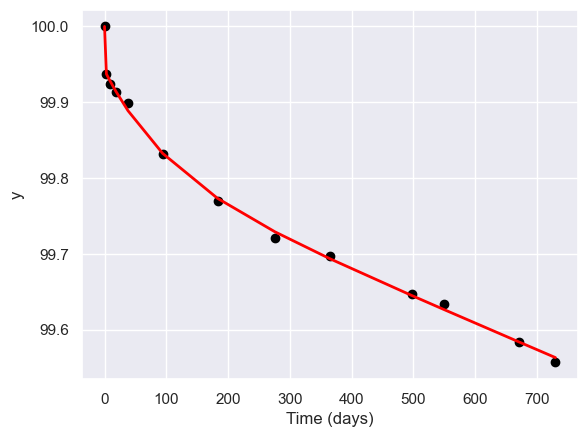

In [68]:
_ = bs.do_the_lmfit(f_model=bs.tripleExp,
               xdata=x, ydata=y, method='trf', bounds=(0,1000), showPlot=True)

### scipy.curve_fit with bounds

In [47]:
x, y = bs.select_timeseries(9, data, 'C_bc_rem_rel', factor=100)

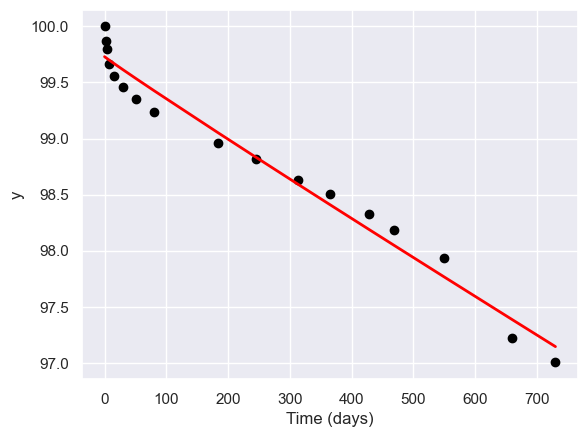

[[Fit Statistics]]
    # data points:  17
    # variables:  3
    chi-square:  0.3460004650059976
    reduced chi-square:  0.02471431892899983
    Akaike info crit:  -60.20698456857056
    Bayesian info crit:  -57.70734453640191
[[Variables]]
    c0: 99.73045697331155 +/- 0.07030917468992268 (0.07049920036838679 %)
    b: -10.078126606760785 +/- 0.6027200869850414 (-5.980477429016561 %)
    m: -0.029941117502522773 +/- 0.10993949648135815 (-367.1856819375392 %)
[[Correlations]] (unreported correlations are < 0.100)
    C(b, m) = -0.9973569962414237
    C(c0, b) = 0.6727897793333604
    C(c0, m) = -0.6348247400139153


In [49]:
p0_power = [100, 7, 0]
p_opt, p_cov, p_std, r2, _, _, _= bs.do_the_fit(f_model=bs.powerModel, xdata=x, ydata=y,
                                                p0=p0_power, method='trf', bounds= (-np.Inf, 100.0001),
                                                showPlot=True)

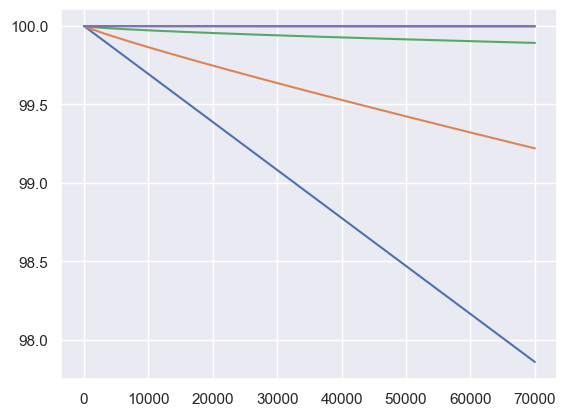

In [81]:
%matplotlib inline
TH = np.arange(0, 70000, 1)
PW = bs.powerModel(TH, 100, -15, -0.0)
plt.plot(TH, PW)
PW = bs.powerModel(TH, 100, -15, -0.1)
plt.plot(TH, PW)
PW = bs.powerModel(TH, 100, -15, -0.3)
plt.plot(TH, PW)
PW = bs.powerModel(TH, 100, -15, -0.7)
plt.plot(TH, PW)
PW = bs.powerModel(TH, 100, -15, -1.0)
plt.plot(TH, PW)

In [28]:
_ = bs.do_the_lmfit(f_model=bs.powerModel,
               xdata=x, ydata=y, method='trf', bounds=(-1,100), showPlot=True)

ValueError: NaN values detected in your input data or the output of your objective/model function - fitting algorithms cannot handle this! Please read https://lmfit.github.io/lmfit-py/faq.html#i-get-errors-from-nan-in-my-fit-what-can-i-do for more information.

C:\github\biocharStability\biocharStability\analyse.py:312: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


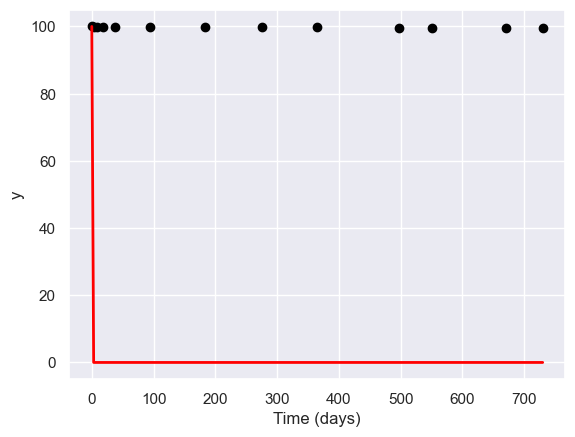

[[Fit Statistics]]
    # data points:  13
    # variables:  6
    chi-square:  119423.84752884829
    reduced chi-square:  17060.54964697833
    Akaike info crit:  130.63130279758442
    Bayesian info crit:  134.02099894235366
[[Variables]]
    k1: 50.0 +/- 0.0 (0.0 %)
    k2: 50.00031143098673 +/- 0.0 (0.0 %)
    k3: 62.53572159115294 +/- 0.0 (0.0 %)
    c1: 33.33333410775934 +/- 43.538679670403845 (130.61603597663787 %)
    c2: 33.33333410775762 +/- 43.538679670403845 (130.6160359766446 %)
    c3: 33.333334107758375 +/- 43.538679670403845 (130.61603597664165 %)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = 0.9999999999999999
    C(c1, c3) = 0.9999999999999999
    C(c1, c2) = 0.9999999999999999


C:\github\biocharStability\biocharStability\analyse.py:240: RuntimeWarning: invalid value encountered in double_scalars
  corr = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


In [71]:
p_opt, p_cov, p_std, r2, _, _, _= bs.do_the_fit(f_model=bs.tripleExp_u, xdata=x, ydata=y,
                                                p0=None, method='trf', 
                                                bounds=([0, 0, 0,  0, 0, 0], [100, 100, 100,  100, 100, 100]),
                                                showPlot=True)

C:\github\biocharStability\biocharStability\analyse.py:312: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


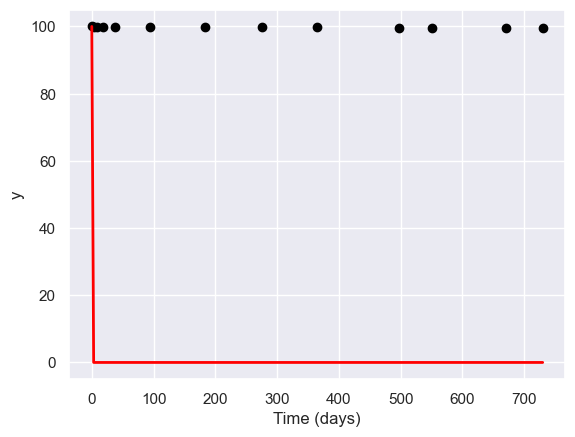

[[Fit Statistics]]
    # data points:  13
    # variables:  6
    chi-square:  119423.84752884829
    reduced chi-square:  17060.54964697833
    Akaike info crit:  130.63130279758442
    Bayesian info crit:  134.02099894235366
[[Variables]]
    k1: 50.0 +/- 0.0 (0.0 %)
    k2: 76.64165813844161 +/- 0.0 (0.0 %)
    k3: 33.36734351496846 +/- 0.0 (0.0 %)
    c1: 33.33333410775852 +/- 43.538679670403845 (130.61603597664111 %)
    c2: 33.3333341077584 +/- 43.538679670403845 (130.61603597664157 %)
    c3: 33.33333410775843 +/- 43.538679670403845 (130.61603597664146 %)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = 0.9999999999999999
    C(c1, c3) = 0.9999999999999999
    C(c1, c2) = 0.9999999999999999


C:\github\biocharStability\biocharStability\analyse.py:240: RuntimeWarning: invalid value encountered in double_scalars
  corr = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


In [72]:
p_opt, p_cov, p_std, r2, _, _, _= bs.do_the_fit(f_model=bs.tripleExp_u, xdata=x, ydata=y,
                                                p0=None, method='trf', 
                                                bounds=([0, 0,0, 0, 0, 0], [100, 101, 102,  100, 100, 100]),
                                                showPlot=True)

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


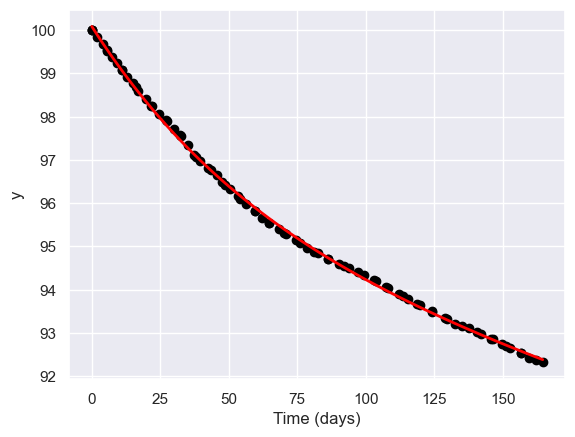

[[Fit Statistics]]
    # data points:  85
    # variables:  4
    chi-square:  0.3161522144132449
    reduced chi-square:  0.003903113758188209
    Akaike info crit:  -467.505533467829
    Bayesian info crit:  -457.73492844186774
[[Variables]]
    k1: 0.00020937489467477558 +/- 1.9868129288378093e-05 (9.489260553056987 %)
    k2: 0.016637940546480066 +/- 0.0012451754230008074 (7.4839516316473285 %)
    c1: 95.30466667733299 +/- 0.383403088966585 (0.4022920412330371 %)
    c2: 4.782809934838003 +/- 0.3720720779850228 (7.77936156891472 %)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.9984836523927519
    C(k1, c2) = -0.9972054159964955
    C(k1, c1) = 0.9969166358616581
    C(k2, c1) = 0.9870561278494204
    C(k2, c2) = -0.9794750712770861
    C(k1, k2) = 0.9736435238567941


In [14]:
p_opt, p_cov, p_std, r2, _, _, _= bs.do_the_fit(f_model=bs.doubleExp_u, xdata=x, ydata=y,
                                                p0=None, method='trf', 
                                                bounds=([0, 0,  0, 0], [100, 101,  100, 100]),
                                                showPlot=True)

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


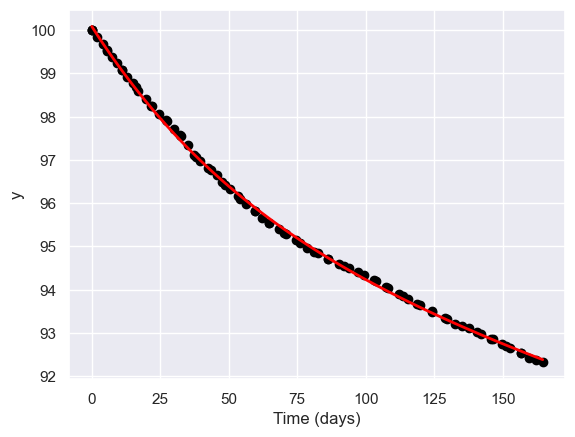

[[Fit Statistics]]
    # data points:  85
    # variables:  4
    chi-square:  0.3161522143819674
    reduced chi-square:  0.0039031137578020665
    Akaike info crit:  -467.50553347623827
    Bayesian info crit:  -457.734928450277
[[Variables]]
    k1: 0.00020937079222164656 +/- 1.986871834101553e-05 (9.48972783175118 %)
    k2: 0.01663767658859146 +/- 0.0012451716706516163 (7.48404781173254 %)
    c1: 95.30458642779865 +/- 0.3834177568456789 (0.4023077705039417 %)
    c2: 4.782887215902468 +/- 0.37208670821271167 (7.779541758283 %)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.9984837805097159
    C(k1, c2) = -0.9972055472849162
    C(k1, c1) = 0.9969167230564414
    C(k2, c1) = 0.9870566142990271
    C(k2, c2) = -0.9794760469217405
    C(k1, k2) = 0.9736443710751663


In [15]:
p_opt, p_cov, p_std, r2, _, _, _= bs.do_the_fit(f_model=bs.doubleExp_u, xdata=x, ydata=y,
                                                p0=None, method='trf', 
                                                bounds=([0, 0,  0, 0], [100, 110,  100, 100]),
                                                showPlot=True)

In [21]:
p_opt, p_cov, infodict, mesg, ier = bs.do_the_fit(f_model=bs.doubleExp_u, xdata=x, ydata=y,
                                                p0=None, method='trf', 
                                                bounds=([0, 0,  0, 0], [100, 110,  100, 100]),
                                                showPlot=True, full_output=True, maxfev=None)
print(p_opt)
ier, mesg, infodict['nfev']

[2.09370792e-04 1.66376766e-02 9.53045864e+01 4.78288722e+00]


(2, '`ftol` termination condition is satisfied.', 48)

In [22]:
p_opt, p_cov, infodict, mesg, ier = bs.do_the_fit(f_model=bs.doubleExp_u, xdata=x, ydata=y,
                                                p0=None, method='trf', 
                                                bounds=([0, 0,  0, 0], [1000, 1000,  1000, 1000]),
                                                showPlot=True, full_output=True, maxfev=None)
print(p_opt)
ier, mesg, infodict['nfev']

[500.         915.52040801  50.          50.        ]


(1, '`gtol` termination condition is satisfied.', 9)

In [17]:
bs.do_the_fit(f_model=bs.doubleExp_u, xdata=x, ydata=y,
                                                p0=None, method='trf', 
                                                showPlot=True, full_output=True, maxfev=5000)

Optimal parameters not found: The maximum number of function evaluations is exceeded.


([], [], [], [], [], [], {})

In [24]:
from scipy.optimize import curve_fit

In [32]:
p_opt, p_cov, infodict, mesg, ier = curve_fit(f=bs.doubleExp_u, xdata=x, ydata=y, 
                     p0=[1, 1, 1, 1], sigma=None, method='trf', bounds=([0, 0,  0, 0], [1000, 1000,  1000, 1000]),
                     full_output=True, maxfev=5000, gtol=None, xtol=None)
                     # sigma=ydata*0.05 ## to add noise/error on ydata
print(p_opt)
ier, mesg, infodict['nfev']

[2.09370743e-04 1.66376738e-02 9.53045855e+01 4.78288813e+00]


(2, '`ftol` termination condition is satisfied.', 80)

In [39]:
p_opt, p_cov, infodict, mesg, ier = curve_fit(f=bs.doubleExp_u, xdata=x, ydata=y, 
                     p0=[0.1, 1, 80, 1], sigma=None, method='trf',
                     full_output=True, maxfev=10000, )#gtol=None, xtol=None)
                     # sigma=ydata*0.05 ## to add noise/error on ydata
print(p_opt)
ier, mesg, infodict['nfev']

[1.66378988e-02 2.09374242e-04 4.78282223e+00 9.53046539e+01]


(2, '`ftol` termination condition is satisfied.', 7518)

From scipy.least_squares 

https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.least_squares.html

The reason for algorithm termination:

-1 : improper input parameters status returned from MINPACK.

0 : the maximum number of function evaluations is exceeded.

1 : gtol termination condition is satisfied. >>> gradient change 

2 : ftol termination condition is satisfied. >>> cost function change

3 : xtol termination condition is satisfied. >>> change of the independent variables

4 : Both ftol and xtol termination conditions are satisfied.

### Decay rate / Michaelis-Menten

In [118]:
def MichaelisMenten(t, A, B):
    '''
    Michaelis-Menten function
    '''
    return A*t/(B+t)

def MM_decay(t, A, B):
    '''
    Calculate the decay rates, from the log-fitted relationship ln(K) = A*t/(B+t)
    '''
    return np.exp(MichaelisMenten(t, A, B))

def MM_BC_loss(t, A, B):
    '''
    Calculates cumulative loss of biochar, via MM decay rate fitted equation. 
    No explicit integral. Need to make a loop, with small enough step.
    t, list, in days
    '''
    BC_loss = np.zeros(len(t))
    BC_loss[0] = MM_decay(t[0], A, B)*(t[0] - 0)
    for i, _ in enumerate(t):
        if i+1 < len(t):
            BC_loss[i+1] = BC_loss[i] + MM_decay(t[i+1], A, B)*(t[i+1] - t[i])
    return BC_loss


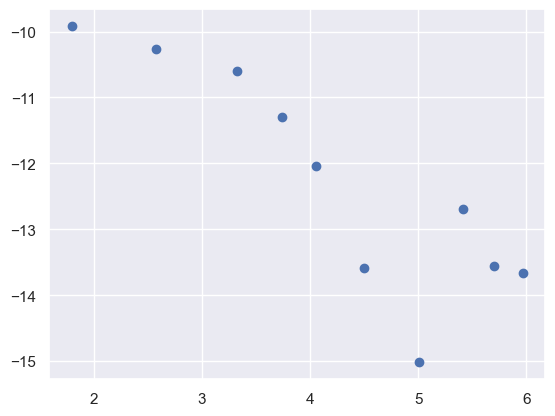

In [138]:
x, y = bs.select_timeseries(5, data, 'k_bc_rel0', factor=1)
plt.scatter(np.log(x[1:]), np.log(y[1:]))

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


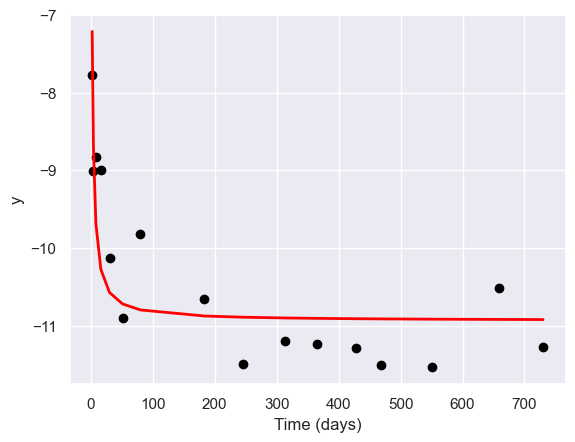

[[Fit Statistics]]
    # data points:  16
    # variables:  2
    chi-square:  5.740822342563471
    reduced chi-square:  0.41005873875453364
    Akaike info crit:  -12.399780110637323
    Bayesian info crit:  -10.85460266615776
[[Variables]]
    A: -10.936800989916515 +/- 0.18684017635410674 (-1.7083622215158638 %)
    B: 1.031985096118934 +/- 0.22159195401998763 (21.472398666739043 %)
[[Correlations]] (unreported correlations are < 0.100)
    C(A, B) = -0.43917805839631024


In [132]:
start = 1
p_opt, p_cov, p_std, r2, _, _, _= bs.do_the_fit(f_model=MichaelisMenten, xdata=x[start:], ydata=np.log(y[start:]),
                                                p0=(-15, 0.5), method='trf',
                                                showPlot=True)

In [88]:
TH = np.arange(3, 100*365,1)
A = -12.33
B = 1.405
print("Basal decay rate, k_b = ", np.exp(A)*100, "%C_ini/day",np.exp(A)*365*100, "%C_ini/year" )
MM_K = [MM_decay(T, A, B) for T in TH]
MM_BC = MM_BC_loss(TH, A, B)

Basal decay rate, k_b =  0.0004417220084053277 %C_ini/day 0.1612285330679446 %C_ini/year


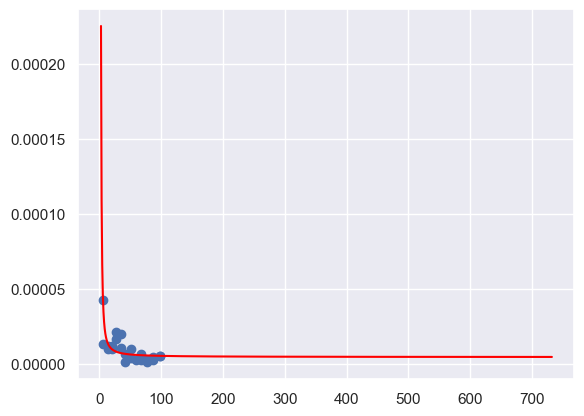

In [89]:
plt.scatter(x[1:], y[1:])
plt.plot(TH[0:730], MM_K[0:730], color='red')

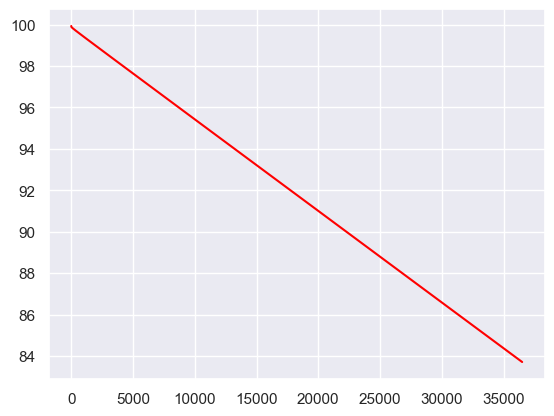

In [90]:
N=100
plt.plot(TH[0:730*N], 100-MM_BC[0:730*N]*100, color='red')

## Testing: Analyse.py (fit all observations, with all strategies)

In [88]:
fitting_strategies = [
    # single exp, 100% at t0
    (bs.singleExp, 'lm',  None, ( (-1*np.inf), (np.inf) ) ), 
    (bs.singleExp, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(singleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
    
    # single exp, unconstrained
    (bs.singleExp_u, 'lm', None, ( (-1*np.inf), (np.inf) ) ),
    (bs.singleExp_u, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(singleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
        # with bounds
        #(singleExp_u, 'trf',    ( [0, 0], [1000, 100] ) ), # 0 < k < 1000,  0< c <100
        #(singleExp_u, 'trf',    ( (0, 0), (50, 100) ) ), # 0 < k < 50,  0< c <100
    
    # double exp, 100% at t0
    (bs.doubleExp, 'lm', None, ( (-1*np.inf), (np.inf) ) ),
    (bs.doubleExp, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(doubleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
        # with bounds
        #(doubleExp, 'trf',    ( (0, 0, 0), (1000, 1000, 100) ) ), # 0 < k1 < 1000, 0 < k2 < 1000,  0< c1 <100
        #(doubleExp, 'trf',    ( (0, 0, 0), (50, 1, 100) ) ), # 0 < k1 < 50, 0 < k2 < 1,  0< c1 <100
        # with p0
        (bs.doubleExp, 'lm', [0.000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'lm', [0.00000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'lm', [0.00001, 10, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'lm', [0.0001, 1, 100], ( (-1*np.inf), (np.inf) ) ),

        (bs.doubleExp, 'trf', [0.000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'trf', [0.00000001, 0.001, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'trf', [0.00001, 10, 100], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp, 'trf', [0.0001, 1, 100], ( (-1*np.inf), (np.inf) ) ),
        
    # double exp, unconstrained
    (bs.doubleExp_u, 'lm', None, ( (-1*np.inf), (np.inf) ) ),
    (bs.doubleExp_u, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(doubleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
        # with p0
        (bs.doubleExp_u, 'lm', [0.000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'lm', [0.00000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'lm', [0.00001, 10, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'lm', [0.0001, 1, 100, 1], ( (-1*np.inf), (np.inf) ) ),

        (bs.doubleExp_u, 'trf', [0.000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'trf', [0.00000001, 0.001, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'trf', [0.00001, 10, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.doubleExp_u, 'trf', [0.0001, 1, 100, 1], ( (-1*np.inf), (np.inf) ) ),
        
    # triple exp, 100% at t0
    (bs.tripleExp, 'lm',  None, ( (-1*np.inf), (np.inf) ) ),
    (bs.tripleExp, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(tripleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
          # with p0
        (bs.tripleExp, 'lm',  [0.000001, 0.001, 0.1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'lm',  [0.000001, 0.001, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'lm',  [0.00000001, 0.00001, 0.001, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'lm',  [0.001, 0.1, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
    
        (bs.tripleExp, 'trf',  [0.000001, 0.001, 0.1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'trf',  [0.000001, 0.001, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'trf',  [0.00000001, 0.00001, 0.001, 100, 50], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp, 'trf',  [0.001, 0.1, 1, 100, 50], ( (-1*np.inf), (np.inf) ) ),
          
    # triple exp, unconstrained
    (bs.tripleExp_u, 'lm',  None, ( (-1*np.inf), (np.inf) ) ),
    (bs.tripleExp_u, 'trf', None, ( (-1*np.inf), (np.inf) ) ),
    #(tripleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
          # with p0
        (bs.tripleExp_u, 'lm',  [0.000001, 0.001, 0.1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'lm',  [0.000001, 0.001, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'lm',  [0.00000001, 0.00001, 0.001, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'lm',  [0.001, 0.1, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
    
        (bs.tripleExp_u, 'trf',  [0.000001, 0.001, 0.1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'trf',  [0.000001, 0.001, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'trf',  [0.00000001, 0.00001, 0.001, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
        (bs.tripleExp_u, 'trf',  [0.001, 0.1, 1, 100, 50, 1], ( (-1*np.inf), (np.inf) ) ),
    
    
    # power model (infinite pool)
    (bs.powerModel, 'lm',  None, ( (-1*np.inf), (np.inf) ) ),
    (bs.powerModel, 'trf',  None, ( (-1*np.inf), (np.inf) ) ),
    #(powerModel, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
]


In [11]:
# fit all observations, according to selected fitting strategies, using scipy library
df_scipy_fits = bs.fit_all_observations(data, metadata, fitting_strategies=fitting_strategies,
                                        library ='scipy', excel='scipy_allfits_p0.xlsx')

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A

C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  retur

21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:308: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each para

41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: Runt

26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%'

21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, 

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: Run

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( n

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharSt

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1]

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: Run

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('co

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bioc

21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exce

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: Run

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( n

40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05,

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\a

38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharSt

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp a

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarnin

11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharSt

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf,

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( n

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-in

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\bioch

40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60>

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarnin

29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.lo

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharSt

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
16 lm <function doubleExp_u 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\a

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( n

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarnin

44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: O

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\bioc

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: Run

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: Optim

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%'

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnin

39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\bioc

3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
16 lm <function doubleExp_u 

C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning

30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( n

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.00

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( n

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( n

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: Run

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is excee

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: Run

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: Run

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarnin

4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <fun

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\bioc

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\gi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:308: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:358: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation'

20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optim

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleEx

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encount

32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940>

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE19820>

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 120

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encount

Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE1994

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anacon

42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: Ru

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleEx

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: over

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf,

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\bioc

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability

19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <fun

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten itera

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, i

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:308: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\g

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib

Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.00

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\bioch

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*n

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 1

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\b

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u a

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_

20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optim

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt

34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number o

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.


C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, i

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <fun

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001,

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\bioch

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib

1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0

C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: inv

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.l

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.p

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2

26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006D

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bioc

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <fun

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function doubleExp at 

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal par

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\bioch

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp a

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib

11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:308: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each para

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\

17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <fun

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-

31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,

32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:308: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:358: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.s

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <func

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  retur

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:308: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:358: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.00

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to fun

C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:308: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:358: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStabili

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measur

30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_mat

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not m

Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-in

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 l

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\g

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anacon

Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could n

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) *

31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.w

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\a

36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleEx

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could n

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\g

36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleEx

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\g

36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7C

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_ma

22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, in

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlati

34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / (

41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\bioch

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3

40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60>

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encount

21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, 

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\bioch

31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x0000020

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp


21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
3

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\bioch

31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal para

C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] 

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\bioc

44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-

C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflo

21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exce

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\en

41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analy

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt

34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <functio

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
O

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:308: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:358: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\anaconda\

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-in

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x0000

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x000002

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u 

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function 

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.


C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)


8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStabilit

Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maxi

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-in

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarni

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: Ru

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the

42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStab

28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluatio

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.

Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharSt

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, a

7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_mat

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations i

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <fun

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\li

Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  im

Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\b

40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\

21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  f

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:

37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sq

Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleEx

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, i

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleEx

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStabili

26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting

39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: Optimize

Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to functio

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not fou

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_

Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
Optimal parameters not found: Number of calls 

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <functi

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarni

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x00000

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_m

Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: over

41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function dou

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np

30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarni

12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iteratio

22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: inva

38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: Th

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocha

18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement

26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u

C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:308: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:358: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\github\bi

44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-in

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStabili

Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to fu

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*n

Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStabili

28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function h

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
17 lm <function doubleExp_u at 0x000002006DE1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow e

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarnin

44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStabili

32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\bi

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarnin

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encount

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 tr

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated


21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
3

C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p

Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_ou

Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations

21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
3

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: Runt

Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf,

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:296: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:297: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:308: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each para

Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u a

C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\gi

22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-in

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the pa

41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.00

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t

10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: 

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site

43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.00

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\gi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, i

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
8 lm <function doubleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github

Optimal parameters not found: The maximum number of function evaluations is exceeded.
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )


Optimal parameters not found: The maximum number of function evaluations is exceeded.
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:303: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github

In [20]:
# fit all observations, according to selected fitting strategies, using lmfit library
df_lmfit_fits = bs.fit_all_observations(data, metadata, fitting_strategies=fitting_strategies,
                                        library ='lmfit', excel='lmfit_allfits.xlsx')

0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 20
    # variables        = 1
    chi-square         = 3.48702623
    reduced chi-square = 0.18352770
    Akaike info crit   = -32.9336597
    Bayesian info crit = -31.9379274
[[Variables]]
    k:  5.3083e-05 +/- 3.3490e-06 (6.31%) (init = 0)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 20
    # variables        = 1
    chi-square         = 3.48702623
    reduced chi-square = 0.18352770
    Akaike info crit   = -32.9336597
    Bayesian info crit = -31.9379274
[[Variables]]
    k:  5.3083e-05 +/- 3.3490e-06 (6.31%) (init = 0)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 84
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 287
    # data points      = 20
    # variables        = 4
    chi-square         = 2.08361327
    reduced chi-square = 0.13022583
    Akaike info crit   = -37.2325747
    Bayesian info crit = -33.2496456
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.8041e-05 +/- 4.9081e-06 (12.90%) (init = 0)
    k2:  4.45128344 +/-        nan (nan%) (init = 0)
    c1:  99.4823827 +/- 0.14673728 (0.15%) (init = 0)
    c2:  0.52345343 +/- 0.38692628 (73.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.822
    C(c1, c2) = -0.374
    C(k1, c2) = -0.308
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 287
    # data points      = 20
    # variables        = 4
    chi-square         = 2.08361327
    reduced chi-square = 0.13022583
    Akaike

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 469
    # data points      = 20
    # variables        = 5
    chi-square         = 0.63381714
    reduced chi-square = 0.04225448
    Akaike info crit   = -59.0345413
    Bayesian info crit = -54.0558799
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3647e-06 +/- 0.01193395 (127435.16%) (init = 0)
    k2:  0.00729679 +/- 0.00164347 (22.52%) (init = 0)
    k3:  6.8416e-06 +/- 2.1740e-06 (31.78%) (init = 0)
    c1:  0.00644426 +/-        nan (nan%) (init = 0)
    c2:  1.81383301 +/- 0.19597607 (10.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.108
    C(k1, c2) = -0.964
    C(k2, c2) = -0.809
    C(k3, c2) = -0.747
    C(k1, k2) = 0.501
    C(k2, k3) = 0.388
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 469
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 469
    # data points      = 20
    # variables        = 5
    chi-square         = 0.63381714
    reduced chi-square = 0.04225448
    Akaike info crit   = -59.0345413
    Bayesian info crit = -54.0558799
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3647e-06 +/- 0.01193395 (127435.16%) (init = 0)
    k2:  0.00729679 +/- 0.00164347 (22.52%) (init = 0)
    k3:  6.8416e-06 +/- 2.1740e-06 (31.78%) (init = 0)
    c1:  0.00644426 +/-        nan (nan%) (init = 0)
    c2:  1.81383301 +/- 0.19597607 (10.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.108
    C(k1, c2) = -0.964
    C(k2, c2) = -0.809
    C(k3, c2) = -0.747
    C(k1, k2) = 0.501
    C(k2, k3) = 0.388
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 469
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 576
    # data points      = 20
    # variables        = 6
    chi-square         = 2.07944691
    reduced chi-square = 0.14853192
    Akaike info crit   = -33.2726065
    Bayesian info crit = -27.2982128
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  5.6419e-05 (init = 0)
    k2:  3.7868e-09 (init = 0)
    k3:  61.4233234 (init = 0)
    c1:  67.6359529 (init = 0)
    c2:  31.8517949 (init = 0)
    c3:  0.50591761 (init = 0)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 576
    # data points      = 20
    # variables        = 6
    chi-square         = 2.07944691
    reduced chi-square = 0.14853192
    Akaike info crit   = -33.2726065
    Bayesian info crit = -27.2982128
##  Warning: uncertainties could not be estimated:
    k2:  at 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 20
    # variables        = 2
    chi-square         = 0.24899864
    reduced chi-square = 0.01383326
    Akaike info crit   = -83.7208025
    Bayesian info crit = -81.7293380
[[Variables]]
    k:  3.5091e-05 +/- 2.0707e-06 (5.90%) (init = 0)
    c:  99.6133255 +/- 0.04707488 (0.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.827
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 20
    # variables        = 3
    chi-square         = 0.06616612
    reduced chi-square = 0.00389212
    Akaike info crit   = -108.226379
    Bayesian info crit = -105.239182
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.73246787 +/-        nan (nan%) (init = 0)
    k2:  3.1700e-05 +/- 1.1538e-06 (3.64%) (init = 0

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 20
    # variables        = 4
    chi-square         = 0.06616342
    reduced chi-square = 0.00413521
    Akaike info crit   = -106.227195
    Bayesian info crit = -102.244266
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.1720e-05 (init = 0)
    k2:  3.98706508 (init = 0)
    c1:  99.5258453 (init = 0)
    c2:  0.47050411 (init = 0)
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 20
    # variables        = 4
    chi-square         = 0.06616342
    reduced chi-square = 0.00413521
    Akaike info crit   = -106.227195
    Bayesian info crit = -102.244266
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.1720e-05 (init = 0)
    k2:  3.98706508 (init = 0)
    c1:  99.5258453 (init = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 20
    # variables        = 5
    chi-square         = 2.5497e-04
    reduced chi-square = 1.6998e-05
    Akaike info crit   = -215.402063
    Bayesian info crit = -210.423402
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.23917043 +/-        nan (nan%) (init = 0)
    k2:  0.01223218 +/- 2.7908e-04 (2.28%) (init = 0)
    k3:  2.1909e-05 +/- 1.2259e-07 (0.56%) (init = 0)
    c1:  0.21873260 +/- 0.00609589 (2.79%) (init = 0)
    c2:  0.55514049 +/- 0.00628082 (1.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.762
    C(c1, c2) = -0.691
    C(k2, k3) = 0.532
    C(k3, c2) = -0.522
    C(k3, c1) = -0.187
    C(k2, c2) = 0.150
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data p

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 687
    # data points      = 20
    # variables        = 6
    chi-square         = 0.05830112
    reduced chi-square = 0.00416437
    Akaike info crit   = -104.757324
    Bayesian info crit = -98.7829308
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.1425e-05 (init = 0)
    k2:  0.09446643 (init = 0)
    k3:  31.1109048 (init = 0)
    c1:  99.5176589 (init = 0)
    c2:  0.16117166 (init = 0)
    c3:  0.32685400 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 687
    # data points      = 20
    # variables        = 6
    chi-square         = 0.05830112
    reduced chi-square = 0.00416437
    Akaike info crit   = -104.757324
    Bayesian info crit = -98.7829308
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.1425e-05 (init = 0)
    k2:  0.0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 20
    # variables        = 3
    chi-square         = 0.02286830
    reduced chi-square = 0.00134519
    Akaike info crit   = -129.474722
    Bayesian info crit = -126.487525
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.36865077 +/-        nan (nan%) (init = 0)
    k2:  1.8142e-05 +/- 6.1750e-07 (3.40%) (init = 0)
    c1:  0.28286815 +/- 0.01489209 (5.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.824
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 20
    # variables        = 3
    chi-square         = 0.02286830
    reduced chi-square = 0.00134519
    Akaike info crit   = -129.474722
    Bayesian info crit = -126.487525
##  Warning: uncertainties could not be estim

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 20
    # variables        = 5
    chi-square         = 0.00264173
    reduced chi-square = 1.7612e-04
    Akaike info crit   = -168.641052
    Bayesian info crit = -163.662391
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02929048 +/- 0.00207530 (7.09%) (init = 0)
    k2:  0.01505613 +/-        nan (nan%) (init = 0)
    k3:  1.5049e-05 +/- 2.8262e-07 (1.88%) (init = 0)
    c1:  0.36416769 +/- 0.01014609 (2.79%) (init = 0)
    c2:  0.00482357 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.868
    C(k1, k3) = 0.692
    C(k1, c1) = -0.167
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 196
    # data points      = 20
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 568
    # data points      = 20
    # variables        = 6
    chi-square         = 0.02290166
    reduced chi-square = 0.00163583
    Akaike info crit   = -123.445567
    Bayesian info crit = -117.471173
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8139e-05 (init = 0)
    k2:  14.4625381 (init = 0)
    k3:  0.54673094 (init = 0)
    c1:  99.7169787 (init = 0)
    c2:  0.26372614 (init = 0)
    c3:  0.01840431 (init = 0)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 568
    # data points      = 20
    # variables        = 6
    chi-square         = 0.02290166
    reduced chi-square = 0.00163583
    Akaike info crit   = -123.445567
    Bayesian info crit = -117.471173
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8139

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 102
    # data points      = 20
    # variables        = 3
    chi-square         = 0.02460524
    reduced chi-square = 0.00144737
    Akaike info crit   = -128.010561
    Bayesian info crit = -125.023364
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.60161874 +/-        nan (nan%) (init = 0)
    k2:  1.6482e-05 +/- 6.2873e-07 (3.81%) (init = 0)
    c1:  0.33290651 +/- 0.01525074 (4.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.819
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 102
    # data points      = 20
    # variables        = 3
    chi-square         = 0.02460524
    reduced chi-square = 0.00144737
    Akaike info crit   = -128.010561
    Bayesian info crit = -125.023364
##  Warning: uncertainties could not be estimat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 20
    # variables        = 4
    chi-square         = 0.02460639
    reduced chi-square = 0.00153790
    Akaike info crit   = -126.009630
    Bayesian info crit = -122.026701
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6483e-05 (init = 0)
    k2:  15.4035428 (init = 0)
    c1:  99.6668544 (init = 0)
    c2:  0.33613442 (init = 0)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 20
    # variables        = 4
    chi-square         = 0.02460639
    reduced chi-square = 0.00153790
    Akaike info crit   = -126.009630
    Bayesian info crit = -122.026701
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6483e-05 (init = 0)
    k2:  15.4035428 (init = 0)
    c1:  99.6668544 (init

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 20
    # variables        = 5
    chi-square         = 1.0478e-04
    reduced chi-square = 6.9854e-06
    Akaike info crit   = -233.187302
    Bayesian info crit = -228.208641
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01309153 +/- 2.9914e-04 (2.28%) (init = 0)
    k2:  0.40850009 +/-        nan (nan%) (init = 0)
    k3:  1.0877e-05 +/- 5.5329e-08 (0.51%) (init = 0)
    c1:  0.33013952 +/- 0.00387770 (1.17%) (init = 0)
    c2:  0.17223646 +/- 0.00405370 (2.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.834
    C(k1, c2) = -0.780
    C(k1, k3) = 0.417
    C(k1, c1) = 0.391
    C(k3, c1) = -0.349
    C(k3, c2) = -0.145
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 554
    # data points      = 20
    # variables        = 6
    chi-square         = 0.02460545
    reduced chi-square = 0.00175753
    Akaike info crit   = -122.010392
    Bayesian info crit = -116.035998
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6481e-05 (init = 0)
    k2:  180.210307 (init = 0)
    k3:  250.080942 (init = 0)
    c1:  99.6669641 (init = 0)
    c2:  0.33282201 (init = 0)
    c3:  2.3110e-04 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 554
    # data points      = 20
    # variables        = 6
    chi-square         = 0.02460545
    reduced chi-square = 0.00175753
    Akaike info crit   = -122.010392
    Bayesian info crit = -116.035998
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6481e-05 (init = 0)
    k2:  180

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 140
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03341923
    reduced chi-square = 0.00196584
    Akaike info crit   = -121.887122
    Bayesian info crit = -118.899925
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.13874680 +/-        nan (nan%) (init = 0)
    k2:  2.6796e-05 +/- 7.9818e-07 (2.98%) (init = 0)
    c1:  0.29732155 +/- 0.01884955 (6.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.840
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 140
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03341923
    reduced chi-square = 0.00196584
    Akaike info crit   = -121.887122
    Bayesian info crit = -118.899925
##  Warning: uncertainties could not be estim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 430
    # data points      = 20
    # variables        = 5
    chi-square         = 1.2165e-05
    reduced chi-square = 8.1101e-07
    Akaike info crit   = -276.253298
    Bayesian info crit = -271.274636
[[Variables]]
    k1:  0.08831061 +/- 0.00308987 (3.50%) (init = 0)
    k2:  0.00865874 +/- 8.5690e-05 (0.99%) (init = 0)
    k3:  1.7950e-05 +/- 2.4592e-08 (0.14%) (init = 0)
    c1:  0.16100702 +/- 0.00248816 (1.55%) (init = 0)
    c2:  0.42960746 +/- 0.00212932 (0.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.889
    C(k1, c1) = -0.850
    C(c1, c2) = -0.838
    C(k1, c2) = 0.756
    C(k1, k2) = 0.689
    C(k2, c2) = 0.540
    C(k3, c2) = -0.381
    C(k2, k3) = 0.326
    C(k3, c1) = -0.106
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 521
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03342009
    reduced chi-square = 0.00238715
    Akaike info crit   = -115.886607
    Bayesian info crit = -109.912214
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6803e-05 (init = 0)
    k2:  7.33017292 (init = 0)
    k3:  8.64437613 (init = 0)
    c1:  99.7029082 (init = 0)
    c2:  0.19781503 (init = 0)
    c3:  0.10207570 (init = 0)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 521
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03342009
    reduced chi-square = 0.00238715
    Akaike info crit   = -115.886607
    Bayesian info crit = -109.912214
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6803e-05 (

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 20
    # variables        = 4
    chi-square         = 0.06391074
    reduced chi-square = 0.00399442
    Akaike info crit   = -106.920002
    Bayesian info crit = -102.937073
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3732e-05 (init = 0)
    k2:  3.99444569 (init = 0)
    c1:  99.3774826 (init = 0)
    c2:  0.61673035 (init = 0)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 20
    # variables        = 4
    chi-square         = 0.06391074
    reduced chi-square = 0.00399442
    Akaike info crit   = -106.920002
    Bayesian info crit = -102.937073
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3732e-05 (init = 0)
    k2:  3.99444569 (init = 0)
    c1:  99.3774826 (init = 0)
    c2:  0.6

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9775e-04
    reduced chi-square = 1.9850e-05
    Akaike info crit   = -212.299554
    Bayesian info crit = -207.320893
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01389253 (init = 0)
    k2:  2.26693336 (init = 0)
    k3:  1.5128e-05 (init = 0)
    c1:  0.52342153 (init = 0)
    c2:  0.35233498 (init = 0)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9775e-04
    reduced chi-square = 1.9850e-05
    Akaike info crit   = -212.299554
    Bayesian info crit = -207.320893
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01389253 (init = 0)
    k2:  2.26693336 (in

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 112
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03687063
    reduced chi-square = 0.00216886
    Akaike info crit   = -119.921444
    Bayesian info crit = -116.934247
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.37851962 +/-        nan (nan%) (init = 0)
    k2:  2.1516e-05 +/- 8.0972e-07 (3.76%) (init = 0)
    c1:  0.39080172 +/- 0.01931336 (4.94%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.831
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 112
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03687063
    reduced chi-square = 0.00216886
    Akaike info crit   = -119.921444
    Bayesian info crit = -116.934247
##  Warning: uncertainties could not be es

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 706
    # data points      = 20
    # variables        = 5
    chi-square         = 1.8709e-05
    reduced chi-square = 1.2473e-06
    Akaike info crit   = -267.644478
    Bayesian info crit = -262.665817
[[Variables]]
    k1:  0.00953462 +/- 1.1038e-04 (1.16%) (init = 0)
    k2:  0.10231440 +/- 0.00330015 (3.23%) (init = 0)
    k3:  1.3073e-05 +/- 2.5985e-08 (0.20%) (init = 0)
    c1:  0.41933541 +/- 0.00259773 (0.62%) (init = 0)
    c2:  0.24378676 +/- 0.00302064 (1.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.888
    C(k1, c2) = -0.887
    C(k2, c2) = -0.839
    C(k2, c1) = 0.782
    C(k1, k2) = 0.679
    C(k1, c1) = 0.618
    C(k1, k3) = 0.318
    C(k3, c1) = -0.284
    C(k3, c2) = -0.115
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 7

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03687075
    reduced chi-square = 0.00263363
    Akaike info crit   = -113.921380
    Bayesian info crit = -107.946986
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1510e-05 (init = 0)
    k2:  3.18544805 (init = 0)
    k3:  40.5425487 (init = 0)
    c1:  99.6090391 (init = 0)
    c2:  0.12725713 (init = 0)
    c3:  0.26052234 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03687075
    reduced chi-square = 0.00263363
    Akaike info crit   = -113.921380
    Bayesian info crit = -107.946986
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1510e-05 (init = 0)
    k2:  3.1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 20
    # variables        = 4
    chi-square         = 0.02227658
    reduced chi-square = 0.00139229
    Akaike info crit   = -127.999033
    Bayesian info crit = -124.016104
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1408e-05 +/- 5.6827e-07 (4.98%) (init = 0)
    k2:  0.98126563 +/-        nan (nan%) (init = 0)
    c1:  99.4621931 +/- 0.01416120 (0.01%) (init = 0)
    c2:  0.53876856 +/- 0.03989009 (7.40%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.796
    C(c1, c2) = -0.355
    C(k1, c2) = -0.282
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 20
    # variables        = 4
    chi-square         = 0.02227658
    reduced chi-square = 0.00139229
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1852e-04
    reduced chi-square = 7.9015e-06
    Akaike info crit   = -230.722827
    Bayesian info crit = -225.744165
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.38497445 +/-        nan (nan%) (init = 0)
    k2:  0.01542310 +/- 4.0521e-04 (2.63%) (init = 0)
    k3:  6.7508e-06 +/- 4.6297e-08 (0.69%) (init = 0)
    c1:  0.37198257 +/- 0.00480266 (1.29%) (init = 0)
    c2:  0.30242687 +/- 0.00449582 (1.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.920
    C(k2, c1) = -0.800
    C(k2, c2) = 0.569
    C(k2, k3) = 0.364
    C(k3, c2) = -0.188
    C(k3, c1) = -0.141
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 20
    # var

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 20
    # variables        = 5
    chi-square         = 1.1852e-04
    reduced chi-square = 7.9015e-06
    Akaike info crit   = -230.722827
    Bayesian info crit = -225.744165
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.38497445 +/-        nan (nan%) (init = 0)
    k2:  0.01542310 +/- 4.0521e-04 (2.63%) (init = 0)
    k3:  6.7508e-06 +/- 4.6297e-08 (0.69%) (init = 0)
    c1:  0.37198257 +/- 0.00480266 (1.29%) (init = 0)
    c2:  0.30242687 +/- 0.00449582 (1.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.920
    C(k2, c1) = -0.800
    C(k2, c2) = 0.569
    C(k2, k3) = 0.364
    C(k3, c2) = -0.188
    C(k3, c1) = -0.141
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 257
    # data points      = 20
    # variables        = 4
    chi-square         = 0.01526106
    reduced chi-square = 9.5382e-04
    Akaike info crit   = -135.563664
    Bayesian info crit = -131.580735
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6164e-05 (init = 0)
    k2:  4.61984824 (init = 0)
    c1:  99.8309630 (init = 0)
    c2:  0.16700953 (init = 0)
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 257
    # data points      = 20
    # variables        = 4
    chi-square         = 0.01526106
    reduced chi-square = 9.5382e-04
    Akaike info crit   = -135.563664
    Bayesian info crit = -131.580735
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6164e-05 (init = 0)
    k2:  4.61984824 (init = 0)
    c1:  99.8309630 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 315
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9604e-05
    reduced chi-square = 1.9736e-06
    Akaike info crit   = -258.466881
    Bayesian info crit = -253.488220
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.15593454 +/-        nan (nan%) (init = 0)
    k2:  0.00986123 +/- 2.6691e-05 (0.27%) (init = 0)
    k3:  2.0518e-05 +/- 4.0428e-08 (0.20%) (init = 0)
    c1:  0.05912613 +/-        nan (nan%) (init = 0)
    c2:  0.29141706 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.993
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 315
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9604e-05
    reduced chi-square = 1.9736e-06
    Akaike info crit   = -

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 315
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9604e-05
    reduced chi-square = 1.9736e-06
    Akaike info crit   = -258.466881
    Bayesian info crit = -253.488220
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.15593454 +/-        nan (nan%) (init = 0)
    k2:  0.00986123 +/- 2.6691e-05 (0.27%) (init = 0)
    k3:  2.0518e-05 +/- 4.0428e-08 (0.20%) (init = 0)
    c1:  0.05912613 +/-        nan (nan%) (init = 0)
    c2:  0.29141706 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 1.993
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 315
    # data points      = 20
    # variables        = 5
    chi-square         = 2.9604e-05
    reduced chi-square = 1.9736e-06


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 20
    # variables        = 3
    chi-square         = 0.28710418
    reduced chi-square = 0.01688848
    Akaike info crit   = -78.8728482
    Bayesian info crit = -75.8856514
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.59878127 +/-        nan (nan%) (init = 0)
    k2:  6.4002e-05 +/- 2.6078e-06 (4.07%) (init = 0)
    c1:  1.03823430 +/- 0.05937648 (5.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.861
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 111
    # data points      = 20
    # variables        = 3
    chi-square         = 0.28710418
    reduced chi-square = 0.01688848
    Akaike info crit   = -78.8728482
    Bayesian info crit = -75.8856514
##  Warning: uncertainties could not be estim

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 391
    # data points      = 20
    # variables        = 5
    chi-square         = 0.00115135
    reduced chi-square = 7.6757e-05
    Akaike info crit   = -185.250974
    Bayesian info crit = -180.272312
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01258881 +/- 3.3218e-04 (2.64%) (init = 0)
    k2:  0.50107845 +/-        nan (nan%) (init = 0)
    k3:  4.3774e-05 +/- 3.6509e-07 (0.83%) (init = 0)
    c1:  1.14900062 +/- 0.01500626 (1.31%) (init = 0)
    c2:  0.49887263 +/- 0.01349196 (2.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.752
    C(k1, k3) = 0.658
    C(k3, c1) = -0.625
    C(c1, c2) = -0.552
    C(k3, c2) = -0.259
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 391
    # data points      = 20
    # v

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 494
    # data points      = 20
    # variables        = 6
    chi-square         = 0.28710840
    reduced chi-square = 0.02050774
    Akaike info crit   = -72.8725544
    Bayesian info crit = -66.8981607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.4008e-05 (init = 0)
    k2:  0.43076126 (init = 0)
    k3:  16.3807307 (init = 0)
    c1:  98.9618060 (init = 0)
    c2:  1.2098e-04 (init = 0)
    c3:  1.03161283 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 494
    # data points      = 20
    # variables        = 6
    chi-square         = 0.28710840
    reduced chi-square = 0.02050774
    Akaike info crit   = -72.8725544
    Bayesian info crit = -66.8981607
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.4008e-05 (init = 0)
    k2:  0.4

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 116
    # data points      = 20
    # variables        = 3
    chi-square         = 0.09957468
    reduced chi-square = 0.00585733
    Akaike info crit   = -100.051592
    Bayesian info crit = -97.0643956
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.53406655 (init = 0)
    k2:  3.8218e-05 (init = 0)
    c1:  0.58832472 (init = 0)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 20
    # variables        = 4
    chi-square         = 0.09957614
    reduced chi-square = 0.00622351
    Akaike info crit   = -98.0512996
    Bayesian info crit = -94.0683705
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.8233e-05 (init = 0)
    k2:  3.34596344 (init = 0)
    c1:  99.4068733 (init = 0)
    c2:  0.58833336 (init = 0)
15 trf <funct

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 344
    # data points      = 20
    # variables        = 5
    chi-square         = 3.9007e-04
    reduced chi-square = 2.6005e-05
    Akaike info crit   = -206.898076
    Bayesian info crit = -201.919415
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.45128275 +/-        nan (nan%) (init = 0)
    k2:  0.01231920 +/- 2.9187e-04 (2.37%) (init = 0)
    k3:  2.6215e-05 +/- 1.6571e-07 (0.63%) (init = 0)
    c1:  0.27821151 +/- 0.00762167 (2.74%) (init = 0)
    c2:  0.68065141 +/- 0.00798376 (1.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.760
    C(c1, c2) = -0.659
    C(k2, k3) = 0.566
    C(k3, c2) = -0.549
    C(k3, c1) = -0.206
    C(k2, c2) = 0.102
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 344
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 621
    # data points      = 20
    # variables        = 6
    chi-square         = 0.09896680
    reduced chi-square = 0.00706906
    Akaike info crit   = -94.1740620
    Bayesian info crit = -88.1996684
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7990e-05 (init = 0)
    k2:  2.57000939 (init = 0)
    k3:  8.2059e-05 (init = 0)
    c1:  80.4454539 (init = 0)
    c2:  0.59103989 (init = 0)
    c3:  18.9348056 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 621
    # data points      = 20
    # variables        = 6
    chi-square         = 0.09896680
    reduced chi-square = 0.00706906
    Akaike info crit   = -94.1740620
    Bayesian info crit = -88.1996684
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7990e-05 (init = 0)
    k2:  2.5

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 20
    # variables        = 3
    chi-square         = 6.8929e-04
    reduced chi-square = 4.0547e-05
    Akaike info crit   = -199.511519
    Bayesian info crit = -196.524322
[[Variables]]
    k1:  0.01677563 +/- 8.2889e-04 (4.94%) (init = 0)
    k2:  2.7461e-05 +/- 1.9425e-07 (0.71%) (init = 0)
    c1:  0.27308994 +/- 0.00638600 (2.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.938
    C(k1, c1) = -0.800
    C(k1, k2) = 0.669
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 20
    # variables        = 3
    chi-square         = 6.8929e-04
    reduced chi-square = 4.0547e-05
    Akaike info crit   = -199.511519
    Bayesian info crit = -196.524322
[[Variables]]
    k1:  0.01677563 +/- 8.2889e-04 (

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 579
    # data points      = 20
    # variables        = 5
    chi-square         = 2.4831e-04
    reduced chi-square = 1.6554e-05
    Akaike info crit   = -215.931572
    Bayesian info crit = -210.952910
[[Variables]]
    k1:  0.00663591 +/- 7.0841e-04 (10.68%) (init = 0)
    k2:  0.02986112 +/- 0.00437638 (14.66%) (init = 0)
    k3:  2.4741e-05 +/- 1.3064e-07 (0.53%) (init = 0)
    c1:  0.27218041 +/- 0.01785916 (6.56%) (init = 0)
    c2:  0.12001391 +/- 0.02072693 (17.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.899
    C(k1, c2) = -0.895
    C(k2, c1) = 0.855
    C(k2, c2) = -0.854
    C(k1, c1) = 0.639
    C(k1, k2) = 0.617
    C(k3, c1) = -0.370
    C(k1, k3) = 0.181
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 579
    # data poin

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 6
    chi-square         = 0.07464633
    reduced chi-square = 0.00533188
    Akaike info crit   = -99.8145227
    Bayesian info crit = -93.8401290
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0813e-05 (init = 0)
    k2:  19.4824342 (init = 0)
    k3:  0.00216631 (init = 0)
    c1:  98.5791265 (init = 0)
    c2:  0.40124052 (init = 0)
    c3:  1.25105822 (init = 0)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 6
    chi-square         = 0.07464633
    reduced chi-square = 0.00533188
    Akaike info crit   = -99.8145227
    Bayesian info crit = -93.8401290
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.081

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 20
    # variables        = 3
    chi-square         = 0.25577726
    reduced chi-square = 0.01504572
    Akaike info crit   = -81.1836111
    Bayesian info crit = -78.1964143
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.72845413 +/-        nan (nan%) (init = 0)
    k2:  5.6050e-05 +/- 2.4315e-06 (4.34%) (init = 0)
    c1:  1.04820792 +/- 0.05554437 (5.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.859
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 20
    # variables        = 3
    chi-square         = 0.25577726
    reduced chi-square = 0.01504572
    Akaike info crit   = -81.1836111
    Bayesian info crit = -78.1964143
##  Warning: uncertainties could not be es

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 421
    # data points      = 20
    # variables        = 5
    chi-square         = 0.00200526
    reduced chi-square = 1.3368e-04
    Akaike info crit   = -174.154313
    Bayesian info crit = -169.175652
[[Variables]]
    k1:  0.00560043 +/- 3.3580e-04 (6.00%) (init = 0)
    k2:  0.06741771 +/- 0.00525305 (7.79%) (init = 0)
    k3:  2.5652e-05 +/- 3.8295e-07 (1.49%) (init = 0)
    c1:  1.35225962 +/- 0.02638340 (1.95%) (init = 0)
    c2:  0.84221506 +/- 0.03118796 (3.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.908
    C(k2, c2) = -0.876
    C(k3, c1) = -0.740
    C(k1, k2) = 0.738
    C(k2, c1) = 0.408
    C(c1, c2) = -0.375
    C(k1, k3) = 0.215
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 421
    # data points      = 20
    # variables 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 20
    # variables        = 6
    chi-square         = 0.25577707
    reduced chi-square = 0.01826979
    Akaike info crit   = -75.1836258
    Bayesian info crit = -69.2092322
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.6064e-05 (init = 0)
    k2:  8.28856010 (init = 0)
    k3:  2.63749357 (init = 0)
    c1:  98.9521495 (init = 0)
    c2:  0.88397519 (init = 0)
    c3:  0.16178521 (init = 0)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 20
    # variables        = 6
    chi-square         = 0.25577707
    reduced chi-square = 0.01826979
    Akaike info crit   = -75.1836258
    Bayesian info crit = -69.2092322
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.6064e-05

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 20
    # variables        = 3
    chi-square         = 0.19403500
    reduced chi-square = 0.01141382
    Akaike info crit   = -86.7089804
    Bayesian info crit = -83.7217835
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.10670188 +/-        nan (nan%) (init = 0)
    k2:  4.8477e-05 +/- 2.0854e-06 (4.30%) (init = 0)
    c1:  0.91367985 +/- 0.04789667 (5.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.856
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 129
    # data points      = 20
    # variables        = 3
    chi-square         = 0.19403500
    reduced chi-square = 0.01141382
    Akaike info crit   = -86.7089804
    Bayesian info crit = -83.7217835
##  Warning: uncertainties could not be es

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 491
    # data points      = 20
    # variables        = 5
    chi-square         = 8.1775e-04
    reduced chi-square = 5.4517e-05
    Akaike info crit   = -192.093606
    Bayesian info crit = -187.114945
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.85828481 (init = 0)
    k2:  0.01297488 (init = 0)
    k3:  3.2392e-05 (init = 0)
    c1:  0.46425076 (init = 0)
    c2:  0.92640967 (init = 0)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 491
    # data points      = 20
    # variables        = 5
    chi-square         = 8.1775e-04
    reduced chi-square = 5.4517e-05
    Akaike info crit   = -192.093606
    Bayesian info crit = -187.114945
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.85828481 (init = 0)
    k2:  0.01297488 (ini

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 408
    # data points      = 20
    # variables        = 6
    chi-square         = 0.19403569
    reduced chi-square = 0.01385969
    Akaike info crit   = -80.7089092
    Bayesian info crit = -74.7345155
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8467e-05 (init = 0)
    k2:  0.78089109 (init = 0)
    k3:  12.2351865 (init = 0)
    c1:  99.0861811 (init = 0)
    c2:  0.39030729 (init = 0)
    c3:  0.51961014 (init = 0)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 408
    # data points      = 20
    # variables        = 6
    chi-square         = 0.19403569
    reduced chi-square = 0.01385969
    Akaike info crit   = -80.7089092
    Bayesian info crit = -74.7345155
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.846

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 118
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03614457
    reduced chi-square = 0.00212615
    Akaike info crit   = -120.319215
    Bayesian info crit = -117.332018
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.90388609 +/-        nan (nan%) (init = 0)
    k2:  2.0059e-05 +/- 7.9186e-07 (3.95%) (init = 0)
    c1:  0.40298769 +/- 0.01895927 (4.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.828
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 118
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03614457
    reduced chi-square = 0.00212615
    Akaike info crit   = -120.319215
    Bayesian info crit = -117.332018
##  Warning: uncertainties could not be estim

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03614604
    reduced chi-square = 0.00225913
    Akaike info crit   = -118.318403
    Bayesian info crit = -114.335474
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0079e-05 +/- 8.1646e-07 (4.07%) (init = 0)
    k2:  1.23836653 +/-        nan (nan%) (init = 0)
    c1:  99.5975603 +/- 0.01954716 (0.02%) (init = 0)
    c2:  0.40198311 +/- 0.05140932 (12.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.828
    C(c1, c2) = -0.380
    C(k1, c2) = -0.315
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03614604
    reduced chi-square = 0.00225913
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 533
    # data points      = 20
    # variables        = 5
    chi-square         = 1.8714e-05
    reduced chi-square = 1.2476e-06
    Akaike info crit   = -267.639827
    Bayesian info crit = -262.661165
[[Variables]]
    k1:  0.00983570 +/- 1.1484e-04 (1.17%) (init = 0)
    k2:  0.10485309 +/- 0.00334084 (3.19%) (init = 0)
    k3:  1.1923e-05 +/- 2.4833e-08 (0.21%) (init = 0)
    c1:  0.40707369 +/- 0.00262857 (0.65%) (init = 0)
    c2:  0.25610324 +/- 0.00304060 (1.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.902
    C(k1, c2) = -0.886
    C(k2, c2) = -0.840
    C(k2, c1) = 0.793
    C(k1, k2) = 0.678
    C(k1, c1) = 0.640
    C(k1, k3) = 0.318
    C(k3, c1) = -0.252
    C(k3, c2) = -0.118
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 560
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01071588
    reduced chi-square = 7.6542e-04
    Akaike info crit   = -138.635214
    Bayesian info crit = -132.660821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7821e-07 (init = 0)
    k2:  19.5159807 (init = 0)
    k3:  0.00219790 (init = 0)
    c1:  98.2716181 (init = 0)
    c2:  0.30383249 (init = 0)
    c3:  1.39983723 (init = 0)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 560
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01071588
    reduced chi-square = 7.6542e-04
    Akaike info crit   = -138.635214
    Bayesian info crit = -132.660821
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7821e

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 20
    # variables        = 4
    chi-square         = 0.04558490
    reduced chi-square = 0.00284906
    Akaike info crit   = -113.678220
    Bayesian info crit = -109.695291
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0456e-05 (init = 0)
    k2:  2.81260529 (init = 0)
    c1:  99.4787392 (init = 0)
    c2:  0.51803902 (init = 0)
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 20
    # variables        = 4
    chi-square         = 0.04558490
    reduced chi-square = 0.00284906
    Akaike info crit   = -113.678220
    Bayesian info crit = -109.695291
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0456e-05 (init = 0)
    k2:  2.81260529 (init = 0)
    c1:  99.4787392 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1056e-04
    reduced chi-square = 1.4037e-05
    Akaike info crit   = -219.229737
    Bayesian info crit = -214.251076
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.12204947 (init = 0)
    k2:  0.01375806 (init = 0)
    k3:  1.3101e-05 (init = 0)
    c1:  0.29752780 (init = 0)
    c2:  0.43895851 (init = 0)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 659
    # data points      = 20
    # variables        = 5
    chi-square         = 2.1056e-04
    reduced chi-square = 1.4037e-05
    Akaike info crit   = -219.229737
    Bayesian info crit = -214.251076
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.12204947 (init = 0)
    k2:  0.01375806 (init

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 20
    # variables        = 3
    chi-square         = 0.14237701
    reduced chi-square = 0.00837512
    Akaike info crit   = -92.9001802
    Bayesian info crit = -89.9129834
[[Variables]]
    k1:  0.00911205 +/- 6.3157e-04 (6.93%) (init = 0)
    k2:  1.2264e-05 +/- 2.0873e-06 (17.02%) (init = 0)
    c1:  2.54817938 +/- 0.09728221 (3.82%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.833
    C(k1, c1) = -0.803
    C(k1, k2) = 0.452
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 20
    # variables        = 3
    chi-square         = 0.14237701
    reduced chi-square = 0.00837512
    Akaike info crit   = -92.9001802
    Bayesian info crit = -89.9129834
[[Variables]]
    k1:  0.00911205 +/- 6.3157e-04 (6

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 5
    chi-square         = 0.14237427
    reduced chi-square = 0.00949162
    Akaike info crit   = -88.9005658
    Bayesian info crit = -83.9219045
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.8686e-06 +/- 0.00808807 (102789.04%) (init = 0)
    k2:  0.00909700 +/- 7.1183e-04 (7.82%) (init = 0)
    k3:  1.2116e-05 +/- 1.2343e-06 (10.19%) (init = 0)
    c1:  0.01789554 +/-        nan (nan%) (init = 0)
    c2:  2.55375853 +/- 0.12344521 (4.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.024
    C(k3, c2) = -1.020
    C(k2, c2) = -0.818
    C(k1, c2) = -0.794
    C(k2, k3) = 0.624
    C(k1, k2) = 0.486
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 5
    chi-square         = 0.14237427
    reduced chi-square = 0.00949162
    Akaike info crit   = -88.9005658
    Bayesian info crit = -83.9219045
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.8686e-06 +/- 0.00808807 (102789.04%) (init = 0)
    k2:  0.00909700 +/- 7.1183e-04 (7.82%) (init = 0)
    k3:  1.2116e-05 +/- 1.2343e-06 (10.19%) (init = 0)
    c1:  0.01789554 +/-        nan (nan%) (init = 0)
    c2:  2.55375853 +/- 0.12344521 (4.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.024
    C(k3, c2) = -1.020
    C(k2, c2) = -0.818
    C(k1, c2) = -0.794
    C(k2, k3) = 0.624
    C(k1, k2) = 0.486
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # da

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 1.53564696
    reduced chi-square = 0.10968907
    Akaike info crit   = -39.3356102
    Bayesian info crit = -33.3612166
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5302e-05 (init = 0)
    k2:  7.29811568 (init = 0)
    k3:  3.39410832 (init = 0)
    c1:  99.1582988 (init = 0)
    c2:  0.31026908 (init = 0)
    c3:  0.52618625 (init = 0)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 372
    # data points      = 20
    # variables        = 6
    chi-square         = 1.53564696
    reduced chi-square = 0.10968907
    Akaike info crit   = -39.3356102
    Bayesian info crit = -33.3612166
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5302e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03280723
    reduced chi-square = 0.00192984
    Akaike info crit   = -122.256774
    Bayesian info crit = -119.269577
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.60018474 +/-        nan (nan%) (init = 0)
    k2:  2.5292e-05 +/- 7.8375e-07 (3.10%) (init = 0)
    c1:  0.30351491 +/- 0.01855688 (6.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.838
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03280723
    reduced chi-square = 0.00192984
    Akaike info crit   = -122.256774
    Bayesian info crit = -119.269577
##  Warning: uncertainties could not be es

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 155
    # data points      = 20
    # variables        = 5
    chi-square         = 2.0399e-05
    reduced chi-square = 1.3599e-06
    Akaike info crit   = -265.915440
    Bayesian info crit = -260.936779
[[Variables]]
    k1:  0.09744688 +/- 0.00475108 (4.88%) (init = 0)
    k2:  0.00869517 +/- 1.1029e-04 (1.27%) (init = 0)
    k3:  1.6439e-05 +/- 3.0491e-08 (0.19%) (init = 0)
    c1:  0.16378547 +/- 0.00314527 (1.92%) (init = 0)
    c2:  0.43326912 +/- 0.00265211 (0.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.892
    C(k1, c1) = -0.849
    C(c1, c2) = -0.837
    C(k1, c2) = 0.752
    C(k1, k2) = 0.696
    C(k2, c2) = 0.545
    C(k3, c2) = -0.370
    C(k2, k3) = 0.323
    C(k3, c1) = -0.114
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 15

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 196950.525
    reduced chi-square = 11585.3250
    Akaike info crit   = 189.899511
    Bayesian info crit = 192.886708
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 36
    # data points      = 20
    # variables        = 1
    chi-square         = 0.56381514
    reduced chi-square = 0.02967448
    Akaike info crit   = -69.3752223
    Bayesian info crit = -68.3794900
[[Variables]]
    k:  3.4394e-05 +/- 1.6980e-06 (4.94%) (init = 0)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 178
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00403799
    reduced chi-square = 2.3753e-04
    Akaike info crit   = -164.154797
    Bayesian info crit = -161.167600
[[Variables]]
    k1:  0.03024904 +/- 0.00238569 (7.89%) (init = 0)
    k2:  1.7376e-05 +/- 3.4387e-07 (1.98%) (init = 0)
    c1:  0.44757069 +/- 0.00994842 (2.22%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.901
    C(k1, c1) = -0.684
    C(k1, k2) = 0.563
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 20
    # variables        = 4
    chi-square         = 0.03258465
    reduced chi-square = 0.00203654
    Akaike info crit   = -120.392922
    Bayesian info crit = -116.409993
##  Warning: uncertainties could not be estimated:
[[Variable

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 888
    # data points      = 20
    # variables        = 5
    chi-square         = 1.5267e-05
    reduced chi-square = 1.0178e-06
    Akaike info crit   = -271.711632
    Bayesian info crit = -266.732970
[[Variables]]
    k1:  0.00933912 +/- 1.0410e-04 (1.11%) (init = 0)
    k2:  0.09857243 +/- 0.00323894 (3.29%) (init = 0)
    k3:  1.2832e-05 +/- 2.3237e-08 (0.18%) (init = 0)
    c1:  0.39970357 +/- 0.00238650 (0.60%) (init = 0)
    c2:  0.21222958 +/- 0.00277990 (1.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.890
    C(c1, c2) = -0.890
    C(k2, c2) = -0.846
    C(k2, c1) = 0.790
    C(k1, k2) = 0.689
    C(k1, c1) = 0.626
    C(k1, k3) = 0.299
    C(k3, c1) = -0.291
    C(k3, c2) = -0.100
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 507
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03258387
    reduced chi-square = 0.00232742
    Akaike info crit   = -116.393400
    Bayesian info crit = -110.419007
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0941e-05 (init = 0)
    k2:  12.0957381 (init = 0)
    k3:  63.7578478 (init = 0)
    c1:  99.6509044 (init = 0)
    c2:  0.01806287 (init = 0)
    c3:  0.32746887 (init = 0)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 507
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03258387
    reduced chi-square = 0.00232742
    Akaike info crit   = -116.393400
    Bayesian info crit = -110.419007
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0941

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 104
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03067176
    reduced chi-square = 0.00180422
    Akaike info crit   = -123.602905
    Bayesian info crit = -120.615708
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.93747507 +/-        nan (nan%) (init = 0)
    k2:  1.9342e-05 +/- 7.2417e-07 (3.74%) (init = 0)
    c1:  0.35577227 +/- 0.01738368 (4.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.827
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 104
    # data points      = 20
    # variables        = 3
    chi-square         = 0.03067176
    reduced chi-square = 0.00180422
    Akaike info crit   = -123.602905
    Bayesian info crit = -120.615708
##  Warning: uncertainties could not be estim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 571
    # data points      = 20
    # variables        = 5
    chi-square         = 1.2706e-04
    reduced chi-square = 8.4705e-06
    Akaike info crit   = -229.331946
    Bayesian info crit = -224.353285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.37361653 (init = 0)
    k2:  0.01280328 (init = 0)
    k3:  1.2962e-05 (init = 0)
    c1:  0.17796332 (init = 0)
    c2:  0.37522378 (init = 0)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 571
    # data points      = 20
    # variables        = 5
    chi-square         = 1.2706e-04
    reduced chi-square = 8.4705e-06
    Akaike info crit   = -229.331946
    Bayesian info crit = -224.353285
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.37361653 (init = 0)
    k2:  0.01280328 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points      = 20
    # variables        = 6
    chi-square         = 0.03067181
    reduced chi-square = 0.00219084
    Akaike info crit   = -117.602869
    Bayesian info crit = -111.628475
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9338e-05 (init = 0)
    k2:  33.7041170 (init = 0)
    k3:  104.853496 (init = 0)
    c1:  99.6441706 (init = 0)
    c2:  0.31926808 (init = 0)
    c3:  0.03783792 (init = 0)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 197198.344
    reduced chi-square = 11599.9026
    Akaike info crit   = 189.924661
    Bayesian info crit = 192.911858
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 20
    # variables        = 4
    chi-square         = 0.07739231
    reduced chi-square = 0.00483702
    Akaike info crit   = -103.092002
    Bayesian info crit = -99.1090727
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.6426e-05 (init = 0)
    k2:  3.28330848 (init = 0)
    c1:  99.5092047 (init = 0)
    c2:  0.49440604 (init = 0)
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 20
    # variables        = 4
    chi-square         = 0.07739231
    reduced chi-square = 0.00483702
    Akaike info crit   = -103.092002
    Bayesian info crit = -99.1090727
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.6426e-05 (init = 0)
    k2:  3.28330848 (init = 0)
    c1:  99.5092047 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 20
    # variables        = 5
    chi-square         = 2.8697e-04
    reduced chi-square = 1.9131e-05
    Akaike info crit   = -213.037267
    Bayesian info crit = -208.058606
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.26962838 +/-        nan (nan%) (init = 0)
    k2:  0.01200936 +/- 2.7220e-04 (2.27%) (init = 0)
    k3:  2.5625e-05 +/- 1.4041e-07 (0.55%) (init = 0)
    c1:  0.21679484 +/- 0.00644155 (2.97%) (init = 0)
    c2:  0.60484749 +/- 0.00682605 (1.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.758
    C(c1, c2) = -0.652
    C(k3, c2) = -0.565
    C(k2, k3) = 0.553
    C(k3, c1) = -0.192
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 20
    # variables        = 5
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 20
    # variables        = 5
    chi-square         = 2.8697e-04
    reduced chi-square = 1.9131e-05
    Akaike info crit   = -213.037267
    Bayesian info crit = -208.058606
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.26962838 +/-        nan (nan%) (init = 0)
    k2:  0.01200936 +/- 2.7220e-04 (2.27%) (init = 0)
    k3:  2.5625e-05 +/- 1.4041e-07 (0.55%) (init = 0)
    c1:  0.21679484 +/- 0.00644155 (2.97%) (init = 0)
    c2:  0.60484749 +/- 0.00682605 (1.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.758
    C(c1, c2) = -0.652
    C(k3, c2) = -0.565
    C(k2, k3) = 0.553
    C(k3, c1) = -0.192
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 20
    #

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 189
    # data points      = 20
    # variables        = 3
    chi-square         = 0.08315617
    reduced chi-square = 0.00489154
    Akaike info crit   = -103.655343
    Bayesian info crit = -100.668146
[[Variables]]
    k1:  0.06584766 +/- 0.01292873 (19.63%) (init = 0)
    k2:  3.7064e-05 +/- 1.5947e-06 (4.30%) (init = 0)
    c1:  1.04133823 +/- 0.03971222 (3.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.898
    C(k1, c1) = -0.543
    C(k1, k2) = 0.468
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 189
    # data points      = 20
    # variables        = 3
    chi-square         = 0.08315617
    reduced chi-square = 0.00489154
    Akaike info crit   = -103.655343
    Bayesian info crit = -100.668146
[[Variables]]
    k1:  0.06584766 +/- 0.01292873

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data points      = 20
    # variables        = 5
    chi-square         = 0.03022008
    reduced chi-square = 0.00201467
    Akaike info crit   = -119.899619
    Bayesian info crit = -114.920958
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.92396172 +/- 854.990239 (92535.25%) (init = 0)
    k2:  0.04318826 +/- 0.00420137 (9.73%) (init = 0)
    k3:  3.0853e-05 +/- 1.0918e-06 (3.54%) (init = 0)
    c1:  0.00849522 +/-        nan (nan%) (init = 0)
    c2:  1.20072215 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.578
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data points      = 20
    # variables        = 5
    chi-square         = 0.03022008
    reduced chi-square = 0.0020146

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 6
    chi-square         = 0.16263314
    reduced chi-square = 0.01161665
    Akaike info crit   = -84.2398110
    Bayesian info crit = -78.2654173
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7088e-05 (init = 0)
    k2:  7.09058596 (init = 0)
    k3:  3.48676892 (init = 0)
    c1:  98.9586680 (init = 0)
    c2:  0.30125958 (init = 0)
    c3:  0.73475885 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 20
    # variables        = 6
    chi-square         = 0.16263314
    reduced chi-square = 0.01161665
    Akaike info crit   = -84.2398110
    Bayesian info crit = -78.2654173
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7088e-05 (init = 0)
    k2:  7.0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 20
    # variables        = 3
    chi-square         = 193329.434
    reduced chi-square = 11372.3196
    Akaike info crit   = 189.528373
    Bayesian info crit = 192.515570
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 20
    # variables        = 1
    chi-square         = 1.07288839
    reduced chi-square = 0.05646781
    Akaike info crit   = -56.5075566
    Bayesian info crit = -55.5118243
[[Variables]]
    k:  4.7052e-05 +/- 2.3728e-06 (5.04%) (init = 0)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 20
    # variables        = 4
    chi-square         = 0.06097799
    reduced chi-square = 0.00381112
    Akaike info crit   = -107.859490
    Bayesian info crit = -103.876561
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.8384e-05 (init = 0)
    k2:  6.48095974 (init = 0)
    c1:  99.5164539 (init = 0)
    c2:  0.48725457 (init = 0)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 20
    # variables        = 4
    chi-square         = 0.06097799
    reduced chi-square = 0.00381112
    Akaike info crit   = -107.859490
    Bayesian info crit = -103.876561
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.8384e-05 (init = 0)
    k2:  6.48095974 (init = 0)
    c1:  99.5164539 (init

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 669
    # data points      = 20
    # variables        = 6
    chi-square         = 0.05813887
    reduced chi-square = 0.00415278
    Akaike info crit   = -104.813061
    Bayesian info crit = -98.8386672
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0288e-07 (init = 0)
    k2:  1.2564e-04 (init = 0)
    k3:  45.2369520 (init = 0)
    c1:  77.0668627 (init = 0)
    c2:  22.4546922 (init = 0)
    c3:  0.47421827 (init = 0)
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 669
    # data points      = 20
    # variables        = 6
    chi-square         = 0.05813887
    reduced chi-square = 0.00415278
    Akaike info crit   = -104.813061
    Bayesian info crit = -98.8386672
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0288e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 20
    # variables        = 4
    chi-square         = 0.01793587
    reduced chi-square = 0.00112099
    Akaike info crit   = -132.333693
    Bayesian info crit = -128.350764
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2436e-05 (init = 0)
    k2:  5.24343970 (init = 0)
    c1:  99.6690276 (init = 0)
    c2:  0.32654646 (init = 0)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 20
    # variables        = 4
    chi-square         = 0.01793587
    reduced chi-square = 0.00112099
    Akaike info crit   = -132.333693
    Bayesian info crit = -128.350764
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2436e-05 (init = 0)
    k2:  5.24343970 (init = 0)
    c1:  99.6690276 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 517
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01793470
    reduced chi-square = 0.00128105
    Akaike info crit   = -128.335003
    Bayesian info crit = -122.360609
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2440e-05 (init = 0)
    k2:  13.0402157 (init = 0)
    k3:  1.19608853 (init = 0)
    c1:  99.6689551 (init = 0)
    c2:  0.02682972 (init = 0)
    c3:  0.30080791 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 517
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01793470
    reduced chi-square = 0.00128105
    Akaike info crit   = -128.335003
    Bayesian info crit = -122.360609
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2440e-05 (init = 0)
    k2:  13.

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 20
    # variables        = 3
    chi-square         = 0.10548323
    reduced chi-square = 0.00620490
    Akaike info crit   = -98.8987113
    Bayesian info crit = -95.9115145
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.84038354 (init = 0)
    k2:  2.7683e-05 (init = 0)
    c1:  0.93858326 (init = 0)
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 20
    # variables        = 3
    chi-square         = 0.10548323
    reduced chi-square = 0.00620490
    Akaike info crit   = -98.8987113
    Bayesian info crit = -95.9115145
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.84038354 (init = 0)
    k2:  2.7683e-05 (init = 0)
    c1:  0.93858326 (init = 0)
9 lm <function doubleExp at 0x00000

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data points      = 20
    # variables        = 5
    chi-square         = 5.2944e-04
    reduced chi-square = 3.5296e-05
    Akaike info crit   = -200.788520
    Bayesian info crit = -195.809859
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.63882470 (init = 0)
    k2:  0.01461745 (init = 0)
    k3:  1.7053e-05 (init = 0)
    c1:  0.59327187 (init = 0)
    c2:  0.65934696 (init = 0)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data points      = 20
    # variables        = 5
    chi-square         = 5.2944e-04
    reduced chi-square = 3.5296e-05
    Akaike info crit   = -200.788520
    Bayesian info crit = -195.809859
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.63882470 (init = 0)
    k2:  0.01461745 (ini

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1360
    # data points      = 20
    # variables        = 6
    chi-square         = 5.2947e-04
    reduced chi-square = 3.7819e-05
    Akaike info crit   = -198.787309
    Bayesian info crit = -192.812915
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7013e-05 (init = 0)
    k2:  0.01457281 (init = 0)
    k3:  27.0809283 (init = 0)
    c1:  98.7410324 (init = 0)
    c2:  0.66504891 (init = 0)
    c3:  0.59873169 (init = 0)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1360
    # data points      = 20
    # variables        = 6
    chi-square         = 5.2947e-04
    reduced chi-square = 3.7819e-05
    Akaike info crit   = -198.787309
    Bayesian info crit = -192.812915
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 141
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00238365
    reduced chi-square = 1.4021e-04
    Akaike info crit   = -174.697125
    Bayesian info crit = -171.709928
[[Variables]]
    k1:  0.05781826 +/- 0.00521999 (9.03%) (init = 0)
    k2:  6.5466e-06 +/- 1.6862e-07 (2.58%) (init = 0)
    c1:  0.36957817 +/- 0.00491308 (1.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.794
    C(k1, c1) = -0.490
    C(k1, k2) = 0.356
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 20
    # variables        = 4
    chi-square         = 0.00992244
    reduced chi-square = 6.2015e-04
    Akaike info crit   = -144.173781
    Bayesian info crit = -140.190851
##  Warning: uncertainties could not be estimated:
[[Variable

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 395
    # data points      = 20
    # variables        = 5
    chi-square         = 7.1712e-06
    reduced chi-square = 4.7808e-07
    Akaike info crit   = -286.823263
    Bayesian info crit = -281.844601
[[Variables]]
    k1:  0.13469564 +/- 0.00383976 (2.85%) (init = 0)
    k2:  0.01155084 +/- 1.5771e-04 (1.37%) (init = 0)
    k3:  4.1177e-06 +/- 8.9797e-09 (0.22%) (init = 0)
    c1:  0.25421642 +/- 0.00194616 (0.77%) (init = 0)
    c2:  0.19493958 +/- 0.00173137 (0.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.965
    C(k2, c1) = -0.893
    C(k1, c1) = -0.840
    C(k1, c2) = 0.832
    C(k2, c2) = 0.772
    C(k1, k2) = 0.686
    C(k2, k3) = 0.219
    C(k3, c2) = -0.101
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 395
    # data points  

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 450
    # data points      = 20
    # variables        = 6
    chi-square         = 0.00992244
    reduced chi-square = 7.0875e-04
    Akaike info crit   = -140.173766
    Bayesian info crit = -134.199372
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.7857e-06 (init = 0)
    k2:  6.07710093 (init = 0)
    k3:  7.80115205 (init = 0)
    c1:  99.6638239 (init = 0)
    c2:  0.33611020 (init = 0)
    c3:  1.0776e-04 (init = 0)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 450
    # data points      = 20
    # variables        = 6
    chi-square         = 0.00992244
    reduced chi-square = 7.0875e-04
    Akaike info crit   = -140.173766
    Bayesian info crit = -134.199372
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.7857e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00285366
    reduced chi-square = 1.6786e-04
    Akaike info crit   = -171.097675
    Bayesian info crit = -168.110479
[[Variables]]
    k1:  0.04255446 +/- 0.00374941 (8.81%) (init = 0)
    k2:  9.4379e-06 +/- 2.1892e-07 (2.32%) (init = 0)
    c1:  0.36714533 +/- 0.00632727 (1.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.843
    C(k1, c1) = -0.576
    C(k1, k2) = 0.441
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 20
    # variables        = 3
    chi-square         = 0.00285366
    reduced chi-square = 1.6786e-04
    Akaike info crit   = -171.097675
    Bayesian info crit = -168.110479
[[Variables]]
    k1:  0.04255446 +/- 0.00374941 (8

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 20
    # variables        = 5
    chi-square         = 1.3429e-05
    reduced chi-square = 8.9525e-07
    Akaike info crit   = -274.276819
    Bayesian info crit = -269.298157
[[Variables]]
    k1:  0.10916827 +/- 0.00343942 (3.15%) (init = 0)
    k2:  0.00952702 +/- 1.4096e-04 (1.48%) (init = 0)
    k3:  5.9908e-06 +/- 1.4871e-08 (0.25%) (init = 0)
    c1:  0.22338274 +/- 0.00242891 (1.09%) (init = 0)
    c2:  0.26459169 +/- 0.00204255 (0.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.921
    C(k2, c1) = -0.890
    C(k1, c1) = -0.830
    C(k1, c2) = 0.798
    C(k2, c2) = 0.678
    C(k1, k2) = 0.674
    C(k2, k3) = 0.235
    C(k3, c2) = -0.203
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points     

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 491
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01544546
    reduced chi-square = 0.00110325
    Akaike info crit   = -131.323445
    Bayesian info crit = -125.349051
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1352e-05 (init = 0)
    k2:  17.0137923 (init = 0)
    k3:  0.29609610 (init = 0)
    c1:  99.6850754 (init = 0)
    c2:  0.26645965 (init = 0)
    c3:  0.04729562 (init = 0)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 491
    # data points      = 20
    # variables        = 6
    chi-square         = 0.01544546
    reduced chi-square = 0.00110325
    Akaike info crit   = -131.323445
    Bayesian info crit = -125.349051
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1352e-05 (

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 20
    # variables        = 4
    chi-square         = 0.00648345
    reduced chi-square = 4.0522e-04
    Akaike info crit   = -152.684692
    Bayesian info crit = -148.701763
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4723e-06 (init = 0)
    k2:  6.62924387 (init = 0)
    c1:  99.8303706 (init = 0)
    c2:  0.16667169 (init = 0)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 20
    # variables        = 4
    chi-square         = 0.00648345
    reduced chi-square = 4.0522e-04
    Akaike info crit   = -152.684692
    Bayesian info crit = -148.701763
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.4723e-06 (init = 0)
    k2:  6.62924387 (init = 0)
    c1:  99.8303706 (init = 0)
    c2:  0.1

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 613
    # data points      = 20
    # variables        = 5
    chi-square         = 4.9042e-06
    reduced chi-square = 3.2695e-07
    Akaike info crit   = -294.422988
    Bayesian info crit = -289.444326
[[Variables]]
    k1:  0.09670198 +/- 0.00328372 (3.40%) (init = 0)
    k2:  0.00931336 +/- 1.3210e-04 (1.42%) (init = 0)
    k3:  4.9613e-06 +/- 8.1385e-09 (0.16%) (init = 0)
    c1:  0.11114018 +/- 0.00156111 (1.40%) (init = 0)
    c2:  0.17243535 +/- 0.00130927 (0.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.935
    C(k2, c1) = -0.900
    C(k1, c1) = -0.841
    C(k1, c2) = 0.818
    C(k2, c2) = 0.717
    C(k1, k2) = 0.692
    C(k3, c2) = -0.190
    C(k2, k3) = 0.187
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 613
    # data points      =

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 490
    # data points      = 20
    # variables        = 6
    chi-square         = 1.6631e-04
    reduced chi-square = 1.1879e-05
    Akaike info crit   = -221.947588
    Bayesian info crit = -215.973194
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5672e-06 (init = 0)
    k2:  0.00748323 (init = 0)
    k3:  34.9709774 (init = 0)
    c1:  99.6590444 (init = 0)
    c2:  0.23896756 (init = 0)
    c3:  0.10454574 (init = 0)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 490
    # data points      = 20
    # variables        = 6
    chi-square         = 1.6631e-04
    reduced chi-square = 1.1879e-05
    Akaike info crit   = -221.947588
    Bayesian info crit = -215.973194
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5672e-06 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 21
    # variables        = 4
    chi-square         = 0.05297947
    reduced chi-square = 0.00311644
    Akaike info crit   = -117.629840
    Bayesian info crit = -113.451750
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.9151e-06 +/- 1.7754e-07 (1.99%) (init = 0)
    k2:  8.08928204 +/-        nan (nan%) (init = 0)
    c1:  99.8406550 +/- 0.01636078 (0.02%) (init = 0)
    c2:  0.15890761 +/- 0.05821588 (36.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.642
    C(c1, c2) = -0.281
    C(k1, c2) = -0.181
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 21
    # variables        = 4
    chi-square         = 0.05297947
    reduced chi-square = 0.00311644
    Akaike info crit   = -117

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 21
    # variables        = 4
    chi-square         = 0.05297947
    reduced chi-square = 0.00311644
    Akaike info crit   = -117.629840
    Bayesian info crit = -113.451750
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.9151e-06 +/- 1.7754e-07 (1.99%) (init = 0)
    k2:  8.08928204 +/-        nan (nan%) (init = 0)
    c1:  99.8406550 +/- 0.01636078 (0.02%) (init = 0)
    c2:  0.15890761 +/- 0.05821588 (36.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.642
    C(c1, c2) = -0.281
    C(k1, c2) = -0.181
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 21
    # variables        = 5
    chi-square         = 0.01997821
    reduced chi-square = 0.00124864
    Akaike info crit   = -136.11

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 21
    # variables        = 5
    chi-square         = 0.01997821
    reduced chi-square = 0.00124864
    Akaike info crit   = -136.110351
    Bayesian info crit = -130.887739
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02958242 +/- 0.01233519 (41.70%) (init = 0)
    k2:  2.9308e-05 +/-        nan (nan%) (init = 0)
    k3:  8.3105e-06 +/- 1.2531e-07 (1.51%) (init = 0)
    c1:  0.21605827 +/- 0.01892696 (8.76%) (init = 0)
    c2:  0.59528409 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.680
    C(k3, c1) = -0.377
    C(k1, k3) = 0.250
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 21
    # variables        = 5
    chi-square         = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 317
    # data points      = 21
    # variables        = 6
    chi-square         = 0.05296948
    reduced chi-square = 0.00353130
    Akaike info crit   = -113.633797
    Bayesian info crit = -107.366662
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.9175e-06 (init = 0)
    k2:  2.49618826 (init = 0)
    k3:  15.3575732 (init = 0)
    c1:  99.8408243 (init = 0)
    c2:  0.07270139 (init = 0)
    c3:  0.08456406 (init = 0)
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 317
    # data points      = 21
    # variables        = 6
    chi-square         = 0.05296948
    reduced chi-square = 0.00353130
    Akaike info crit   = -113.633797
    Bayesian info crit = -107.366662
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.9175e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 21
    # variables        = 3
    chi-square         = 0.00530806
    reduced chi-square = 2.9489e-04
    Akaike info crit   = -167.944073
    Bayesian info crit = -164.810505
[[Variables]]
    k1:  0.18543489 +/- 0.09565432 (51.58%) (init = 0)
    k2:  2.1846e-06 +/- 3.7734e-08 (1.73%) (init = 0)
    c1:  0.09451876 +/- 0.00491302 (5.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.534
    C(k1, c1) = -0.344
    C(k1, k2) = 0.181
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 21
    # variables        = 3
    chi-square         = 0.00530806
    reduced chi-square = 2.9489e-04
    Akaike info crit   = -167.944073
    Bayesian info crit = -164.810505
[[Variables]]
    k1:  0.18543489 +/- 0.095654

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 21
    # variables        = 5
    chi-square         = 0.00495259
    reduced chi-square = 3.0954e-04
    Akaike info crit   = -165.399696
    Bayesian info crit = -160.177083
[[Variables]]
    k1:  0.06454457 +/- 0.06241464 (96.70%) (init = 0)
    k2:  0.78931887 +/- 1.96091732 (248.43%) (init = 0)
    k3:  2.1655e-06 +/- 3.8922e-08 (1.80%) (init = 0)
    c1:  0.05033123 +/- 0.03858354 (76.66%) (init = 0)
    c2:  0.04655183 +/- 0.03851542 (82.74%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.991
    C(k2, c2) = -0.747
    C(k1, c2) = -0.745
    C(k2, c1) = 0.744
    C(k1, c1) = 0.709
    C(k1, k2) = 0.440
    C(k1, k3) = 0.133
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 225
    # data points      = 21
    # var

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 21
    # variables        = 3
    chi-square         = 0.01565411
    reduced chi-square = 8.6967e-04
    Akaike info crit   = -145.232428
    Bayesian info crit = -142.098861
[[Variables]]
    k1:  0.02954258 +/- 0.00786877 (26.64%) (init = 0)
    k2:  9.4001e-06 +/- 1.1536e-07 (1.23%) (init = 0)
    c1:  0.24601856 +/- 0.01303381 (5.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.778
    C(k1, c1) = -0.593
    C(k1, k2) = 0.445
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 21
    # variables        = 3
    chi-square         = 0.01565411
    reduced chi-square = 8.6967e-04
    Akaike info crit   = -145.232428
    Bayesian info crit = -142.098861
[[Variables]]
    k1:  0.02954258 +/- 0.00786877 (26.64%) (ini

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 21
    # variables        = 4
    chi-square         = 0.06549428
    reduced chi-square = 0.00385260
    Akaike info crit   = -113.176613
    Bayesian info crit = -108.998523
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.9686e-06 +/- 2.0175e-07 (2.02%) (init = 0)
    k2:  7.55102105 +/-        nan (nan%) (init = 0)
    c1:  99.8207477 +/- 0.01835216 (0.02%) (init = 0)
    c2:  0.17936426 +/- 0.06471423 (36.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.649
    C(c1, c2) = -0.283
    C(k1, c2) = -0.184
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 232
    # data points      = 21
    # variables        = 4
    chi-square         = 0.06549428
    reduced chi-square = 0.00385260
    Akaike info

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data points      = 21
    # variables        = 5
    chi-square         = 0.01245947
    reduced chi-square = 7.7872e-04
    Akaike info crit   = -146.025738
    Bayesian info crit = -140.803125
[[Variables]]
    k1:  0.12074805 +/- 0.11225033 (92.96%) (init = 0)
    k2:  0.01253862 +/- 0.00592869 (47.28%) (init = 0)
    k3:  9.2790e-06 +/- 1.1408e-07 (1.23%) (init = 0)
    c1:  0.10280997 +/- 0.05756661 (55.99%) (init = 0)
    c2:  0.15836439 +/- 0.05741584 (36.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.972
    C(k2, c1) = -0.810
    C(k1, c1) = -0.800
    C(k1, c2) = 0.788
    C(k2, c2) = 0.711
    C(k1, k2) = 0.562
    C(k2, k3) = 0.305
    C(k3, c2) = -0.106
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 353
    # data po

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 206914.332
    reduced chi-square = 11495.2407
    Akaike info crit   = 199.106292
    Bayesian info crit = 202.239859
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 21
    # variables        = 1
    chi-square         = 0.13377957
    reduced chi-square = 0.00668898
    Akaike info crit   = -104.177770
    Bayesian info crit = -103.133248
[[Variables]]
    k:  2.8761e-06 +/- 1.6290e-07 (5.66%) (init = 0)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 254
    # data points      = 21
    # variables        = 4
    chi-square         = 0.00759695
    reduced chi-square = 4.4688e-04
    Akaike info crit   = -158.415142
    Bayesian info crit = -154.237052
[[Variables]]
    k1:  1.8746e-06 +/- 4.2734e-08 (2.28%) (init = 0)
    k2:  9.39230284 +/- 15063.7688 (160384.19%) (init = 0)
    c1:  99.8851734 +/- 0.00537384 (0.01%) (init = 0)
    c2:  0.11516907 +/- 0.02179445 (18.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.474
    C(c1, c2) = -0.246
    C(k1, c2) = -0.117
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 254
    # data points      = 21
    # variables        = 4
    chi-square         = 0.00759695
    reduced chi-square = 4.4688e-04
    Akaike info crit   = -158.415142
    Bayesian info crit = -154.237052


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 478
    # data points      = 21
    # variables        = 5
    chi-square         = 0.00339527
    reduced chi-square = 2.1220e-04
    Akaike info crit   = -173.327792
    Bayesian info crit = -168.105179
[[Variables]]
    k1:  0.63091495 +/- 1.11343632 (176.48%) (init = 0)
    k2:  0.06939344 +/- 0.05658842 (81.55%) (init = 0)
    k3:  1.7647e-06 +/- 2.9737e-08 (1.69%) (init = 0)
    c1:  0.05963678 +/- 0.05092817 (85.40%) (init = 0)
    c2:  0.06780355 +/- 0.05071227 (74.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.997
    C(k1, c1) = -0.861
    C(k1, c2) = 0.860
    C(k2, c1) = -0.851
    C(k2, c2) = 0.835
    C(k1, k2) = 0.644
    C(k2, k3) = 0.121
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 478
    # data points      = 21
    # var

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1035
    # data points      = 21
    # variables        = 6
    chi-square         = 0.00757850
    reduced chi-square = 5.0523e-04
    Akaike info crit   = -154.466208
    Bayesian info crit = -148.199074
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8736e-06 (init = 0)
    k2:  2.15320330 (init = 0)
    k3:  11.6866472 (init = 0)
    c1:  99.8852049 (init = 0)
    c2:  0.11172487 (init = 0)
    c3:  0.00284775 (init = 0)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1035
    # data points      = 21
    # variables        = 6
    chi-square         = 0.00757850
    reduced chi-square = 5.0523e-04
    Akaike info crit   = -154.466208
    Bayesian info crit = -148.199074
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8736e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 21
    # variables        = 3
    chi-square         = 0.04935641
    reduced chi-square = 0.00274202
    Akaike info crit   = -121.117410
    Bayesian info crit = -117.983843
[[Variables]]
    k1:  0.03876776 +/- 0.00847521 (21.86%) (init = 0)
    k2:  1.0326e-05 +/- 2.0743e-07 (2.01%) (init = 0)
    c1:  0.60222663 +/- 0.02274712 (3.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.777
    C(k1, c1) = -0.595
    C(k1, k2) = 0.449
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 21
    # variables        = 3
    chi-square         = 0.04935641
    reduced chi-square = 0.00274202
    Akaike info crit   = -121.117410
    Bayesian info crit = -117.983843
[[Variables]]
    k1:  0.03876776 +/- 0.008475

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 21
    # variables        = 4
    chi-square         = 0.29175080
    reduced chi-square = 0.01716181
    Akaike info crit   = -81.8039321
    Bayesian info crit = -77.6258423
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1490e-05 +/- 3.3728e-07 (2.94%) (init = 0)
    k2:  9.18639284 +/-        nan (nan%) (init = 0)
    c1:  99.5332661 +/- 9.8831e-04 (0.00%) (init = 0)
    c2:  0.46651438 +/- 0.13102188 (28.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 1.000
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 21
    # variables        = 4
    chi-square         = 0.29175080
    reduced chi-square = 0.01716181
    Akaike info crit   = -81.8039321
    Bayesian info cr

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data points      = 21
    # variables        = 5
    chi-square         = 0.02465589
    reduced chi-square = 0.00154099
    Akaike info crit   = -131.692500
    Bayesian info crit = -126.469888
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.19943611 +/-        nan (nan%) (init = 0)
    k2:  0.01839064 +/- 0.00362998 (19.74%) (init = 0)
    k3:  1.0000e-05 +/- 1.6297e-07 (1.63%) (init = 0)
    c1:  0.16663281 +/- 0.03332997 (20.00%) (init = 0)
    c2:  0.47489530 +/- 0.03465418 (7.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.846
    C(k2, c1) = -0.652
    C(k2, k3) = 0.431
    C(k2, c2) = 0.317
    C(k3, c2) = -0.285
    C(k3, c1) = -0.157
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 230
    # data 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 337
    # data points      = 21
    # variables        = 6
    chi-square         = 0.29170675
    reduced chi-square = 0.01944712
    Akaike info crit   = -77.8071028
    Bayesian info crit = -71.5399682
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1490e-05 (init = 0)
    k2:  2.31584974 (init = 0)
    k3:  13.9167278 (init = 0)
    c1:  99.5334161 (init = 0)
    c2:  0.07180183 (init = 0)
    c3:  0.39084763 (init = 0)
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 337
    # data points      = 21
    # variables        = 6
    chi-square         = 0.29170675
    reduced chi-square = 0.01944712
    Akaike info crit   = -77.8071028
    Bayesian info crit = -71.5399682
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1490e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 21
    # variables        = 3
    chi-square         = 0.03010944
    reduced chi-square = 0.00167275
    Akaike info crit   = -131.496216
    Bayesian info crit = -128.362649
[[Variables]]
    k1:  0.21695805 +/- 0.07860522 (36.23%) (init = 0)
    k2:  4.8357e-06 +/- 1.1682e-07 (2.42%) (init = 0)
    c1:  0.29233417 +/- 0.01250970 (4.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.626
    C(k1, c1) = -0.323
    C(k1, k2) = 0.200
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 21
    # variables        = 3
    chi-square         = 0.03010944
    reduced chi-square = 0.00167275
    Akaike info crit   = -131.496216
    Bayesian info crit = -128.362649
[[Variables]]
    k1:  0.21695805 +/- 0.07860522

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 21
    # variables        = 4
    chi-square         = 0.04859190
    reduced chi-square = 0.00285835
    Akaike info crit   = -119.445239
    Bayesian info crit = -115.267150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.0081e-06 (init = 0)
    k2:  11.4724445 (init = 0)
    c1:  99.7278581 (init = 0)
    c2:  0.26793146 (init = 0)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 21
    # variables        = 4
    chi-square         = 0.04859190
    reduced chi-square = 0.00285835
    Akaike info crit   = -119.445239
    Bayesian info crit = -115.267150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.0081e-06 (init = 0)
    k2:  11.4724445 (init = 0)
    c1:  99.7278581 (init

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 351
    # data points      = 21
    # variables        = 6
    chi-square         = 0.04858079
    reduced chi-square = 0.00323872
    Akaike info crit   = -115.450040
    Bayesian info crit = -109.182906
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.0118e-06 (init = 0)
    k2:  2.43378414 (init = 0)
    k3:  15.1048621 (init = 0)
    c1:  99.7280133 (init = 0)
    c2:  0.06281517 (init = 0)
    c3:  0.20604761 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 351
    # data points      = 21
    # variables        = 6
    chi-square         = 0.04858079
    reduced chi-square = 0.00323872
    Akaike info crit   = -115.450040
    Bayesian info crit = -109.182906
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.0118e-06 (init = 0)
    k2:  2.4

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 109
    # data points      = 21
    # variables        = 2
    chi-square         = 29.4564325
    reduced chi-square = 1.55033855
    Akaike info crit   = 11.1061873
    Bayesian info crit = 13.1952322
[[Variables]]
    k:  4.4035e-05 +/- 4.9397e-06 (11.22%) (init = 0)
    c:  97.3836152 +/- 0.38123508 (0.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.683
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 241
    # data points      = 21
    # variables        = 3
    chi-square         = 0.32379462
    reduced chi-square = 0.01798859
    Akaike info crit   = -81.6155339
    Bayesian info crit = -78.4819666
[[Variables]]
    k1:  0.01743416 +/- 9.3384e-04 (5.36%) (init = 0)
    k2:  2.6379e-05 +/- 7.2145e-07 (2.73%) (init = 0)
    c1:  4.59668083 +/- 0.07377384 (1.60%) (ini

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 206
    # data points      = 21
    # variables        = 4
    chi-square         = 21.8726511
    reduced chi-square = 1.28662653
    Akaike info crit   = 8.85500681
    Bayesian info crit = 13.0330966
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.1475e-05 +/- 4.5913e-06 (11.07%) (init = 0)
    k2:  6.26991877 +/-        nan (nan%) (init = 0)
    c1:  97.1032826 +/- 0.36392451 (0.37%) (init = 0)
    c2:  2.89510417 +/- 1.19142663 (41.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.700
    C(c1, c2) = -0.306
    C(k1, c2) = -0.214
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 206
    # data points      = 21
    # variables        = 4
    chi-square         = 21.8726511
    reduced chi-square = 1.28662653
    Akaike info crit   = 8.855

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 399
    # data points      = 21
    # variables        = 5
    chi-square         = 0.12777771
    reduced chi-square = 0.00798611
    Akaike info crit   = -97.1416971
    Bayesian info crit = -91.9190850
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01503473 (init = 0)
    k2:  9.87398999 (init = 0)
    k3:  2.5879e-05 (init = 0)
    c1:  4.29496401 (init = 0)
    c2:  0.36608128 (init = 0)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 399
    # data points      = 21
    # variables        = 5
    chi-square         = 0.12777771
    reduced chi-square = 0.00798611
    Akaike info crit   = -97.1416971
    Bayesian info crit = -91.9190850
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01503473 (init = 0)
    k2:  9.87398999 (

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 21
    # variables        = 3
    chi-square         = 0.43604461
    reduced chi-square = 0.02422470
    Akaike info crit   = -75.3651963
    Bayesian info crit = -72.2316290
[[Variables]]
    k1:  0.09477231 +/- 0.01056060 (11.14%) (init = 0)
    k2:  2.1412e-05 +/- 6.5046e-07 (3.04%) (init = 0)
    c1:  3.28336603 +/- 0.05925793 (1.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.754
    C(k1, c1) = -0.427
    C(k1, k2) = 0.317
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 21
    # variables        = 3
    chi-square         = 0.43604461
    reduced chi-square = 0.02422470
    Akaike info crit   = -75.3651963
    Bayesian info crit = -72.2316290
[[Variables]]
    k1:  0.09477231 +/- 0.01056060 (1

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 21
    # variables        = 4
    chi-square         = 6.47539543
    reduced chi-square = 0.38090561
    Akaike info crit   = -16.7067680
    Bayesian info crit = -12.5286782
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.5526e-05 +/- 2.3669e-06 (9.27%) (init = 0)
    k2:  7.25465749 +/-        nan (nan%) (init = 0)
    c1:  97.1774421 +/- 0.19369294 (0.20%) (init = 0)
    c2:  2.82445621 +/- 0.64673754 (22.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.690
    C(c1, c2) = -0.299
    C(k1, c2) = -0.207
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 21
    # variables        = 4
    chi-square         = 6.47539543
    reduced chi-square = 0.38090561
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 21
    # variables        = 4
    chi-square         = 6.47539543
    reduced chi-square = 0.38090561
    Akaike info crit   = -16.7067680
    Bayesian info crit = -12.5286782
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.5526e-05 +/- 2.3669e-06 (9.27%) (init = 0)
    k2:  7.25465749 +/-        nan (nan%) (init = 0)
    c1:  97.1774421 +/- 0.19369294 (0.20%) (init = 0)
    c2:  2.82445621 +/- 0.64673754 (22.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.690
    C(c1, c2) = -0.299
    C(k1, c2) = -0.207
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 21
    # variables        = 5
    chi-square         = 0.42613042
    reduced chi-square = 0.02663315
    Akaike info crit   = -71.848

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data points      = 21
    # variables        = 5
    chi-square         = 0.42613042
    reduced chi-square = 0.02663315
    Akaike info crit   = -71.8481775
    Bayesian info crit = -66.6255653
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.63200622 +/-        nan (nan%) (init = 0)
    k2:  0.08292609 +/- 0.02025842 (24.43%) (init = 0)
    k3:  2.1259e-05 +/- 7.1048e-07 (3.34%) (init = 0)
    c1:  0.23161634 +/- 0.35220060 (152.06%) (init = 0)
    c2:  3.06741057 +/- 0.33629102 (10.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.982
    C(k2, c1) = -0.863
    C(k2, c2) = 0.805
    C(k2, k3) = 0.376
    C(k3, c1) = -0.249
    C(k3, c2) = 0.106
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 345
    # data poin

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 342
    # data points      = 21
    # variables        = 6
    chi-square         = 6.47275824
    reduced chi-square = 0.43151722
    Akaike info crit   = -12.7153223
    Bayesian info crit = -6.44818765
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.5536e-05 (init = 0)
    k2:  2.33192411 (init = 0)
    k3:  14.6497579 (init = 0)
    c1:  97.1783237 (init = 0)
    c2:  0.70546977 (init = 0)
    c3:  2.10900181 (init = 0)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 342
    # data points      = 21
    # variables        = 6
    chi-square         = 6.47275824
    reduced chi-square = 0.43151722
    Akaike info crit   = -12.7153223
    Bayesian info crit = -6.44818765
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.5536e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 21
    # variables        = 3
    chi-square         = 0.04676944
    reduced chi-square = 0.00259830
    Akaike info crit   = -122.248000
    Bayesian info crit = -119.114433
[[Variables]]
    k1:  0.19290548 +/- 0.03336330 (17.30%) (init = 0)
    k2:  7.2337e-06 +/- 1.6244e-07 (2.25%) (init = 0)
    c1:  0.67154594 +/- 0.01623919 (2.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.663
    C(k1, c1) = -0.310
    C(k1, k2) = 0.204
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 222
    # data points      = 21
    # variables        = 3
    chi-square         = 0.04676944
    reduced chi-square = 0.00259830
    Akaike info crit   = -122.248000
    Bayesian info crit = -119.114433
[[Variables]]
    k1:  0.19290548 +/- 0.03336330

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 21
    # variables        = 4
    chi-square         = 0.18084314
    reduced chi-square = 0.01063783
    Akaike info crit   = -91.8476010
    Bayesian info crit = -87.6695113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.6928e-06 +/- 3.1950e-07 (4.15%) (init = 0)
    k2:  6.12451967 +/-        nan (nan%) (init = 0)
    c1:  99.3816441 +/- 0.02985379 (0.03%) (init = 0)
    c2:  0.61801714 +/- 0.10738917 (17.38%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.631
    C(c1, c2) = -0.278
    C(k1, c2) = -0.175
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 21
    # variables        = 4
    chi-square         = 0.18084314
    reduced chi-square = 0.01063783
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 21
    # variables        = 4
    chi-square         = 0.18084314
    reduced chi-square = 0.01063783
    Akaike info crit   = -91.8476010
    Bayesian info crit = -87.6695113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.6928e-06 +/- 3.1950e-07 (4.15%) (init = 0)
    k2:  6.12451967 +/-        nan (nan%) (init = 0)
    c1:  99.3816441 +/- 0.02985379 (0.03%) (init = 0)
    c2:  0.61801714 +/- 0.10738917 (17.38%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.631
    C(c1, c2) = -0.278
    C(k1, c2) = -0.175
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square         = 0.04676813
    reduced chi-square = 0.00292301
    Akaike info crit   = -118.24

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square         = 0.04676813
    reduced chi-square = 0.00292301
    Akaike info crit   = -118.248589
    Bayesian info crit = -113.025977
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.75317604 +/-        nan (nan%) (init = 0)
    k2:  0.19301385 +/- 0.03541587 (18.35%) (init = 0)
    k3:  7.2322e-06 +/- 1.7231e-07 (2.38%) (init = 0)
    c1:  6.4964e-07 +/- 7.5050e-04 (115524.94%) (init = 0)
    c2:  0.67142455 +/- 0.01724241 (2.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.663
    C(k2, c2) = -0.310
    C(k2, k3) = 0.204
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square         = 0.04676813
    reduced chi-square = 0.00292301
    Akaike info crit   = -118.248589
    Bayesian info crit = -113.025977
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.75317604 +/-        nan (nan%) (init = 0)
    k2:  0.19301385 +/- 0.03541587 (18.35%) (init = 0)
    k3:  7.2322e-06 +/- 1.7231e-07 (2.38%) (init = 0)
    c1:  6.4964e-07 +/- 7.5050e-04 (115524.94%) (init = 0)
    c2:  0.67142455 +/- 0.01724241 (2.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.663
    C(k2, c2) = -0.310
    C(k2, k3) = 0.204
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 466
    # data points      = 21
    # variables        = 5
    chi-square        

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 305
    # data points      = 21
    # variables        = 6
    chi-square         = 0.18083531
    reduced chi-square = 0.01205569
    Akaike info crit   = -87.8485103
    Bayesian info crit = -81.5813757
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.6963e-06 (init = 0)
    k2:  2.31055753 (init = 0)
    k3:  13.7882162 (init = 0)
    c1:  99.3822862 (init = 0)
    c2:  0.01173399 (init = 0)
    c3:  0.60048051 (init = 0)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 305
    # data points      = 21
    # variables        = 6
    chi-square         = 0.18083531
    reduced chi-square = 0.01205569
    Akaike info crit   = -87.8485103
    Bayesian info crit = -81.5813757
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.6963e-06 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 300
    # data points      = 21
    # variables        = 4
    chi-square         = 1.72402024
    reduced chi-square = 0.10141296
    Akaike info crit   = -44.4971341
    Bayesian info crit = -40.3190443
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2580e-05 +/- 1.2359e-06 (3.79%) (init = 0)
    k2:  1.93479438 +/-        nan (nan%) (init = 0)
    c1:  98.5030057 +/- 0.10097667 (0.10%) (init = 0)
    c2:  1.50213967 +/- 0.33358173 (22.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.695
    C(c1, c2) = -0.302
    C(k1, c2) = -0.210
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 300
    # data points      = 21
    # variables        = 4
    chi-square         = 1.72402024
    reduced chi-square = 0.10141296
    Akaike info crit   = -44.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 300
    # data points      = 21
    # variables        = 4
    chi-square         = 1.72402024
    reduced chi-square = 0.10141296
    Akaike info crit   = -44.4971341
    Bayesian info crit = -40.3190443
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2580e-05 +/- 1.2359e-06 (3.79%) (init = 0)
    k2:  1.93479438 +/-        nan (nan%) (init = 0)
    c1:  98.5030057 +/- 0.10097667 (0.10%) (init = 0)
    c2:  1.50213967 +/- 0.33358173 (22.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.695
    C(c1, c2) = -0.302
    C(k1, c2) = -0.210
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 300
    # data points      = 21
    # variables        = 4
    chi-square         = 1.72402024
    reduced chi-square = 0.10141296
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 21
    # variables        = 5
    chi-square         = 0.33895699
    reduced chi-square = 0.02118481
    Akaike info crit   = -76.6544942
    Bayesian info crit = -71.4318820
[[Variables]]
    k1:  0.03131243 +/- 0.01412337 (45.10%) (init = 0)
    k2:  0.45371602 +/- 0.40253088 (88.72%) (init = 0)
    k3:  2.9863e-05 +/- 7.1105e-07 (2.38%) (init = 0)
    c1:  1.02365439 +/- 0.29534648 (28.85%) (init = 0)
    c2:  0.78250392 +/- 0.30318596 (38.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.973
    C(k1, c2) = -0.800
    C(k2, c2) = -0.795
    C(k2, c1) = 0.783
    C(k1, c1) = 0.701
    C(k1, k2) = 0.563
    C(k1, k3) = 0.399
    C(k3, c2) = -0.177
    C(k2, k3) = 0.108
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 35

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 303
    # data points      = 21
    # variables        = 6
    chi-square         = 1.73120659
    reduced chi-square = 0.11541377
    Akaike info crit   = -40.4097803
    Bayesian info crit = -34.1426457
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2593e-05 (init = 0)
    k2:  2.31298825 (init = 0)
    k3:  14.5495622 (init = 0)
    c1:  98.5040730 (init = 0)
    c2:  0.14179345 (init = 0)
    c3:  1.34651099 (init = 0)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 303
    # data points      = 21
    # variables        = 6
    chi-square         = 1.73120659
    reduced chi-square = 0.11541377
    Akaike info crit   = -40.4097803
    Bayesian info crit = -34.1426457
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.2593e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 96
    # data points      = 21
    # variables        = 2
    chi-square         = 0.34947740
    reduced chi-square = 0.01839355
    Akaike info crit   = -82.0126153
    Bayesian info crit = -79.9235704
[[Variables]]
    k:  1.0137e-05 +/- 4.3543e-07 (4.30%) (init = 0)
    c:  99.6436683 +/- 0.03850186 (0.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.634
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 170
    # data points      = 21
    # variables        = 3
    chi-square         = 0.07886399
    reduced chi-square = 0.00438133
    Akaike info crit   = -111.275613
    Bayesian info crit = -108.142046
[[Variables]]
    k1:  0.06339668 +/- 0.02217484 (34.98%) (init = 0)
    k2:  9.0843e-06 +/- 2.3834e-07 (2.62%) (init = 0)
    c1:  0.47784779 +/- 0.02509507 (5.25%) (in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 21
    # variables        = 4
    chi-square         = 0.20712288
    reduced chi-square = 0.01218370
    Akaike info crit   = -88.9982748
    Bayesian info crit = -84.8201850
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.7877e-06 +/- 3.5831e-07 (3.66%) (init = 0)
    k2:  7.93677515 +/-        nan (nan%) (init = 0)
    c1:  99.6033239 +/- 0.03259038 (0.03%) (init = 0)
    c2:  0.39596211 +/- 0.11514621 (29.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.648
    C(c1, c2) = -0.283
    C(k1, c2) = -0.184
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 21
    # variables        = 4
    chi-square         = 0.20712288
    reduced chi-square = 0.01218370
    Akaike info crit   = -88.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 21
    # variables        = 4
    chi-square         = 0.20712288
    reduced chi-square = 0.01218370
    Akaike info crit   = -88.9982748
    Bayesian info crit = -84.8201850
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.7877e-06 +/- 3.5831e-07 (3.66%) (init = 0)
    k2:  7.93677515 +/-        nan (nan%) (init = 0)
    c1:  99.6033239 +/- 0.03259038 (0.03%) (init = 0)
    c2:  0.39596211 +/- 0.11514621 (29.08%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.648
    C(c1, c2) = -0.283
    C(k1, c2) = -0.184
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 280
    # data points      = 21
    # variables        = 4
    chi-square         = 0.20712288
    reduced chi-square = 0.01218370
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 21
    # variables        = 5
    chi-square         = 0.06816625
    reduced chi-square = 0.00426039
    Akaike info crit   = -110.336890
    Bayesian info crit = -105.114278
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.01847087 +/-        nan (nan%) (init = 0)
    k2:  0.03099551 +/- 0.01321534 (42.64%) (init = 0)
    k3:  8.9250e-06 +/- 2.4491e-07 (2.74%) (init = 0)
    c1:  0.13812231 +/- 0.05564922 (40.29%) (init = 0)
    c2:  0.35946631 +/- 0.05770867 (16.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.886
    C(k2, c1) = -0.624
    C(k2, c2) = 0.368
    C(k2, k3) = 0.362
    C(k3, c2) = -0.241
    C(k3, c1) = -0.119
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 206100.828
    reduced chi-square = 11450.0460
    Akaike info crit   = 199.023565
    Bayesian info crit = 202.157133
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 21
    # variables        = 3
    chi-square         = 206100.828
    reduced chi-square = 11450.0460
    Akaike info crit   = 199.023565
    Bayesian info crit = 202.157133
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00847820
    reduced chi-square = 8.4782e-04
    Akaike info crit   = -89.3576814
    Bayesian info crit = -87.6628333
[[Variables]]
    k1:  0.03005193 +/- 0.00381717 (12.70%) (init = 0)
    k2:  8.4619e-06 +/- 3.3592e-07 (3.97%) (init = 0)
    c1:  0.53923076 +/- 0.01881421 (3.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.814
    C(k1, c1) = -0.570
    C(k1, k2) = 0.438
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 13
    # variables        = 4
    chi-square         = 0.16068084
    reduced chi-square = 0.01785343
    Akaike info crit   = -49.1126996
    Bayesian info crit = -46.8529022
##  Warning: uncertainties could not be estimated:
[[Variabl

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 13
    # variables        = 5
    chi-square         = 0.00164518
    reduced chi-square = 2.0565e-04
    Akaike info crit   = -106.673120
    Bayesian info crit = -103.848374
[[Variables]]
    k1:  0.10642320 +/- 0.04119084 (38.70%) (init = 0)
    k2:  0.01015926 +/- 0.00190356 (18.74%) (init = 0)
    k3:  6.8779e-06 +/- 1.7876e-07 (2.60%) (init = 0)
    c1:  0.21490139 +/- 0.05249804 (24.43%) (init = 0)
    c2:  0.41831500 +/- 0.04805970 (11.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.968
    C(k1, c1) = -0.929
    C(k1, c2) = 0.914
    C(k2, c1) = -0.893
    C(k2, c2) = 0.791
    C(k1, k2) = 0.771
    C(k2, k3) = 0.418
    C(k3, c1) = -0.251
    C(k1, k3) = 0.202
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 334
    # data points      = 13
    # variables        = 6
    chi-square         = 0.16063572
    reduced chi-square = 0.02294796
    Akaike info crit   = -45.1163508
    Bayesian info crit = -41.7266546
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3102e-05 (init = 0)
    k2:  2.32322077 (init = 0)
    k3:  13.1230167 (init = 0)
    c1:  99.7066936 (init = 0)
    c2:  0.11566612 (init = 0)
    c3:  0.17493487 (init = 0)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 128409.598
    reduced chi-square = 12840.9598
    Akaike info crit   = 125.574404
    Bayesian info crit = 127.269252
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26169514
    reduced chi-square = 0.02013040
    Akaike info crit   = -62.9544022
    Bayesian info crit = -59.6215488
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5255e-05 +/- 1.4044e-06 (3.98%) (init = 0)
    k2:  4.81741408 +/-        nan (nan%) (init = 0)
    c1:  99.6830634 +/- 0.05039100 (0.05%) (init = 0)
    c2:  0.31666161 +/- 0.15059820 (47.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.704
    C(c1, c2) = -0.335
    C(k1, c2) = -0.236
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 264
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26169514
    reduced chi-square = 0.02013040
    Akaike info crit   = -62.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 17
    # variables        = 5
    chi-square         = 0.18122188
    reduced chi-square = 0.01510182
    Akaike info crit   = -67.2011905
    Bayesian info crit = -63.0351238
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.09449925 +/-        nan (nan%) (init = 0)
    k2:  0.17974851 +/- 0.10451502 (58.15%) (init = 0)
    k3:  3.3628e-05 +/- 1.4159e-06 (4.21%) (init = 0)
    c1:  1.7519e-08 +/-        nan (nan%) (init = 0)
    c2:  0.39565026 +/- 0.05769652 (14.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.793
    C(k2, c2) = -0.466
    C(k2, k3) = 0.365
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 17
    # variables        = 5
    chi-square         = 0.18122188
    reduced c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 17
    # variables        = 5
    chi-square         = 0.18122188
    reduced chi-square = 0.01510182
    Akaike info crit   = -67.2011905
    Bayesian info crit = -63.0351238
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.09449925 +/-        nan (nan%) (init = 0)
    k2:  0.17974851 +/- 0.10451502 (58.15%) (init = 0)
    k3:  3.3628e-05 +/- 1.4159e-06 (4.21%) (init = 0)
    c1:  1.7519e-08 +/-        nan (nan%) (init = 0)
    c2:  0.39565026 +/- 0.05769652 (14.58%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.793
    C(k2, c2) = -0.466
    C(k2, k3) = 0.365
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 17
    # variables        = 5
    chi-square         = 0.18

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points      = 17
    # variables        = 6
    chi-square         = 0.25960571
    reduced chi-square = 0.02360052
    Akaike info crit   = -59.0906789
    Bayesian info crit = -54.0913988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5215e-05 +/- 1.5184e-06 (4.31%) (init = 0)
    k2:  2.00857037 +/-        nan (nan%) (init = 0)
    k3:  10.4959839 +/-        nan (nan%) (init = 0)
    c1:  99.6817820 +/- 0.05438705 (0.05%) (init = 0)
    c2:  0.30237939 +/- 0.44493009 (147.14%) (init = 0)
    c3:  0.02070666 +/- 0.42180291 (2037.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.703
    C(c1, c2) = -0.104
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points      = 17
    # variables        = 6
    chi-square         = 0.25960571
    reduced chi-square = 0.02360052
    Akaike info crit   = -59.0906789
    Bayesian info crit = -54.0913988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.5215e-05 +/- 1.5184e-06 (4.31%) (init = 0)
    k2:  2.00857037 +/-        nan (nan%) (init = 0)
    k3:  10.4959839 +/-        nan (nan%) (init = 0)
    c1:  99.6817820 +/- 0.05438705 (0.05%) (init = 0)
    c2:  0.30237939 +/- 0.44493009 (147.14%) (init = 0)
    c3:  0.02070666 +/- 0.42180291 (2037.04%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.703
    C(c1, c2) = -0.104
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points     

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 17
    # variables        = 3
    chi-square         = 0.80512715
    reduced chi-square = 0.05750908
    Akaike info crit   = -45.8494629
    Bayesian info crit = -43.3498228
[[Variables]]
    k1:  0.70665632 +/- 1.22260811 (173.01%) (init = 0)
    k2:  6.0095e-05 +/- 2.6842e-06 (4.47%) (init = 0)
    c1:  0.40288573 +/- 0.09866518 (24.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.753
    C(k1, c1) = -0.425
    C(k1, k2) = 0.319
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 120
    # data points      = 17
    # variables        = 3
    chi-square         = 0.80512715
    reduced chi-square = 0.05750908
    Akaike info crit   = -45.8494629
    Bayesian info crit = -43.3498228
[[Variables]]
    k1:  0.70665632 +/- 1.2226081

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 201
    # data points      = 17
    # variables        = 4
    chi-square         = 0.81316072
    reduced chi-square = 0.06255082
    Akaike info crit   = -43.6806775
    Bayesian info crit = -40.3478241
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0431e-05 +/- 2.6049e-06 (4.31%) (init = 0)
    k2:  8.18135866 +/-        nan (nan%) (init = 0)
    c1:  99.6122693 +/- 0.08978205 (0.09%) (init = 0)
    c2:  0.38827493 +/- 0.26562392 (68.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.707
    C(c1, c2) = -0.338
    C(k1, c2) = -0.239
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 211
    # data points      = 17
    # variables        = 5
    chi-square         = 0.80512402
    reduced chi-square = 0.06709367
    Akaike info crit   = -41.849

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 17
    # variables        = 6
    chi-square         = 0.81186463
    reduced chi-square = 0.07380588
    Akaike info crit   = -39.7077951
    Bayesian info crit = -34.7085150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0397e-05 +/- 2.8147e-06 (4.66%) (init = 0)
    k2:  1.74437112 +/-        nan (nan%) (init = 0)
    k3:  7.16997658 +/-        nan (nan%) (init = 0)
    c1:  99.6117920 +/- 0.09646692 (0.10%) (init = 0)
    c2:  0.27400290 +/- 2.29816065 (838.74%) (init = 0)
    c3:  0.11559323 +/- 2.30257840 (1991.97%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 17
    # variables   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 381
    # data points      = 17
    # variables        = 6
    chi-square         = 0.81186463
    reduced chi-square = 0.07380588
    Akaike info crit   = -39.7077951
    Bayesian info crit = -34.7085150
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.0397e-05 +/- 2.8147e-06 (4.66%) (init = 0)
    k2:  1.74437112 +/-        nan (nan%) (init = 0)
    k3:  7.16997658 +/-        nan (nan%) (init = 0)
    c1:  99.6117920 +/- 0.09646692 (0.10%) (init = 0)
    c2:  0.27400290 +/- 2.29816065 (838.74%) (init = 0)
    c3:  0.11559323 +/- 2.30257840 (1991.97%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 13
    # variables        = 4
    chi-square         = 0.01607592
    reduced chi-square = 0.00178621
    Akaike info crit   = -79.0399647
    Bayesian info crit = -76.7801672
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.1857e-06 (init = 0)
    k2:  13.4841549 (init = 0)
    c1:  99.8634793 (init = 0)
    c2:  0.13378048 (init = 0)
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 13
    # variables        = 4
    chi-square         = 0.01607592
    reduced chi-square = 0.00178621
    Akaike info crit   = -79.0399647
    Bayesian info crit = -76.7801672
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.1857e-06 (init = 0)
    k2:  13.4841549 (init = 0)
    c1:  99.8634793 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 315
    # data points      = 13
    # variables        = 5
    chi-square         = 5.2484e-04
    reduced chi-square = 6.5605e-05
    Akaike info crit   = -121.525817
    Bayesian info crit = -118.701070
[[Variables]]
    k1:  0.01858219 +/- 0.00459039 (24.70%) (init = 0)
    k2:  0.31875878 +/- 0.12449974 (39.06%) (init = 0)
    k3:  3.6430e-06 +/- 6.9906e-08 (1.92%) (init = 0)
    c1:  0.13237730 +/- 0.01519375 (11.48%) (init = 0)
    c2:  0.08685792 +/- 0.01584942 (18.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.952
    C(k1, c2) = -0.837
    C(k2, c2) = -0.791
    C(k2, c1) = 0.765
    C(k1, c1) = 0.709
    C(k1, k2) = 0.589
    C(k1, k3) = 0.315
    C(k3, c2) = -0.164
    C(k2, k3) = 0.107
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 3
    chi-square         = 0.02971987
    reduced chi-square = 0.00212285
    Akaike info crit   = -101.935598
    Bayesian info crit = -99.4359584
[[Variables]]
    k1:  0.04570919 +/- 0.01335882 (29.23%) (init = 0)
    k2:  1.5820e-05 +/- 6.1493e-07 (3.89%) (init = 0)
    c1:  0.40411360 +/- 0.03040252 (7.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.865
    C(k1, c1) = -0.691
    C(k1, k2) = 0.580
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 17
    # variables        = 3
    chi-square         = 0.02971987
    reduced chi-square = 0.00212285
    Akaike info crit   = -101.935598
    Bayesian info crit = -99.4359584
[[Variables]]
    k1:  0.04570919 +/- 0.01335882 (2

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 17
    # variables        = 4
    chi-square         = 0.13551797
    reduced chi-square = 0.01042446
    Akaike info crit   = -74.1416938
    Bayesian info crit = -70.8088404
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9116e-05 +/- 9.5167e-07 (4.98%) (init = 0)
    k2:  4.21536254 +/-        nan (nan%) (init = 0)
    c1:  99.7581232 +/- 0.03528626 (0.04%) (init = 0)
    c2:  0.24137373 +/- 0.10808247 (44.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.687
    C(c1, c2) = -0.327
    C(k1, c2) = -0.224
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 17
    # variables        = 4
    chi-square         = 0.13551797
    reduced chi-square = 0.01042446
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 257
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01882733
    reduced chi-square = 0.00156894
    Akaike info crit   = -105.696204
    Bayesian info crit = -101.530137
[[Variables]]
    k1:  0.01917084 +/- 0.00701626 (36.60%) (init = 0)
    k2:  0.25263371 +/- 0.22902407 (90.65%) (init = 0)
    k3:  1.5022e-05 +/- 5.3639e-07 (3.57%) (init = 0)
    c1:  0.30561458 +/- 0.07272148 (23.80%) (init = 0)
    c2:  0.14059530 +/- 0.06984168 (49.68%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.926
    C(k2, c2) = -0.816
    C(k1, c2) = -0.768
    C(k2, c1) = 0.768
    C(k1, c1) = 0.572
    C(k1, k2) = 0.544
    C(k1, k3) = 0.337
    C(k3, c1) = -0.276
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 257
    # data points 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 366
    # data points      = 17
    # variables        = 6
    chi-square         = 0.13553451
    reduced chi-square = 0.01232132
    Akaike info crit   = -70.1396202
    Bayesian info crit = -65.1403401
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9120e-05 (init = 0)
    k2:  2.76941513 (init = 0)
    k3:  17.8942992 (init = 0)
    c1:  99.7583083 (init = 0)
    c2:  3.5465e-04 (init = 0)
    c3:  0.24391791 (init = 0)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 366
    # data points      = 17
    # variables        = 6
    chi-square         = 0.13553451
    reduced chi-square = 0.01232132
    Akaike info crit   = -70.1396202
    Bayesian info crit = -65.1403401
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9120e-05 (

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 167669.003
    reduced chi-square = 11976.3573
    Akaike info crit   = 162.341074
    Bayesian info crit = 164.840714
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 17
    # variables        = 1
    chi-square         = 0.58221774
    reduced chi-square = 0.03638861
    Akaike info crit   = -55.3601102
    Bayesian info crit = -54.5268968
[[Variables]]
    k:  3.4505e-05 +/- 1.3598e-06 (3.94%) (init = 0)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 17
    # variables        = 4
    chi-square         = 0.11647518
    reduced chi-square = 0.00895963
    Akaike info crit   = -76.7159375
    Bayesian info crit = -73.3830842
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9314e-05 +/- 9.3342e-07 (3.18%) (init = 0)
    k2:  3.29853929 +/-        nan (nan%) (init = 0)
    c1:  99.7514515 +/- 0.03319307 (0.03%) (init = 0)
    c2:  0.24892749 +/- 0.10024921 (40.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.696
    C(c1, c2) = -0.331
    C(k1, c2) = -0.230
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 17
    # variables        = 4
    chi-square         = 0.11647518
    reduced chi-square = 0.00895963
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 971
    # data points      = 17
    # variables        = 5
    chi-square         = 0.10194555
    reduced chi-square = 0.00849546
    Akaike info crit   = -76.9810070
    Bayesian info crit = -72.8149402
[[Variables]]
    k1:  0.11345201 +/- 0.18462041 (162.73%) (init = 0)
    k2:  12.1798598 +/- 443177.631 (3638610.28%) (init = 0)
    k3:  2.8506e-05 +/- 1.0978e-06 (3.85%) (init = 0)
    c1:  0.14505741 +/- 0.12923491 (89.09%) (init = 0)
    c2:  0.14210976 +/- 0.12506645 (88.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.936
    C(k1, c2) = -0.716
    C(k1, c1) = 0.552
    C(k1, k3) = 0.313
    C(k3, c1) = -0.218
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 971
    # data points      = 17
    # variables        = 5
    chi-square         = 0.10194555
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data points      = 17
    # variables        = 6
    chi-square         = 0.11609100
    reduced chi-square = 0.01055373
    Akaike info crit   = -72.7721027
    Bayesian info crit = -67.7728226
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.9296e-05 +/- 1.0117e-06 (3.45%) (init = 0)
    k2:  2.21354260 +/-        nan (nan%) (init = 0)
    k3:  10.6935714 +/- 65945.2859 (616681.59%) (init = 0)
    c1:  99.7509340 +/- 0.03591939 (0.04%) (init = 0)
    c2:  0.24446999 +/- 0.33226034 (135.91%) (init = 0)
    c3:  0.00575763 +/- 0.31571106 (5483.35%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.945
    C(k1, c1) = 0.695
    C(c1, c2) = -0.101
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 390
    # data p

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 91
    # data points      = 13
    # variables        = 2
    chi-square         = 0.16953536
    reduced chi-square = 0.01541231
    Akaike info crit   = -52.4153602
    Bayesian info crit = -51.2854615
[[Variables]]
    k:  1.2882e-05 +/- 1.1439e-06 (8.88%) (init = 0)
    c:  99.7782060 +/- 0.04565420 (0.05%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.654
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00862862
    reduced chi-square = 8.6286e-04
    Akaike info crit   = -89.1290620
    Bayesian info crit = -87.4342139
[[Variables]]
    k1:  0.03409928 +/- 0.00534251 (15.67%) (init = 0)
    k2:  8.4570e-06 +/- 3.3767e-07 (3.99%) (init = 0)
    c1:  0.45665021 +/- 0.01881861 (4.12%) (in

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 312
    # data points      = 13
    # variables        = 5
    chi-square         = 3.5310e-04
    reduced chi-square = 4.4138e-05
    Akaike info crit   = -126.678032
    Bayesian info crit = -123.853285
[[Variables]]
    k1:  0.00995039 +/- 7.3619e-04 (7.40%) (init = 0)
    k2:  0.13444378 +/- 0.01802897 (13.41%) (init = 0)
    k3:  6.8960e-06 +/- 8.1447e-08 (1.18%) (init = 0)
    c1:  0.36016597 +/- 0.01345976 (3.74%) (init = 0)
    c2:  0.18971409 +/- 0.01423154 (7.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.911
    C(k2, c2) = -0.840
    C(k1, c2) = -0.806
    C(k2, c1) = 0.791
    C(k1, k2) = 0.590
    C(k1, c1) = 0.573
    C(k1, k3) = 0.403
    C(k3, c2) = -0.180
    C(k3, c1) = -0.173
    C(k2, k3) = 0.117
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 3

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 401
    # data points      = 13
    # variables        = 6
    chi-square         = 0.11207518
    reduced chi-square = 0.01601074
    Akaike info crit   = -49.7959522
    Bayesian info crit = -46.4062560
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2157e-05 (init = 0)
    k2:  2.44894875 (init = 0)
    k3:  14.3829695 (init = 0)
    c1:  99.7388719 (init = 0)
    c2:  0.16158462 (init = 0)
    c3:  0.09802773 (init = 0)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 401
    # data points      = 13
    # variables        = 6
    chi-square         = 0.11207518
    reduced chi-square = 0.01601074
    Akaike info crit   = -49.7959522
    Bayesian info crit = -46.4062560
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2157

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 17
    # variables        = 3
    chi-square         = 0.18791224
    reduced chi-square = 0.01342230
    Akaike info crit   = -70.5848910
    Bayesian info crit = -68.0852510
[[Variables]]
    k1:  0.19254322 +/- 0.10270289 (53.34%) (init = 0)
    k2:  2.1722e-05 +/- 1.2563e-06 (5.78%) (init = 0)
    c1:  0.40308534 +/- 0.05205985 (12.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.776
    C(k1, c1) = -0.449
    C(k1, k2) = 0.343
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 123
    # data points      = 17
    # variables        = 3
    chi-square         = 0.18791224
    reduced chi-square = 0.01342230
    Akaike info crit   = -70.5848910
    Bayesian info crit = -68.0852510
[[Variables]]
    k1:  0.19254322 +/- 0.10270289

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26286798
    reduced chi-square = 0.02022061
    Akaike info crit   = -62.8783837
    Bayesian info crit = -59.5455303
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3249e-05 +/- 1.3517e-06 (5.81%) (init = 0)
    k2:  1.80613924 +/-        nan (nan%) (init = 0)
    c1:  99.6708026 +/- 0.04937263 (0.05%) (init = 0)
    c2:  0.33374005 +/- 0.14908968 (44.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.691
    C(c1, c2) = -0.324
    C(k1, c2) = -0.224
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 17
    # variables        = 4
    chi-square         = 0.26286798
    reduced chi-square = 0.02022061
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 155
    # data points      = 17
    # variables        = 5
    chi-square         = 0.18793943
    reduced chi-square = 0.01566162
    Akaike info crit   = -66.5824316
    Bayesian info crit = -62.4163649
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.41122027 +/-        nan (nan%) (init = 0)
    k2:  0.19140529 +/- 0.12916980 (67.48%) (init = 0)
    k3:  2.1723e-05 +/- 1.3579e-06 (6.25%) (init = 0)
    c1:  0.00536461 +/- 0.11065083 (2062.61%) (init = 0)
    c2:  0.39750361 +/- 0.12183352 (30.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.887
    C(k2, c1) = -0.648
    C(k2, c2) = 0.403
    C(k3, c2) = -0.328
    C(k2, k3) = 0.306
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 17
    # variables        = 6

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 17
    # variables        = 6
    chi-square         = 0.26414367
    reduced chi-square = 0.02401306
    Akaike info crit   = -58.7960832
    Bayesian info crit = -53.7968031
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3251e-05 +/- 1.4746e-06 (6.34%) (init = 0)
    k2:  2.00691859 +/-        nan (nan%) (init = 0)
    k3:  11.2811551 +/-        nan (nan%) (init = 0)
    c1:  99.6713417 +/- 0.05391082 (0.05%) (init = 0)
    c2:  0.31702742 +/- 0.42484560 (134.01%) (init = 0)
    c3:  0.01603456 +/- 0.39863694 (2486.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.924
    C(k1, c1) = 0.692
    C(c1, c2) = -0.112
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 17
    # variables        = 6
    chi-square         = 0.26414367
    reduced chi-square = 0.02401306
    Akaike info crit   = -58.7960832
    Bayesian info crit = -53.7968031
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3251e-05 +/- 1.4746e-06 (6.34%) (init = 0)
    k2:  2.00691859 +/-        nan (nan%) (init = 0)
    k3:  11.2811551 +/-        nan (nan%) (init = 0)
    c1:  99.6713417 +/- 0.05391082 (0.05%) (init = 0)
    c2:  0.31702742 +/- 0.42484560 (134.01%) (init = 0)
    c3:  0.01603456 +/- 0.39863694 (2486.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.924
    C(k1, c1) = 0.692
    C(c1, c2) = -0.112
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data point

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 17
    # variables        = 3
    chi-square         = 0.36443441
    reduced chi-square = 0.02603103
    Akaike info crit   = -59.3245746
    Bayesian info crit = -56.8249346
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.91104114 +/-        nan (nan%) (init = 0)
    k2:  4.2327e-05 +/- 1.5421e-06 (3.64%) (init = 0)
    c1:  0.33835928 +/- 0.05009952 (14.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.655
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 17
    # variables        = 3
    chi-square         = 0.36443441
    reduced chi-square = 0.02603103
    Akaike info crit   = -59.3245746
    Bayesian info crit = -56.8249346
##  Warning: uncertainties could not be estima

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 17
    # variables        = 4
    chi-square         = 0.37717815
    reduced chi-square = 0.02901370
    Akaike info crit   = -56.7402672
    Bayesian info crit = -53.4074138
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2521e-05 +/- 1.7320e-06 (4.07%) (init = 0)
    k2:  4.76668608 +/-        nan (nan%) (init = 0)
    c1:  99.6709814 +/- 0.06054922 (0.06%) (init = 0)
    c2:  0.32944843 +/- 0.18070793 (54.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.703
    C(c1, c2) = -0.335
    C(k1, c2) = -0.236
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 255
    # data points      = 17
    # variables        = 4
    chi-square         = 0.37717815
    reduced chi-square = 0.02901370
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # data points      = 17
    # variables        = 5
    chi-square         = 0.34332708
    reduced chi-square = 0.02861059
    Akaike info crit   = -56.3388457
    Bayesian info crit = -52.1727790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  11.6197092 +/-        nan (nan%) (init = 0)
    k2:  0.16643584 +/- 0.30042168 (180.50%) (init = 0)
    k3:  4.1435e-05 +/- 2.0241e-06 (4.89%) (init = 0)
    c1:  0.12848142 +/- 0.14827071 (115.40%) (init = 0)
    c2:  0.25255829 +/- 0.15259455 (60.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.981
    C(c1, c2) = -0.856
    C(k2, c2) = 0.738
    C(k2, k3) = 0.317
    C(k3, c2) = -0.258
    C(k3, c1) = -0.169
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # data points      = 17
    # variables        = 5
    chi-square         = 0.34332708
    reduced chi-square = 0.02861059
    Akaike info crit   = -56.3388457
    Bayesian info crit = -52.1727790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  11.6197092 +/-        nan (nan%) (init = 0)
    k2:  0.16643584 +/- 0.30042168 (180.50%) (init = 0)
    k3:  4.1435e-05 +/- 2.0241e-06 (4.89%) (init = 0)
    c1:  0.12848142 +/- 0.14827071 (115.40%) (init = 0)
    c2:  0.25255829 +/- 0.15259455 (60.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.981
    C(c1, c2) = -0.856
    C(k2, c2) = 0.738
    C(k2, k3) = 0.317
    C(k3, c2) = -0.258
    C(k3, c1) = -0.169
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # data points      = 17
    # variables        = 5
    chi-square         = 0.34332708
    reduced chi-square = 0.02861059
    Akaike info crit   = -56.3388457
    Bayesian info crit = -52.1727790
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  11.6197092 +/-        nan (nan%) (init = 0)
    k2:  0.16643584 +/- 0.30042168 (180.50%) (init = 0)
    k3:  4.1435e-05 +/- 2.0241e-06 (4.89%) (init = 0)
    c1:  0.12848142 +/- 0.14827071 (115.40%) (init = 0)
    c2:  0.25255829 +/- 0.15259455 (60.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.981
    C(c1, c2) = -0.856
    C(k2, c2) = 0.738
    C(k2, k3) = 0.317
    C(k3, c2) = -0.258
    C(k3, c1) = -0.169
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 841
    # 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 17
    # variables        = 6
    chi-square         = 0.37688121
    reduced chi-square = 0.03426193
    Akaike info crit   = -52.7536557
    Bayesian info crit = -47.7543756
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2514e-05 +/- 1.8816e-06 (4.43%) (init = 0)
    k2:  2.74188885 +/-        nan (nan%) (init = 0)
    k3:  13.4600300 +/-        nan (nan%) (init = 0)
    c1:  99.6708690 +/- 0.06575646 (0.07%) (init = 0)
    c2:  0.28502476 +/- 3.84600539 (1349.36%) (init = 0)
    c3:  0.04419361 +/- 3.84669872 (8704.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.999
    C(k1, c1) = 0.703
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 17
    # variables        = 6
    chi-squa

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 17
    # variables        = 6
    chi-square         = 0.37688121
    reduced chi-square = 0.03426193
    Akaike info crit   = -52.7536557
    Bayesian info crit = -47.7543756
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2514e-05 +/- 1.8816e-06 (4.43%) (init = 0)
    k2:  2.74188885 +/-        nan (nan%) (init = 0)
    k3:  13.4600300 +/-        nan (nan%) (init = 0)
    c1:  99.6708690 +/- 0.06575646 (0.07%) (init = 0)
    c2:  0.28502476 +/- 3.84600539 (1349.36%) (init = 0)
    c3:  0.04419361 +/- 3.84669872 (8704.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.999
    C(k1, c1) = 0.703
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 363
    # data points      = 17
    # variable

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 262
    # data points      = 13
    # variables        = 4
    chi-square         = 0.01430809
    reduced chi-square = 0.00158979
    Akaike info crit   = -80.5544297
    Bayesian info crit = -78.2946323
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5314e-06 (init = 0)
    k2:  13.8143384 (init = 0)
    c1:  99.8708179 (init = 0)
    c2:  0.13090793 (init = 0)
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 262
    # data points      = 13
    # variables        = 4
    chi-square         = 0.01430809
    reduced chi-square = 0.00158979
    Akaike info crit   = -80.5544297
    Bayesian info crit = -78.2946323
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5314e-06 (init = 0)
    k2:  13.8143384 (init = 0)
    c1:  99.8708179 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points      = 13
    # variables        = 5
    chi-square         = 7.8961e-05
    reduced chi-square = 9.8701e-06
    Akaike info crit   = -146.149583
    Bayesian info crit = -143.324837
[[Variables]]
    k1:  0.01081711 +/- 6.8655e-04 (6.35%) (init = 0)
    k2:  0.40663696 +/- 0.05366458 (13.20%) (init = 0)
    k3:  2.5931e-06 +/- 2.3684e-08 (0.91%) (init = 0)
    c1:  0.14882918 +/- 0.00360861 (2.42%) (init = 0)
    c2:  0.08678624 +/- 0.00353524 (4.07%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.845
    C(k1, c2) = -0.705
    C(k2, c2) = -0.665
    C(k2, c1) = 0.576
    C(k1, k2) = 0.417
    C(k1, c1) = 0.373
    C(k3, c1) = -0.286
    C(k1, k3) = 0.274
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 368
    # data points 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 417
    # data points      = 13
    # variables        = 6
    chi-square         = 0.01430486
    reduced chi-square = 0.00204355
    Akaike info crit   = -76.5573656
    Bayesian info crit = -73.1676694
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5314e-06 (init = 0)
    k2:  2.88188468 (init = 0)
    k3:  16.6624865 (init = 0)
    c1:  99.8708711 (init = 0)
    c2:  0.12794483 (init = 0)
    c3:  0.00120602 (init = 0)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 13
    # variables        = 3
    chi-square         = 129380.712
    reduced chi-square = 12938.0712
    Akaike info crit   = 125.672348
    Bayesian info crit = 127.367196
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 17
    # variables        = 3
    chi-square         = 0.05053392
    reduced chi-square = 0.00360957
    Akaike info crit   = -92.9115045
    Bayesian info crit = -90.4118645
[[Variables]]
    k1:  0.14903012 +/- 0.06922531 (46.45%) (init = 0)
    k2:  1.0576e-05 +/- 5.8617e-07 (5.54%) (init = 0)
    c1:  0.24507087 +/- 0.02621531 (10.70%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.751
    C(k1, c1) = -0.455
    C(k1, k2) = 0.335
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 17
    # variables        = 3
    chi-square         = 0.05053392
    reduced chi-square = 0.00360957
    Akaike info crit   = -92.9115045
    Bayesian info crit = -90.4118645
[[Variables]]
    k1:  0.14903012 +/- 0.06922531

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 17
    # variables        = 4
    chi-square         = 0.08389090
    reduced chi-square = 0.00645315
    Akaike info crit   = -82.2946745
    Bayesian info crit = -78.9618212
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1705e-05 +/- 6.9810e-07 (5.96%) (init = 0)
    k2:  3.60594153 +/-        nan (nan%) (init = 0)
    c1:  99.8093690 +/- 0.02690061 (0.03%) (init = 0)
    c2:  0.19278849 +/- 0.08444337 (43.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.663
    C(c1, c2) = -0.317
    C(k1, c2) = -0.210
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 227
    # data points      = 17
    # variables        = 4
    chi-square         = 0.08389090
    reduced chi-square = 0.00645315
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.05053578
    reduced chi-square = 0.00421131
    Akaike info crit   = -88.9108806
    Bayesian info crit = -84.7448139
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7169e-05 +/-        nan (nan%) (init = 0)
    k2:  0.14823387 +/- 0.07517232 (50.71%) (init = 0)
    k3:  1.0556e-05 +/- 5.0726e-07 (4.81%) (init = 0)
    c1:  0.23642345 +/-        nan (nan%) (init = 0)
    c2:  0.24553976 +/- 0.03011811 (12.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.589
    C(k2, c2) = -0.476
    C(k2, k3) = 0.276
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # variables        = 6
    chi-square         = 0.08371627
    reduced chi-square = 0.00761057
    Akaike info crit   = -78.3300992
    Bayesian info crit = -73.3308191
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1694e-05 +/- 7.5826e-07 (6.48%) (init = 0)
    k2:  2.65093803 +/-        nan (nan%) (init = 0)
    k3:  13.7649719 +/- 50129.9426 (364184.85%) (init = 0)
    c1:  99.8094838 +/- 0.02921056 (0.03%) (init = 0)
    c2:  0.17109256 +/- 0.75177177 (439.39%) (init = 0)
    c3:  0.01982933 +/- 0.74886206 (3776.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.993
    C(k1, c1) = 0.663
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # variables        = 6
    chi-square         = 0.08371627
    reduced chi-square = 0.00761057
    Akaike info crit   = -78.3300992
    Bayesian info crit = -73.3308191
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1694e-05 +/- 7.5826e-07 (6.48%) (init = 0)
    k2:  2.65093803 +/-        nan (nan%) (init = 0)
    k3:  13.7649719 +/- 50129.9426 (364184.85%) (init = 0)
    c1:  99.8094838 +/- 0.02921056 (0.03%) (init = 0)
    c2:  0.17109256 +/- 0.75177177 (439.39%) (init = 0)
    c3:  0.01982933 +/- 0.74886206 (3776.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.993
    C(k1, c1) = 0.663
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # variab

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # variables        = 6
    chi-square         = 0.08371627
    reduced chi-square = 0.00761057
    Akaike info crit   = -78.3300992
    Bayesian info crit = -73.3308191
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1694e-05 +/- 7.5826e-07 (6.48%) (init = 0)
    k2:  2.65093803 +/-        nan (nan%) (init = 0)
    k3:  13.7649719 +/- 50129.9426 (364184.85%) (init = 0)
    c1:  99.8094838 +/- 0.02921056 (0.03%) (init = 0)
    c2:  0.17109256 +/- 0.75177177 (439.39%) (init = 0)
    c3:  0.01982933 +/- 0.74886206 (3776.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.993
    C(k1, c1) = 0.663
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 637
    # data points      = 17
    # varia

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 17
    # variables        = 4
    chi-square         = 0.04665398
    reduced chi-square = 0.00358877
    Akaike info crit   = -92.2695772
    Bayesian info crit = -88.9367239
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4917e-05 +/- 5.4794e-07 (3.67%) (init = 0)
    k2:  6.96960965 +/-        nan (nan%) (init = 0)
    c1:  99.7763771 +/- 0.02031357 (0.02%) (init = 0)
    c2:  0.22268015 +/- 0.06333026 (28.44%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.673
    C(c1, c2) = -0.321
    C(k1, c2) = -0.216
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 282
    # data points      = 17
    # variables        = 4
    chi-square         = 0.04665398
    reduced chi-square = 0.00358877
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 378
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01602921
    reduced chi-square = 0.00133577
    Akaike info crit   = -108.431447
    Bayesian info crit = -104.265380
[[Variables]]
    k1:  0.64978257 +/- 0.55896840 (86.02%) (init = 0)
    k2:  0.02272384 +/- 0.01291566 (56.84%) (init = 0)
    k3:  1.2991e-05 +/- 4.6393e-07 (3.57%) (init = 0)
    c1:  0.16256121 +/- 0.04368396 (26.87%) (init = 0)
    c2:  0.15578125 +/- 0.04760342 (30.56%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.873
    C(k1, c1) = -0.748
    C(k2, c1) = -0.695
    C(k1, c2) = 0.664
    C(k1, k2) = 0.460
    C(k2, c2) = 0.409
    C(k3, c2) = -0.360
    C(k2, k3) = 0.359
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 378
    # data points 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 17
    # variables        = 6
    chi-square         = 0.04587637
    reduced chi-square = 0.00417058
    Akaike info crit   = -88.5553145
    Bayesian info crit = -83.5560344
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4908e-05 +/- 5.8960e-07 (3.95%) (init = 0)
    k2:  2.00854238 +/-        nan (nan%) (init = 0)
    k3:  10.2713655 +/-        nan (nan%) (init = 0)
    c1:  99.7759935 +/- 0.02181130 (0.02%) (init = 0)
    c2:  0.22460226 +/- 0.10277893 (45.76%) (init = 0)
    c3:  0.00173547 +/- 0.07814644 (4502.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.752
    C(k1, c1) = 0.671
    C(c1, c2) = -0.206
    C(k1, c2) = -0.138
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 17
    # variables        = 6
    chi-square         = 0.04587637
    reduced chi-square = 0.00417058
    Akaike info crit   = -88.5553145
    Bayesian info crit = -83.5560344
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4908e-05 +/- 5.8960e-07 (3.95%) (init = 0)
    k2:  2.00854238 +/-        nan (nan%) (init = 0)
    k3:  10.2713655 +/-        nan (nan%) (init = 0)
    c1:  99.7759935 +/- 0.02181130 (0.02%) (init = 0)
    c2:  0.22460226 +/- 0.10277893 (45.76%) (init = 0)
    c3:  0.00173547 +/- 0.07814644 (4502.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.752
    C(k1, c1) = 0.671
    C(c1, c2) = -0.206
    C(k1, c2) = -0.138
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 13
    # variables        = 3
    chi-square         = 0.01879504
    reduced chi-square = 0.00187950
    Akaike info crit   = -79.0084546
    Bayesian info crit = -77.3136065
[[Variables]]
    k1:  0.02802611 +/- 0.00745086 (26.59%) (init = 0)
    k2:  8.9915e-06 +/- 5.3005e-07 (5.90%) (init = 0)
    c1:  0.44107203 +/- 0.03026701 (6.86%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.834
    C(k1, c1) = -0.629
    C(k1, k2) = 0.497
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 13
    # variables        = 4
    chi-square         = 0.09398334
    reduced chi-square = 0.01044259
    Akaike info crit   = -56.0846322
    Bayesian info crit = -53.8248347
##  Warning: uncertainties could not be estimated:
[[Variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 13
    # variables        = 5
    chi-square         = 0.01231088
    reduced chi-square = 0.00153886
    Akaike info crit   = -80.5088751
    Bayesian info crit = -77.6841283
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00365252 +/- 6.2062e-04 (16.99%) (init = 0)
    k2:  0.67837766 +/-        nan (nan%) (init = 0)
    k3:  1.6322e-06 +/- 2.4117e-07 (14.78%) (init = 0)
    c1:  0.82833513 +/- 0.05231015 (6.32%) (init = 0)
    c2:  0.15206488 +/- 0.01932135 (12.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.771
    C(k1, c2) = -0.487
    C(k3, c1) = -0.423
    C(k1, k3) = 0.159
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 13
    # variables        = 5
    

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 17
    # variables        = 4
    chi-square         = 0.29594299
    reduced chi-square = 0.02276485
    Akaike info crit   = -60.8636305
    Bayesian info crit = -57.5307771
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9740e-05 +/- 1.5658e-06 (2.25%) (init = 0)
    k2:  7.04849004 +/-        nan (nan%) (init = 0)
    c1:  99.7142371 +/- 0.05468990 (0.05%) (init = 0)
    c2:  0.28505424 +/- 0.16059683 (56.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.712
    C(c1, c2) = -0.341
    C(k1, c2) = -0.243
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 17
    # variables        = 4
    chi-square         = 0.29594299
    reduced chi-square = 0.02276485
    Akaike info crit   = -60.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 17
    # variables        = 4
    chi-square         = 0.29594299
    reduced chi-square = 0.02276485
    Akaike info crit   = -60.8636305
    Bayesian info crit = -57.5307771
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9740e-05 +/- 1.5658e-06 (2.25%) (init = 0)
    k2:  7.04849004 +/-        nan (nan%) (init = 0)
    c1:  99.7142371 +/- 0.05468990 (0.05%) (init = 0)
    c2:  0.28505424 +/- 0.16059683 (56.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.712
    C(c1, c2) = -0.341
    C(k1, c2) = -0.243
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 17
    # variables        = 4
    chi-square         = 0.29594299
    reduced chi-square = 0.02276485
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 17
    # variables        = 5
    chi-square         = 0.17849997
    reduced chi-square = 0.01487500
    Akaike info crit   = -67.4584628
    Bayesian info crit = -63.2923961
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.27765405 +/-        nan (nan%) (init = 0)
    k2:  0.11523656 +/- 0.06311676 (54.77%) (init = 0)
    k3:  6.7486e-05 +/- 1.5633e-06 (2.32%) (init = 0)
    c1:  3.6716e-07 +/- 3.4679e-04 (94450.41%) (init = 0)
    c2:  0.39490486 +/- 0.06368833 (16.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.823
    C(k2, c2) = -0.494
    C(k2, k3) = 0.400
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 17
    # variables        = 5
    chi-square        

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variables        = 6
    chi-square         = 0.29488957
    reduced chi-square = 0.02680814
    Akaike info crit   = -56.9242504
    Bayesian info crit = -51.9249703
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9721e-05 +/- 1.6978e-06 (2.44%) (init = 0)
    k2:  2.34266637 +/-        nan (nan%) (init = 0)
    k3:  13.6857485 +/-        nan (nan%) (init = 0)
    c1:  99.7133751 +/- 0.05925260 (0.06%) (init = 0)
    c2:  0.27282118 +/- 0.58538643 (214.57%) (init = 0)
    c3:  0.01624613 +/- 0.56480524 (3476.55%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.955
    C(k1, c1) = 0.712
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variables        = 6
    chi-square         = 0.29488957
    reduced chi-square = 0.02680814
    Akaike info crit   = -56.9242504
    Bayesian info crit = -51.9249703
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.9721e-05 +/- 1.6978e-06 (2.44%) (init = 0)
    k2:  2.34266637 +/-        nan (nan%) (init = 0)
    k3:  13.6857485 +/-        nan (nan%) (init = 0)
    c1:  99.7133751 +/- 0.05925260 (0.06%) (init = 0)
    c2:  0.27282118 +/- 0.58538643 (214.57%) (init = 0)
    c3:  0.01624613 +/- 0.56480524 (3476.55%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.955
    C(k1, c1) = 0.712
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 493
    # data points      = 17
    # variables

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 17
    # variables        = 4
    chi-square         = 5.28605748
    reduced chi-square = 0.40661981
    Akaike info crit   = -11.8583911
    Bayesian info crit = -8.52553776
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6152e-04 +/- 7.1528e-06 (4.43%) (init = 0)
    k2:  8.02120236 +/-        nan (nan%) (init = 0)
    c1:  99.0312465 +/- 0.23425393 (0.24%) (init = 0)
    c2:  0.96949549 +/- 0.67918778 (70.06%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.706
    C(c1, c2) = -0.345
    C(k1, c2) = -0.244
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 17
    # variables        = 4
    chi-square         = 5.28605748
    reduced chi-square = 0.40661981
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 17
    # variables        = 5
    chi-square         = 0.27309789
    reduced chi-square = 0.02275816
    Akaike info crit   = -60.2293516
    Bayesian info crit = -56.0632849
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.22614581 +/-        nan (nan%) (init = 0)
    k2:  0.00512252 +/- 7.5970e-04 (14.83%) (init = 0)
    k3:  9.6312e-05 +/- 7.0764e-06 (7.35%) (init = 0)
    c1:  0.33961194 +/- 0.07573982 (22.30%) (init = 0)
    c2:  4.27506612 +/- 0.50312738 (11.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.969
    C(k2, c2) = -0.861
    C(k2, k3) = 0.807
    C(k2, c1) = -0.418
    C(k3, c1) = -0.163
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 17
    # variables        = 5
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 17
    # variables        = 5
    chi-square         = 0.27309789
    reduced chi-square = 0.02275816
    Akaike info crit   = -60.2293516
    Bayesian info crit = -56.0632849
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.22614581 +/-        nan (nan%) (init = 0)
    k2:  0.00512252 +/- 7.5970e-04 (14.83%) (init = 0)
    k3:  9.6312e-05 +/- 7.0764e-06 (7.35%) (init = 0)
    c1:  0.33961194 +/- 0.07573982 (22.30%) (init = 0)
    c2:  4.27506612 +/- 0.50312738 (11.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.969
    C(k2, c2) = -0.861
    C(k2, k3) = 0.807
    C(k2, c1) = -0.418
    C(k3, c1) = -0.163
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 17
  

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 (init = 0)
    k2:  2.57785094 (init = 0)
    k3:  14.5692623 (init = 0)
    c1:  99.0300012 (init = 0)
    c2:  0.53125709 (init = 0)
    c3:  0.43672495 (init = 0)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 (init = 0)
    k2:  2.57785094 (init = 0)
    k3:  14.5692623 (init = 0)
    c1:  99.0300012 (init = 0)
    c2:  0.53125709 (init = 0)
    c3:  0.43672495 (init = 0)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 (init = 0)
    k2:  2.57785094 (init = 0)
    k3:  14.5692623 (init = 0)
    c1:  99.0300012 (init = 0)
    c2:  0.53125709 (init = 0)
    c3:  0.43672495 (init = 0)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 779
    # data points      = 17
    # variables        = 6
    chi-square         = 5.28188972
    reduced chi-square = 0.48017179
    Akaike info crit   = -7.87179994
    Bayesian info crit = -2.87251988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6150e-04 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 101
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00432901
    reduced chi-square = 4.3290e-04
    Akaike info crit   = -98.0957640
    Bayesian info crit = -96.4009159
[[Variables]]
    k1:  0.04913078 +/- 0.02106265 (42.87%) (init = 0)
    k2:  4.2007e-06 +/- 1.8582e-07 (4.42%) (init = 0)
    c1:  0.14133797 +/- 0.01165611 (8.25%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.742
    C(k1, c1) = -0.609
    C(k1, k2) = 0.433
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 101
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00432901
    reduced chi-square = 4.3290e-04
    Akaike info crit   = -98.0957640
    Bayesian info crit = -96.4009159
[[Variables]]
    k1:  0.04913078 +/- 0.02106265 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 954
    # data points      = 13
    # variables        = 5
    chi-square         = 3.0608e-04
    reduced chi-square = 3.8259e-05
    Akaike info crit   = -128.536163
    Bayesian info crit = -125.711417
[[Variables]]
    k1:  0.01025185 +/- 0.00126561 (12.35%) (init = 0)
    k2:  7.54404186 +/- 229872.455 (3047072.90%) (init = 0)
    k3:  3.5077e-06 +/- 5.3618e-08 (1.53%) (init = 0)
    c1:  0.12380582 +/- 0.00551228 (4.45%) (init = 0)
    c2:  0.05796690 +/- 0.00432608 (7.46%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.668
    C(k1, c2) = -0.548
    C(k3, c1) = -0.505
    C(k1, k3) = 0.302
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 954
    # data points      = 13
    # variables        = 5
    chi-square         = 3.0608e-04
    reduced c

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 392
    # data points      = 13
    # variables        = 6
    chi-square         = 0.00788985
    reduced chi-square = 0.00112712
    Akaike info crit   = -84.2926569
    Bayesian info crit = -80.9029608
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.0584e-06 (init = 0)
    k2:  2.29229760 (init = 0)
    k3:  13.4485968 (init = 0)
    c1:  99.9040101 (init = 0)
    c2:  0.01714764 (init = 0)
    c3:  0.07691515 (init = 0)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 392
    # data points      = 13
    # variables        = 6
    chi-square         = 0.00788985
    reduced chi-square = 0.00112712
    Akaike info crit   = -84.2926569
    Bayesian info crit = -80.9029608
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.0584e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 162
    # data points      = 17
    # variables        = 3
    chi-square         = 0.46477908
    reduced chi-square = 0.03319851
    Akaike info crit   = -55.1899094
    Bayesian info crit = -52.6902694
[[Variables]]
    k1:  0.92438893 +/- 7.79007615 (842.73%) (init = 0)
    k2:  3.3069e-05 +/- 1.8697e-06 (5.65%) (init = 0)
    c1:  0.06584248 +/- 0.07037143 (106.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.732
    C(k1, c1) = -0.348
    C(k1, k2) = 0.254
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 162
    # data points      = 17
    # variables        = 3
    chi-square         = 0.46477908
    reduced chi-square = 0.03319851
    Akaike info crit   = -55.1899094
    Bayesian info crit = -52.6902694
[[Variables]]
    k1:  0.92438893 +/- 7.79007

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 17
    # variables        = 4
    chi-square         = 0.46487352
    reduced chi-square = 0.03575950
    Akaike info crit   = -53.1864555
    Bayesian info crit = -49.8536021
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3100e-05 +/- 1.8485e-06 (5.58%) (init = 0)
    k2:  2.07831801 +/-        nan (nan%) (init = 0)
    c1:  99.9355228 +/- 0.06637888 (0.07%) (init = 0)
    c2:  0.06440414 +/- 0.20023286 (310.90%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.699
    C(c1, c2) = -0.330
    C(k1, c2) = -0.231
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 270
    # data points      = 17
    # variables        = 4
    chi-square         = 0.46487352
    reduced chi-square = 0.03575950
    Akaike 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 785
    # data points      = 17
    # variables        = 5
    chi-square         = 0.46477908
    reduced chi-square = 0.03873159
    Akaike info crit   = -51.1899094
    Bayesian info crit = -47.0238427
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.92503833 (init = 0)
    k2:  9.58825988 (init = 0)
    k3:  3.3069e-05 (init = 0)
    c1:  0.06584224 (init = 0)
    c2:  1.0348e-05 (init = 0)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 785
    # data points      = 17
    # variables        = 5
    chi-square         = 0.46477908
    reduced chi-square = 0.03873159
    Akaike info crit   = -51.1899094
    Bayesian info crit = -47.0238427
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.92503833 (init = 0)
    k2:  9.58825988 (in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 17
    # variables        = 6
    chi-square         = 0.46487805
    reduced chi-square = 0.04226164
    Akaike info crit   = -49.1862897
    Bayesian info crit = -44.1870096
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3101e-05 +/- 2.0121e-06 (6.08%) (init = 0)
    k2:  2.20940107 +/-        nan (nan%) (init = 0)
    k3:  10.8436255 +/-        nan (nan%) (init = 0)
    c1:  99.9356621 +/- 0.07234712 (0.07%) (init = 0)
    c2:  0.06363937 +/- 0.59919616 (941.55%) (init = 0)
    c3:  9.4079e-04 +/- 0.56044045 (59571.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.700
    C(c1, c2) = -0.116
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 467
    # data points      = 17
    # variables        = 6
    chi-square         = 0.46487805
    reduced chi-square = 0.04226164
    Akaike info crit   = -49.1862897
    Bayesian info crit = -44.1870096
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3101e-05 +/- 2.0121e-06 (6.08%) (init = 0)
    k2:  2.20940107 +/-        nan (nan%) (init = 0)
    k3:  10.8436255 +/-        nan (nan%) (init = 0)
    c1:  99.9356621 +/- 0.07234712 (0.07%) (init = 0)
    c2:  0.06363937 +/- 0.59919616 (941.55%) (init = 0)
    c3:  9.4079e-04 +/- 0.56044045 (59571.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.932
    C(k1, c1) = 0.700
    C(c1, c2) = -0.116
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 177
    # data points      = 17
    # variables        = 3
    chi-square         = 0.13259830
    reduced chi-square = 0.00947131
    Akaike info crit   = -76.5119546
    Bayesian info crit = -74.0123145
[[Variables]]
    k1:  0.01281643 +/- 0.00236319 (18.44%) (init = 0)
    k2:  2.9400e-05 +/- 1.9376e-06 (6.59%) (init = 0)
    c1:  1.32044606 +/- 0.10458349 (7.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.929
    C(k1, c1) = -0.767
    C(k1, k2) = 0.659
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 17
    # variables        = 4
    chi-square         = 0.96885993
    reduced chi-square = 0.07452769
    Akaike info crit   = -40.7024257
    Bayesian info crit = -37.3695723
##  Warning: uncertainties could not be estimated:
[[Variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 17
    # variables        = 4
    chi-square         = 0.96885993
    reduced chi-square = 0.07452769
    Akaike info crit   = -40.7024257
    Bayesian info crit = -37.3695723
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5753e-05 +/- 2.7989e-06 (6.12%) (init = 0)
    k2:  7.40427073 +/-        nan (nan%) (init = 0)
    c1:  99.5026059 +/- 0.09733207 (0.10%) (init = 0)
    c2:  0.49765576 +/- 0.28978644 (58.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.705
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 217
    # data points      = 17
    # variables        = 4
    chi-square         = 0.96885993
    reduced chi-square = 0.07452769
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01805929
    reduced chi-square = 0.00150494
    Akaike info crit   = -106.404243
    Bayesian info crit = -102.238176
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.35794576 +/-        nan (nan%) (init = 0)
    k2:  0.00654983 +/- 4.9580e-04 (7.57%) (init = 0)
    k3:  2.3673e-05 +/- 8.5346e-07 (3.61%) (init = 0)
    c1:  0.20351874 +/- 0.02014762 (9.90%) (init = 0)
    c2:  1.48801458 +/- 0.05890464 (3.96%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.895
    C(k2, c2) = -0.657
    C(k2, k3) = 0.618
    C(k2, c1) = -0.481
    C(k3, c1) = -0.132
    C(c1, c2) = -0.113
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 502
    # data points      = 17
    # variables        = 6
    chi-square         = 0.96523412
    reduced chi-square = 0.08774856
    Akaike info crit   = -36.7661650
    Bayesian info crit = -31.7668850
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5729e-05 +/- 3.0335e-06 (6.63%) (init = 0)
    k2:  2.19155870 +/-        nan (nan%) (init = 0)
    k3:  12.3249208 +/-        nan (nan%) (init = 0)
    c1:  99.5009579 +/- 0.10538266 (0.11%) (init = 0)
    c2:  0.46592499 +/- 1.07172367 (230.02%) (init = 0)
    c3:  0.03855552 +/- 1.03804377 (2692.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.957
    C(k1, c1) = 0.704
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 502
    # data points      = 17
    # variables 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 502
    # data points      = 17
    # variables        = 6
    chi-square         = 0.96523412
    reduced chi-square = 0.08774856
    Akaike info crit   = -36.7661650
    Bayesian info crit = -31.7668850
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5729e-05 +/- 3.0335e-06 (6.63%) (init = 0)
    k2:  2.19155870 +/-        nan (nan%) (init = 0)
    k3:  12.3249208 +/-        nan (nan%) (init = 0)
    c1:  99.5009579 +/- 0.10538266 (0.11%) (init = 0)
    c2:  0.46592499 +/- 1.07172367 (230.02%) (init = 0)
    c3:  0.03855552 +/- 1.03804377 (2692.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.957
    C(k1, c1) = 0.704
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 502
    # data points      = 17
    # variables

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 260
    # data points      = 13
    # variables        = 4
    chi-square         = 0.27548244
    reduced chi-square = 0.03060916
    Akaike info crit   = -42.1043495
    Bayesian info crit = -39.8445521
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0838e-05 (init = 0)
    k2:  17.5068892 (init = 0)
    c1:  99.7637878 (init = 0)
    c2:  0.23335377 (init = 0)
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 260
    # data points      = 13
    # variables        = 4
    chi-square         = 0.27548244
    reduced chi-square = 0.03060916
    Akaike info crit   = -42.1043495
    Bayesian info crit = -39.8445521
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0838e-05 (init = 0)
    k2:  17.5068892 (init = 0)
    c1:  99.7637878 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data points      = 13
    # variables        = 5
    chi-square         = 7.1016e-04
    reduced chi-square = 8.8770e-05
    Akaike info crit   = -117.594659
    Bayesian info crit = -114.769912
[[Variables]]
    k1:  0.55465165 +/- 0.88169168 (158.96%) (init = 0)
    k2:  0.00572399 +/- 1.9862e-04 (3.47%) (init = 0)
    k3:  7.1418e-06 +/- 1.2135e-07 (1.70%) (init = 0)
    c1:  0.04598639 +/- 0.01208623 (26.28%) (init = 0)
    c2:  1.00173742 +/- 0.01311483 (1.31%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.856
    C(k2, c1) = -0.748
    C(k1, k2) = 0.625
    C(c1, c2) = -0.594
    C(k3, c2) = -0.579
    C(k1, c2) = 0.519
    C(k2, k3) = 0.348
    C(k3, c1) = -0.108
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data poin

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 352
    # data points      = 13
    # variables        = 6
    chi-square         = 0.27546010
    reduced chi-square = 0.03935144
    Akaike info crit   = -38.1054042
    Bayesian info crit = -34.7157080
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0843e-05 (init = 0)
    k2:  2.32633880 (init = 0)
    k3:  13.0788472 (init = 0)
    c1:  99.7639081 (init = 0)
    c2:  0.06356645 (init = 0)
    c3:  0.16971159 (init = 0)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 352
    # data points      = 13
    # variables        = 6
    chi-square         = 0.27546010
    reduced chi-square = 0.03935144
    Akaike info crit   = -38.1054042
    Bayesian info crit = -34.7157080
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0843e-05 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 127
    # data points      = 17
    # variables        = 3
    chi-square         = 0.06125785
    reduced chi-square = 0.00437556
    Akaike info crit   = -89.6399021
    Bayesian info crit = -87.1402620
[[Variables]]
    k1:  0.04308221 +/- 0.00615535 (14.29%) (init = 0)
    k2:  4.7344e-05 +/- 9.8799e-07 (2.09%) (init = 0)
    c1:  0.85946179 +/- 0.04424595 (5.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.877
    C(k1, c1) = -0.606
    C(k1, k2) = 0.515
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 4
    chi-square         = 0.85407885
    reduced chi-square = 0.06569837
    Akaike info crit   = -42.8460667
    Bayesian info crit = -39.5132133
##  Warning: uncertainties could not be estimated:
[[Variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 4
    chi-square         = 0.85407885
    reduced chi-square = 0.06569837
    Akaike info crit   = -42.8460667
    Bayesian info crit = -39.5132133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5497e-05 +/- 2.6274e-06 (4.73%) (init = 0)
    k2:  6.97912685 +/-        nan (nan%) (init = 0)
    c1:  99.5390392 +/- 0.09238192 (0.09%) (init = 0)
    c2:  0.46092153 +/- 0.27246253 (59.11%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.711
    C(c1, c2) = -0.339
    C(k1, c2) = -0.241
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 4
    chi-square         = 0.85407885
    reduced chi-square = 0.06569837
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # variables        = 5
    chi-square         = 0.06240359
    reduced chi-square = 0.00520030
    Akaike info crit   = -85.3248800
    Bayesian info crit = -81.1588133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.67984813 +/-        nan (nan%) (init = 0)
    k2:  0.04306679 +/- 0.00693130 (16.09%) (init = 0)
    k3:  4.7332e-05 +/- 1.0802e-06 (2.28%) (init = 0)
    c1:  0.00525251 +/- 0.01833975 (349.16%) (init = 0)
    c2:  0.85398039 +/- 0.05116129 (5.99%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.820
    C(k2, k3) = 0.512
    C(k2, c2) = -0.491
    C(c1, c2) = -0.325
    C(k2, c1) = -0.218
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 187
    # data points      = 17
    # va

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 17
    # variables        = 3
    chi-square         = 0.42884876
    reduced chi-square = 0.03063205
    Akaike info crit   = -56.5576931
    Bayesian info crit = -54.0580531
[[Variables]]
    k1:  0.03621422 +/- 0.02010704 (55.52%) (init = 0)
    k2:  1.1372e-04 +/- 3.7314e-06 (3.28%) (init = 0)
    c1:  1.00093576 +/- 0.17184688 (17.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.932
    C(k1, c1) = -0.812
    C(k1, k2) = 0.742
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 157
    # data points      = 17
    # variables        = 3
    chi-square         = 0.42884876
    reduced chi-square = 0.03063205
    Akaike info crit   = -56.5576931
    Bayesian info crit = -54.0580531
[[Variables]]
    k1:  0.03621422 +/- 0.0201070

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 17
    # variables        = 4
    chi-square         = 1.16011751
    reduced chi-square = 0.08923981
    Akaike info crit   = -37.6397647
    Bayesian info crit = -34.3069113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2318e-04 +/- 3.2667e-06 (2.65%) (init = 0)
    k2:  6.87263900 +/-        nan (nan%) (init = 0)
    c1:  99.4534065 +/- 0.10906186 (0.11%) (init = 0)
    c2:  0.54589085 +/- 0.31812967 (58.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.708
    C(c1, c2) = -0.343
    C(k1, c2) = -0.243
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 17
    # variables        = 4
    chi-square         = 1.16011751
    reduced chi-square = 0.08923981
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 606
    # data points      = 17
    # variables        = 5
    chi-square         = 0.18603826
    reduced chi-square = 0.01550319
    Akaike info crit   = -66.7552769
    Bayesian info crit = -62.5892102
[[Variables]]
    k1:  0.11442347 +/- 0.05525217 (48.29%) (init = 0)
    k2:  0.00182845 +/- 4.1464e-04 (22.68%) (init = 0)
    k3:  7.2855e-05 +/- 5.1902e-06 (7.12%) (init = 0)
    c1:  0.53042171 +/- 0.10634130 (20.05%) (init = 0)
    c2:  4.37775076 +/- 0.79849218 (18.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.781
    C(k3, c2) = -0.769
    C(k1, c1) = -0.646
    C(k2, c1) = -0.632
    C(k1, k2) = 0.368
    C(k2, k3) = 0.258
    C(c1, c2) = 0.196
    C(k3, c1) = 0.108
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 606
    # data points      = 17
    # varia

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 17
    # variables        = 6
    chi-square         = 1.14939835
    reduced chi-square = 0.10449076
    Akaike info crit   = -33.7975701
    Bayesian info crit = -28.7982901
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2309e-04 +/- 3.5274e-06 (2.87%) (init = 0)
    k2:  1.86927975 +/-        nan (nan%) (init = 0)
    k3:  11.5948764 +/- 90224.9078 (778144.63%) (init = 0)
    c1:  99.4494707 +/- 0.11751533 (0.12%) (init = 0)
    c2:  0.52782864 +/- 0.76286578 (144.53%) (init = 0)
    c3:  0.03625721 +/- 0.70307499 (1939.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.896
    C(k1, c1) = 0.707
    C(c1, c2) = -0.130
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data points      = 17
    # variables        = 6
    chi-square         = 1.14939835
    reduced chi-square = 0.10449076
    Akaike info crit   = -33.7975701
    Bayesian info crit = -28.7982901
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2309e-04 +/- 3.5274e-06 (2.87%) (init = 0)
    k2:  1.86927975 +/-        nan (nan%) (init = 0)
    k3:  11.5948764 +/- 90224.9078 (778144.63%) (init = 0)
    c1:  99.4494707 +/- 0.11751533 (0.12%) (init = 0)
    c2:  0.52782864 +/- 0.76286578 (144.53%) (init = 0)
    c3:  0.03625721 +/- 0.70307499 (1939.13%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.896
    C(k1, c1) = 0.707
    C(c1, c2) = -0.130
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 541
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, Run

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 105
    # data points      = 13
    # variables        = 2
    chi-square         = 0.04032576
    reduced chi-square = 0.00366598
    Akaike info crit   = -71.0842855
    Bayesian info crit = -69.9543868
[[Variables]]
    k:  6.2238e-06 +/- 4.8530e-07 (7.80%) (init = 0)
    c:  99.9151822 +/- 0.02108965 (0.02%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.603
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 112
    # data points      = 13
    # variables        = 3
    chi-square         = 0.00250494
    reduced chi-square = 2.5049e-04
    Akaike info crit   = -105.207709
    Bayesian info crit = -103.512861
[[Variables]]
    k1:  0.01326512 +/- 0.00180836 (13.63%) (init = 0)
    k2:  2.9814e-06 +/- 1.2622e-07 (4.23%) (init = 0)
    c1:  0.26091096 +/- 0.00956351 (3.67%) (i

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 13
    # variables        = 4
    chi-square         = 0.03133384
    reduced chi-square = 0.00348154
    Akaike info crit   = -70.3640797
    Bayesian info crit = -68.1042823
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.8749e-06 (init = 0)
    k2:  12.4898026 (init = 0)
    c1:  99.8970104 (init = 0)
    c2:  0.10055601 (init = 0)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 288
    # data points      = 13
    # variables        = 4
    chi-square         = 0.03133384
    reduced chi-square = 0.00348154
    Akaike info crit   = -70.3640797
    Bayesian info crit = -68.1042823
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.8749e-06 (init = 0)
    k2:  12.4898026 (init = 0)
    c1:  99.8970104 (init = 0

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 440
    # data points      = 13
    # variables        = 5
    chi-square         = 0.00172300
    reduced chi-square = 2.1537e-04
    Akaike info crit   = -106.072319
    Bayesian info crit = -103.247573
[[Variables]]
    k1:  0.04528815 +/- 0.03061048 (67.59%) (init = 0)
    k2:  0.00755713 +/- 0.00207661 (27.48%) (init = 0)
    k3:  2.2963e-06 +/- 1.0598e-07 (4.62%) (init = 0)
    c1:  0.05494510 +/- 0.04162791 (75.76%) (init = 0)
    c2:  0.25072882 +/- 0.03798214 (15.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.961
    C(k2, c1) = -0.843
    C(k2, c2) = 0.709
    C(k1, c2) = 0.387
    C(k1, c1) = -0.336
    C(k2, k3) = 0.221
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 440
    # data points      = 13
    # variables        = 5
   

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 17
    # variables        = 3
    chi-square         = 0.03108358
    reduced chi-square = 0.00222026
    Akaike info crit   = -101.172911
    Bayesian info crit = -98.6732707
[[Variables]]
    k1:  0.03190458 +/- 0.00678725 (21.27%) (init = 0)
    k2:  1.6377e-05 +/- 6.0955e-07 (3.72%) (init = 0)
    c1:  0.39618023 +/- 0.02965822 (7.49%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.854
    C(k1, c1) = -0.579
    C(k1, k2) = 0.472
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 185
    # data points      = 17
    # variables        = 3
    chi-square         = 0.03108358
    reduced chi-square = 0.00222026
    Akaike info crit   = -101.172911
    Bayesian info crit = -98.6732707
[[Variables]]
    k1:  0.03190458 +/- 0.00678725

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 17
    # variables        = 4
    chi-square         = 0.19122040
    reduced chi-square = 0.01470926
    Akaike info crit   = -68.2882126
    Bayesian info crit = -64.9553593
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0518e-05 +/- 1.1391e-06 (5.55%) (init = 0)
    k2:  4.23996165 +/-        nan (nan%) (init = 0)
    c1:  99.8082269 +/- 0.04207095 (0.04%) (init = 0)
    c2:  0.19169463 +/- 0.12837709 (66.97%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.689
    C(c1, c2) = -0.328
    C(k1, c2) = -0.226
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 245
    # data points      = 17
    # variables        = 4
    chi-square         = 0.19122040
    reduced chi-square = 0.01470926
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 5
    chi-square         = 0.03108278
    reduced chi-square = 0.00259023
    Akaike info crit   = -97.1733473
    Bayesian info crit = -93.0072806
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03206522 +/- 0.03256304 (101.55%) (init = 0)
    k2:  0.03176216 +/- 0.01391576 (43.81%) (init = 0)
    k3:  1.6373e-05 +/- 6.5820e-07 (4.02%) (init = 0)
    c1:  0.10881465 +/-        nan (nan%) (init = 0)
    c2:  0.28776157 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.712
    C(k2, k3) = 0.249
    C(k1, k3) = 0.105
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 5
    chi-square         = 0.03108278
    reduced c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 5
    chi-square         = 0.03108278
    reduced chi-square = 0.00259023
    Akaike info crit   = -97.1733473
    Bayesian info crit = -93.0072806
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03206522 +/- 0.03256304 (101.55%) (init = 0)
    k2:  0.03176216 +/- 0.01391576 (43.81%) (init = 0)
    k3:  1.6373e-05 +/- 6.5820e-07 (4.02%) (init = 0)
    c1:  0.10881465 +/-        nan (nan%) (init = 0)
    c2:  0.28776157 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.712
    C(k2, k3) = 0.249
    C(k1, k3) = 0.105
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 167713.840
    reduced chi-square = 11979.5600
    Akaike info crit   = 162.345619
    Bayesian info crit = 164.845259
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 17
    # variables        = 3
    chi-square         = 167713.840
    reduced chi-square = 11979.5600
    Akaike info crit   = 162.345619
    Bayesian info crit = 164.845259
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 3
    chi-square         = 0.10551109
    reduced chi-square = 0.00753651
    Akaike info crit   = -80.3965927
    Bayesian info crit = -77.8969526
[[Variables]]
    k1:  0.02316141 +/- 0.01197920 (51.72%) (init = 0)
    k2:  3.7481e-05 +/- 1.6963e-06 (4.53%) (init = 0)
    c1:  0.49342335 +/- 0.08446006 (17.12%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.929
    C(k1, c1) = -0.789
    C(k1, k2) = 0.709
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 3
    chi-square         = 0.10551109
    reduced chi-square = 0.00753651
    Akaike info crit   = -80.3965927
    Bayesian info crit = -77.8969526
[[Variables]]
    k1:  0.02316141 +/- 0.01197920

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 17
    # variables        = 4
    chi-square         = 0.21464292
    reduced chi-square = 0.01651099
    Akaike info crit   = -66.3238782
    Bayesian info crit = -62.9910248
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2456e-05 +/- 1.3062e-06 (3.08%) (init = 0)
    k2:  5.35701004 +/-        nan (nan%) (init = 0)
    c1:  99.7517274 +/- 0.04568817 (0.05%) (init = 0)
    c2:  0.24868762 +/- 0.13631128 (54.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.704
    C(c1, c2) = -0.335
    C(k1, c2) = -0.236
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 269
    # data points      = 17
    # variables        = 4
    chi-square         = 0.21464292
    reduced chi-square = 0.01651099
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data points      = 17
    # variables        = 5
    chi-square         = 0.07277994
    reduced chi-square = 0.00606499
    Akaike info crit   = -82.7099813
    Bayesian info crit = -78.5439146
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.32056825 +/-        nan (nan%) (init = 0)
    k2:  0.01114463 +/- 0.00473167 (42.46%) (init = 0)
    k3:  3.6282e-05 +/- 1.5843e-06 (4.37%) (init = 0)
    c1:  0.11903439 +/- 0.04247279 (35.68%) (init = 0)
    c2:  0.44324611 +/- 0.09037351 (20.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.840
    C(k2, k3) = 0.589
    C(k2, c1) = -0.477
    C(k2, c2) = -0.453
    C(c1, c2) = -0.327
    C(k3, c1) = -0.105
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 175
    # data 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variables        = 6
    chi-square         = 0.21426194
    reduced chi-square = 0.01947836
    Akaike info crit   = -62.3540788
    Bayesian info crit = -57.3547988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2447e-05 +/- 1.4183e-06 (3.34%) (init = 0)
    k2:  2.66232953 +/-        nan (nan%) (init = 0)
    k3:  13.4336969 +/-        nan (nan%) (init = 0)
    c1:  99.7512645 +/- 0.04959559 (0.05%) (init = 0)
    c2:  0.21456473 +/- 1.19723100 (557.98%) (init = 0)
    c3:  0.03483764 +/- 1.19356840 (3426.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variables        = 6
    chi-square         = 0.21426194
    reduced chi-square = 0.01947836
    Akaike info crit   = -62.3540788
    Bayesian info crit = -57.3547988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2447e-05 +/- 1.4183e-06 (3.34%) (init = 0)
    k2:  2.66232953 +/-        nan (nan%) (init = 0)
    k3:  13.4336969 +/-        nan (nan%) (init = 0)
    c1:  99.7512645 +/- 0.04959559 (0.05%) (init = 0)
    c2:  0.21456473 +/- 1.19723100 (557.98%) (init = 0)
    c3:  0.03483764 +/- 1.19356840 (3426.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variables   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # variables        = 6
    chi-square         = 0.21426194
    reduced chi-square = 0.01947836
    Akaike info crit   = -62.3540788
    Bayesian info crit = -57.3547988
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.2447e-05 +/- 1.4183e-06 (3.34%) (init = 0)
    k2:  2.66232953 +/-        nan (nan%) (init = 0)
    k3:  13.4336969 +/-        nan (nan%) (init = 0)
    c1:  99.7512645 +/- 0.04959559 (0.05%) (init = 0)
    c2:  0.21456473 +/- 1.19723100 (557.98%) (init = 0)
    c3:  0.03483764 +/- 1.19356840 (3426.09%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.992
    C(k1, c1) = 0.703
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 726
    # data points      = 17
    # varia

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 96
    # data points      = 13
    # variables        = 3
    chi-square         = 0.01351817
    reduced chi-square = 0.00135182
    Akaike info crit   = -83.2927085
    Bayesian info crit = -81.5978604
[[Variables]]
    k1:  0.04187985 +/- 0.00947828 (22.63%) (init = 0)
    k2:  6.3929e-06 +/- 3.7748e-07 (5.90%) (init = 0)
    c1:  0.39797975 +/- 0.02156360 (5.42%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.779
    C(k1, c1) = -0.565
    C(k1, k2) = 0.421
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 96
    # data points      = 13
    # variables        = 3
    chi-square         = 0.01351817
    reduced chi-square = 0.00135182
    Akaike info crit   = -83.2927085
    Bayesian info crit = -81.5978604
[[Variables]]
    k1:  0.04187985 +/- 0.00947828 (22.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 287
    # data points      = 13
    # variables        = 5
    chi-square         = 0.01028086
    reduced chi-square = 0.00128511
    Akaike info crit   = -82.8514752
    Bayesian info crit = -80.0267284
[[Variables]]
    k1:  0.00715063 +/- 0.00551948 (77.19%) (init = 0)
    k2:  0.04927584 +/- 0.02138001 (43.39%) (init = 0)
    k3:  6.0242e-06 +/- 4.0015e-07 (6.64%) (init = 0)
    c1:  0.07343748 +/- 0.09335289 (127.12%) (init = 0)
    c2:  0.35212393 +/- 0.08056950 (22.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.953
    C(k2, c2) = -0.872
    C(k2, c1) = 0.834
    C(k3, c1) = -0.402
    C(k1, c2) = -0.265
    C(k1, k3) = 0.229
    C(k3, c2) = 0.171
    C(k2, k3) = -0.139
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 287
    # data points 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 377
    # data points      = 13
    # variables        = 6
    chi-square         = 0.08752005
    reduced chi-square = 0.01250286
    Akaike info crit   = -53.0108775
    Bayesian info crit = -49.6211813
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3176e-06 (init = 0)
    k2:  2.41822719 (init = 0)
    k3:  13.4913755 (init = 0)
    c1:  99.7567667 (init = 0)
    c2:  0.16594482 (init = 0)
    c3:  0.07537714 (init = 0)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 377
    # data points      = 13
    # variables        = 6
    chi-square         = 0.08752005
    reduced chi-square = 0.01250286
    Akaike info crit   = -53.0108775
    Bayesian info crit = -49.6211813
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3176e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 17
    # variables        = 3
    chi-square         = 0.05797695
    reduced chi-square = 0.00414121
    Akaike info crit   = -90.5756920
    Bayesian info crit = -88.0760520
[[Variables]]
    k1:  0.02208616 +/- 0.00203575 (9.22%) (init = 0)
    k2:  2.2607e-05 +/- 1.0064e-06 (4.45%) (init = 0)
    c1:  1.47113265 +/- 0.04988052 (3.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.895
    C(k1, c1) = -0.662
    C(k1, k2) = 0.564
6 lm <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 166
    # data points      = 17
    # variables        = 3
    chi-square         = 0.05797695
    reduced chi-square = 0.00414121
    Akaike info crit   = -90.5756920
    Bayesian info crit = -88.0760520
[[Variables]]
    k1:  0.02208616 +/- 0.00203575 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 234
    # data points      = 17
    # variables        = 4
    chi-square         = 1.79661955
    reduced chi-square = 0.13820150
    Akaike info crit   = -30.2042101
    Bayesian info crit = -26.8713567
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9432e-05 +/- 3.7294e-06 (9.46%) (init = 0)
    k2:  6.45365467 +/-        nan (nan%) (init = 0)
    c1:  99.3604372 +/- 0.13264781 (0.13%) (init = 0)
    c2:  0.63876689 +/- 0.39484691 (61.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.706
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 234
    # data points      = 17
    # variables        = 4
    chi-square         = 1.79661955
    reduced chi-square = 0.13820150
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 0.04959627
    reduced chi-square = 0.00413302
    Akaike info crit   = -89.2299022
    Bayesian info crit = -85.0638355
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.42254095 +/-        nan (nan%) (init = 0)
    k2:  0.01968950 +/- 0.00227239 (11.54%) (init = 0)
    k3:  2.2171e-05 +/- 1.0227e-06 (4.61%) (init = 0)
    c1:  0.06689557 +/- 0.04374481 (65.39%) (init = 0)
    c2:  1.42862841 +/- 0.06089252 (4.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.650
    C(k2, c1) = -0.599
    C(c1, c2) = -0.557
    C(k2, k3) = 0.529
    C(k3, c1) = -0.154
    C(k2, c2) = -0.102
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 17
    # variables        = 5
    chi-square         = 0.04959627
    reduced chi-square = 0.00413302
    Akaike info crit   = -89.2299022
    Bayesian info crit = -85.0638355
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.42254095 +/-        nan (nan%) (init = 0)
    k2:  0.01968950 +/- 0.00227239 (11.54%) (init = 0)
    k3:  2.2171e-05 +/- 1.0227e-06 (4.61%) (init = 0)
    c1:  0.06689557 +/- 0.04374481 (65.39%) (init = 0)
    c2:  1.42862841 +/- 0.06089252 (4.26%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.650
    C(k2, c1) = -0.599
    C(c1, c2) = -0.557
    C(k2, k3) = 0.529
    C(k3, c1) = -0.154
    C(k2, c2) = -0.102
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data poi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 581
    # data points      = 17
    # variables        = 6
    chi-square         = 1.79239440
    reduced chi-square = 0.16294495
    Akaike info crit   = -26.2442364
    Bayesian info crit = -21.2449563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9423e-05 +/- 4.0467e-06 (10.26%) (init = 0)
    k2:  2.42711548 +/-        nan (nan%) (init = 0)
    k3:  13.5184564 +/-        nan (nan%) (init = 0)
    c1:  99.3595780 +/- 0.14385642 (0.14%) (init = 0)
    c2:  0.46399839 +/- 0.43021651 (92.72%) (init = 0)
    c3:  0.17928006 +/- 0.00395679 (2.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.986
    C(k1, c1) = 0.706
    C(c1, c3) = 0.489
    C(k1, c3) = 0.345
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 581
    # data points      = 17
    # variables        = 6
    chi-square         = 1.79239440
    reduced chi-square = 0.16294495
    Akaike info crit   = -26.2442364
    Bayesian info crit = -21.2449563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9423e-05 +/- 4.0467e-06 (10.26%) (init = 0)
    k2:  2.42711548 +/-        nan (nan%) (init = 0)
    k3:  13.5184564 +/-        nan (nan%) (init = 0)
    c1:  99.3595780 +/- 0.14385642 (0.14%) (init = 0)
    c2:  0.46399839 +/- 0.43021651 (92.72%) (init = 0)
    c3:  0.17928006 +/- 0.00395679 (2.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.986
    C(k1, c1) = 0.706
    C(c1, c3) = 0.489
    C(k1, c3) = 0.345
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 581
    # data points      = 17
    # variables        = 6
    chi-square         = 1.79239440
    reduced chi-square = 0.16294495
    Akaike info crit   = -26.2442364
    Bayesian info crit = -21.2449563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9423e-05 +/- 4.0467e-06 (10.26%) (init = 0)
    k2:  2.42711548 +/-        nan (nan%) (init = 0)
    k3:  13.5184564 +/-        nan (nan%) (init = 0)
    c1:  99.3595780 +/- 0.14385642 (0.14%) (init = 0)
    c2:  0.46399839 +/- 0.43021651 (92.72%) (init = 0)
    c3:  0.17928006 +/- 0.00395679 (2.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.986
    C(k1, c1) = 0.706
    C(c1, c3) = 0.489
    C(k1, c3) = 0.345
    C(c1, c2) = -0.336
    C(k1, c2) = -0.237
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # functi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 3
    chi-square         = 0.19375228
    reduced chi-square = 0.01383945
    Akaike info crit   = -70.0645991
    Bayesian info crit = -67.5649590
[[Variables]]
    k1:  0.00674261 +/- 6.0006e-04 (8.90%) (init = 0)
    k2:  3.4900e-05 +/- 3.1379e-06 (8.99%) (init = 0)
    c1:  3.68647650 +/- 0.20598587 (5.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.945
    C(k1, c1) = -0.846
    C(k1, k2) = 0.709
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 221
    # data points      = 17
    # variables        = 3
    chi-square         = 0.19375228
    reduced chi-square = 0.01383945
    Akaike info crit   = -70.0645991
    Bayesian info crit = -67.5649590
[[Variables]]
    k1:  0.00674261 +/- 6.0006e-04 (

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 215
    # data points      = 17
    # variables        = 4
    chi-square         = 5.02680824
    reduced chi-square = 0.38667756
    Akaike info crit   = -12.7132778
    Bayesian info crit = -9.38042441
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.8571e-05 +/- 6.6829e-06 (7.55%) (init = 0)
    k2:  6.46605531 +/-        nan (nan%) (init = 0)
    c1:  99.1703941 +/- 0.22557966 (0.23%) (init = 0)
    c2:  0.83067506 +/- 0.66124724 (79.60%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.710
    C(c1, c2) = -0.341
    C(k1, c2) = -0.242
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 215
    # data points      = 17
    # variables        = 4
    chi-square         = 5.02680824
    reduced chi-square = 0.38667756
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 5
    chi-square         = 0.04524556
    reduced chi-square = 0.00377046
    Akaike info crit   = -90.7906889
    Bayesian info crit = -86.6246222
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.18665001 +/-        nan (nan%) (init = 0)
    k2:  0.00471958 +/- 2.0132e-04 (4.27%) (init = 0)
    k3:  2.2449e-05 +/- 1.4004e-06 (6.24%) (init = 0)
    c1:  0.20975731 +/- 0.03015713 (14.38%) (init = 0)
    c2:  4.41239439 +/- 0.11328642 (2.57%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.889
    C(k2, c2) = -0.716
    C(k2, k3) = 0.552
    C(k2, c1) = -0.451
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 5
    chi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 17
    # variables        = 6
    chi-square         = 5.02680530
    reduced chi-square = 0.45698230
    Akaike info crit   = -8.71328774
    Bayesian info crit = -3.71400768
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.8553e-05 (init = 0)
    k2:  3.57490154 (init = 0)
    k3:  27.6672104 (init = 0)
    c1:  99.1701170 (init = 0)
    c2:  0.00386139 (init = 0)
    c3:  0.82051899 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 17
    # variables        = 6
    chi-square         = 5.02680530
    reduced chi-square = 0.45698230
    Akaike info crit   = -8.71328774
    Bayesian info crit = -3.71400768
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.8553e-05 (init = 0)
    k2:  3.5

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 320
    # data points      = 13
    # variables        = 4
    chi-square         = 0.03519196
    reduced chi-square = 0.00391022
    Akaike info crit   = -68.8545296
    Bayesian info crit = -66.5947321
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5633e-06 (init = 0)
    k2:  14.9760408 (init = 0)
    c1:  99.8793739 (init = 0)
    c2:  0.12301428 (init = 0)
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 320
    # data points      = 13
    # variables        = 4
    chi-square         = 0.03519196
    reduced chi-square = 0.00391022
    Akaike info crit   = -68.8545296
    Bayesian info crit = -66.5947321
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5633e-06 (init = 0)
    k2:  14.9760408 (init = 0)
    c1:  99.8793739 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 334
    # data points      = 13
    # variables        = 5
    chi-square         = 6.8402e-04
    reduced chi-square = 8.5502e-05
    Akaike info crit   = -118.082172
    Bayesian info crit = -115.257425
[[Variables]]
    k1:  0.00374788 +/- 2.6193e-04 (6.99%) (init = 0)
    k2:  0.26504715 +/- 0.09341298 (35.24%) (init = 0)
    k3:  4.8294e-08 +/- 9.7007e-09 (20.09%) (init = 0)
    c1:  0.48138269 +/- 0.01054600 (2.19%) (init = 0)
    c2:  0.06910175 +/- 0.00770655 (11.15%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.629
    C(k2, c2) = -0.572
    C(k1, c1) = -0.515
    C(k1, k2) = 0.326
    C(c1, c2) = -0.259
    C(k2, c1) = 0.182
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 334
    # data points      = 13
    # variables        = 5
    chi-sq

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 474
    # data points      = 13
    # variables        = 6
    chi-square         = 0.03518220
    reduced chi-square = 0.00502603
    Akaike info crit   = -64.8581369
    Bayesian info crit = -61.4684408
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5599e-06 (init = 0)
    k2:  2.52311636 (init = 0)
    k3:  15.1074354 (init = 0)
    c1:  99.8793478 (init = 0)
    c2:  0.11299609 (init = 0)
    c3:  0.00732875 (init = 0)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 474
    # data points      = 13
    # variables        = 6
    chi-square         = 0.03518220
    reduced chi-square = 0.00502603
    Akaike info crit   = -64.8581369
    Bayesian info crit = -61.4684408
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.5599e

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 17
    # variables        = 3
    chi-square         = 0.01170486
    reduced chi-square = 8.3606e-04
    Akaike info crit   = -117.776401
    Bayesian info crit = -115.276761
[[Variables]]
    k1:  0.01907694 +/- 0.00106232 (5.57%) (init = 0)
    k2:  6.8397e-06 +/- 3.0169e-07 (4.41%) (init = 0)
    c1:  0.93228258 +/- 0.01684508 (1.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.805
    C(k1, c1) = -0.543
    C(k1, k2) = 0.392
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 151
    # data points      = 17
    # variables        = 3
    chi-square         = 0.01170486
    reduced chi-square = 8.3606e-04
    Akaike info crit   = -117.776401
    Bayesian info crit = -115.276761
[[Variables]]
    k1:  0.01907694 +/- 0.00106232 (

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 17
    # variables        = 4
    chi-square         = 0.77294231
    reduced chi-square = 0.05945710
    Akaike info crit   = -44.5429916
    Bayesian info crit = -41.2101382
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8134e-05 +/- 2.2623e-06 (12.48%) (init = 0)
    k2:  8.30345398 +/-        nan (nan%) (init = 0)
    c1:  99.6323182 +/- 0.08404474 (0.08%) (init = 0)
    c2:  0.36729910 +/- 0.25798927 (70.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.685
    C(c1, c2) = -0.326
    C(k1, c2) = -0.223
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 17
    # variables        = 4
    chi-square         = 0.77294231
    reduced chi-square = 0.05945710
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 5
    chi-square         = 0.01169151
    reduced chi-square = 9.7429e-04
    Akaike info crit   = -113.795792
    Bayesian info crit = -109.629725
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.59506021 +/-        nan (nan%) (init = 0)
    k2:  0.01909956 +/- 0.00114877 (6.01%) (init = 0)
    k3:  6.7922e-06 +/- 3.2542e-07 (4.79%) (init = 0)
    c1:  3.7058e-07 +/- 1.3921e-04 (37564.09%) (init = 0)
    c2:  0.93385767 +/- 0.01818930 (1.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.805
    C(k2, c2) = -0.544
    C(k2, k3) = 0.393
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 261
    # data points      = 17
    # variables        = 5
    chi-square       

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 17
    # variables        = 6
    chi-square         = 0.77294246
    reduced chi-square = 0.07026750
    Akaike info crit   = -40.5429883
    Bayesian info crit = -35.5437083
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8134e-05 +/- 2.4591e-06 (13.56%) (init = 0)
    k2:  2.24215391 +/- 320.879743 (14311.23%) (init = 0)
    k3:  12.6587369 +/-        nan (nan%) (init = 0)
    c1:  99.6321209 +/- 0.09135757 (0.09%) (init = 0)
    c2:  3.3254e-05 +/- 0.02992461 (89987.57%) (init = 0)
    c3:  0.36810678 +/- 0.28191727 (76.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.542
    C(k1, c1) = 0.685
    C(c1, c3) = -0.324
    C(k1, c3) = -0.222
    C(k2, c3) = -0.164
    C(c2, c3) = -0.106
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 355
    # data points      = 17
    # variables        = 6
    chi-square         = 0.77294246
    reduced chi-square = 0.07026750
    Akaike info crit   = -40.5429883
    Bayesian info crit = -35.5437083
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8134e-05 +/- 2.4591e-06 (13.56%) (init = 0)
    k2:  2.24215391 +/- 320.879743 (14311.23%) (init = 0)
    k3:  12.6587369 +/-        nan (nan%) (init = 0)
    c1:  99.6321209 +/- 0.09135757 (0.09%) (init = 0)
    c2:  3.3254e-05 +/- 0.02992461 (89987.57%) (init = 0)
    c3:  0.36810678 +/- 0.28191727 (76.59%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.542
    C(k1, c1) = 0.685
    C(c1, c3) = -0.324
    C(k1, c3) = -0.222
    C(k2, c3) = -0.164
    C(c2, c3) = -0.106
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fittin

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 17
    # variables        = 4
    chi-square         = 0.93174060
    reduced chi-square = 0.07167235
    Akaike info crit   = -41.3665410
    Bayesian info crit = -38.0336876
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7393e-05 +/- 2.7018e-06 (7.23%) (init = 0)
    k2:  4.72933667 +/-        nan (nan%) (init = 0)
    c1:  99.5719254 +/- 0.09481923 (0.10%) (init = 0)
    c2:  0.42793897 +/- 0.28403084 (66.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.702
    C(c1, c2) = -0.334
    C(k1, c2) = -0.234
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 17
    # variables        = 4
    chi-square         = 0.93174060
    reduced chi-square = 0.07167235
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 17
    # variables        = 5
    chi-square         = 0.07108240
    reduced chi-square = 0.00592353
    Akaike info crit   = -83.1111911
    Bayesian info crit = -78.9451243
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.13669315 +/-        nan (nan%) (init = 0)
    k2:  0.00794144 +/- 0.00147489 (18.57%) (init = 0)
    k3:  1.8885e-05 +/- 1.5254e-06 (8.08%) (init = 0)
    c1:  0.13246714 +/- 0.04348533 (32.83%) (init = 0)
    c2:  1.26682199 +/- 0.09885405 (7.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.864
    C(k2, k3) = 0.629
    C(k2, c2) = -0.589
    C(k2, c1) = -0.554
    C(k3, c1) = -0.201
    C(c1, c2) = -0.133
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # data points      = 17
    # variables        = 5
    chi-square         = 0.07108240
    reduced chi-square = 0.00592353
    Akaike info crit   = -83.1111911
    Bayesian info crit = -78.9451243
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.13669315 +/-        nan (nan%) (init = 0)
    k2:  0.00794144 +/- 0.00147489 (18.57%) (init = 0)
    k3:  1.8885e-05 +/- 1.5254e-06 (8.08%) (init = 0)
    c1:  0.13246714 +/- 0.04348533 (32.83%) (init = 0)
    c2:  1.26682199 +/- 0.09885405 (7.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.864
    C(k2, k3) = 0.629
    C(k2, c2) = -0.589
    C(k2, c1) = -0.554
    C(k3, c1) = -0.201
    C(c1, c2) = -0.133
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 367
    # da

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 6
    chi-square         = 0.93077056
    reduced chi-square = 0.08461551
    Akaike info crit   = -37.3842489
    Bayesian info crit = -32.3849688
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7373e-05 +/- 2.1085e-06 (5.64%) (init = 0)
    k2:  2.61763497 +/- 2.99819024 (114.54%) (init = 0)
    k3:  12.8349651 +/-        nan (nan%) (init = 0)
    c1:  99.5714054 +/- 8.4277e-04 (0.00%) (init = 0)
    c2:  0.26918499 +/- 3.67461189 (1365.09%) (init = 0)
    c3:  0.15984204 +/- 3.68108746 (2302.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 2.490
    C(k2, c3) = -2.482
    C(k1, c1) = 1.000
    C(c2, c3) = -0.997
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 348
    # data points      = 17
    # variables        = 6
    chi-square         = 0.93077056
    reduced chi-square = 0.08461551
    Akaike info crit   = -37.3842489
    Bayesian info crit = -32.3849688
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7373e-05 +/- 2.1085e-06 (5.64%) (init = 0)
    k2:  2.61763497 +/- 2.99819024 (114.54%) (init = 0)
    k3:  12.8349651 +/-        nan (nan%) (init = 0)
    c1:  99.5714054 +/- 8.4277e-04 (0.00%) (init = 0)
    c2:  0.26918499 +/- 3.67461189 (1365.09%) (init = 0)
    c3:  0.15984204 +/- 3.68108746 (2302.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 2.490
    C(k2, c3) = -2.482
    C(k1, c1) = 1.000
    C(c2, c3) = -0.997
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function eval

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 161
    # data points      = 44
    # variables        = 3
    chi-square         = 3.87297319
    reduced chi-square = 0.09446276
    Akaike info crit   = -100.927355
    Bayesian info crit = -95.5747860
[[Variables]]
    k1:  4.47324885 +/- 1.64968562 (36.88%) (init = 0)
    k2:  1.1683e-05 +/- 4.4450e-07 (3.80%) (init = 0)
    c1:  2.36623476 +/- 0.06533692 (2.76%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.678
    C(k1, c1) = -0.113
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 161
    # data points      = 44
    # variables        = 3
    chi-square         = 3.87297319
    reduced chi-square = 0.09446276
    Akaike info crit   = -100.927355
    Bayesian info crit = -95.5747860
[[Variables]]
    k1:  4.47324885 +/- 1.64968562 (36.88%) (init = 0)
    

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 738
    # data points      = 44
    # variables        = 5
    chi-square         = 0.21048516
    reduced chi-square = 0.00539706
    Akaike info crit   = -225.071309
    Bayesian info crit = -216.150361
[[Variables]]
    k1:  10.0962773 +/- 1.77711468 (17.60%) (init = 0)
    k2:  0.00789029 +/- 7.8903e-04 (10.00%) (init = 0)
    k3:  9.3491e-06 +/- 1.3065e-07 (1.40%) (init = 0)
    c1:  1.53451627 +/- 0.04812251 (3.14%) (init = 0)
    c2:  1.28292571 +/- 0.04835515 (3.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.860
    C(k2, c1) = -0.671
    C(k1, c1) = -0.472
    C(k2, k3) = 0.457
    C(k1, c2) = 0.406
    C(k2, c2) = 0.346
    C(k1, k2) = 0.316
    C(k3, c2) = -0.243
    C(k3, c1) = -0.185
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 44
    # variables        = 6
    chi-square         = 3.84818816
    reduced chi-square = 0.10126811
    Akaike info crit   = -95.2098370
    Bayesian info crit = -84.5046992
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1676e-05 +/- 4.6000e-07 (3.94%) (init = 0)
    k2:  1.83427561 +/-        nan (nan%) (init = 0)
    k3:  10.2156495 +/- 24.0274102 (235.20%) (init = 0)
    c1:  97.6323058 +/- 0.06758828 (0.07%) (init = 0)
    c2:  1.26768669 +/- 1.57468553 (124.22%) (init = 0)
    c3:  1.10516008 +/- 1.60003451 (144.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k3, c2) = 0.945
    C(k3, c3) = -0.914
    C(k1, c1) = 0.678
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 44
    # variables        = 6
    chi-square         = 3.84818816
    reduced chi-square = 0.10126811
    Akaike info crit   = -95.2098370
    Bayesian info crit = -84.5046992
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1676e-05 +/- 4.6000e-07 (3.94%) (init = 0)
    k2:  1.83427561 +/-        nan (nan%) (init = 0)
    k3:  10.2156495 +/- 24.0274102 (235.20%) (init = 0)
    c1:  97.6323058 +/- 0.06758828 (0.07%) (init = 0)
    c2:  1.26768669 +/- 1.57468553 (124.22%) (init = 0)
    c3:  1.10516008 +/- 1.60003451 (144.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k3, c2) = 0.945
    C(k3, c3) = -0.914
    C(k1, c1) = 0.678
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 44
    # variables        = 6
    chi-square         = 3.84818816
    reduced chi-square = 0.10126811
    Akaike info crit   = -95.2098370
    Bayesian info crit = -84.5046992
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1676e-05 +/- 4.6000e-07 (3.94%) (init = 0)
    k2:  1.83427561 +/-        nan (nan%) (init = 0)
    k3:  10.2156495 +/- 24.0274102 (235.20%) (init = 0)
    c1:  97.6323058 +/- 0.06758828 (0.07%) (init = 0)
    c2:  1.26768669 +/- 1.57468553 (124.22%) (init = 0)
    c3:  1.10516008 +/- 1.60003451 (144.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k3, c2) = 0.945
    C(k3, c3) = -0.914
    C(k1, c1) = 0.678
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 212
    # data points      = 34
    # variables        = 3
    chi-square         = 1.21568932
    reduced chi-square = 0.03921578
    Akaike info crit   = -107.255675
    Bayesian info crit = -102.676594
[[Variables]]
    k1:  0.03552240 +/- 0.00698531 (19.66%) (init = 0)
    k2:  1.2165e-05 +/- 3.5435e-07 (2.91%) (init = 0)
    c1:  2.38830875 +/- 0.06499163 (2.72%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.795
    C(k1, c1) = -0.493
    C(k1, k2) = 0.386
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 212
    # data points      = 34
    # variables        = 3
    chi-square         = 1.21568932
    reduced chi-square = 0.03921578
    Akaike info crit   = -107.255675
    Bayesian info crit = -102.676594
[[Variables]]
    k1:  0.03552240 +/- 0.00698531 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 284
    # data points      = 34
    # variables        = 4
    chi-square         = 5.78953965
    reduced chi-square = 0.19298465
    Akaike info crit   = -52.1904633
    Bayesian info crit = -46.0850212
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4341e-05 +/- 6.9569e-07 (4.85%) (init = 0)
    k2:  3.08308035 +/-        nan (nan%) (init = 0)
    c1:  98.0482580 +/- 0.11188876 (0.11%) (init = 0)
    c2:  1.98643192 +/- 0.44932664 (22.62%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.719
    C(c1, c2) = -0.244
    C(k1, c2) = -0.176
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 284
    # data points      = 34
    # variables        = 4
    chi-square         = 5.78953965
    reduced chi-square = 0.19298465
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 34
    # variables        = 5
    chi-square         = 0.44509307
    reduced chi-square = 0.01534804
    Akaike info crit   = -137.418302
    Bayesian info crit = -129.786499
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  37.6462704 (init = 0)
    k2:  0.01157197 (init = 0)
    k3:  1.1415e-05 (init = 0)
    c1:  0.82572214 (init = 0)
    c2:  1.70949290 (init = 0)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 34
    # variables        = 5
    chi-square         = 0.44509307
    reduced chi-square = 0.01534804
    Akaike info crit   = -137.418302
    Bayesian info crit = -129.786499
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  37.6462704 (init = 0)
    k2:  0.01157197 (i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variables        = 6
    chi-square         = 5.80564551
    reduced chi-square = 0.20734448
    Akaike info crit   = -48.0960104
    Bayesian info crit = -38.9378472
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4345e-05 +/- 7.2130e-07 (5.03%) (init = 0)
    k2:  2.80814615 +/-        nan (nan%) (init = 0)
    k3:  15.8748729 +/-        nan (nan%) (init = 0)
    c1:  98.0487153 +/- 0.11603922 (0.12%) (init = 0)
    c2:  1.14455036 +/- 2.27442048 (198.72%) (init = 0)
    c3:  0.82616739 +/- 2.29493377 (277.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k1, c1) = 0.719
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variables    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variables        = 6
    chi-square         = 5.80564551
    reduced chi-square = 0.20734448
    Akaike info crit   = -48.0960104
    Bayesian info crit = -38.9378472
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4345e-05 +/- 7.2130e-07 (5.03%) (init = 0)
    k2:  2.80814615 +/-        nan (nan%) (init = 0)
    k3:  15.8748729 +/-        nan (nan%) (init = 0)
    c1:  98.0487153 +/- 0.11603922 (0.12%) (init = 0)
    c2:  1.14455036 +/- 2.27442048 (198.72%) (init = 0)
    c3:  0.82616739 +/- 2.29493377 (277.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.979
    C(k1, c1) = 0.719
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 539
    # data points      = 34
    # variab

C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflo

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 12
    # variables        = 3
    chi-square         = 0.00455046
    reduced chi-square = 5.0561e-04
    Akaike info crit   = -88.5291958
    Bayesian info crit = -87.0744758
[[Variables]]
    k1:  0.04918885 +/- 0.00697994 (14.19%) (init = 0)
    k2:  2.6888e-04 +/- 6.1251e-07 (0.23%) (init = 0)
    c1:  1.02730014 +/- 0.02113996 (2.06%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.926
    C(k1, c1) = -0.657
    C(k1, k2) = 0.588
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 150
    # data points      = 12
    # variables        = 3
    chi-square         = 0.00455046
    reduced chi-square = 5.0561e-04
    Akaike info crit   = -88.5291958
    Bayesian info crit = -87.0744758
[[Variables]]
    k1:  0.04918885 +/- 0.00697994 (1

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value en

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 12
    # variables        = 4
    chi-square         = 0.00859422
    reduced chi-square = 0.00107428
    Akaike info crit   = -78.8988614
    Bayesian info crit = -76.9592348
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6987e-04 (init = 0)
    k2:  5.05366717 (init = 0)
    c1:  99.0114271 (init = 0)
    c2:  0.98346719 (init = 0)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 12
    # variables        = 4
    chi-square         = 0.00859422
    reduced chi-square = 0.00107428
    Akaike info crit   = -78.8988614
    Bayesian info crit = -76.9592348
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6987e-04 (init = 0)
    k2:  5.05366717 (init = 0)
    c1:  99.0114271 (init

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00431083
    reduced chi-square = 6.1583e-04
    Akaike info crit   = -85.1783798
    Bayesian info crit = -82.7538466
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.43173929 +/- 450.312749 (104302.01%) (init = 0)
    k2:  0.04111980 +/-        nan (nan%) (init = 0)
    k3:  2.6879e-04 +/- 6.3388e-07 (0.24%) (init = 0)
    c1:  0.29070789 +/-        nan (nan%) (init = 0)
    c2:  0.74021158 +/-        nan (nan%) (init = 0)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 219
    # data points      = 12
    # variables        = 5
    chi-square         = 0.00431083
    reduced chi-square = 6.1583e-04
    Akaike info crit   = -85.1783798
    Bayesian info crit = -82.7538466
##  W

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 856
    # data points      = 12
    # variables        = 6
    chi-square         = 1.2389e-06
    reduced chi-square = 2.0648e-07
    Akaike info crit   = -181.034231
    Bayesian info crit = -178.124791
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2532e-04 (init = 0)
    k2:  4.8536e-04 (init = 0)
    k3:  1.10868207 (init = 0)
    c1:  56.8497645 (init = 0)
    c2:  42.2509934 (init = 0)
    c3:  0.90551455 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 856
    # data points      = 12
    # variables        = 6
    chi-square         = 1.2389e-06
    reduced chi-square = 2.0648e-07
    Akaike info crit   = -181.034231
    Bayesian info crit = -178.124791
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2532e-04 (init = 0)
    k2:  4.8

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 856
    # data points      = 12
    # variables        = 6
    chi-square         = 1.2389e-06
    reduced chi-square = 2.0648e-07
    Akaike info crit   = -181.034231
    Bayesian info crit = -178.124791
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2532e-04 (init = 0)
    k2:  4.8536e-04 (init = 0)
    k3:  1.10868207 (init = 0)
    c1:  56.8497645 (init = 0)
    c2:  42.2509934 (init = 0)
    c3:  0.90551455 (init = 0)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 856
    # data points      = 12
    # variables        = 6
    chi-square         = 1.2389e-06
    reduced chi-square = 2.0648e-07
    Akaike info crit   = -181.034231
    Bayesian info crit = -178.124791
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2532

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 856
    # data points      = 12
    # variables        = 6
    chi-square         = 1.2389e-06
    reduced chi-square = 2.0648e-07
    Akaike info crit   = -181.034231
    Bayesian info crit = -178.124791
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2532e-04 (init = 0)
    k2:  4.8536e-04 (init = 0)
    k3:  1.10868207 (init = 0)
    c1:  56.8497645 (init = 0)
    c2:  42.2509934 (init = 0)
    c3:  0.90551455 (init = 0)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 856
    # data points      = 12
    # variables        = 6
    chi-square         = 1.2389e-06
    reduced chi-square = 2.0648e-07
    Akaike info crit   = -181.034231
    Bayesian info crit = -178.124791
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2532e-0

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: R

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 856
    # data points      = 12
    # variables        = 6
    chi-square         = 1.2389e-06
    reduced chi-square = 2.0648e-07
    Akaike info crit   = -181.034231
    Bayesian info crit = -178.124791
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2532e-04 (init = 0)
    k2:  4.8536e-04 (init = 0)
    k3:  1.10868207 (init = 0)
    c1:  56.8497645 (init = 0)
    c2:  42.2509934 (init = 0)
    c3:  0.90551455 (init = 0)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 12
    # variables        = 3
    chi-square         = 102207.556
    reduced chi-square = 11356.3951
    Akaike info crit   = 114.598251
    Bayesian info crit = 116.052971
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c

C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 96
    # data points      = 12
    # variables        = 3
    chi-square         = 1.05471318
    reduced chi-square = 0.11719035
    Akaike info crit   = -23.1796535
    Bayesian info crit = -21.7249336
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.89562575 (init = 0)
    k2:  1.9239e-04 (init = 0)
    c1:  2.20743688 (init = 0)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 199
    # data points      = 12
    # variables        = 4
    chi-square         = 1.05470834
    reduced chi-square = 0.13183854
    Akaike info crit   = -21.1797085
    Bayesian info crit = -19.2400819
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9237e-04 (init = 0)
    k2:  5.26957112 (init = 0)
    c1:  97.7833917 (init = 0)
    c2:  2.20558768 (init = 0)
15 trf <functi

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 199
    # data points      = 12
    # variables        = 4
    chi-square         = 1.05470834
    reduced chi-square = 0.13183854
    Akaike info crit   = -21.1797085
    Bayesian info crit = -19.2400819
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9237e-04 (init = 0)
    k2:  5.26957112 (init = 0)
    c1:  97.7833917 (init = 0)
    c2:  2.20558768 (init = 0)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 199
    # data points      = 12
    # variables        = 4
    chi-square         = 1.05470834
    reduced chi-square = 0.13183854
    Akaike info crit   = -21.1797085
    Bayesian info crit = -19.2400819
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9237e-04 (init = 0)
    k2:  5.26957112 (init = 0)
    c1:  97.7833917 (init = 

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 482
    # data points      = 12
    # variables        = 6
    chi-square         = 1.05470052
    reduced chi-square = 0.17578342
    Akaike info crit   = -17.1797975
    Bayesian info crit = -14.2703576
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9244e-04 (init = 0)
    k2:  0.00190329 (init = 0)
    k3:  20.8599090 (init = 0)
    c1:  97.7860335 (init = 0)
    c2:  1.5993e-06 (init = 0)
    c3:  2.20415250 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 482
    # data points      = 12
    # variables        = 6
    chi-square         = 1.05470052
    reduced chi-square = 0.17578342
    Akaike info crit   = -17.1797975
    Bayesian info crit = -14.2703576
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9244e-04 (init = 0)
    k2:  0.0

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement fro

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 482
    # data points      = 12
    # variables        = 6
    chi-square         = 1.05470052
    reduced chi-square = 0.17578342
    Akaike info crit   = -17.1797975
    Bayesian info crit = -14.2703576
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9244e-04 (init = 0)
    k2:  0.00190329 (init = 0)
    k3:  20.8599090 (init = 0)
    c1:  97.7860335 (init = 0)
    c2:  1.5993e-06 (init = 0)
    c3:  2.20415250 (init = 0)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 482
    # data points      = 12
    # variables        = 6
    chi-square         = 1.05470052
    reduced chi-square = 0.17578342
    Akaike info crit   = -17.1797975
    Bayesian info crit = -14.2703576
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9244e

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 12
    # variables        = 3
    chi-square         = 104007.342
    reduced chi-square = 11556.3713
    Akaike info crit   = 114.807721
    Bayesian info crit = 116.262441
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 40
    # data points      = 12
    # variables        = 1
    chi-square         = 49.2493259
    reduced chi-square = 4.47721144
    Akaike info crit   = 18.9438684
    Bayesian info crit = 19.4287750
[[Variables]]
    k:  3.8333e-04 +/- 2.2553e-05 (5.88%) (init = 0)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting me

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 12
    # variables        = 4
    chi-square         = 1.82492178
    reduced chi-square = 0.22811522
    Akaike info crit   = -14.6004343
    Bayesian info crit = -12.6608077
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4863e-04 (init = 0)
    k2:  1.44127803 (init = 0)
    c1:  95.2261726 (init = 0)
    c2:  4.75998082 (init = 0)
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 12
    # variables        = 4
    chi-square         = 1.82492178
    reduced chi-square = 0.22811522
    Akaike info crit   = -14.6004343
    Bayesian info crit = -12.6608077
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4863e-04 (init = 0)
    k2:  1.44127803 (init = 0)
    c1:  95.2261726 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 347
    # data points      = 12
    # variables        = 5
    chi-square         = 0.41761931
    reduced chi-square = 0.05965990
    Akaike info crit   = -30.2970998
    Bayesian info crit = -27.8725666
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00619783 +/- 0.00426646 (68.84%) (init = 0)
    k2:  0.02533769 +/-        nan (nan%) (init = 0)
    k3:  2.1165e-04 +/- 6.9390e-06 (3.28%) (init = 0)
    c1:  1.18820811 +/-        nan (nan%) (init = 0)
    c2:  5.10161095 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.397
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 347
    # data points      = 12
    # variables        = 5
    chi-square         = 0.41761931
    reduced chi-square = 0.05965990
    Akaike info crit   = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 347
    # data points      = 12
    # variables        = 5
    chi-square         = 0.41761931
    reduced chi-square = 0.05965990
    Akaike info crit   = -30.2970998
    Bayesian info crit = -27.8725666
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00619783 +/- 0.00426646 (68.84%) (init = 0)
    k2:  0.02533769 +/-        nan (nan%) (init = 0)
    k3:  2.1165e-04 +/- 6.9390e-06 (3.28%) (init = 0)
    c1:  1.18820811 +/-        nan (nan%) (init = 0)
    c2:  5.10161095 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k3) = 1.397
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 347
    # data points      = 12
    # variables        = 5
    chi-square         = 0.41761931
    reduced chi-square = 0.05965990
 

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 12
    # variables        = 6
    chi-square         = 0.45327759
    reduced chi-square = 0.07554627
    Akaike info crit   = -27.3138864
    Bayesian info crit = -24.4044465
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1778e-04 (init = 0)
    k2:  0.00971597 (init = 0)
    k3:  30.2447039 (init = 0)
    c1:  93.9742676 (init = 0)
    c2:  2.52875156 (init = 0)
    c3:  3.59372525 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 12
    # variables        = 6
    chi-square         = 0.45327759
    reduced chi-square = 0.07554627
    Akaike info crit   = -27.3138864
    Bayesian info crit = -24.4044465
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1778e-04 (init = 0)
    k2:  0.0

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 12
    # variables        = 6
    chi-square         = 0.45327759
    reduced chi-square = 0.07554627
    Akaike info crit   = -27.3138864
    Bayesian info crit = -24.4044465
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1778e-04 (init = 0)
    k2:  0.00971597 (init = 0)
    k3:  30.2447039 (init = 0)
    c1:  93.9742676 (init = 0)
    c2:  2.52875156 (init = 0)
    c3:  3.59372525 (init = 0)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 12
    # variables        = 6
    chi-square         = 0.45327759
    reduced chi-square = 0.07554627
    Akaike info crit   = -27.3138864
    Bayesian info crit = -24.4044465
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1778

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 12
    # variables        = 6
    chi-square         = 0.45327759
    reduced chi-square = 0.07554627
    Akaike info crit   = -27.3138864
    Bayesian info crit = -24.4044465
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1778e-04 (init = 0)
    k2:  0.00971597 (init = 0)
    k3:  30.2447039 (init = 0)
    c1:  93.9742676 (init = 0)
    c2:  2.52875156 (init = 0)
    c3:  3.59372525 (init = 0)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 578
    # data points      = 12
    # variables        = 6
    chi-square         = 0.45327759
    reduced chi-square = 0.07554627
    Akaike info crit   = -27.3138864
    Bayesian info crit = -24.4044465
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1778e-0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analy

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 12
    # variables        = 3
    chi-square         = 96332.1400
    reduced chi-square = 10703.5711
    Akaike info crit   = 113.887808
    Bayesian info crit = 115.342528
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
0 lm <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 38
    # data points      = 12
    # variables        = 1
    chi-square         = 52.2754929
    reduced chi-square = 4.75231753
    Akaike info crit   = 19.6594523
    Bayesian info crit = 20.1443589
[[Variables]]
    k:  4.1686e-04 +/- 2.3567e-05 (5.65%) (init = 0)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting me

C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in e

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 265
    # data points      = 12
    # variables        = 3
    chi-square         = 0.60599187
    reduced chi-square = 0.06733243
    Akaike info crit   = -29.8295442
    Bayesian info crit = -28.3748243
[[Variables]]
    k1:  0.01764652 +/- 0.00296845 (16.82%) (init = 0)
    k2:  2.3614e-04 +/- 1.2326e-05 (5.22%) (init = 0)
    c1:  6.49229845 +/- 0.46538782 (7.17%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.973
    C(k1, c1) = -0.873
    C(k1, k2) = 0.821
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 265
    # data points      = 12
    # variables        = 3
    chi-square         = 0.60599187
    reduced chi-square = 0.06733243
    Akaike info crit   = -29.8295442
    Bayesian info crit = -28.3748243
[[Variables]]
    k1:  0.01764652 +/- 0.00296845 

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning:

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 216
    # data points      = 12
    # variables        = 4
    chi-square         = 2.67668696
    reduced chi-square = 0.33458587
    Akaike info crit   = -10.0039219
    Bayesian info crit = -8.06429534
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7790e-04 (init = 0)
    k2:  2.97306092 (init = 0)
    c1:  95.0920872 (init = 0)
    c2:  4.89199709 (init = 0)
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 216
    # data points      = 12
    # variables        = 4
    chi-square         = 2.67668696
    reduced chi-square = 0.33458587
    Akaike info crit   = -10.0039219
    Bayesian info crit = -8.06429534
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7790e-04 (init = 0)
    k2:  2.97306092 (init = 0)
    c1:  95.0920872 (init

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 439
    # data points      = 12
    # variables        = 5
    chi-square         = 0.51612435
    reduced chi-square = 0.07373205
    Akaike info crit   = -27.7557705
    Bayesian info crit = -25.3312372
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.10653940 +/- 0.17860170 (167.64%) (init = 0)
    k2:  0.01503697 +/-        nan (nan%) (init = 0)
    k3:  2.2856e-04 +/- 1.1918e-05 (5.21%) (init = 0)
    c1:  0.47933707 +/-        nan (nan%) (init = 0)
    c2:  6.32000873 +/- 0.46165656 (7.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -2.140
    C(k1, c2) = 0.202
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 439
    # data points      = 12
    # variables        = 5
    chi-square         = 0.51612435
    reduced chi

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 439
    # data points      = 12
    # variables        = 5
    chi-square         = 0.51612435
    reduced chi-square = 0.07373205
    Akaike info crit   = -27.7557705
    Bayesian info crit = -25.3312372
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.10653940 +/- 0.17860170 (167.64%) (init = 0)
    k2:  0.01503697 +/-        nan (nan%) (init = 0)
    k3:  2.2856e-04 +/- 1.1918e-05 (5.21%) (init = 0)
    c1:  0.47933707 +/-        nan (nan%) (init = 0)
    c2:  6.32000873 +/- 0.46165656 (7.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -2.140
    C(k1, c2) = 0.202
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 439
    # data points      = 12
    # variables        = 5
    chi-square         = 0.51612435
    reduced ch

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 916
    # data points      = 12
    # variables        = 6
    chi-square         = 0.02503178
    reduced chi-square = 0.00417196
    Akaike info crit   = -62.0701878
    Bayesian info crit = -59.1607479
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5467e-04 (init = 0)
    k2:  0.00496976 (init = 0)
    k3:  6.08717340 (init = 0)
    c1:  89.2028545 (init = 0)
    c2:  8.01198260 (init = 0)
    c3:  2.76164112 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 916
    # data points      = 12
    # variables        = 6
    chi-square         = 0.02503178
    reduced chi-square = 0.00417196
    Akaike info crit   = -62.0701878
    Bayesian info crit = -59.1607479
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5467e-04 (init = 0)
    k2:  0.0

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 916
    # data points      = 12
    # variables        = 6
    chi-square         = 0.02503178
    reduced chi-square = 0.00417196
    Akaike info crit   = -62.0701878
    Bayesian info crit = -59.1607479
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5467e-04 (init = 0)
    k2:  0.00496976 (init = 0)
    k3:  6.08717340 (init = 0)
    c1:  89.2028545 (init = 0)
    c2:  8.01198260 (init = 0)
    c3:  2.76164112 (init = 0)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 916
    # data points      = 12
    # variables        = 6
    chi-square         = 0.02503178
    reduced chi-square = 0.00417196
    Akaike info crit   = -62.0701878
    Bayesian info crit = -59.1607479
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5467e-04

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 916
    # data points      = 12
    # variables        = 6
    chi-square         = 0.02503178
    reduced chi-square = 0.00417196
    Akaike info crit   = -62.0701878
    Bayesian info crit = -59.1607479
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5467e-04 (init = 0)
    k2:  0.00496976 (init = 0)
    k3:  6.08717340 (init = 0)
    c1:  89.2028545 (init = 0)
    c2:  8.01198260 (init = 0)
    c3:  2.76164112 (init = 0)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 916
    # data points      = 12
    # variables        = 6
    chi-square         = 0.02503178
    reduced chi-square = 0.00417196
    Akaike info crit   = -62.0701878
    Bayesian info crit = -59.1607479
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5467e-04 (

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 916
    # data points      = 12
    # variables        = 6
    chi-square         = 0.02503178
    reduced chi-square = 0.00417196
    Akaike info crit   = -62.0701878
    Bayesian info crit = -59.1607479
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5467e-04 (init = 0)
    k2:  0.00496976 (init = 0)
    k3:  6.08717340 (init = 0)
    c1:  89.2028545 (init = 0)
    c2:  8.01198260 (init = 0)
    c3:  2.76164112 (init = 0)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 916
    # data points      = 12
    # variables        = 6
    chi-square         = 0.02503178
    reduced chi-square = 0.00417196
    Akaike info crit   = -62.0701878
    Bayesian info crit = -59.1607479
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5467e-0

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 916
    # data points      = 12
    # variables        = 6
    chi-square         = 0.02503178
    reduced chi-square = 0.00417196
    Akaike info crit   = -62.0701878
    Bayesian info crit = -59.1607479
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5467e-04 (init = 0)
    k2:  0.00496976 (init = 0)
    k3:  6.08717340 (init = 0)
    c1:  89.2028545 (init = 0)
    c2:  8.01198260 (init = 0)
    c3:  2.76164112 (init = 0)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 916
    # data points      = 12
    # variables        = 6
    chi-square         = 0.02503178
    reduced chi-square = 0.00417196
    Akaike info crit   = -62.0701878
    Bayesian info crit = -59.1607479
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5467e-04 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 11
    # variables        = 4
    chi-square         = 0.01374650
    reduced chi-square = 0.00196379
    Akaike info crit   = -65.5335315
    Bayesian info crit = -63.9419504
[[Variables]]
    k1:  5.2512e-06 +/- 7.6944e-07 (14.65%) (init = 0)
    k2:  7.23670037 +/- 1.53183238 (21.17%) (init = 0)
    c1:  99.9180119 +/- 0.01592802 (0.02%) (init = 0)
    c2:  14.6712470 +/- 34.0732226 (232.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 1.650
    C(k1, c1) = 0.557
    C(k2, c1) = -0.203
    C(k1, k2) = -0.112
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 160
    # data points      = 11
    # variables        = 4
    chi-square         = 0.01374650
    reduced chi-square = 0.00196379
    Akaike info crit   = -65.5335315
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 272
    # data points      = 11
    # variables        = 5
    chi-square         = 0.00113856
    reduced chi-square = 1.8976e-04
    Akaike info crit   = -90.9347877
    Bayesian info crit = -88.9453113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05488361 +/- 0.01048307 (19.10%) (init = 0)
    k2:  0.17157415 +/-        nan (nan%) (init = 0)
    k3:  3.2007e-06 +/- 2.3956e-07 (7.48%) (init = 0)
    c1:  0.13565062 +/- 0.00755824 (5.57%) (init = 0)
    c2:  1.8215e-08 +/- 1.9600e-05 (107608.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.653
    C(k1, c1) = -0.562
    C(k1, k3) = 0.321
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 272
    # data points      = 11
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 272
    # data points      = 11
    # variables        = 5
    chi-square         = 0.00113856
    reduced chi-square = 1.8976e-04
    Akaike info crit   = -90.9347877
    Bayesian info crit = -88.9453113
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05488361 +/- 0.01048307 (19.10%) (init = 0)
    k2:  0.17157415 +/-        nan (nan%) (init = 0)
    k3:  3.2007e-06 +/- 2.3956e-07 (7.48%) (init = 0)
    c1:  0.13565062 +/- 0.00755824 (5.57%) (init = 0)
    c2:  1.8215e-08 +/- 1.9600e-05 (107608.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.653
    C(k1, c1) = -0.562
    C(k1, k3) = 0.321
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 272
    # data points      = 11
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 155
    # data points      = 10
    # variables        = 3
    chi-square         = 6.3995e-04
    reduced chi-square = 9.1422e-05
    Akaike info crit   = -90.5670006
    Bayesian info crit = -89.6592453
[[Variables]]
    k1:  0.02701391 +/- 0.00304064 (11.26%) (init = 0)
    k2:  1.0018e-06 +/- 1.0373e-07 (10.35%) (init = 0)
    c1:  0.15259857 +/- 0.00549010 (3.60%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.621
    C(k2, c1) = -0.497
    C(k1, k2) = 0.236
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 155
    # data points      = 10
    # variables        = 3
    chi-square         = 6.3995e-04
    reduced chi-square = 9.1422e-05
    Akaike info crit   = -90.5670006
    Bayesian info crit = -89.6592453
[[Variables]]
    k1:  0.02701391 +/- 0.00304

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 10
    # variables        = 5
    chi-square         = 6.3992e-04
    reduced chi-square = 1.2798e-04
    Akaike info crit   = -86.5675684
    Bayesian info crit = -85.0546430
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02690878 +/- 0.01207233 (44.86%) (init = 0)
    k2:  0.02691042 +/- 0.02357456 (87.60%) (init = 0)
    k3:  9.8300e-07 +/- 1.2170e-07 (12.38%) (init = 0)
    c1:  0.10233538 +/-        nan (nan%) (init = 0)
    c2:  0.05065362 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -0.899
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 238
    # data points      = 10
    # variables        = 5
    chi-square         = 6.3992e-04
    reduced chi-square = 1.2798e-

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 10
    # variables        = 6
    chi-square         = 0.02844985
    reduced chi-square = 0.00711246
    Akaike info crit   = -46.6219757
    Bayesian info crit = -44.8064652
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9030e-08 (init = 0)
    k2:  1.27989685 (init = 0)
    k3:  7.89938064 (init = 0)
    c1:  99.8716951 (init = 0)
    c2:  23.1660413 (init = 0)
    c3:  51.8279566 (init = 0)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 10
    # variables        = 6
    chi-square         = 0.02844985
    reduced chi-square = 0.00711246
    Akaike info crit   = -46.6219757
    Bayesian info crit = -44.8064652
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.9030e-08

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 10
    # variables        = 3
    chi-square         = 99752.1587
    reduced chi-square = 14250.3084
    Akaike info crit   = 98.0785888
    Bayesian info crit = 98.9863441
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 10
    # variables        = 3
    chi-square         = 99752.1587
    reduced chi-square = 14250.3084
    Akaike info crit   = 98.0785888
    Bayesian info crit = 98.9863441
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 148
    # data points      = 10
    # variables        = 4
    chi-square         = 0.00500847
    reduced chi-square = 8.3474e-04
    Akaike info crit   = -67.9921072
    Bayesian info crit = -66.7817669
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.5816e-06 (init = 0)
    k2:  6.03538119 (init = 0)
    c1:  99.9217440 (init = 0)
    c2:  15.9299409 (init = 0)
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 10
    # variables        = 5
    chi-square         = 1.3358e-04
    reduced chi-square = 2.6716e-05
    Akaike info crit   = -102.234025
    Bayesian info crit = -100.721100
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.43367492 +/-        nan (nan%) (init = 0)
    k2:  0.05359257 +/- 0.00482212 (9.00%) (init = 0)
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 10
    # variables        = 5
    chi-square         = 1.3358e-04
    reduced chi-square = 2.6716e-05
    Akaike info crit   = -102.234025
    Bayesian info crit = -100.721100
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.43367492 +/-        nan (nan%) (init = 0)
    k2:  0.05359257 +/- 0.00482212 (9.00%) (init = 0)
    k3:  1.4568e-06 +/- 6.5083e-08 (4.47%) (init = 0)
    c1:  7.1078e-07 +/- 1.2905e-04 (18155.98%) (init = 0)
    c2:  0.11082157 +/- 0.00258490 (2.33%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.554
    C(k3, c2) = -0.533
    C(k2, k3) = 0.252
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 301
    # data points      = 10
    # variables        = 5
    chi-square         =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data points      = 10
    # variables        = 6
    chi-square         = 0.00481353
    reduced chi-square = 0.00120338
    Akaike info crit   = -64.3890873
    Bayesian info crit = -62.5735767
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7377e-06 (init = 0)
    k2:  1.56713230 (init = 0)
    k3:  8.26542696 (init = 0)
    c1:  99.9237892 (init = 0)
    c2:  19.4315667 (init = 0)
    c3:  38.3630572 (init = 0)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 310
    # data points      = 10
    # variables        = 6
    chi-square         = 0.00481353
    reduced chi-square = 0.00120338
    Akaike info crit   = -64.3890873
    Bayesian info crit = -62.5735767
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.7377

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 147
    # data points      = 10
    # variables        = 4
    chi-square         = 0.00694058
    reduced chi-square = 0.00115676
    Akaike info crit   = -64.7295497
    Bayesian info crit = -63.5192093
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.8689e-06 (init = 0)
    k2:  5.94519532 (init = 0)
    c1:  99.9160861 (init = 0)
    c2:  16.1130721 (init = 0)
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 147
    # data points      = 10
    # variables        = 4
    chi-square         = 0.00694058
    reduced chi-square = 0.00115676
    Akaike info crit   = -64.7295497
    Bayesian info crit = -63.5192093
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.8689e-06 (init = 0)
    k2:  5.94519532 (init = 0)
    c1:  99.9160861 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 10
    # variables        = 5
    chi-square         = 1.3873e-04
    reduced chi-square = 2.7746e-05
    Akaike info crit   = -101.855787
    Bayesian info crit = -100.342862
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04687328 +/- 0.00386571 (8.25%) (init = 0)
    k2:  0.25066869 +/-        nan (nan%) (init = 0)
    k3:  2.2715e-06 +/- 8.1225e-08 (3.58%) (init = 0)
    c1:  0.12660532 +/- 0.00293565 (2.32%) (init = 0)
    c2:  1.9750e-08 +/- 1.0222e-05 (51759.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.618
    C(k1, c1) = -0.601
    C(k1, k3) = 0.319
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 10
    # variables        = 5
    chi-square         

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 251
    # data points      = 10
    # variables        = 5
    chi-square         = 1.3873e-04
    reduced chi-square = 2.7746e-05
    Akaike info crit   = -101.855787
    Bayesian info crit = -100.342862
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04687328 +/- 0.00386571 (8.25%) (init = 0)
    k2:  0.25066869 +/-        nan (nan%) (init = 0)
    k3:  2.2715e-06 +/- 8.1225e-08 (3.58%) (init = 0)
    c1:  0.12660532 +/- 0.00293565 (2.32%) (init = 0)
    c2:  1.9750e-08 +/- 1.0222e-05 (51759.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.618
    C(k1, c1) = -0.601
    C(k1, k3) = 0.319
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 229
    # data points      = 10
    # variables        = 6
    chi-square         = 0.00549044
    reduc

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 118
    # data points      = 10
    # variables        = 3
    chi-square         = 0.00121667
    reduced chi-square = 1.7381e-04
    Akaike info crit   = -84.1422563
    Bayesian info crit = -83.2345010
[[Variables]]
    k1:  0.03891492 +/- 0.00982370 (25.24%) (init = 0)
    k2:  4.4404e-06 +/- 2.7803e-07 (6.26%) (init = 0)
    c1:  0.11637623 +/- 0.00925684 (7.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.743
    C(k1, c1) = -0.694
    C(k1, k2) = 0.457
8 lm <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 118
    # data points      = 10
    # variables        = 3
    chi-square         = 0.00121667
    reduced chi-square = 1.7381e-04
    Akaike info crit   = -84.1422563
    Bayesian info crit = -83.2345010
[[Variables]]
    k1:  0.03891492 +/- 0.00982370 (2

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 10
    # variables        = 5
    chi-square         = 0.00121649
    reduced chi-square = 2.4330e-04
    Akaike info crit   = -80.1437331
    Bayesian info crit = -78.6308076
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.03832074 +/- 0.01139930 (29.75%) (init = 0)
    k2:  0.22575864 +/-        nan (nan%) (init = 0)
    k3:  4.4321e-06 +/- 3.2888e-07 (7.42%) (init = 0)
    c1:  0.11581915 +/- 0.00987467 (8.53%) (init = 0)
    c2:  6.0102e-04 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c1) = -0.826
    C(k1, c1) = -0.809
    C(k1, k3) = 0.454
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 168
    # data points      = 10
    # variables        = 5
    chi-square         = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 279
    # data points      = 10
    # variables        = 6
    chi-square         = 0.00530898
    reduced chi-square = 0.00132725
    Akaike info crit   = -63.4094060
    Bayesian info crit = -61.5938955
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.9081e-06 (init = 0)
    k2:  1.24817015 (init = 0)
    k3:  7.82718825 (init = 0)
    c1:  99.9253492 (init = 0)
    c2:  23.7271436 (init = 0)
    c3:  52.9157147 (init = 0)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 279
    # data points      = 10
    # variables        = 6
    chi-square         = 0.00530898
    reduced chi-square = 0.00132725
    Akaike info crit   = -63.4094060
    Bayesian info crit = -61.5938955
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.9081e-06 (

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: Runti

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 87
    # data points      = 9
    # variables        = 2
    chi-square         = 1.77686849
    reduced chi-square = 0.25383836
    Akaike info crit   = -10.6013484
    Bayesian info crit = -10.2068992
[[Variables]]
    k:  1.7570e-04 +/- 1.4898e-05 (8.48%) (init = 0)
    c:  99.1873483 +/- 0.21254902 (0.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.597
4 lm <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 147
    # data points      = 9
    # variables        = 3
    chi-square         = 0.05418140
    reduced chi-square = 0.00903023
    Akaike info crit   = -40.0137796
    Bayesian info crit = -39.4221059
[[Variables]]
    k1:  0.14935072 +/- 0.02994842 (20.05%) (init = 0)
    k2:  1.4638e-04 +/- 4.3872e-06 (3.00%) (init = 0)
    c1:  1.51878170 +/- 0.09333129 (6.15%) (init

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 325
    # data points      = 9
    # variables        = 4
    chi-square         = 1.16172932
    reduced chi-square = 0.23234586
    Akaike info crit   = -10.4258340
    Bayesian info crit = -9.63693567
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.7978e-07 +/- 4.1664e-06 (1097.05%) (init = 0)
    k2:  0.00166916 +/-        nan (nan%) (init = 0)
    c1:  85.9444360 +/-        nan (nan%) (init = 0)
    c2:  13.3707224 +/-        nan (nan%) (init = 0)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 325
    # data points      = 9
    # variables        = 4
    chi-square         = 1.16172932
    reduced chi-square = 0.23234586
    Akaike info crit   = -10.4258340
    Bayesian info crit = -9.63693567
##  Warning: uncertainties could not be estimated:
[[Variables]

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 9
    # variables        = 5
    chi-square         = 0.03114247
    reduced chi-square = 0.00778562
    Akaike info crit   = -40.9976669
    Bayesian info crit = -40.0115440
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.83195507 +/-        nan (nan%) (init = 0)
    k2:  0.09867453 +/- 0.02372532 (24.04%) (init = 0)
    k3:  1.4331e-04 +/- 4.3492e-06 (3.03%) (init = 0)
    c1:  0.25259716 +/- 0.07936515 (31.42%) (init = 0)
    c2:  1.34289883 +/- 0.10433318 (7.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.672
    C(k3, c2) = -0.610
    C(k2, k3) = 0.608
    C(c1, c2) = -0.489
    C(k3, c1) = -0.252
    C(k2, c2) = -0.139
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 9
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 9
    # variables        = 5
    chi-square         = 0.03114247
    reduced chi-square = 0.00778562
    Akaike info crit   = -40.9976669
    Bayesian info crit = -40.0115440
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.83195507 +/-        nan (nan%) (init = 0)
    k2:  0.09867453 +/- 0.02372532 (24.04%) (init = 0)
    k3:  1.4331e-04 +/- 4.3492e-06 (3.03%) (init = 0)
    c1:  0.25259716 +/- 0.07936515 (31.42%) (init = 0)
    c2:  1.34289883 +/- 0.10433318 (7.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.672
    C(k3, c2) = -0.610
    C(k2, k3) = 0.608
    C(c1, c2) = -0.489
    C(k3, c1) = -0.252
    C(k2, c2) = -0.139
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # dat

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 326
    # data points      = 9
    # variables        = 6
    chi-square         = 0.93907732
    reduced chi-square = 0.31302577
    Akaike info crit   = -8.34073837
    Bayesian info crit = -7.15739091
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6782e-04 +/- 1.7108e-05 (10.19%) (init = 0)
    k2:  2.59974355 +/-        nan (nan%) (init = 0)
    k3:  14.5337120 +/-        nan (nan%) (init = 0)
    c1:  99.0024976 +/- 0.25835488 (0.26%) (init = 0)
    c2:  0.60380482 +/- 2.18680918 (362.17%) (init = 0)
    c3:  0.40975627 +/- 2.22489652 (542.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.962
    C(k1, c1) = 0.632
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 326
    # data points      = 9
    # variables     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 326
    # data points      = 9
    # variables        = 6
    chi-square         = 0.93907732
    reduced chi-square = 0.31302577
    Akaike info crit   = -8.34073837
    Bayesian info crit = -7.15739091
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6782e-04 +/- 1.7108e-05 (10.19%) (init = 0)
    k2:  2.59974355 +/-        nan (nan%) (init = 0)
    k3:  14.5337120 +/-        nan (nan%) (init = 0)
    c1:  99.0024976 +/- 0.25835488 (0.26%) (init = 0)
    c2:  0.60380482 +/- 2.18680918 (362.17%) (init = 0)
    c3:  0.40975627 +/- 2.22489652 (542.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.962
    C(k1, c1) = 0.632
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 9
    # variables        = 3
    chi-square   

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 103
    # data points      = 9
    # variables        = 3
    chi-square         = 0.00125931
    reduced chi-square = 2.0988e-04
    Akaike info crit   = -73.8697644
    Bayesian info crit = -73.2780906
[[Variables]]
    k1:  0.33179140 +/- 0.05666576 (17.08%) (init = 0)
    k2:  3.1924e-05 +/- 4.7450e-07 (1.49%) (init = 0)
    c1:  0.22108263 +/- 0.00925870 (4.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.743
    C(k1, c1) = -0.543
    C(k1, k2) = 0.394
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 9
    # variables        = 4
    chi-square         = 0.04353913
    reduced chi-square = 0.00870783
    Akaike info crit   = -39.9818791
    Bayesian info crit = -39.1929807
##  Warning: uncertainties could not be estimated:
[[Variables

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 9
    # variables        = 4
    chi-square         = 0.04353913
    reduced chi-square = 0.00870783
    Akaike info crit   = -39.9818791
    Bayesian info crit = -39.1929807
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.6239e-05 +/-        nan (nan%) (init = 0)
    k2:  3.1208e-07 +/- 3.0086e-06 (964.03%) (init = 0)
    c1:  75.8123856 +/-        nan (nan%) (init = 0)
    c2:  24.0441629 +/-        nan (nan%) (init = 0)
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 276
    # data points      = 9
    # variables        = 4
    chi-square         = 0.04353913
    reduced chi-square = 0.00870783
    Akaike info crit   = -39.9818791
    Bayesian info crit = -39.1929807
##  Warning: uncertainties could not be estimated:
[[Variables]]
 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 616
    # data points      = 9
    # variables        = 6
    chi-square         = 0.01780119
    reduced chi-square = 0.00593373
    Akaike info crit   = -44.0314329
    Bayesian info crit = -42.8480855
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3765e-05 (init = 0)
    k2:  3.50008876 (init = 0)
    k3:  22.4145062 (init = 0)
    c1:  99.8239660 (init = 0)
    c2:  0.17049831 (init = 0)
    c3:  0.00685485 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 616
    # data points      = 9
    # variables        = 6
    chi-square         = 0.01780119
    reduced chi-square = 0.00593373
    Akaike info crit   = -44.0314329
    Bayesian info crit = -42.8480855
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  3.3765e-05 (init = 0)
    k2:  3.500

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 9
    # variables        = 4
    chi-square         = 0.05527832
    reduced chi-square = 0.01105566
    Akaike info crit   = -37.8333924
    Bayesian info crit = -37.0444941
[[Variables]]
    k1:  4.5018e-05 +/- 6.0459e-06 (13.43%) (init = 0)
    k2:  5.4481e-09 +/- 4.2889e-07 (7872.20%) (init = 0)
    c1:  74.1608982 +/- 6.92718954 (9.34%) (init = 0)
    c2:  25.6814859 +/- 6.92958829 (26.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -1.000
    C(k1, c2) = 0.763
    C(k1, c1) = -0.761
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 9
    # variables        = 4
    chi-square         = 0.05527832
    reduced chi-square = 0.01105566
    Akaike info crit   = -37.8333924
    Bayesian info crit 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    A

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    Akaike info crit   = -87.8971264
    Bayesian info crit = -86.9110035
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00109601 +/-        nan (nan%) (init = 0)
    k2:  0.27074360 +/- 0.01686874 (6.23%) (init = 0)
    k3:  1.5599e-05 +/- 3.6723e-07 (2.35%) (init = 0)
    c1:  1.53489539 +/-        nan (nan%) (init = 0)
    c2:  0.24503985 +/- 0.00373050 (1.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.537
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1593
    # data points      = 9
    # variables        = 5
    chi-square         = 1.6991e-04
    reduced chi-square = 4.2478e-05
    

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 117
    # data points      = 9
    # variables        = 3
    chi-square         = 0.00287754
    reduced chi-square = 4.7959e-04
    Akaike info crit   = -66.4323854
    Bayesian info crit = -65.8407116
[[Variables]]
    k1:  0.00959401 +/- 0.00311708 (32.49%) (init = 0)
    k2:  1.0764e-05 +/- 1.0247e-06 (9.52%) (init = 0)
    c1:  0.25556694 +/- 0.04990264 (19.53%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.847
    C(k2, c1) = -0.844
    C(k1, k2) = 0.548
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 117
    # data points      = 9
    # variables        = 3
    chi-square         = 0.00287754
    reduced chi-square = 4.7959e-04
    Akaike info crit   = -66.4323854
    Bayesian info crit = -65.8407116
[[Variables]]
    k1:  0.00959401 +/- 0.0031170

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 705
    # data points      = 9
    # variables        = 5
    chi-square         = 5.5350e-04
    reduced chi-square = 1.3838e-04
    Akaike info crit   = -77.2682399
    Bayesian info crit = -76.2821170
[[Variables]]
    k1:  0.64178227 +/- 0.53642664 (83.58%) (init = 0)
    k2:  0.00269929 +/- 4.3939e-04 (16.28%) (init = 0)
    k3:  6.8466e-07 +/- 1.3947e-07 (20.37%) (init = 0)
    c1:  0.03131200 +/- 0.00870859 (27.81%) (init = 0)
    c2:  0.93250004 +/- 0.09471845 (10.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.970
    C(k2, c1) = -0.563
    C(k1, c1) = -0.513
    C(c1, c2) = 0.398
    C(k1, k2) = 0.271
    C(k1, c2) = -0.186
    C(k3, c2) = -0.124
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 705
    # data points      = 9
    # vari

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 518
    # data points      = 9
    # variables        = 6
    chi-square         = 0.00818819
    reduced chi-square = 0.00272940
    Akaike info crit   = -51.0205821
    Bayesian info crit = -49.8372346
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7301e-05 (init = 0)
    k2:  2.90619849 (init = 0)
    k3:  17.1692462 (init = 0)
    c1:  99.9493238 (init = 0)
    c2:  0.05070183 (init = 0)
    c3:  6.3182e-04 (init = 0)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 518
    # data points      = 9
    # variables        = 6
    chi-square         = 0.00818819
    reduced chi-square = 0.00272940
    Akaike info crit   = -51.0205821
    Bayesian info crit = -49.8372346
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.7301e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 90
    # data points      = 9
    # variables        = 3
    chi-square         = 0.00346617
    reduced chi-square = 5.7770e-04
    Akaike info crit   = -64.7573601
    Bayesian info crit = -64.1656864
[[Variables]]
    k1:  0.06813829 +/- 0.02474050 (36.31%) (init = 0)
    k2:  1.2981e-05 +/- 8.6210e-07 (6.64%) (init = 0)
    c1:  0.17042230 +/- 0.02135807 (12.53%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.816
    C(k1, c1) = -0.617
    C(k1, k2) = 0.481
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 90
    # data points      = 9
    # variables        = 3
    chi-square         = 0.00346617
    reduced chi-square = 5.7770e-04
    Akaike info crit   = -64.7573601
    Bayesian info crit = -64.1656864
[[Variables]]
    k1:  0.06813829 +/- 0.02474050 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 9
    # variables        = 4
    chi-square         = 0.01031290
    reduced chi-square = 0.00206258
    Akaike info crit   = -52.9442570
    Bayesian info crit = -52.1553587
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5698e-05 +/- 1.0126e-06 (6.45%) (init = 0)
    k2:  0.78387696 +/-        nan (nan%) (init = 0)
    c1:  99.8988055 +/- 0.00918605 (0.01%) (init = 0)
    c2:  0.11720998 +/- 0.04583061 (39.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.674
    C(k1, c1) = 0.338
    C(k1, c2) = -0.218
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 242
    # data points      = 9
    # variables        = 4
    chi-square         = 0.01031290
    reduced chi-square = 0.00206258
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 9
    # variables        = 5
    chi-square         = 0.00237112
    reduced chi-square = 5.9278e-04
    Akaike info crit   = -64.1745597
    Bayesian info crit = -63.1884368
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.01080541 +/-        nan (nan%) (init = 0)
    k2:  0.09986111 +/-        nan (nan%) (init = 0)
    k3:  1.2017e-05 +/-        nan (nan%) (init = 0)
    c1:  0.08059953 +/-        nan (nan%) (init = 0)
    c2:  0.12385253 +/-        nan (nan%) (init = 0)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 231
    # data points      = 9
    # variables        = 5
    chi-square         = 0.00237112
    reduced chi-square = 5.9278e-04
    Akaike info crit   = -64.1745597
    Bayesian info crit = -63.1884368
##  Warning: u

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 473
    # data points      = 9
    # variables        = 6
    chi-square         = 0.01459403
    reduced chi-square = 0.00486468
    Akaike info crit   = -45.8193068
    Bayesian info crit = -44.6359594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6263e-05 +/- 1.8052e-06 (11.10%) (init = 0)
    k2:  2.57879156 +/-        nan (nan%) (init = 0)
    k3:  17.5449371 +/-        nan (nan%) (init = 0)
    c1:  99.9130181 +/- 0.02948142 (0.03%) (init = 0)
    c2:  0.09334129 +/- 0.07585477 (81.27%) (init = 0)
    c3:  6.4402e-04 +/- 0.02965819 (4605.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.582
    C(c2, c3) = -0.347
    C(c1, c2) = -0.327
    C(k1, c2) = -0.191
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 4

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 473
    # data points      = 9
    # variables        = 6
    chi-square         = 0.01459403
    reduced chi-square = 0.00486468
    Akaike info crit   = -45.8193068
    Bayesian info crit = -44.6359594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6263e-05 +/- 1.8052e-06 (11.10%) (init = 0)
    k2:  2.57879156 +/-        nan (nan%) (init = 0)
    k3:  17.5449371 +/-        nan (nan%) (init = 0)
    c1:  99.9130181 +/- 0.02948142 (0.03%) (init = 0)
    c2:  0.09334129 +/- 0.07585477 (81.27%) (init = 0)
    c3:  6.4402e-04 +/- 0.02965819 (4605.16%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.582
    C(c2, c3) = -0.347
    C(c1, c2) = -0.327
    C(k1, c2) = -0.191
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 47

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 142
    # data points      = 32
    # variables        = 3
    chi-square         = 0.03090758
    reduced chi-square = 0.00106578
    Akaike info crit   = -216.159672
    Bayesian info crit = -211.762465
[[Variables]]
    k1:  0.04286839 +/- 0.00376202 (8.78%) (init = 0)
    k2:  3.8546e-05 +/- 7.6005e-07 (1.97%) (init = 0)
    c1:  0.58085628 +/- 0.01860857 (3.20%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.908
    C(k1, c1) = -0.741
    C(k1, k2) = 0.639
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 142
    # data points      = 32
    # variables        = 3
    chi-square         = 0.03090758
    reduced chi-square = 0.00106578
    Akaike info crit   = -216.159672
    Bayesian info crit = -211.762465
[[Variables]]
    k1:  0.04286839 +/- 0.00376202 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 32
    # variables        = 4
    chi-square         = 0.47441503
    reduced chi-square = 0.01694339
    Akaike info crit   = -126.765077
    Bayesian info crit = -120.902133
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7849e-05 +/- 1.9290e-06 (4.03%) (init = 0)
    k2:  7.54657587 +/-        nan (nan%) (init = 0)
    c1:  99.6487937 +/- 0.03582705 (0.04%) (init = 0)
    c2:  0.35154205 +/- 0.13495129 (38.39%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.754
    C(c1, c2) = -0.265
    C(k1, c2) = -0.200
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 249
    # data points      = 32
    # variables        = 4
    chi-square         = 0.47441503
    reduced chi-square = 0.01694339
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data points      = 32
    # variables        = 5
    chi-square         = 0.03078064
    reduced chi-square = 0.00114002
    Akaike info crit   = -212.291366
    Bayesian info crit = -204.962687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.68305049 +/-        nan (nan%) (init = 0)
    k2:  0.04108260 +/- 0.00441060 (10.74%) (init = 0)
    k3:  3.8392e-05 +/- 8.0384e-07 (2.09%) (init = 0)
    c1:  0.01030918 +/- 0.01926462 (186.87%) (init = 0)
    c2:  0.57526347 +/- 0.02458599 (4.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.625
    C(c1, c2) = -0.611
    C(k3, c2) = -0.600
    C(k2, c1) = -0.540
    C(k3, c1) = -0.177
    C(k2, c2) = -0.165
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data points      = 32
    # variables        = 5
    chi-square         = 0.03078064
    reduced chi-square = 0.00114002
    Akaike info crit   = -212.291366
    Bayesian info crit = -204.962687
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.68305049 +/-        nan (nan%) (init = 0)
    k2:  0.04108260 +/- 0.00441060 (10.74%) (init = 0)
    k3:  3.8392e-05 +/- 8.0384e-07 (2.09%) (init = 0)
    c1:  0.01030918 +/- 0.01926462 (186.87%) (init = 0)
    c2:  0.57526347 +/- 0.02458599 (4.27%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, k3) = 0.625
    C(c1, c2) = -0.611
    C(k3, c2) = -0.600
    C(k2, c1) = -0.540
    C(k3, c1) = -0.177
    C(k2, c2) = -0.165
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 289
    # data po

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 524
    # data points      = 32
    # variables        = 6
    chi-square         = 0.45199739
    reduced chi-square = 0.01738451
    Akaike info crit   = -124.314073
    Bayesian info crit = -115.519658
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7619e-05 +/- 1.9424e-06 (4.08%) (init = 0)
    k2:  2.40377511 +/-        nan (nan%) (init = 0)
    k3:  19.8337094 +/-        nan (nan%) (init = 0)
    c1:  99.6431454 +/- 0.03592860 (0.04%) (init = 0)
    c2:  0.38087053 +/- 0.15956084 (41.89%) (init = 0)
    c3:  0.01122018 +/- 0.10238658 (912.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.751
    C(c2, c3) = -0.580
    C(c1, c2) = -0.190
    C(k1, c2) = -0.142
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 524
    # data points      = 32
    # variables        = 6
    chi-square         = 0.45199739
    reduced chi-square = 0.01738451
    Akaike info crit   = -124.314073
    Bayesian info crit = -115.519658
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7619e-05 +/- 1.9424e-06 (4.08%) (init = 0)
    k2:  2.40377511 +/-        nan (nan%) (init = 0)
    k3:  19.8337094 +/-        nan (nan%) (init = 0)
    c1:  99.6431454 +/- 0.03592860 (0.04%) (init = 0)
    c2:  0.38087053 +/- 0.15956084 (41.89%) (init = 0)
    c3:  0.01122018 +/- 0.10238658 (912.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.751
    C(c2, c3) = -0.580
    C(c1, c2) = -0.190
    C(k1, c2) = -0.142
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 516
    # data points      = 32
    # variables        = 4
    chi-square         = 0.16987904
    reduced chi-square = 0.00606711
    Akaike info crit   = -159.628944
    Bayesian info crit = -153.766000
[[Variables]]
    k1:  6.7166e-05 +/- 3.3742e-06 (5.02%) (init = 0)
    k2:  0.01562740 +/- 0.00124890 (7.99%) (init = 0)
    c1:  97.7658523 +/- 0.10395421 (0.11%) (init = 0)
    c2:  2.16696098 +/- 0.10099872 (4.66%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.966
    C(c1, c2) = -0.932
    C(k1, c2) = -0.917
    C(k2, c1) = 0.860
    C(k1, k2) = 0.773
    C(k2, c2) = -0.689
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 516
    # data points      = 32
    # variables        = 4
    chi-square         = 0.16987904
    reduced chi-square = 0.00606

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 410
    # data points      = 32
    # variables        = 5
    chi-square         = 0.13774593
    reduced chi-square = 0.00510170
    Akaike info crit   = -164.338570
    Bayesian info crit = -157.009890
[[Variables]]
    k1:  0.19191481 +/- 0.10066135 (52.45%) (init = 0)
    k2:  0.01250666 +/- 0.00111563 (8.92%) (init = 0)
    k3:  6.0370e-05 +/- 3.3089e-06 (5.48%) (init = 0)
    c1:  0.21314716 +/- 0.06443188 (30.23%) (init = 0)
    c2:  2.25859354 +/- 0.10899047 (4.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.858
    C(k2, k3) = 0.716
    C(k2, c1) = -0.714
    C(k1, c1) = -0.490
    C(k2, c2) = -0.459
    C(k1, k2) = 0.270
    C(k3, c1) = -0.259
    C(c1, c2) = -0.206
    C(k1, c2) = 0.168
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 32
    # variables        = 6
    chi-square         = 3.81959295
    reduced chi-square = 0.14690742
    Akaike info crit   = -56.0189454
    Bayesian info crit = -47.2245300
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2084e-04 +/- 5.9758e-06 (4.95%) (init = 0)
    k2:  2.49971372 +/-        nan (nan%) (init = 0)
    k3:  19.2696588 +/-        nan (nan%) (init = 0)
    c1:  99.1950682 +/- 0.10730541 (0.11%) (init = 0)
    c2:  0.81395152 +/- 0.57144311 (70.21%) (init = 0)
    c3:  0.07159242 +/- 0.47459771 (662.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.760
    C(c2, c3) = -0.750
    C(c1, c2) = -0.142
    C(k1, c2) = -0.108
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 389
    # data points      = 32
    # variables        = 6
    chi-square         = 3.81959295
    reduced chi-square = 0.14690742
    Akaike info crit   = -56.0189454
    Bayesian info crit = -47.2245300
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2084e-04 +/- 5.9758e-06 (4.95%) (init = 0)
    k2:  2.49971372 +/-        nan (nan%) (init = 0)
    k3:  19.2696588 +/-        nan (nan%) (init = 0)
    c1:  99.1950682 +/- 0.10730541 (0.11%) (init = 0)
    c2:  0.81395152 +/- 0.57144311 (70.21%) (init = 0)
    c3:  0.07159242 +/- 0.47459771 (662.92%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.760
    C(c2, c3) = -0.750
    C(c1, c2) = -0.142
    C(k1, c2) = -0.108
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   =

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 397
    # data points      = 35
    # variables        = 3
    chi-square         = 1.54405150
    reduced chi-square = 0.04825161
    Akaike info crit   = -103.232839
    Bayesian info crit = -98.5667947
[[Variables]]
    k1:  0.00391581 +/- 2.9405e-04 (7.51%) (init = 0)
    k2:  2.6080e-08 +/- 2.4610e-07 (943.65%) (init = 0)
    c1:  9.40242548 +/- 0.44248141 (4.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.980
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 397
    # data points      = 35
    # variables        = 3
    chi-square         = 1.54405150
    reduced chi-square = 0.04825161
    Akaike info crit   = -103.232839
    Bayesian info crit = -98.5667947
[[Variables]]
    k1:  0.00391581 +/- 2.9405e-04 (7.51%) (init = 0)
    k2:  2.6080e-08 +/- 2

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 35
    # variables        = 4
    chi-square         = 7.59568713
    reduced chi-square = 0.24502217
    Akaike info crit   = -45.4718611
    Bayesian info crit = -39.2504688
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1793e-04 (init = 0)
    k2:  32.8355084 (init = 0)
    c1:  99.4929109 (init = 0)
    c2:  0.50197765 (init = 0)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 35
    # variables        = 4
    chi-square         = 7.59568713
    reduced chi-square = 0.24502217
    Akaike info crit   = -45.4718611
    Bayesian info crit = -39.2504688
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1793e-04 (init = 0)
    k2:  32.8355084 (init = 0)
    c1:  99.4929109 (init

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_par

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    reduced chi-square = 0.05146679
    Akaike info crit   = -99.2339198
    Bayesian info crit = -91.4571795
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.65963150 +/-        nan (nan%) (init = 0)
    k2:  0.00391585 +/- 3.0303e-04 (7.74%) (init = 0)
    k3:  1.1624e-10 +/- 1.7002e-08 (14626.81%) (init = 0)
    c1:  1.5061e-07 +/- 1.2141e-04 (80613.23%) (init = 0)
    c2:  9.40252794 +/- 0.45581814 (4.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.980
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    red

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    reduced chi-square = 0.05146679
    Akaike info crit   = -99.2339198
    Bayesian info crit = -91.4571795
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.65963150 +/-        nan (nan%) (init = 0)
    k2:  0.00391585 +/- 3.0303e-04 (7.74%) (init = 0)
    k3:  1.1624e-10 +/- 1.7002e-08 (14626.81%) (init = 0)
    c1:  1.5061e-07 +/- 1.2141e-04 (80613.23%) (init = 0)
    c2:  9.40252794 +/- 0.45581814 (4.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.980
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    re

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    reduced chi-square = 0.05146679
    Akaike info crit   = -99.2339198
    Bayesian info crit = -91.4571795
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.65963150 +/-        nan (nan%) (init = 0)
    k2:  0.00391585 +/- 3.0303e-04 (7.74%) (init = 0)
    k3:  1.1624e-10 +/- 1.7002e-08 (14626.81%) (init = 0)
    c1:  1.5061e-07 +/- 1.2141e-04 (80613.23%) (init = 0)
    c2:  9.40252794 +/- 0.45581814 (4.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.980
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 693
    # data points      = 35
    # variables        = 5
    chi-square         = 1.54400382
    reduce

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 523
    # data points      = 35
    # variables        = 6
    chi-square         = 7.54799862
    reduced chi-square = 0.26027581
    Akaike info crit   = -41.6922966
    Bayesian info crit = -32.3602082
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1755e-04 +/- 8.5044e-06 (3.91%) (init = 0)
    k2:  2.43575841 +/-        nan (nan%) (init = 0)
    k3:  11.3379259 +/-        nan (nan%) (init = 0)
    c1:  99.4848502 +/- 0.14001905 (0.14%) (init = 0)
    c2:  0.55395800 +/- 0.59659807 (107.70%) (init = 0)
    c3:  0.01317432 +/- 0.35529567 (2696.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.768
    C(c2, c3) = -0.538
    C(c1, c2) = -0.200
    C(k1, c2) = -0.154
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 52

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 523
    # data points      = 35
    # variables        = 6
    chi-square         = 7.54799862
    reduced chi-square = 0.26027581
    Akaike info crit   = -41.6922966
    Bayesian info crit = -32.3602082
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.1755e-04 +/- 8.5044e-06 (3.91%) (init = 0)
    k2:  2.43575841 +/-        nan (nan%) (init = 0)
    k3:  11.3379259 +/-        nan (nan%) (init = 0)
    c1:  99.4848502 +/- 0.14001905 (0.14%) (init = 0)
    c2:  0.55395800 +/- 0.59659807 (107.70%) (init = 0)
    c3:  0.01317432 +/- 0.35529567 (2696.88%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.768
    C(c2, c3) = -0.538
    C(c1, c2) = -0.200
    C(k1, c2) = -0.154
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 5

C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflo

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 89
    # variables        = 3
    chi-square         = 77.7003632
    reduced chi-square = 0.90349260
    Akaike info crit   = -6.08410297
    Bayesian info crit = 1.38180614
[[Variables]]
    k1:  0.00686153 +/- 0.00235439 (34.31%) (init = 0)
    k2:  2.3043e-04 +/- 1.1954e-05 (5.19%) (init = 0)
    c1:  3.34310584 +/- 0.84949648 (25.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.974
    C(k1, c1) = -0.901
    C(k1, k2) = 0.838
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 296
    # data points      = 89
    # variables        = 3
    chi-square         = 77.7003632
    reduced chi-square = 0.90349260
    Akaike info crit   = -6.08410297
    Bayesian info crit = 1.38180614
[[Variables]]
    k1:  0.00686153 +/- 0.00235439 (

C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 89
    # variables        = 4
    chi-square         = 111.588333
    reduced chi-square = 1.31280392
    Akaike info crit   = 28.1300319
    Bayesian info crit = 38.0845774
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.6324e-04 +/- 4.9050e-06 (1.86%) (init = 0)
    k2:  0.38864760 +/-        nan (nan%) (init = 0)
    c1:  98.7888048 +/- 0.21971862 (0.22%) (init = 0)
    c2:  1.43798657 +/- 1.08562832 (75.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.790
    C(c1, c2) = -0.174
    C(k1, c2) = -0.138
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 350
    # data points      = 89
    # variables        = 4
    chi-square         = 111.588333
    reduced chi-square = 1.31280392
    Akaike in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 736
    # data points      = 89
    # variables        = 5
    chi-square         = 77.7003959
    reduced chi-square = 0.92500471
    Akaike info crit   = -2.08406554
    Bayesian info crit = 10.3591163
[[Variables]]
    k1:  0.00686490 +/- 0.00239002 (34.82%) (init = 0)
    k2:  2.6260e-04 +/- 1.2978e-04 (49.42%) (init = 0)
    k3:  2.2984e-04 +/- 8.2379e-06 (3.58%) (init = 0)
    c1:  3.33891091 +/- 0.86780064 (25.99%) (init = 0)
    c2:  1.91282754 +/- 3.14985448 (164.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 11.825
    C(k3, c2) = -3.539
    C(k2, c1) = -2.378
    C(k1, k2) = 2.054
    C(k2, k3) = 1.834
    C(k1, c1) = -0.902
    C(k3, c1) = -0.712
    C(k1, k3) = 0.613
    C(c1, c2) = -0.178
    C(k1, c2) = 0.137
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals  

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 736
    # data points      = 89
    # variables        = 5
    chi-square         = 77.7003959
    reduced chi-square = 0.92500471
    Akaike info crit   = -2.08406554
    Bayesian info crit = 10.3591163
[[Variables]]
    k1:  0.00686490 +/- 0.00239002 (34.82%) (init = 0)
    k2:  2.6260e-04 +/- 1.2978e-04 (49.42%) (init = 0)
    k3:  2.2984e-04 +/- 8.2379e-06 (3.58%) (init = 0)
    c1:  3.33891091 +/- 0.86780064 (25.99%) (init = 0)
    c2:  1.91282754 +/- 3.14985448 (164.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 11.825
    C(k3, c2) = -3.539
    C(k2, c1) = -2.378
    C(k1, k2) = 2.054
    C(k2, k3) = 1.834
    C(k1, c1) = -0.902
    C(k3, c1) = -0.712
    C(k1, k3) = 0.613
    C(c1, c2) = -0.178
    C(k1, c2) = 0.137
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
   

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 736
    # data points      = 89
    # variables        = 5
    chi-square         = 77.7003959
    reduced chi-square = 0.92500471
    Akaike info crit   = -2.08406554
    Bayesian info crit = 10.3591163
[[Variables]]
    k1:  0.00686490 +/- 0.00239002 (34.82%) (init = 0)
    k2:  2.6260e-04 +/- 1.2978e-04 (49.42%) (init = 0)
    k3:  2.2984e-04 +/- 8.2379e-06 (3.58%) (init = 0)
    c1:  3.33891091 +/- 0.86780064 (25.99%) (init = 0)
    c2:  1.91282754 +/- 3.14985448 (164.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = 11.825
    C(k3, c2) = -3.539
    C(k2, c1) = -2.378
    C(k1, k2) = 2.054
    C(k2, k3) = 1.834
    C(k1, c1) = -0.902
    C(k3, c1) = -0.712
    C(k1, k3) = 0.613
    C(c1, c2) = -0.178
    C(k1, c2) = 0.137
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
  

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.0

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-0

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 (init = 0)
    k2:  0.01132357 (init = 0)
    k3:  35.8569315 (init = 0)
    c1:  96.9964233 (init = 0)
    c2:  4.25973967 (init = 0)
    c3:  1.8563e-05 (init = 0)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1634
    # data points      = 89
    # variables        = 6
    chi-square         = 70.6958690
    reduced chi-square = 0.85175746
    Akaike info crit   = -8.49218137
    Bayesian info crit = 6.43963685
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.3445e-04 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 58
    # variables        = 4
    chi-square         = 49.6569234
    reduced chi-square = 0.91957266
    Akaike info crit   = -1.00770074
    Bayesian info crit = 7.23407130
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4682e-04 (init = 0)
    k2:  6.36053325 (init = 0)
    c1:  97.7372449 (init = 0)
    c2:  2.25605820 (init = 0)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 226
    # data points      = 58
    # variables        = 4
    chi-square         = 49.6569234
    reduced chi-square = 0.91957266
    Akaike info crit   = -1.00770074
    Bayesian info crit = 7.23407130
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.4682e-04 (init = 0)
    k2:  6.36053325 (init = 0)
    c1:  97.7372449 (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 58
    # variables        = 5
    chi-square         = 49.6552414
    reduced chi-square = 0.93689135
    Akaike info crit   = 0.99033461
    Bayesian info crit = 11.2925497
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.72647265 +/-        nan (nan%) (init = 0)
    k2:  0.86098184 +/-        nan (nan%) (init = 0)
    k3:  1.4681e-04 +/- 4.6000e-06 (3.13%) (init = 0)
    c1:  0.04154875 +/-        nan (nan%) (init = 0)
    c2:  2.22085399 +/-        nan (nan%) (init = 0)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 158
    # data points      = 58
    # variables        = 5
    chi-square         = 49.6552414
    reduced chi-square = 0.93689135
    Akaike info crit   = 0.99033461
    Bayesian info crit = 11.2925497
##  Warning: 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 737
    # data points      = 58
    # variables        = 6
    chi-square         = 42.5612856
    reduced chi-square = 0.81848626
    Akaike info crit   = -5.95088160
    Bayesian info crit = 6.41177646
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5513e-06 (init = 0)
    k2:  9.33517556 (init = 0)
    k3:  0.00109610 (init = 0)
    c1:  79.7274401 (init = 0)
    c2:  4.22544549 (init = 0)
    c3:  18.5771857 (init = 0)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 737
    # data points      = 58
    # variables        = 6
    chi-square         = 42.5612856
    reduced chi-square = 0.81848626
    Akaike info crit   = -5.95088160
    Bayesian info crit = 6.41177646
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.5513e

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharSta

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 339
    # data points      = 85
    # variables        = 3
    chi-square         = 0.37340767
    reduced chi-square = 0.00455375
    Akaike info crit   = -455.357540
    Bayesian info crit = -448.029586
[[Variables]]
    k1:  0.01425831 +/- 3.6203e-04 (2.54%) (init = 0)
    k2:  1.7572e-04 +/- 7.2023e-06 (4.10%) (init = 0)
    c1:  5.42571797 +/- 0.15128639 (2.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.971
    C(k1, c1) = -0.935
    C(k1, k2) = 0.835
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 339
    # data points      = 85
    # variables        = 3
    chi-square         = 0.37340767
    reduced chi-square = 0.00455375
    Akaike info crit   = -455.357540
    Bayesian info crit = -448.029586
[[Variables]]
    k1:  0.01425831 +/- 3.6203e-04 (2.54%) (init 

C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 339
    # data points      = 85
    # variables        = 3
    chi-square         = 0.37340767
    reduced chi-square = 0.00455375
    Akaike info crit   = -455.357540
    Bayesian info crit = -448.029586
[[Variables]]
    k1:  0.01425831 +/- 3.6203e-04 (2.54%) (init = 0)
    k2:  1.7572e-04 +/- 7.2023e-06 (4.10%) (init = 0)
    c1:  5.42571797 +/- 0.15128639 (2.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.971
    C(k1, c1) = -0.935
    C(k1, k2) = 0.835
13 trf <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 339
    # data points      = 85
    # variables        = 3
    chi-square         = 0.37340767
    reduced chi-square = 0.00455375
    Akaike info crit   = -455.357540
    Bayesian info crit = -448.029586
[[Variables]]
    k1:  0.01425831 +/- 3.6203e-04 (

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 85
    # variables        = 4
    chi-square         = 14.9222894
    reduced chi-square = 0.18422579
    Akaike info crit   = -139.882595
    Bayesian info crit = -130.111990
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7569e-04 +/- 9.9150e-06 (2.08%) (init = 0)
    k2:  20.2772465 +/-        nan (nan%) (init = 0)
    c1:  99.1332382 +/- 0.08577687 (0.09%) (init = 0)
    c2:  0.89127483 +/- 0.43244430 (48.52%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.825
    C(c1, c2) = -0.193
    C(k1, c2) = -0.160
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 273
    # data points      = 85
    # variables        = 4
    chi-square         = 14.9222894
    reduced chi-square = 0.18422579
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 405
    # data points      = 85
    # variables        = 5
    chi-square         = 0.37340067
    reduced chi-square = 0.00466751
    Akaike info crit   = -451.359132
    Bayesian info crit = -439.145876
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  16.0092017 +/-        nan (nan%) (init = 0)
    k2:  0.01422294 +/- 3.6417e-04 (2.56%) (init = 0)
    k3:  1.7491e-04 +/- 7.2818e-06 (4.16%) (init = 0)
    c1:  1.2098e-07 +/- 4.1357e-05 (34184.99%) (init = 0)
    c2:  5.44228868 +/- 0.15314036 (2.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.971
    C(k2, c2) = -0.934
    C(k2, k3) = 0.834
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 405
    # data points      = 85
    # variables        = 5
    chi-square         = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 405
    # data points      = 85
    # variables        = 5
    chi-square         = 0.37340067
    reduced chi-square = 0.00466751
    Akaike info crit   = -451.359132
    Bayesian info crit = -439.145876
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  16.0092017 +/-        nan (nan%) (init = 0)
    k2:  0.01422294 +/- 3.6417e-04 (2.56%) (init = 0)
    k3:  1.7491e-04 +/- 7.2818e-06 (4.16%) (init = 0)
    c1:  1.2098e-07 +/- 4.1357e-05 (34184.99%) (init = 0)
    c2:  5.44228868 +/- 0.15314036 (2.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.971
    C(k2, c2) = -0.934
    C(k2, k3) = 0.834
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 405
    # data points      = 85
    # variables        = 5
    chi-square      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 497
    # data points      = 85
    # variables        = 6
    chi-square         = 13.7063081
    reduced chi-square = 0.17349757
    Akaike info crit   = -143.107582
    Bayesian info crit = -128.451675
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7028e-04 +/- 1.0202e-05 (2.17%) (init = 0)
    k2:  3.50730463 +/- 3.06650177 (87.43%) (init = 0)
    k3:  19.7182314 +/-        nan (nan%) (init = 0)
    c1:  99.0763504 +/- 0.09051771 (0.09%) (init = 0)
    c2:  1.27102848 +/- 0.37487782 (29.49%) (init = 0)
    c3:  7.4049e-04 +/- 0.02682439 (3622.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.846
    C(k2, c1) = 0.314
    C(k1, k2) = 0.266
    C(c1, c2) = -0.262
    C(k1, c2) = -0.222
    C(k2, c2) = 0.100
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 497
    # data points      = 85
    # variables        = 6
    chi-square         = 13.7063081
    reduced chi-square = 0.17349757
    Akaike info crit   = -143.107582
    Bayesian info crit = -128.451675
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.7028e-04 +/- 1.0202e-05 (2.17%) (init = 0)
    k2:  3.50730463 +/- 3.06650177 (87.43%) (init = 0)
    k3:  19.7182314 +/-        nan (nan%) (init = 0)
    c1:  99.0763504 +/- 0.09051771 (0.09%) (init = 0)
    c2:  1.27102848 +/- 0.37487782 (29.49%) (init = 0)
    c3:  7.4049e-04 +/- 0.02682439 (3622.51%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.846
    C(k2, c1) = 0.314
    C(k1, k2) = 0.266
    C(c1, c2) = -0.262
    C(k1, c2) = -0.222
    C(k2, c2) = 0.100
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting m

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 85
    # variables        = 4
    chi-square         = 5.14952676
    reduced chi-square = 0.06357440
    Akaike info crit   = -230.318447
    Bayesian info crit = -220.547842
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6925e-04 +/- 5.5680e-06 (3.29%) (init = 0)
    k2:  40.2748176 +/-        nan (nan%) (init = 0)
    c1:  99.5054526 +/- 0.04934728 (0.05%) (init = 0)
    c2:  0.49553957 +/- 0.25677878 (51.82%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.825
    C(c1, c2) = -0.192
    C(k1, c2) = -0.158
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 85
    # variables        = 4
    chi-square         = 5.14952676
    reduced chi-square = 0.06357440
    Akaike i

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 85
    # variables        = 4
    chi-square         = 5.14952676
    reduced chi-square = 0.06357440
    Akaike info crit   = -230.318447
    Bayesian info crit = -220.547842
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6925e-04 +/- 5.5680e-06 (3.29%) (init = 0)
    k2:  40.2748176 +/-        nan (nan%) (init = 0)
    c1:  99.5054526 +/- 0.04934728 (0.05%) (init = 0)
    c2:  0.49553957 +/- 0.25677878 (51.82%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.825
    C(c1, c2) = -0.192
    C(k1, c2) = -0.158
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 293
    # data points      = 85
    # variables        = 4
    chi-square         = 5.14952676
    reduced chi-square = 0.06357440
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 496
    # data points      = 85
    # variables        = 5
    chi-square         = 0.07808958
    reduced chi-square = 9.7612e-04
    Akaike info crit   = -584.366744
    Bayesian info crit = -572.153487
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  2.93059367 +/-        nan (nan%) (init = 0)
    k2:  0.01384534 +/- 1.5661e-04 (1.13%) (init = 0)
    k3:  6.0507e-12 +/- 6.0965e-10 (10075.70%) (init = 0)
    c1:  5.2635e-08 +/- 1.4239e-05 (27053.30%) (init = 0)
    c2:  3.12407816 +/- 0.01672409 (0.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.944
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 496
    # data points      = 85
    # variables        = 5
    chi-square         = 0.07808958
    reduc

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 496
    # data points      = 85
    # variables        = 5
    chi-square         = 0.07808958
    reduced chi-square = 9.7612e-04
    Akaike info crit   = -584.366744
    Bayesian info crit = -572.153487
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  2.93059367 +/-        nan (nan%) (init = 0)
    k2:  0.01384534 +/- 1.5661e-04 (1.13%) (init = 0)
    k3:  6.0507e-12 +/- 6.0965e-10 (10075.70%) (init = 0)
    c1:  5.2635e-08 +/- 1.4239e-05 (27053.30%) (init = 0)
    c2:  3.12407816 +/- 0.01672409 (0.54%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.944
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 496
    # data points      = 85
    # variables        = 5
    chi-square         = 0.07808958
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 512
    # data points      = 85
    # variables        = 6
    chi-square         = 4.73228028
    reduced chi-square = 0.05990228
    Akaike info crit   = -233.500747
    Bayesian info crit = -218.844839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6615e-04 +/- 5.6966e-06 (3.43%) (init = 0)
    k2:  3.18004048 +/- 3.05472968 (96.06%) (init = 0)
    k3:  16.0860599 +/-        nan (nan%) (init = 0)
    c1:  99.4724131 +/- 0.05167034 (0.05%) (init = 0)
    c2:  0.70182209 +/- 0.22043763 (31.41%) (init = 0)
    c3:  0.00235831 +/- 0.03868166 (1640.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.845
    C(k2, c1) = 0.291
    C(k1, k2) = 0.245
    C(c1, c2) = -0.238
    C(k1, c2) = -0.201
    C(k2, c2) = 0.183
    C(c2, c3) = -0.132
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 512
    # data points      = 85
    # variables        = 6
    chi-square         = 4.73228028
    reduced chi-square = 0.05990228
    Akaike info crit   = -233.500747
    Bayesian info crit = -218.844839
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.6615e-04 +/- 5.6966e-06 (3.43%) (init = 0)
    k2:  3.18004048 +/- 3.05472968 (96.06%) (init = 0)
    k3:  16.0860599 +/-        nan (nan%) (init = 0)
    c1:  99.4724131 +/- 0.05167034 (0.05%) (init = 0)
    c2:  0.70182209 +/- 0.22043763 (31.41%) (init = 0)
    c3:  0.00235831 +/- 0.03868166 (1640.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.845
    C(k2, c1) = 0.291
    C(k1, k2) = 0.245
    C(c1, c2) = -0.238
    C(k1, c2) = -0.201
    C(k2, c2) = 0.183
    C(c2, c3) = -0.132
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistic

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\bi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 42
    # data points      = 31
    # variables        = 1
    chi-square         = 2411.55703
    reduced chi-square = 80.3852342
    Akaike info crit   = 136.975261
    Bayesian info crit = 138.409248
[[Variables]]
    k:  0.00160974 +/- 1.2826e-04 (7.97%) (init = 0)
1 trf <function singleExp at 0x0000020072B7CB80> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 42
    # data points      = 31
    # variables        = 1
    chi-square         = 2411.55703
    reduced chi-square = 80.3852342
    Akaike info crit   = 136.975261
    Bayesian info crit = 138.409248
[[Variables]]
    k:  0.00160974 +/- 1.2826e-04 (7.97%) (init = 0)
2 lm <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 114
    # data points      = 31
    # variables        = 2
    chi-square         = 64

C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Ru

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 3
    chi-square         = 16.0272005
    reduced chi-square = 0.57240002
    Akaike info crit   = -14.4506968
    Bayesian info crit = -10.1487352
[[Variables]]
    k1:  0.03978301 +/- 0.00222422 (5.59%) (init = 0)
    k2:  3.9805e-04 +/- 2.9302e-05 (7.36%) (init = 0)
    c1:  23.8223733 +/- 0.53246713 (2.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.938
    C(k1, c1) = -0.767
    C(k1, k2) = 0.690
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 3
    chi-square         = 16.0272005
    reduced chi-square = 0.57240002
    Akaike info crit   = -14.4506968
    Bayesian info crit = -10.1487352
[[Variables]]
    k1:  0.03978301 +/- 0.0022242

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 31
    # variables        = 4
    chi-square         = 414.731715
    reduced chi-square = 15.3604339
    Akaike info crit   = 88.4029838
    Bayesian info crit = 94.1389326
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.8524e-04 +/- 9.0228e-05 (11.49%) (init = 0)
    k2:  2.90982650 +/-        nan (nan%) (init = 0)
    c1:  83.7659713 +/- 1.38318573 (1.65%) (init = 0)
    c2:  16.2317912 +/- 4.15631261 (25.61%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.811
    C(c1, c2) = -0.333
    C(k1, c2) = -0.270
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 31
    # variables        = 4
    chi-square         = 414.731715
    reduced chi-square = 15.3604339
    Akaike in

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 5
    chi-square         = 16.0271875
    reduced chi-square = 0.61643029
    Akaike info crit   = -10.4507219
    Bayesian info crit = -3.28078585
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  8.83070858 (init = 0)
    k2:  0.03977638 (init = 0)
    k3:  3.9801e-04 (init = 0)
    c1:  7.8474e-09 (init = 0)
    c2:  23.7925956 (init = 0)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 5
    chi-square         = 16.0271875
    reduced chi-square = 0.61643029
    Akaike info crit   = -10.4507219
    Bayesian info crit = -3.28078585
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  8.

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 5
    chi-square         = 16.0271875
    reduced chi-square = 0.61643029
    Akaike info crit   = -10.4507219
    Bayesian info crit = -3.28078585
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  8.83070858 (init = 0)
    k2:  0.03977638 (init = 0)
    k3:  3.9801e-04 (init = 0)
    c1:  7.8474e-09 (init = 0)
    c2:  23.7925956 (init = 0)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 411
    # data points      = 31
    # variables        = 5
    chi-square         = 16.0271875
    reduced chi-square = 0.61643029
    Akaike info crit   = -10.4507219
    Bayesian info crit = -3.28078585
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
[[Variables]]
    k1:  8.8

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 843
    # data points      = 31
    # variables        = 6
    chi-square         = 12.4593101
    reduced chi-square = 0.49837240
    Akaike info crit   = -16.2570910
    Bayesian info crit = -7.65316781
[[Variables]]
    k1:  3.5484e-04 +/- 1.0360e-04 (29.20%) (init = 0)
    k2:  0.00824233 +/- 0.00807770 (98.00%) (init = 0)
    k3:  0.04571324 +/- 0.00583081 (12.76%) (init = 0)
    c1:  74.9189693 +/- 2.95584737 (3.95%) (init = 0)
    c2:  2.74370327 +/- 4.71696583 (171.92%) (init = 0)
    c3:  23.8701616 +/- 2.43664167 (10.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.979
    C(k1, c2) = -0.926
    C(c1, c2) = -0.884
    C(k3, c3) = -0.836
    C(c2, c3) = -0.807
    C(k3, c2) = 0.801
    C(k1, c3) = 0.567
    C(k1, k3) = -0.564
    C(k2, c3) = -0.503
    C(k3, c1) = -0.496
    C(c1, c3) = 0.463
    C(k2, c1) = 0.457
    C(k2, k3) = 0.347
    C(k1, k2) = 0.299


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 843
    # data points      = 31
    # variables        = 6
    chi-square         = 12.4593101
    reduced chi-square = 0.49837240
    Akaike info crit   = -16.2570910
    Bayesian info crit = -7.65316781
[[Variables]]
    k1:  3.5484e-04 +/- 1.0360e-04 (29.20%) (init = 0)
    k2:  0.00824233 +/- 0.00807770 (98.00%) (init = 0)
    k3:  0.04571324 +/- 0.00583081 (12.76%) (init = 0)
    c1:  74.9189693 +/- 2.95584737 (3.95%) (init = 0)
    c2:  2.74370327 +/- 4.71696583 (171.92%) (init = 0)
    c3:  23.8701616 +/- 2.43664167 (10.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.979
    C(k1, c2) = -0.926
    C(c1, c2) = -0.884
    C(k3, c3) = -0.836
    C(c2, c3) = -0.807
    C(k3, c2) = 0.801
    C(k1, c3) = 0.567
    C(k1, k3) = -0.564
    C(k2, c3) = -0.503
    C(k3, c1) = -0.496
    C(c1, c3) = 0.463
    C(k2, c1) = 0.457
    C(k2, k3) = 0.347
    C(k1, k2) = 0.299


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 843
    # data points      = 31
    # variables        = 6
    chi-square         = 12.4593101
    reduced chi-square = 0.49837240
    Akaike info crit   = -16.2570910
    Bayesian info crit = -7.65316781
[[Variables]]
    k1:  3.5484e-04 +/- 1.0360e-04 (29.20%) (init = 0)
    k2:  0.00824233 +/- 0.00807770 (98.00%) (init = 0)
    k3:  0.04571324 +/- 0.00583081 (12.76%) (init = 0)
    c1:  74.9189693 +/- 2.95584737 (3.95%) (init = 0)
    c2:  2.74370327 +/- 4.71696583 (171.92%) (init = 0)
    c3:  23.8701616 +/- 2.43664167 (10.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.979
    C(k1, c2) = -0.926
    C(c1, c2) = -0.884
    C(k3, c3) = -0.836
    C(c2, c3) = -0.807
    C(k3, c2) = 0.801
    C(k1, c3) = 0.567
    C(k1, k3) = -0.564
    C(k2, c3) = -0.503
    C(k3, c1) = -0.496
    C(c1, c3) = 0.463
    C(k2, c1) = 0.457
    C(k2, k3) = 0.347
    C(k1, k2) = 0.299


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  ret

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 843
    # data points      = 31
    # variables        = 6
    chi-square         = 12.4593101
    reduced chi-square = 0.49837240
    Akaike info crit   = -16.2570910
    Bayesian info crit = -7.65316781
[[Variables]]
    k1:  3.5484e-04 +/- 1.0360e-04 (29.20%) (init = 0)
    k2:  0.00824233 +/- 0.00807770 (98.00%) (init = 0)
    k3:  0.04571324 +/- 0.00583081 (12.76%) (init = 0)
    c1:  74.9189693 +/- 2.95584737 (3.95%) (init = 0)
    c2:  2.74370327 +/- 4.71696583 (171.92%) (init = 0)
    c3:  23.8701616 +/- 2.43664167 (10.21%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.979
    C(k1, c2) = -0.926
    C(c1, c2) = -0.884
    C(k3, c3) = -0.836
    C(c2, c3) = -0.807
    C(k3, c2) = 0.801
    C(k1, c3) = 0.567
    C(k1, k3) = -0.564
    C(k2, c3) = -0.503
    C(k3, c1) = -0.496
    C(c1, c3) = 0.463
    C(k2, c1) = 0.457
    C(k2, k3) = 0.347
    C(k1, k2) = 0.299


C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 148
    # data points      = 31
    # variables        = 3
    chi-square         = 84.0449191
    reduced chi-square = 3.00160425
    Akaike info crit   = 36.9182903
    Bayesian info crit = 41.2202519
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.29636834 (init = 0)
    k2:  2.8758e-04 (init = 0)
    c1:  7.30374616 (init = 0)
14 lm <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 209
    # data points      = 31
    # variables        = 4
    chi-square         = 84.0449293
    reduced chi-square = 3.11277516
    Akaike info crit   = 38.9182940
    Bayesian info crit = 44.6542429
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.8760e-04 +/- 3.2785e-05 (11.40%) (init = 0)
    k2:  3.27210589 +/-        nan (nan%) (init = 0)
    c1:  92.6791313 +/- 0.5928091

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.25346370
    reduced chi-square = 0.12513322
    Akaike info crit   = -59.8822777
    Bayesian info crit = -52.7123417
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04105941 +/- 0.00231845 (5.65%) (init = 0)
    k2:  1.3400e-04 +/- 6.8861e-05 (51.39%) (init = 0)
    k3:  1.5533e-04 +/-        nan (nan%) (init = 0)
    c1:  10.4000098 +/- 0.22502093 (2.16%) (init = 0)
    c2:  9.78233510 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.736
    C(k2, c1) = -0.625
    C(k1, k2) = 0.441
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.25346370
    reduced ch

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.25346370
    reduced chi-square = 0.12513322
    Akaike info crit   = -59.8822777
    Bayesian info crit = -52.7123417
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04105941 +/- 0.00231845 (5.65%) (init = 0)
    k2:  1.3400e-04 +/- 6.8861e-05 (51.39%) (init = 0)
    k3:  1.5533e-04 +/-        nan (nan%) (init = 0)
    c1:  10.4000098 +/- 0.22502093 (2.16%) (init = 0)
    c2:  9.78233510 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.736
    C(k2, c1) = -0.625
    C(k1, k2) = 0.441
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.2534

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmf

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.25346370
    reduced chi-square = 0.12513322
    Akaike info crit   = -59.8822777
    Bayesian info crit = -52.7123417
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.04105941 +/- 0.00231845 (5.65%) (init = 0)
    k2:  1.3400e-04 +/- 6.8861e-05 (51.39%) (init = 0)
    k3:  1.5533e-04 +/-        nan (nan%) (init = 0)
    c1:  10.4000098 +/- 0.22502093 (2.16%) (init = 0)
    c2:  9.78233510 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.736
    C(k2, c1) = -0.625
    C(k1, k2) = 0.441
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 559
    # data points      = 31
    # variables        = 5
    chi-square         = 3.253

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 685
    # data points      = 31
    # variables        = 6
    chi-square         = 2.45453307
    reduced chi-square = 0.09818132
    Akaike info crit   = -66.6175703
    Bayesian info crit = -58.0136471
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5672e-04 +/- 8.9049e-06 (5.68%) (init = 0)
    k2:  1.99722854 +/-        nan (nan%) (init = 0)
    k3:  0.04477006 +/- 0.00249931 (5.58%) (init = 0)
    c1:  89.6924353 +/- 0.19069768 (0.21%) (init = 0)
    c2:  9.2922e-07 +/- 4.9455e-04 (53222.11%) (init = 0)
    c3:  11.0535903 +/- 0.29974896 (2.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.928
    C(k3, c1) = 0.688
    C(k1, k3) = 0.609
    C(c1, c3) = -0.499
    C(k1, c3) = -0.474
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimi

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 685
    # data points      = 31
    # variables        = 6
    chi-square         = 2.45453307
    reduced chi-square = 0.09818132
    Akaike info crit   = -66.6175703
    Bayesian info crit = -58.0136471
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5672e-04 +/- 8.9049e-06 (5.68%) (init = 0)
    k2:  1.99722854 +/-        nan (nan%) (init = 0)
    k3:  0.04477006 +/- 0.00249931 (5.58%) (init = 0)
    c1:  89.6924353 +/- 0.19069768 (0.21%) (init = 0)
    c2:  9.2922e-07 +/- 4.9455e-04 (53222.11%) (init = 0)
    c3:  11.0535903 +/- 0.29974896 (2.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.928
    C(k3, c1) = 0.688
    C(k1, k3) = 0.609
    C(c1, c3) = -0.499
    C(k1, c3) = -0.474
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, Run

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 685
    # data points      = 31
    # variables        = 6
    chi-square         = 2.45453307
    reduced chi-square = 0.09818132
    Akaike info crit   = -66.6175703
    Bayesian info crit = -58.0136471
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5672e-04 +/- 8.9049e-06 (5.68%) (init = 0)
    k2:  1.99722854 +/-        nan (nan%) (init = 0)
    k3:  0.04477006 +/- 0.00249931 (5.58%) (init = 0)
    c1:  89.6924353 +/- 0.19069768 (0.21%) (init = 0)
    c2:  9.2922e-07 +/- 4.9455e-04 (53222.11%) (init = 0)
    c3:  11.0535903 +/- 0.29974896 (2.71%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.928
    C(k3, c1) = 0.688
    C(k1, k3) = 0.609
    C(c1, c3) = -0.499
    C(k1, c3) = -0.474
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
   

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00646183
    reduced chi-square = 2.3933e-04
    Akaike info crit   = -254.750709
    Bayesian info crit = -249.014761
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3803e-05 (init = 0)
    k2:  4.77076202 (init = 0)
    c1:  99.9784775 (init = 0)
    c2:  0.02215299 (init = 0)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00646183
    reduced chi-square = 2.3933e-04
    Akaike info crit   = -254.750709
    Bayesian info crit = -249.014761
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3803e-05 (init = 0)
    k2:  4.77076202 (init = 0)
    c1:  99.9784775 (init = 0)
    c2:  0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01076765
    reduced chi-square = 4.1414e-04
    Akaike info crit   = -236.921093
    Bayesian info crit = -229.751157
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4713e-05 +/-        nan (nan%) (init = 0)
    k2:  2.7317e-05 +/-        nan (nan%) (init = 0)
    k3:  1.4636e-05 +/- 1.8066e-07 (1.23%) (init = 0)
    c1:  0.15725134 +/-        nan (nan%) (init = 0)
    c2:  0.30004776 +/-        nan (nan%) (init = 0)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01076765
    reduced chi-square = 4.1414e-04
    Akaike info crit   = -236.921093
    Bayesian info crit = -229.751157
##  Warning

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 433
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01076765
    reduced chi-square = 4.1414e-04
    Akaike info crit   = -236.921093
    Bayesian info crit = -229.751157
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4713e-05 +/-        nan (nan%) (init = 0)
    k2:  2.7317e-05 +/-        nan (nan%) (init = 0)
    k3:  1.4636e-05 +/- 1.8066e-07 (1.23%) (init = 0)
    c1:  0.15725134 +/-        nan (nan%) (init = 0)
    c2:  0.30004776 +/-        nan (nan%) (init = 0)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 428
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00646169
    reduced chi-square = 2.5847e-04
    Akaike info crit   = -250.751379
    Bayesian info crit = -242.147456
##  Warning: uncertainties co

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 308486.774
    reduced chi-square = 11017.3848
    Akaike info crit   = 291.368858
    Bayesian info crit = 295.670820
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 308486.774
    reduced chi-square = 11017.3848
    Akaike info crit   = 291.368858
    Bayesian info crit = 295.670820
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 299
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00132088
    reduced chi-square = 4.8921e-05
    Akaike info crit   = -303.966884
    Bayesian info crit = -298.230935
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.5349e-06 +/- 7.9735e-08 (1.06%) (init = 0)
    k2:  3.81651707 +/-        nan (nan%) (init = 0)
    c1:  99.9416960 +/- 0.00184701 (0.00%) (init = 0)
    c2:  0.05845166 +/- 0.00722911 (12.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.722
    C(c1, c2) = -0.255
    C(k1, c2) = -0.184
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 299
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00132088
    reduced chi-square = 4.8921e-05
    Akaike info crit   = -303

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 299
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00132088
    reduced chi-square = 4.8921e-05
    Akaike info crit   = -303.966884
    Bayesian info crit = -298.230935
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.5349e-06 +/- 7.9735e-08 (1.06%) (init = 0)
    k2:  3.81651707 +/-        nan (nan%) (init = 0)
    c1:  99.9416960 +/- 0.00184701 (0.00%) (init = 0)
    c2:  0.05845166 +/- 0.00722911 (12.37%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.722
    C(c1, c2) = -0.255
    C(k1, c2) = -0.184
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.9

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.988139
    Bayesian info crit = -339.818203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.17486722 +/-        nan (nan%) (init = 0)
    k2:  0.05947184 +/- 0.01146334 (19.28%) (init = 0)
    k3:  7.1810e-06 +/- 4.4892e-08 (0.63%) (init = 0)
    c1:  0.02129023 +/- 0.00656383 (30.83%) (init = 0)
    c2:  0.04584137 +/- 0.00640830 (13.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.983
    C(k2, c1) = -0.793
    C(k2, c2) = 0.720
    C(k2, k3) = 0.351
    C(k3, c1) = -0.151
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.988139
    Bayesian info crit = -339.818203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.17486722 +/-        nan (nan%) (init = 0)
    k2:  0.05947184 +/- 0.01146334 (19.28%) (init = 0)
    k3:  7.1810e-06 +/- 4.4892e-08 (0.63%) (init = 0)
    c1:  0.02129023 +/- 0.00656383 (30.83%) (init = 0)
    c2:  0.04584137 +/- 0.00640830 (13.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.983
    C(k2, c1) = -0.793
    C(k2, c2) = 0.720
    C(k2, k3) = 0.351
    C(k3, c1) = -0.151
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # va

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.988139
    Bayesian info crit = -339.818203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.17486722 +/-        nan (nan%) (init = 0)
    k2:  0.05947184 +/- 0.01146334 (19.28%) (init = 0)
    k3:  7.1810e-06 +/- 4.4892e-08 (0.63%) (init = 0)
    c1:  0.02129023 +/- 0.00656383 (30.83%) (init = 0)
    c2:  0.04584137 +/- 0.00640830 (13.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.983
    C(k2, c1) = -0.793
    C(k2, c2) = 0.720
    C(k2, k3) = 0.351
    C(k3, c1) = -0.151
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # variables        = 5
    chi-square         = 3.0913e-04
    reduced chi-square = 1.1889e-05
    Akaike info crit   = -346.988139
    Bayesian info crit = -339.818203
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.17486722 +/-        nan (nan%) (init = 0)
    k2:  0.05947184 +/- 0.01146334 (19.28%) (init = 0)
    k3:  7.1810e-06 +/- 4.4892e-08 (0.63%) (init = 0)
    c1:  0.02129023 +/- 0.00656383 (30.83%) (init = 0)
    c2:  0.04584137 +/- 0.00640830 (13.98%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.983
    C(k2, c1) = -0.793
    C(k2, c2) = 0.720
    C(k2, k3) = 0.351
    C(k3, c1) = -0.151
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1138
    # data points      = 31
    # v

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 31
    # variables        = 2
    chi-square         = 0.00664218
    reduced chi-square = 2.2904e-04
    Akaike info crit   = -257.897364
    Bayesian info crit = -255.029389
[[Variables]]
    k:  1.3529e-05 +/- 1.9239e-07 (1.42%) (init = 0)
    c:  100.004897 +/- 0.00413533 (0.00%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.752
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 99
    # data points      = 31
    # variables        = 2
    chi-square         = 0.00664218
    reduced chi-square = 2.2904e-04
    Akaike info crit   = -257.897364
    Bayesian info crit = -255.029389
[[Variables]]
    k:  1.3529e-05 +/- 1.9239e-07 (1.42%) (init = 0)
    c:  100.004897 +/- 0.00413533 (0.00%) (init = 0)
[[Correlations]] (unreported correlations are <

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00662018
    reduced chi-square = 2.4519e-04
    Akaike info crit   = -254.000202
    Bayesian info crit = -248.264253
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3548e-05 (init = 0)
    k2:  3.43057406 (init = 0)
    c1:  100.006025 (init = 0)
    c2:  6.7681e-06 (init = 0)
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00662018
    reduced chi-square = 2.4519e-04
    Akaike info crit   = -254.000202
    Bayesian info crit = -248.264253
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.3548e-05 (init = 0)
    k2:  3.43057406 (init = 0)
    c1:  100.006025 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00698924
    reduced chi-square = 2.6882e-04
    Akaike info crit   = -250.318477
    Bayesian info crit = -243.148541
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.2248e-05 +/-        nan (nan%) (init = 0)
    k2:  0.78605449 +/- 435.253278 (55371.90%) (init = 0)
    k3:  1.3287e-05 +/- 2.0924e-07 (1.57%) (init = 0)
    c1:  0.03580184 +/-        nan (nan%) (init = 0)
    c2:  3.2587e-07 +/- 5.3037e-05 (16275.47%) (init = 0)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00698924
    reduced chi-square = 2.6882e-04
    Akaike info crit   = -250.318477
    Bayesian info crit = -243.1485

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00698924
    reduced chi-square = 2.6882e-04
    Akaike info crit   = -250.318477
    Bayesian info crit = -243.148541
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  5.2248e-05 +/-        nan (nan%) (init = 0)
    k2:  0.78605449 +/- 435.253278 (55371.90%) (init = 0)
    k3:  1.3287e-05 +/- 2.0924e-07 (1.57%) (init = 0)
    c1:  0.03580184 +/-        nan (nan%) (init = 0)
    c2:  3.2587e-07 +/- 5.3037e-05 (16275.47%) (init = 0)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 441
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00662018
    reduced chi-square = 2.6481e-04
    Akaike info crit   = -250.000196
    Bayesian info crit = -241.396273
##  Warning: uncert

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 306
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00833465
    reduced chi-square = 3.0869e-04
    Akaike info crit   = -246.860966
    Bayesian info crit = -241.125017
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.9124e-06 (init = 0)
    k2:  3.78575152 (init = 0)
    c1:  99.9999912 (init = 0)
    c2:  3.4696e-08 (init = 0)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 306
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00833465
    reduced chi-square = 3.0869e-04
    Akaike info crit   = -246.860966
    Bayesian info crit = -241.125017
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.9124e-06 (init = 0)
    k2:  3.78575152 (init = 0)
    c1:  99.9999912 (init = 0)
    c2:  3.4

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00833465
    reduced chi-square = 3.2056e-04
    Akaike info crit   = -244.860962
    Bayesian info crit = -237.691026
##  Warning: uncertainties could not be estimated:
    c1:  at boundary
    c2:  at boundary
[[Variables]]
    k1:  0.50464048 +/-        nan (nan%) (init = 0)
    k2:  0.13625620 +/-        nan (nan%) (init = 0)
    k3:  9.9128e-06 +/- 1.4574e-07 (1.47%) (init = 0)
    c1:  2.1691e-09 +/-        nan (nan%) (init = 0)
    c2:  2.3237e-10 +/-        nan (nan%) (init = 0)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 281
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00833465
    reduced chi-square = 3.2056e-04
    Akaike info crit   = -244.860962
 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00833465
    reduced chi-square = 3.3339e-04
    Akaike info crit   = -242.860938
    Bayesian info crit = -234.257015
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.9114e-06 (init = 0)
    k2:  2.95068813 (init = 0)
    k3:  7.52829367 (init = 0)
    c1:  99.9999709 (init = 0)
    c2:  7.0218e-05 (init = 0)
    c3:  6.2046e-05 (init = 0)
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 463
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00833465
    reduced chi-square = 3.3339e-04
    Akaike info crit   = -242.860938
    Bayesian info crit = -234.257015
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.9114e-

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 329
    # data points      = 31
    # variables        = 3
    chi-square         = 0.01499690
    reduced chi-square = 5.3560e-04
    Akaike info crit   = -230.650864
    Bayesian info crit = -226.348902
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.76843276 (init = 0)
    k2:  1.2762e-05 (init = 0)
    c1:  0.02811426 (init = 0)
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 329
    # data points      = 31
    # variables        = 3
    chi-square         = 0.01499690
    reduced chi-square = 5.3560e-04
    Akaike info crit   = -230.650864
    Bayesian info crit = -226.348902
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.76843276 (init = 0)
    k2:  1.2762e-05 (init = 0)
    c1:  0.02811426 (init = 0)
10 trf <function doubleExp at 0x000

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01499716
    reduced chi-square = 5.7681e-04
    Akaike info crit   = -226.650325
    Bayesian info crit = -219.480389
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8058e-05 +/-        nan (nan%) (init = 0)
    k2:  1.47613431 +/- 14.2995645 (968.72%) (init = 0)
    k3:  1.2762e-05 +/- 3.1941e-07 (2.50%) (init = 0)
    c1:  0.00708426 +/-        nan (nan%) (init = 0)
    c2:  0.02703788 +/- 0.00685021 (25.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.649
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 256
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01499716
    reduced chi-square = 5.7681e

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 441
    # data points      = 31
    # variables        = 6
    chi-square         = 0.01499694
    reduced chi-square = 5.9988e-04
    Akaike info crit   = -224.650787
    Bayesian info crit = -216.046863
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2760e-05 (init = 0)
    k2:  2.82282484 (init = 0)
    k3:  3.96414557 (init = 0)
    c1:  99.9728817 (init = 0)
    c2:  0.02715299 (init = 0)
    c3:  2.1185e-05 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 441
    # data points      = 31
    # variables        = 6
    chi-square         = 0.01499694
    reduced chi-square = 5.9988e-04
    Akaike info crit   = -224.650787
    Bayesian info crit = -216.046863
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.2760e-05 (init = 0)
    k2:  2.8

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharSta

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 174
    # data points      = 31
    # variables        = 3
    chi-square         = 704.665909
    reduced chi-square = 25.1666396
    Akaike info crit   = 102.835835
    Bayesian info crit = 107.137796
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  26.9951703 (init = 0)
    k2:  0.00113341 (init = 0)
    c1:  14.8659377 (init = 0)
12 trf <function doubleExp at 0x000002006DE05A60> [1e-05, 10, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 174
    # data points      = 31
    # variables        = 3
    chi-square         = 704.665909
    reduced chi-square = 25.1666396
    Akaike info crit   = 102.835835
    Bayesian info crit = 107.137796
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  26.9951703 (init = 0)
    k2:  0.00113341 (init = 0)
    c1:  14.8659377 (init = 0)
13 trf <function doubleExp at 0x00000

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: Runtim

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 186
    # data points      = 31
    # variables        = 4
    chi-square         = 704.665901
    reduced chi-square = 26.0987371
    Akaike info crit   = 104.835834
    Bayesian info crit = 110.571783
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00113346 +/- 1.2507e-04 (11.03%) (init = 0)
    k2:  2.76291878 +/-        nan (nan%) (init = 0)
    c1:  85.1101353 +/- 1.86039037 (2.19%) (init = 0)
    c2:  14.8861829 +/- 5.43726087 (36.53%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.802
    C(c1, c2) = -0.342
    C(k1, c2) = -0.275
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 386
    # data points      = 31
    # variables        = 5
    chi-square         = 29.1952856
    reduced chi-square = 1.12289560
    Akaike info crit   = 8.140621

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 386
    # data points      = 31
    # variables        = 5
    chi-square         = 29.1952856
    reduced chi-square = 1.12289560
    Akaike info crit   = 8.14062119
    Bayesian info crit = 15.3105572
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  30.9695417 (init = 0)
    k2:  0.02297630 (init = 0)
    k3:  3.5390e-04 (init = 0)
    c1:  1.6247e-07 (init = 0)
    c2:  30.0353051 (init = 0)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 386
    # data points      = 31
    # variables        = 5
    chi-square         = 29.1952856
    reduced chi-square = 1.12289560
    Akaike info crit   = 8.14062119
    Bayesian info crit = 15.3105572
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  30.9695417 (init = 0)
    k2:  0.02297630 (init = 0)

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\g

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 31
    # variables        = 6
    chi-square         = 704.665290
    reduced chi-square = 28.1866116
    Akaike info crit   = 108.835807
    Bayesian info crit = 117.439731
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00113333 (init = 0)
    k2:  2.08661524 (init = 0)
    k3:  8.27764792 (init = 0)
    c1:  85.1088973 (init = 0)
    c2:  5.93571164 (init = 0)
    c3:  8.93851586 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 31
    # variables        = 6
    chi-square         = 704.665290
    reduced chi-square = 28.1866116
    Akaike info crit   = 108.835807
    Bayesian info crit = 117.439731
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00113333 (init = 0)
    k2:  2.08661

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-pack

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 31
    # variables        = 6
    chi-square         = 704.665290
    reduced chi-square = 28.1866116
    Akaike info crit   = 108.835807
    Bayesian info crit = 117.439731
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00113333 (init = 0)
    k2:  2.08661524 (init = 0)
    k3:  8.27764792 (init = 0)
    c1:  85.1088973 (init = 0)
    c2:  5.93571164 (init = 0)
    c3:  8.93851586 (init = 0)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 295
    # data points      = 31
    # variables        = 6
    chi-square         = 704.665290
    reduced chi-square = 28.1866116
    Akaike info crit   = 108.835807
    Bayesian info crit = 117.439731
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.0011333

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: Runt

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 31
    # variables        = 3
    chi-square         = 27.8502006
    reduced chi-square = 0.99465002
    Akaike info crit   = 2.67844195
    Bayesian info crit = 6.98040356
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.75296825 +/-        nan (nan%) (init = 0)
    k2:  1.9906e-04 +/- 1.7507e-05 (8.79%) (init = 0)
    c1:  4.26239915 +/- 0.33112149 (7.77%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.823
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 124
    # data points      = 31
    # variables        = 3
    chi-square         = 27.8502006
    reduced chi-square = 0.99465002
    Akaike info crit   = 2.67844195
    Bayesian info crit = 6.98040356
##  Warning: uncertainties could not be estima

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: Runtime

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 4
    chi-square         = 27.8508773
    reduced chi-square = 1.03151397
    Akaike info crit   = 4.67919513
    Bayesian info crit = 10.4151439
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9909e-04 +/- 1.7821e-05 (8.95%) (init = 0)
    k2:  2.03164590 +/-        nan (nan%) (init = 0)
    c1:  95.7363975 +/- 0.33707454 (0.35%) (init = 0)
    c2:  4.26312750 +/- 1.07013984 (25.10%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.823
    C(c1, c2) = -0.315
    C(k1, c2) = -0.259
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 204
    # data points      = 31
    # variables        = 4
    chi-square         = 27.8508773
    reduced chi-square = 1.03151397
    Akaike in

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 465
    # data points      = 31
    # variables        = 5
    chi-square         = 0.72700596
    reduced chi-square = 0.02796177
    Akaike info crit   = -106.337042
    Bayesian info crit = -99.1671061
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  57.6267606 (init = 0)
    k2:  0.03895490 (init = 0)
    k3:  1.2145e-04 (init = 0)
    c1:  1.4849e-08 (init = 0)
    c2:  6.10869282 (init = 0)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 465
    # data points      = 31
    # variables        = 5
    chi-square         = 0.72700596
    reduced chi-square = 0.02796177
    Akaike info crit   = -106.337042
    Bayesian info crit = -99.1671061
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  57.6267606 (init = 0)
    k2:  0.03895490 (ini

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 465
    # data points      = 31
    # variables        = 5
    chi-square         = 0.72700596
    reduced chi-square = 0.02796177
    Akaike info crit   = -106.337042
    Bayesian info crit = -99.1671061
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  57.6267606 (init = 0)
    k2:  0.03895490 (init = 0)
    k3:  1.2145e-04 (init = 0)
    c1:  1.4849e-08 (init = 0)
    c2:  6.10869282 (init = 0)
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 465
    # data points      = 31
    # variables        = 5
    chi-square         = 0.72700596
    reduced chi-square = 0.02796177
    Akaike info crit   = -106.337042
    Bayesian info crit = -99.1671061
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  57.6267606 (init = 0)
    k2:  0.03895490

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04 (init = 0)
    k2:  1.65909146 (init = 0)
    k3:  8.60725106 (init = 0)
    c1:  95.7372449 (init = 0)
    c2:  2.51864698 (init = 0)
    c3:  1.73629392 (init = 0)
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04 (

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04 (init = 0)
    k2:  1.65909146 (init = 0)
    k3:  8.60725106 (init = 0)
    c1:  95.7372449 (init = 0)
    c2:  2.51864698 (init = 0)
    c3:  1.73629392 (init = 0)
40 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04 

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  ret

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 432
    # data points      = 31
    # variables        = 6
    chi-square         = 27.8501351
    reduced chi-square = 1.11400541
    Akaike info crit   = 8.67836905
    Bayesian info crit = 17.2822923
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9912e-04 (init = 0)
    k2:  1.65909146 (init = 0)
    k3:  8.60725106 (init = 0)
    c1:  95.7372449 (init = 0)
    c2:  2.51864698 (init = 0)
    c3:  1.73629392 (init = 0)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 267482.613
    reduced chi-square = 9552.95048
    Akaike info crit   = 286.947502
    Bayesian info crit = 291.249464
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:

C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 388
    # data points      = 31
    # variables        = 3
    chi-square         = 2.57933844
    reduced chi-square = 0.09211923
    Akaike info crit   = -71.0800820
    Bayesian info crit = -66.7781203
[[Variables]]
    k1:  0.00215073 +/- 9.8816e-04 (45.95%) (init = 0)
    k2:  3.4408e-04 +/- 3.2655e-05 (9.49%) (init = 0)
    c1:  7.32522809 +/- 4.29758666 (58.67%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.885
    C(k2, c1) = -0.721
    C(k1, k2) = 0.318
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 388
    # data points      = 31
    # variables        = 3
    chi-square         = 2.57933844
    reduced chi-square = 0.09211923
    Akaike info crit   = -71.0800820
    Bayesian info crit = -66.7781203
[[Variables]]
    k1:  0.00215073 +/- 9.8816e-04 (

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points      = 31
    # variables        = 4
    chi-square         = 2.83306321
    reduced chi-square = 0.10492827
    Akaike info crit   = -66.1714888
    Bayesian info crit = -60.4355400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  14.0796686 (init = 0)
    c1:  100.144508 (init = 0)
    c2:  7.8783e-06 (init = 0)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points      = 31
    # variables        = 4
    chi-square         = 2.83306321
    reduced chi-square = 0.10492827
    Akaike info crit   = -66.1714888
    Bayesian info crit = -60.4355400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  14.0796686 (init = 0)
    c1:  100.144508 (init = 0)
    c2:  7.8

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_par

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points      = 31
    # variables        = 4
    chi-square         = 2.83306321
    reduced chi-square = 0.10492827
    Akaike info crit   = -66.1714888
    Bayesian info crit = -60.4355400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  14.0796686 (init = 0)
    c1:  100.144508 (init = 0)
    c2:  7.8783e-06 (init = 0)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 304
    # data points      = 31
    # variables        = 4
    chi-square         = 2.83306321
    reduced chi-square = 0.10492827
    Akaike info crit   = -66.1714888
    Bayesian info crit = -60.4355400
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  14.0796686 (init = 0)
    c1:  100.144508 (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit = -61.1626058
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  6.5331e-04 +/-        nan (nan%) (init = 0)
    k2:  9.1011e-10 +/- 4.8449e-08 (5323.41%) (init = 0)
    k3:  1.7941e-04 +/-        nan (nan%) (init = 0)
    c1:  104.261743 +/-        nan (nan%) (init = 0)
    c2:  110.047250 +/-        nan (nan%) (init = 0)
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit = -61.1626058
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  6.5331e-04 +/-        nan (nan%) (init = 0)
    k2:  9.1011e-10 +/- 4.8449e-08 (5323.41%) (init = 0)
    k3:  1.7941e-04 +/-        nan (nan%) (init = 0)
    c1:  104.261743 +/-        nan (nan%) (init = 0)
    c2:  110.047250 +/-        nan (nan%) (init = 0)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit = -61.1626058
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  6.5331e-04 +/-        nan (nan%) (init = 0)
    k2:  9.1011e-10 +/- 4.8449e-08 (5323.41%) (init = 0)
    k3:  1.7941e-04 +/-        nan (nan%) (init = 0)
    c1:  104.261743 +/-        nan (nan%) (init = 0)
    c2:  110.047250 +/-        nan (nan%) (init = 0)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info c

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 1091
    # data points      = 31
    # variables        = 5
    chi-square         = 2.47720527
    reduced chi-square = 0.09527713
    Akaike info crit   = -68.3325418
    Bayesian info crit = -61.1626058
##  Warning: uncertainties could not be estimated:
    k2:  at boundary
[[Variables]]
    k1:  6.5331e-04 +/-        nan (nan%) (init = 0)
    k2:  9.1011e-10 +/- 4.8449e-08 (5323.41%) (init = 0)
    k3:  1.7941e-04 +/-        nan (nan%) (init = 0)
    c1:  104.261743 +/-        nan (nan%) (init = 0)
    c2:  110.047250 +/-        nan (nan%) (init = 0)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  5.24326180 (init = 0)
    k3:  11.0842499 (init = 0)
    c1:  100.144493 (init = 0)
    c2:  5.9509e-09 (init = 0)
    c3:  8.2446e-06 (init = 0)
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  Warning: uncertainties could not be estimated:
    c2:  at bo

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:17

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  Warning: uncertainties could not be estimated:
    c2:  at boundary
[[Variables]]
    k1:  4.5646e-04 (init = 0)
    k2:  5.24326180 (init = 0)
    k3:  11.0842499 (init = 0)
    c1:  100.144493 (init = 0)
    c2:  5.9509e-09 (init = 0)
    c3:  8.2446e-06 (init = 0)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 456
    # data points      = 31
    # variables        = 6
    chi-square         = 2.83306314
    reduced chi-square = 0.11332253
    Akaike info crit   = -62.1714896
    Bayesian info crit = -53.5675664
##  Warning: uncertainties could not be estimated:
    c2:  at b

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered i

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 102
    # data points      = 31
    # variables        = 3
    chi-square         = 2.94361627
    reduced chi-square = 0.10512915
    Akaike info crit   = -66.9847990
    Bayesian info crit = -62.6828374
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.4319e-04 +/- 0.01251029 (2822.79%) (init = 0)
    k2:  4.6540e-04 +/- 4.9453e-06 (1.06%) (init = 0)
    c1:  0.05477846 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = -1.892
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 102
    # data points      = 31
    # variables        = 3
    chi-square         = 2.94361627
    reduced chi-square = 0.10512915
    Akaike info crit   = -66.9847990
    Bayesian info crit = -62.6828374
##  Warning: uncertainties could not be

C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encou

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 31
    # variables        = 4
    chi-square         = 1.74718731
    reduced chi-square = 0.06471064
    Akaike info crit   = -81.1553789
    Bayesian info crit = -75.4194300
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (init = 0)
    k2:  36.1436610 (init = 0)
    c1:  100.353000 (init = 0)
    c2:  1.0669e-05 (init = 0)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 307
    # data points      = 31
    # variables        = 4
    chi-square         = 1.74718731
    reduced chi-square = 0.06471064
    Akaike info crit   = -81.1553789
    Bayesian info crit = -75.4194300
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (init = 0)
    k2:  36.1436610 (init = 0)
    c1:  100.353000 (init

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 31
    # variables        = 5
    chi-square         = 2.94361661
    reduced chi-square = 0.11321602
    Akaike info crit   = -62.9847954
    Bayesian info crit = -55.8148594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05071050 +/-        nan (nan%) (init = 0)
    k2:  0.40149511 +/-        nan (nan%) (init = 0)
    k3:  4.6538e-04 +/- 3.4642e-06 (0.74%) (init = 0)
    c1:  3.0761e-08 +/- 4.0200e-05 (130685.22%) (init = 0)
    c2:  8.0347e-08 +/- 7.3090e-05 (90968.35%) (init = 0)
28 lm <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 31
    # variables        = 5
    chi-square         = 2.94361661
    reduced chi-square = 0.11321602
    Akaike info crit   = -62.9847954
    Bayesian info crit = -55.81

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\an

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 172
    # data points      = 31
    # variables        = 5
    chi-square         = 2.94361661
    reduced chi-square = 0.11321602
    Akaike info crit   = -62.9847954
    Bayesian info crit = -55.8148594
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.05071050 +/-        nan (nan%) (init = 0)
    k2:  0.40149511 +/-        nan (nan%) (init = 0)
    k3:  4.6538e-04 +/- 3.4642e-06 (0.74%) (init = 0)
    c1:  3.0761e-08 +/- 4.0200e-05 (130685.22%) (init = 0)
    c2:  8.0347e-08 +/- 7.3090e-05 (90968.35%) (init = 0)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 31
    # variables        = 6
    chi-square         = 1.74718722
    reduced chi-square = 0.06988749
    Akaike info crit   = -77.1553803
    Bayesian info crit = -68.5514571
##  Warning: uncer

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 31
    # variables        = 6
    chi-square         = 1.74718722
    reduced chi-square = 0.06988749
    Akaike info crit   = -77.1553803
    Bayesian info crit = -68.5514571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (init = 0)
    k2:  3.81175183 (init = 0)
    k3:  19.0849180 (init = 0)
    c1:  100.353074 (init = 0)
    c2:  2.3407e-07 (init = 0)
    c3:  1.0214e-05 (init = 0)
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 31
    # variables        = 6
    chi-square         = 1.74718722
    reduced chi-square = 0.06988749
    Akaike info crit   = -77.1553803
    Bayesian info crit = -68.5514571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 31
    # variables        = 6
    chi-square         = 1.74718722
    reduced chi-square = 0.06988749
    Akaike info crit   = -77.1553803
    Bayesian info crit = -68.5514571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.8043e-04 (init = 0)
    k2:  3.81175183 (init = 0)
    k3:  19.0849180 (init = 0)
    c1:  100.353074 (init = 0)
    c2:  2.3407e-07 (init = 0)
    c3:  1.0214e-05 (init = 0)
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 459
    # data points      = 31
    # variables        = 6
    chi-square         = 1.74718722
    reduced chi-square = 0.06988749
    Akaike info crit   = -77.1553803
    Bayesian info crit = -68.5514571
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.804

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 250
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00139449
    reduced chi-square = 5.1648e-05
    Akaike info crit   = -302.285698
    Bayesian info crit = -296.549749
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1005e-05 (init = 0)
    k2:  6.43503664 (init = 0)
    c1:  99.9530706 (init = 0)
    c2:  0.04530759 (init = 0)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 250
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00139449
    reduced chi-square = 5.1648e-05
    Akaike info crit   = -302.285698
    Bayesian info crit = -296.549749
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1005e-05 (init = 0)
    k2:  6.43503664 (init = 0)
    c1:  99.9530706 (init = 0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00115053
    reduced chi-square = 4.4251e-05
    Akaike info crit   = -306.246990
    Bayesian info crit = -299.077054
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.18350303 +/- 0.07192197 (39.19%) (init = 0)
    k2:  3.2760e-04 +/-        nan (nan%) (init = 0)
    k3:  1.0799e-05 +/- 1.1854e-07 (1.10%) (init = 0)
    c1:  0.04916752 +/- 0.00251559 (5.12%) (init = 0)
    c2:  0.03638396 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.458
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00115053
    reduced chi-square = 4.4251e-05


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00115053
    reduced chi-square = 4.4251e-05
    Akaike info crit   = -306.246990
    Bayesian info crit = -299.077054
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.18350303 +/- 0.07192197 (39.19%) (init = 0)
    k2:  3.2760e-04 +/-        nan (nan%) (init = 0)
    k3:  1.0799e-05 +/- 1.1854e-07 (1.10%) (init = 0)
    c1:  0.04916752 +/- 0.00251559 (5.12%) (init = 0)
    c2:  0.03638396 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.458
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00115053
    reduced chi-square = 4.4251e-05
 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 509
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00139426
    reduced chi-square = 5.5770e-05
    Akaike info crit   = -298.290701
    Bayesian info crit = -289.686778
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1006e-05 (init = 0)
    k2:  3.30400157 (init = 0)
    k3:  6.37273401 (init = 0)
    c1:  99.9531579 (init = 0)
    c2:  0.03024416 (init = 0)
    c3:  0.01584429 (init = 0)
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 308615.151
    reduced chi-square = 11021.9697
    Akaike info crit   = 291.381756
    Bayesian info crit = 295.683718
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00243673
    reduced chi-square = 9.0249e-05
    Akaike info crit   = -284.983646
    Bayesian info crit = -279.247697
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1524e-05 (init = 0)
    k2:  6.90678915 (init = 0)
    c1:  99.9648257 (init = 0)
    c2:  0.03639676 (init = 0)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 268
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00243673
    reduced chi-square = 9.0249e-05
    Akaike info crit   = -284.983646
    Bayesian info crit = -279.247697
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1524e-05 (init = 0)
    k2:  6.90678915 (init = 0)
    c1:  99.9648257 (init = 0)
    c2:  0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    Akaike info crit   = -283.050288
    Bayesian info crit = -275.880352
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00172396 +/-        nan (nan%) (init = 0)
    k2:  0.72383160 +/-        nan (nan%) (init = 0)
    k3:  1.1524e-05 +/- 1.2169e-07 (1.06%) (init = 0)
    c1:  3.1003e-05 +/-        nan (nan%) (init = 0)
    c2:  0.03521059 +/- 0.00268799 (7.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.752
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    Akaike info crit   = -283.050288
    Bayesian info crit = -275.880352
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00172396 +/-        nan (nan%) (init = 0)
    k2:  0.72383160 +/-        nan (nan%) (init = 0)
    k3:  1.1524e-05 +/- 1.2169e-07 (1.06%) (init = 0)
    c1:  3.1003e-05 +/-        nan (nan%) (init = 0)
    c2:  0.03521059 +/- 0.00268799 (7.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.752
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    Ak

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05
    Akaike info crit   = -283.050288
    Bayesian info crit = -275.880352
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.00172396 +/-        nan (nan%) (init = 0)
    k2:  0.72383160 +/-        nan (nan%) (init = 0)
    k3:  1.1524e-05 +/- 1.2169e-07 (1.06%) (init = 0)
    c1:  3.1003e-05 +/-        nan (nan%) (init = 0)
    c2:  0.03521059 +/- 0.00268799 (7.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k3, c2) = -0.752
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 715
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00243150
    reduced chi-square = 9.3519e-05

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 418
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00243683
    reduced chi-square = 9.7473e-05
    Akaike info crit   = -280.982343
    Bayesian info crit = -272.378420
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1532e-05 (init = 0)
    k2:  3.52030020 (init = 0)
    k3:  6.99432563 (init = 0)
    c1:  99.9648834 (init = 0)
    c2:  0.01193818 (init = 0)
    c3:  0.02411932 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 418
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00243683
    reduced chi-square = 9.7473e-05
    Akaike info crit   = -280.982343
    Bayesian info crit = -272.378420
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1532e-05 (init = 0)
    k2:  3.5

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 31
    # variables        = 3
    chi-square         = 0.01927441
    reduced chi-square = 6.8837e-04
    Akaike info crit   = -222.871895
    Bayesian info crit = -218.569933
[[Variables]]
    k1:  6.4760e-05 +/- 0.00184714 (2852.31%) (init = 0)
    k2:  1.6115e-05 +/- 4.7765e-07 (2.96%) (init = 0)
    c1:  0.05437524 +/- 2.33421843 (4292.80%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.883
    C(k2, c1) = -0.251
    C(k1, k2) = -0.175
10 trf <function doubleExp at 0x000002006DE05A60> [1e-06, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 95
    # data points      = 31
    # variables        = 3
    chi-square         = 0.01927441
    reduced chi-square = 6.8837e-04
    Akaike info crit   = -222.871895
    Bayesian info crit = -218.569933
[[Variables]]
    k1:  6.4760e-05 +/- 0.00

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 291
    # data points      = 31
    # variables        = 4
    chi-square         = 0.01497742
    reduced chi-square = 5.5472e-04
    Akaike info crit   = -228.691155
    Bayesian info crit = -222.955206
[[Variables]]
    k1:  1.6994e-05 +/- 3.1158e-07 (1.83%) (init = 0)
    k2:  1.60385201 +/- 4399.50023 (274308.36%) (init = 0)
    c1:  100.020495 +/- 0.00658503 (0.01%) (init = 0)
    c2:  5.2363e-07 +/- 1.6835e-04 (32150.65%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.765
24 lm <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  Warning: uncertainties could not be estima

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02460643 +/-        nan (nan%) (init = 0)
    k2:  2.4588e-05 +/-        nan (nan%) (init = 0)
    k3:  1.6119e-05 +/- 2.4038e-07 (1.49%) (init = 0)
    c1:  2.1274e-08 +/- 1.1076e-05 (52061.29%) (init = 0)
    c2:  0.28647784 +/-        nan (nan%) (init = 0)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02460643 +/-        nan (nan%) (init = 0)
    k2:  2.4588e-05 +/-        nan (nan%) (init = 0)
    k3:  1.6119e-05 +/- 2.4038e-07 (1.49%) (init = 0)
    c1:  2.1274e-08 +/- 1.1076e-05 (52061.29%) (init = 0)
    c2:  0.28647784 +/-        nan (nan%) (init = 0)
30 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
#

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.02460643 +/-        nan (nan%) (init = 0)
    k2:  2.4588e-05 +/-        nan (nan%) (init = 0)
    k3:  1.6119e-05 +/- 2.4038e-07 (1.49%) (init = 0)
    c1:  2.1274e-08 +/- 1.1076e-05 (52061.29%) (init = 0)
    c2:  0.28647784 +/-        nan (nan%) (init = 0)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 416
    # data points      = 31
    # variables        = 5
    chi-square         = 0.01927314
    reduced chi-square = 7.4127e-04
    Akaike info crit   = -218.873936
    Bayesian info crit = -211.704000
##  W

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 308422.847
    reduced chi-square = 11015.1017
    Akaike info crit   = 291.362434
    Bayesian info crit = 295.664395
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 31
    # variables        = 3
    chi-square         = 308422.847
    reduced chi-square = 11015.1017
    Akaike info crit   = 291.362434
    Bayesian info crit = 295.664395
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00327925
    reduced chi-square = 1.1712e-04
    Akaike info crit   = -277.777974
    Bayesian info crit = -273.476013
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9527e-05 +/-        nan (nan%) (init = 0)
    k2:  1.5132e-05 +/- 7.8838e-08 (0.52%) (init = 0)
    c1:  0.03054010 +/-        nan (nan%) (init = 0)
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 113
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00327925
    reduced chi-square = 1.1712e-04
    Akaike info crit   = -277.777974
    Bayesian info crit = -273.476013
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9527e-05 +/-        nan (nan%) (init = 0)
    k

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00326194
    reduced chi-square = 1.2081e-04
    Akaike info crit   = -275.942014
    Bayesian info crit = -270.206065
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5191e-05 (init = 0)
    k2:  4.66194069 (init = 0)
    c1:  100.001474 (init = 0)
    c2:  0.00112193 (init = 0)
22 trf <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 233
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00326194
    reduced chi-square = 1.2081e-04
    Akaike info crit   = -275.942014
    Bayesian info crit = -270.206065
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5191e-05 (init = 0)
    k2:  4.66194069 (init = 0)
    c1:  100.001474 (init = 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00328320
    reduced chi-square = 1.2628e-04
    Akaike info crit   = -273.740663
    Bayesian info crit = -266.570727
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3896e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6598e-04 +/-        nan (nan%) (init = 0)
    k3:  1.4938e-05 +/- 1.7127e-07 (1.15%) (init = 0)
    c1:  0.39406131 +/-        nan (nan%) (init = 0)
    c2:  0.05828398 +/-        nan (nan%) (init = 0)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00328320
    reduced chi-square = 1.2628e-04
    Akaike info crit   = -273.740663
    Bayesian info crit = -266.570727
##  Warning

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 224
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00328320
    reduced chi-square = 1.2628e-04
    Akaike info crit   = -273.740663
    Bayesian info crit = -266.570727
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  4.3896e-05 +/-        nan (nan%) (init = 0)
    k2:  1.6598e-04 +/-        nan (nan%) (init = 0)
    k3:  1.4938e-05 +/- 1.7127e-07 (1.15%) (init = 0)
    c1:  0.39406131 +/-        nan (nan%) (init = 0)
    c2:  0.05828398 +/-        nan (nan%) (init = 0)
34 lm <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 544
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00325828
    reduced chi-square = 1.3033e-04
    Akaike info crit   = -271.976845
    Bayesian info crit = -263.372922
##  Warning: uncertainties co

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 171
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00135283
    reduced chi-square = 4.8315e-05
    Akaike info crit   = -305.225796
    Bayesian info crit = -300.923834
[[Variables]]
    k1:  0.69716716 +/- 3.39858206 (487.48%) (init = 0)
    k2:  8.1609e-06 +/- 8.2258e-08 (1.01%) (init = 0)
    c1:  0.02196021 +/- 0.00191734 (8.73%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.739
    C(k1, c1) = -0.248
    C(k1, k2) = 0.180
9 lm <function doubleExp at 0x000002006DE05A60> [0.0001, 1, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 171
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00135283
    reduced chi-square = 4.8315e-05
    Akaike info crit   = -305.225796
    Bayesian info crit = -300.923834
[[Variables]]
    k1:  0.69716716 +/- 3.39858206 (

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 262
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00135304
    reduced chi-square = 5.0113e-05
    Akaike info crit   = -303.220947
    Bayesian info crit = -297.484999
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.1593e-06 +/- 6.6107e-08 (0.81%) (init = 0)
    k2:  4.07944329 +/-        nan (nan%) (init = 0)
    c1:  99.9780095 +/- 0.00105100 (0.00%) (init = 0)
    c2:  0.02174717 +/- 0.00484467 (22.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = 0.999
    C(k1, c1) = 0.522
    C(k1, c2) = 0.491
17 lm <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 262
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00135304
    reduced chi-square = 5.0113e-05
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 262
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00135304
    reduced chi-square = 5.0113e-05
    Akaike info crit   = -303.220947
    Bayesian info crit = -297.484999
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.1593e-06 +/- 6.6107e-08 (0.81%) (init = 0)
    k2:  4.07944329 +/-        nan (nan%) (init = 0)
    c1:  99.9780095 +/- 0.00105100 (0.00%) (init = 0)
    c2:  0.02174717 +/- 0.00484467 (22.28%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = 0.999
    C(k1, c1) = 0.522
    C(k1, c2) = 0.491
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 262
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00135304
    reduced chi-square = 5.0113e-05
    Akaike info 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 135
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00137786
    reduced chi-square = 5.2994e-05
    Akaike info crit   = -300.657629
    Bayesian info crit = -293.487693
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.27843342 +/- 0.21860195 (78.51%) (init = 0)
    k2:  0.21378385 +/- 0.09050881 (42.34%) (init = 0)
    k3:  8.1359e-06 +/- 8.5897e-08 (1.06%) (init = 0)
    c1:  0.01426302 +/-        nan (nan%) (init = 0)
    c2:  0.00825002 +/-        nan (nan%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, k2) = 0.784
    C(k2, k3) = 0.184
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 135
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00137786
    reduced chi-sq

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 436
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00135298
    reduced chi-square = 5.4119e-05
    Akaike info crit   = -299.222436
    Bayesian info crit = -290.618513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.1617e-06 (init = 0)
    k2:  2.80038376 (init = 0)
    k3:  8.51167419 (init = 0)
    c1:  99.9780374 (init = 0)
    c2:  0.01035451 (init = 0)
    c3:  0.01083195 (init = 0)
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 436
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00135298
    reduced chi-square = 5.4119e-05
    Akaike info crit   = -299.222436
    Bayesian info crit = -290.618513
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.1617e-06 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 117
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00730367
    reduced chi-square = 2.6085e-04
    Akaike info crit   = -252.954344
    Bayesian info crit = -248.652382
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1498e-04 +/-        nan (nan%) (init = 0)
    k2:  1.5674e-05 +/- 2.8924e-07 (1.85%) (init = 0)
    c1:  0.02701793 +/-        nan (nan%) (init = 0)
11 trf <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 117
    # data points      = 31
    # variables        = 3
    chi-square         = 0.00730367
    reduced chi-square = 2.6085e-04
    Akaike info crit   = -252.954344
    Bayesian info crit = -248.652382
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.1498e-04 +/-        nan (nan%) (init = 0)
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 286
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00704404
    reduced chi-square = 2.6089e-04
    Akaike info crit   = -252.076366
    Bayesian info crit = -246.340417
[[Variables]]
    k1:  1.5482e-05 +/- 2.1548e-07 (1.39%) (init = 0)
    k2:  1.63384383 +/- 35.4192030 (2167.85%) (init = 0)
    c1:  99.9946307 +/- 0.00465854 (0.00%) (init = 0)
    c2:  0.00536425 +/- 0.01681155 (313.40%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.773
    C(c1, c2) = -0.277
    C(k1, c2) = -0.214
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 286
    # data points      = 31
    # variables        = 4
    chi-square         = 0.00704404
    reduced chi-square = 2.6089e-04
    Akaike info crit   = -252.076366
    Bayesian info crit =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00728565
    reduced chi-square = 2.8022e-04
    Akaike info crit   = -249.030891
    Bayesian info crit = -241.860955
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06752967 +/-        nan (nan%) (init = 0)
    k2:  6.2251e-05 +/-        nan (nan%) (init = 0)
    k3:  1.5177e-05 +/- 2.5105e-07 (1.65%) (init = 0)
    c1:  0.00157769 +/-        nan (nan%) (init = 0)
    c2:  0.98864186 +/-        nan (nan%) (init = 0)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00728565
    reduced chi-square = 2.8022e-04
    Akaike info crit   = -249.030891
    Bayesian info crit = -241.860955
##  Warni

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00728565
    reduced chi-square = 2.8022e-04
    Akaike info crit   = -249.030891
    Bayesian info crit = -241.860955
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  0.06752967 +/-        nan (nan%) (init = 0)
    k2:  6.2251e-05 +/-        nan (nan%) (init = 0)
    k3:  1.5177e-05 +/- 2.5105e-07 (1.65%) (init = 0)
    c1:  0.00157769 +/-        nan (nan%) (init = 0)
    c2:  0.98864186 +/-        nan (nan%) (init = 0)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 404
    # data points      = 31
    # variables        = 5
    chi-square         = 0.00728565
    reduced chi-square = 2.8022e-04
    Akaike info crit   = -249.030891
    Bayesian info crit = -241.860955
##  Warn

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00704386
    reduced chi-square = 2.8175e-04
    Akaike info crit   = -248.077168
    Bayesian info crit = -239.473245
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5481e-05 (init = 0)
    k2:  2.81154749 (init = 0)
    k3:  4.72442672 (init = 0)
    c1:  99.9946914 (init = 0)
    c2:  0.00108167 (init = 0)
    c3:  0.00382893 (init = 0)
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 594
    # data points      = 31
    # variables        = 6
    chi-square         = 0.00704386
    reduced chi-square = 2.8175e-04
    Akaike info crit   = -248.077168
    Bayesian info crit = -239.473245
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.5481e-05 (init = 0)
    k2:  2.8

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 91
    # data points      = 25
    # variables        = 2
    chi-square         = 0.00624351
    reduced chi-square = 2.7146e-04
    Akaike info crit   = -203.377228
    Bayesian info crit = -200.939476
[[Variables]]
    k:  9.2985e-06 +/- 8.0879e-07 (8.70%) (init = 0)
    c:  99.9444034 +/- 0.00502926 (0.01%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k, c) = 0.755
3 trf <function singleExp_u at 0x0000020072BA2CA0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 91
    # data points      = 25
    # variables        = 2
    chi-square         = 0.00624351
    reduced chi-square = 2.7146e-04
    Akaike info crit   = -203.377228
    Bayesian info crit = -200.939476
[[Variables]]
    k:  9.2985e-06 +/- 8.0879e-07 (8.70%) (init = 0)
    c:  99.9444034 +/- 0.00502926 (0.01%) (init = 0)
[[Correlations]] (unreported correlations are <

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 283
    # data points      = 25
    # variables        = 4
    chi-square         = 0.00269541
    reduced chi-square = 1.2835e-04
    Akaike info crit   = -220.377013
    Bayesian info crit = -215.501510
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.9953e-06 (init = 0)
    k2:  46.0670586 (init = 0)
    c1:  99.9355858 (init = 0)
    c2:  0.06576417 (init = 0)
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 283
    # data points      = 25
    # variables        = 4
    chi-square         = 0.00269541
    reduced chi-square = 1.2835e-04
    Akaike info crit   = -220.377013
    Bayesian info crit = -215.501510
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.9953e-06 (init = 0)
    k2:  46.0670586 (init = 0)
    c1:  99.9355858 (init = 0

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 425
    # data points      = 25
    # variables        = 5
    chi-square         = 1.4059e-04
    reduced chi-square = 7.0294e-06
    Akaike info crit   = -292.213654
    Bayesian info crit = -286.119275
[[Variables]]
    k1:  0.45489477 +/- 0.37164190 (81.70%) (init = 0)
    k2:  0.04963208 +/- 0.00366531 (7.38%) (init = 0)
    k3:  1.6893e-06 +/- 7.8586e-08 (4.65%) (init = 0)
    c1:  0.01775617 +/- 0.00503269 (28.34%) (init = 0)
    c2:  0.09614063 +/- 0.00459443 (4.78%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c2) = -0.963
    C(k2, c1) = -0.845
    C(k2, c2) = 0.704
    C(k1, c2) = 0.617
    C(k1, c1) = -0.606
    C(k1, k2) = 0.387
    C(k2, k3) = 0.170
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 425
    # data points      = 25
    # variables 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 25
    # variables        = 3
    chi-square         = 249503.051
    reduced chi-square = 11341.0478
    Akaike info crit   = 236.208765
    Bayesian info crit = 239.865392
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init = 0)
    m:   1.0000e-05 (init = 0)
45 trf <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 25
    # variables        = 3
    chi-square         = 249503.051
    reduced chi-square = 11341.0478
    Akaike info crit   = 236.208765
    Bayesian info crit = 239.865392
##  Warning: uncertainties could not be estimated:
    c0:  at boundary
    b:   at boundary
[[Variables]]
    c0:  0.00000000 (init = 0)
    b:   0.00000000 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 25
    # variables        = 4
    chi-square         = 0.00117325
    reduced chi-square = 5.5869e-05
    Akaike info crit   = -241.171389
    Bayesian info crit = -236.295885
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2159e-06 (init = 0)
    k2:  95.8755083 (init = 0)
    c1:  99.9653642 (init = 0)
    c2:  0.03344488 (init = 0)
20 trf <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 25
    # variables        = 4
    chi-square         = 0.00117325
    reduced chi-square = 5.5869e-05
    Akaike info crit   = -241.171389
    Bayesian info crit = -236.295885
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2159e-06 (init = 0)
    k2:  95.8755083 (init = 0)
    c1:  99.9653642 (init

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 766
    # data points      = 25
    # variables        = 5
    chi-square         = 2.1959e-04
    reduced chi-square = 1.0979e-05
    Akaike info crit   = -281.066107
    Bayesian info crit = -274.971728
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.62516502 (init = 0)
    k2:  0.02495746 (init = 0)
    k3:  1.6653e-13 (init = 0)
    c1:  0.01273721 (init = 0)
    c2:  0.09265029 (init = 0)
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 766
    # data points      = 25
    # variables        = 5
    chi-square         = 2.1959e-04
    reduced chi-square = 1.0979e-05
    Akaike info crit   = -281.066107
    Bayesian info crit = -274.971728
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.62516502 (init = 0)
   

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 766
    # data points      = 25
    # variables        = 5
    chi-square         = 2.1959e-04
    reduced chi-square = 1.0979e-05
    Akaike info crit   = -281.066107
    Bayesian info crit = -274.971728
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.62516502 (init = 0)
    k2:  0.02495746 (init = 0)
    k3:  1.6653e-13 (init = 0)
    c1:  0.01273721 (init = 0)
    c2:  0.09265029 (init = 0)
27 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 766
    # data points      = 25
    # variables        = 5
    chi-square         = 2.1959e-04
    reduced chi-square = 1.0979e-05
    Akaike info crit   = -281.066107
    Bayesian info crit = -274.971728
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.62

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 766
    # data points      = 25
    # variables        = 5
    chi-square         = 2.1959e-04
    reduced chi-square = 1.0979e-05
    Akaike info crit   = -281.066107
    Bayesian info crit = -274.971728
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.62516502 (init = 0)
    k2:  0.02495746 (init = 0)
    k3:  1.6653e-13 (init = 0)
    c1:  0.01273721 (init = 0)
    c2:  0.09265029 (init = 0)
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 766
    # data points      = 25
    # variables        = 5
    chi-square         = 2.1959e-04
    reduced chi-square = 1.0979e-05
    Akaike info crit   = -281.066107
    Bayesian info crit = -274.971728
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.6251

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 766
    # data points      = 25
    # variables        = 5
    chi-square         = 2.1959e-04
    reduced chi-square = 1.0979e-05
    Akaike info crit   = -281.066107
    Bayesian info crit = -274.971728
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.62516502 (init = 0)
    k2:  0.02495746 (init = 0)
    k3:  1.6653e-13 (init = 0)
    c1:  0.01273721 (init = 0)
    c2:  0.09265029 (init = 0)
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 766
    # data points      = 25
    # variables        = 5
    chi-square         = 2.1959e-04
    reduced chi-square = 1.0979e-05
    Akaike info crit   = -281.066107
    Bayesian info crit = -274.971728
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.6

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 766
    # data points      = 25
    # variables        = 5
    chi-square         = 2.1959e-04
    reduced chi-square = 1.0979e-05
    Akaike info crit   = -281.066107
    Bayesian info crit = -274.971728
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.62516502 (init = 0)
    k2:  0.02495746 (init = 0)
    k3:  1.6653e-13 (init = 0)
    c1:  0.01273721 (init = 0)
    c2:  0.09265029 (init = 0)
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 766
    # data points      = 25
    # variables        = 5
    chi-square         = 2.1959e-04
    reduced chi-square = 1.0979e-05
    Akaike info crit   = -281.066107
    Bayesian info crit = -274.971728
##  Warning: uncertainties could not be estimated:
    k3:  at boundary
[[Variables]]
    k1:  4.625

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 201
    # data points      = 19
    # variables        = 3
    chi-square         = 0.03388850
    reduced chi-square = 0.00211803
    Akaike info crit   = -114.253253
    Bayesian info crit = -111.419936
[[Variables]]
    k1:  0.00809413 +/- 4.9981e-04 (6.17%) (init = 0)
    k2:  1.9850e-06 +/- 3.2615e-07 (16.43%) (init = 0)
    c1:  1.31211823 +/- 0.03099923 (2.36%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.673
    C(k2, c1) = -0.625
    C(k1, k2) = 0.282
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 201
    # data points      = 19
    # variables        = 3
    chi-square         = 0.03388850
    reduced chi-square = 0.00211803
    Akaike info crit   = -114.253253
    Bayesian info crit = -111.419936
[[Variables]]
    k1:  0.00809413 +/- 4.9981e-04

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 19
    # variables        = 4
    chi-square         = 0.87638963
    reduced chi-square = 0.05842598
    Akaike info crit   = -50.4512861
    Bayesian info crit = -46.6735302
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0941e-05 +/- 2.2689e-06 (10.83%) (init = 0)
    k2:  25.2201180 +/-        nan (nan%) (init = 0)
    c1:  99.7299562 +/- 0.07008068 (0.07%) (init = 0)
    c2:  0.26951088 +/- 0.25180185 (93.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.578
    C(c1, c2) = -0.279
    C(k1, c2) = -0.161
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 19
    # variables        = 4
    chi-square         = 0.87638963
    reduced chi-square = 0.05842598
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 19
    # variables        = 4
    chi-square         = 0.87638963
    reduced chi-square = 0.05842598
    Akaike info crit   = -50.4512861
    Bayesian info crit = -46.6735302
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0941e-05 +/- 2.2689e-06 (10.83%) (init = 0)
    k2:  25.2201180 +/-        nan (nan%) (init = 0)
    c1:  99.7299562 +/- 0.07008068 (0.07%) (init = 0)
    c2:  0.26951088 +/- 0.25180185 (93.43%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.578
    C(c1, c2) = -0.279
    C(k1, c2) = -0.161
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 277
    # data points      = 19
    # variables        = 4
    chi-square         = 0.87638963
    reduced chi-square = 0.05842598
    Akaike

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 19
    # variables        = 5
    chi-square         = 0.03388923
    reduced chi-square = 0.00242066
    Akaike info crit   = -110.252843
    Bayesian info crit = -105.530648
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.4370e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00810097 +/- 6.7018e-04 (8.27%) (init = 0)
    k3:  1.9590e-06 +/- 3.4722e-07 (17.72%) (init = 0)
    c1:  0.00858864 +/-        nan (nan%) (init = 0)
    c2:  1.31066007 +/- 0.07211772 (5.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.784
    C(k3, c2) = -0.231
    C(k2, k3) = 0.186
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 19
    # variables        = 5
    chi-square         = 0.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 19
    # variables        = 5
    chi-square         = 0.03388923
    reduced chi-square = 0.00242066
    Akaike info crit   = -110.252843
    Bayesian info crit = -105.530648
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  6.4370e-04 +/-        nan (nan%) (init = 0)
    k2:  0.00810097 +/- 6.7018e-04 (8.27%) (init = 0)
    k3:  1.9590e-06 +/- 3.4722e-07 (17.72%) (init = 0)
    c1:  0.00858864 +/-        nan (nan%) (init = 0)
    c2:  1.31066007 +/- 0.07211772 (5.50%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c2) = -0.784
    C(k3, c2) = -0.231
    C(k2, k3) = 0.186
31 trf <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 235
    # data points      = 19
    # variables        = 5
    chi-square         = 0.0

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    # variables        = 6
    chi-square         = 0.87399473
    reduced chi-square = 0.06723036
    Akaike info crit   = -46.5032784
    Bayesian info crit = -40.8366445
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0927e-05 +/- 2.4319e-06 (11.62%) (init = 0)
    k2:  3.84336943 +/-        nan (nan%) (init = 0)
    k3:  22.0110056 +/- 138967.311 (631353.76%) (init = 0)
    c1:  99.7291823 +/- 0.07500882 (0.08%) (init = 0)
    c2:  0.25857003 +/- 0.72851995 (281.75%) (init = 0)
    c3:  0.01620262 +/- 0.69165564 (4268.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.930
    C(k1, c1) = 0.577
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    # variables        = 6
    ch

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    # variables        = 6
    chi-square         = 0.87399473
    reduced chi-square = 0.06723036
    Akaike info crit   = -46.5032784
    Bayesian info crit = -40.8366445
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0927e-05 +/- 2.4319e-06 (11.62%) (init = 0)
    k2:  3.84336943 +/-        nan (nan%) (init = 0)
    k3:  22.0110056 +/- 138967.311 (631353.76%) (init = 0)
    c1:  99.7291823 +/- 0.07500882 (0.08%) (init = 0)
    c2:  0.25857003 +/- 0.72851995 (281.75%) (init = 0)
    c3:  0.01620262 +/- 0.69165564 (4268.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.930
    C(k1, c1) = 0.577
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    #

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    # variables        = 6
    chi-square         = 0.87399473
    reduced chi-square = 0.06723036
    Akaike info crit   = -46.5032784
    Bayesian info crit = -40.8366445
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.0927e-05 +/- 2.4319e-06 (11.62%) (init = 0)
    k2:  3.84336943 +/-        nan (nan%) (init = 0)
    k3:  22.0110056 +/- 138967.311 (631353.76%) (init = 0)
    c1:  99.7291823 +/- 0.07500882 (0.08%) (init = 0)
    c2:  0.25857003 +/- 0.72851995 (281.75%) (init = 0)
    c3:  0.01620262 +/- 0.69165564 (4268.79%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.930
    C(k1, c1) = 0.577
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 529
    # data points      = 19
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 19
    # variables        = 4
    chi-square         = 0.54206376
    reduced chi-square = 0.03613758
    Akaike info crit   = -59.5794017
    Bayesian info crit = -55.8016458
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8122e-05 +/- 1.7601e-06 (9.71%) (init = 0)
    k2:  10.6955443 +/-        nan (nan%) (init = 0)
    c1:  99.7163050 +/- 0.05487417 (0.06%) (init = 0)
    c2:  0.28349330 +/- 0.19789624 (69.81%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.573
    C(c1, c2) = -0.277
    C(k1, c2) = -0.159
19 lm <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 263
    # data points      = 19
    # variables        = 4
    chi-square         = 0.54206376
    reduced chi-square = 0.03613758
    Akaike info

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 485
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00677700
    reduced chi-square = 4.8407e-04
    Akaike info crit   = -140.834528
    Bayesian info crit = -136.112333
[[Variables]]
    k1:  0.00477842 +/- 3.8834e-04 (8.13%) (init = 0)
    k2:  0.10796835 +/- 0.01999288 (18.52%) (init = 0)
    k3:  1.9148e-06 +/- 1.5484e-07 (8.09%) (init = 0)
    c1:  0.97939083 +/- 0.02504572 (2.56%) (init = 0)
    c2:  0.26387996 +/- 0.02484240 (9.41%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.783
    C(k2, c2) = -0.778
    C(k1, k2) = 0.539
    C(c1, c2) = -0.525
    C(k2, c1) = 0.467
    C(k3, c1) = -0.443
    C(k1, k3) = 0.174
25 trf <function tripleExp at 0x000002006DE198B0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 485
    # data points      = 19
    # variables        = 5
    chi-s

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variables        = 6
    chi-square         = 0.53923313
    reduced chi-square = 0.04147947
    Akaike info crit   = -55.6788789
    Bayesian info crit = -50.0122450
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8113e-05 +/- 1.8840e-06 (10.40%) (init = 0)
    k2:  3.86671196 +/-        nan (nan%) (init = 0)
    k3:  25.4339746 +/-        nan (nan%) (init = 0)
    c1:  99.7153910 +/- 0.05866654 (0.06%) (init = 0)
    c2:  0.27086717 +/- 0.57314163 (211.60%) (init = 0)
    c3:  0.01807733 +/- 0.54508355 (3015.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.931
    C(k1, c1) = 0.573
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variables

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variables        = 6
    chi-square         = 0.53923313
    reduced chi-square = 0.04147947
    Akaike info crit   = -55.6788789
    Bayesian info crit = -50.0122450
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8113e-05 +/- 1.8840e-06 (10.40%) (init = 0)
    k2:  3.86671196 +/-        nan (nan%) (init = 0)
    k3:  25.4339746 +/-        nan (nan%) (init = 0)
    c1:  99.7153910 +/- 0.05866654 (0.06%) (init = 0)
    c2:  0.27086717 +/- 0.57314163 (211.60%) (init = 0)
    c3:  0.01807733 +/- 0.54508355 (3015.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.931
    C(k1, c1) = 0.573
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variables  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variables        = 6
    chi-square         = 0.53923313
    reduced chi-square = 0.04147947
    Akaike info crit   = -55.6788789
    Bayesian info crit = -50.0122450
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8113e-05 +/- 1.8840e-06 (10.40%) (init = 0)
    k2:  3.86671196 +/-        nan (nan%) (init = 0)
    k3:  25.4339746 +/-        nan (nan%) (init = 0)
    c1:  99.7153910 +/- 0.05866654 (0.06%) (init = 0)
    c2:  0.27086717 +/- 0.57314163 (211.60%) (init = 0)
    c3:  0.01807733 +/- 0.54508355 (3015.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.931
    C(k1, c1) = 0.573
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variable

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 773
    # data points      = 19
    # variables        = 6
    chi-square         = 0.53923313
    reduced chi-square = 0.04147947
    Akaike info crit   = -55.6788789
    Bayesian info crit = -50.0122450
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.8113e-05 +/- 1.8840e-06 (10.40%) (init = 0)
    k2:  3.86671196 +/-        nan (nan%) (init = 0)
    k3:  25.4339746 +/-        nan (nan%) (init = 0)
    c1:  99.7153910 +/- 0.05866654 (0.06%) (init = 0)
    c2:  0.27086717 +/- 0.57314163 (211.60%) (init = 0)
    c3:  0.01807733 +/- 0.54508355 (3015.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.931
    C(k1, c1) = 0.573
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 19
    # variables        = 3
    chi-square

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 266
    # data points      = 19
    # variables        = 4
    chi-square         = 0.77969693
    reduced chi-square = 0.05197980
    Akaike info crit   = -52.6724903
    Bayesian info crit = -48.8947344
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9889e-05 (init = 0)
    k2:  30.1045469 (init = 0)
    c1:  99.6461734 (init = 0)
    c2:  0.35064874 (init = 0)
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 266
    # data points      = 19
    # variables        = 4
    chi-square         = 0.77969693
    reduced chi-square = 0.05197980
    Akaike info crit   = -52.6724903
    Bayesian info crit = -48.8947344
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9889e-05 (init = 0)
    k2:  30.1045469 (init = 0)
    c1:  99.6461734 (init = 0)
    c2:  0.3

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 392
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00646892
    reduced chi-square = 4.6207e-04
    Akaike info crit   = -141.718516
    Bayesian info crit = -136.996321
[[Variables]]
    k1:  0.15147000 +/- 0.03030502 (20.01%) (init = 0)
    k2:  0.00706080 +/- 5.0697e-04 (7.18%) (init = 0)
    k3:  3.8693e-06 +/- 2.1325e-07 (5.51%) (init = 0)
    c1:  0.26964322 +/- 0.02662798 (9.88%) (init = 0)
    c2:  0.96714709 +/- 0.02663834 (2.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.811
    C(k2, c1) = -0.803
    C(c1, c2) = -0.732
    C(k1, c2) = 0.625
    C(k1, k2) = 0.589
    C(k3, c2) = -0.423
    C(k2, c2) = 0.300
    C(k2, k3) = 0.296
    C(k3, c1) = -0.101
29 lm <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 392


C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
    # variables        = 6
    chi-square         = 0.77452119
    reduced chi-square = 0.05957855
    Akaike info crit   = -48.7990355
    Bayesian info crit = -43.1324017
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9853e-05 +/- 2.2797e-06 (11.48%) (init = 0)
    k2:  3.66975980 +/-        nan (nan%) (init = 0)
    k3:  21.9947462 +/- 679516.378 (3089448.59%) (init = 0)
    c1:  99.6445934 +/- 0.07048647 (0.07%) (init = 0)
    c2:  0.32404255 +/- 0.76761891 (236.89%) (init = 0)
    c3:  0.03759250 +/- 0.74540160 (1982.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.945
    C(k1, c1) = 0.575
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
    

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
    # variables        = 6
    chi-square         = 0.77452119
    reduced chi-square = 0.05957855
    Akaike info crit   = -48.7990355
    Bayesian info crit = -43.1324017
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.9853e-05 +/- 2.2797e-06 (11.48%) (init = 0)
    k2:  3.66975980 +/-        nan (nan%) (init = 0)
    k3:  21.9947462 +/- 679516.378 (3089448.59%) (init = 0)
    c1:  99.6445934 +/- 0.07048647 (0.07%) (init = 0)
    c2:  0.32404255 +/- 0.76761891 (236.89%) (init = 0)
    c3:  0.03759250 +/- 0.74540160 (1982.85%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.945
    C(k1, c1) = 0.575
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 542
    # data points      = 19
   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 133
    # data points      = 19
    # variables        = 3
    chi-square         = 0.05092578
    reduced chi-square = 0.00318286
    Akaike info crit   = -106.514673
    Bayesian info crit = -103.681357
[[Variables]]
    k1:  0.02315544 +/- 0.00204196 (8.82%) (init = 0)
    k2:  1.0160e-05 +/- 7.4851e-07 (7.37%) (init = 0)
    c1:  1.22800888 +/- 0.04098364 (3.34%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.834
    C(k1, c1) = -0.729
    C(k1, k2) = 0.569
7 lm <function doubleExp at 0x000002006DE05A60> [1e-08, 0.001, 100] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 133
    # data points      = 19
    # variables        = 3
    chi-square         = 0.05092578
    reduced chi-square = 0.00318286
    Akaike info crit   = -106.514673
    Bayesian info crit = -103.681357
[[Variables]]
    k1:  0.02315544 +/- 0.00204196 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 19
    # variables        = 4
    chi-square         = 1.69429448
    reduced chi-square = 0.11295297
    Akaike info crit   = -37.9262786
    Bayesian info crit = -34.1485227
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4778e-05 +/- 3.2084e-06 (12.95%) (init = 0)
    k2:  22.7844905 +/-        nan (nan%) (init = 0)
    c1:  99.5162130 +/- 0.09788143 (0.10%) (init = 0)
    c2:  0.48591463 +/- 0.34963502 (71.95%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.582
    C(c1, c2) = -0.279
    C(k1, c2) = -0.163
18 lm <function doubleExp_u at 0x000002006DE19820> [1e-05, 10, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 252
    # data points      = 19
    # variables        = 4
    chi-square         = 1.69429448
    reduced chi-square = 0.11295297
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 453
    # data points      = 19
    # variables        = 5
    chi-square         = 0.02809004
    reduced chi-square = 0.00200643
    Akaike info crit   = -113.818808
    Bayesian info crit = -109.096613
[[Variables]]
    k1:  0.31665884 +/- 0.40371463 (127.49%) (init = 0)
    k2:  0.01667108 +/- 0.00233999 (14.04%) (init = 0)
    k3:  8.4862e-06 +/- 6.0858e-07 (7.17%) (init = 0)
    c1:  0.13622402 +/- 0.08161579 (59.91%) (init = 0)
    c2:  1.18562786 +/- 0.07461718 (6.29%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.902
    C(c1, c2) = -0.891
    C(k2, c1) = -0.869
    C(k1, c2) = 0.820
    C(k1, k2) = 0.740
    C(k2, c2) = 0.614
    C(k2, k3) = 0.511
    C(k3, c1) = -0.296
    C(k1, k3) = 0.241
26 lm <function tripleExp at 0x000002006DE198B0> [1e-06, 0.001, 0.1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 19
    # variables        = 6
    chi-square         = 1.67845668
    reduced chi-square = 0.12911205
    Akaike info crit   = -34.1047208
    Bayesian info crit = -28.4380869
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4719e-05 +/- 3.4250e-06 (13.86%) (init = 0)
    k2:  3.23098762 +/-        nan (nan%) (init = 0)
    k3:  17.5584968 +/-        nan (nan%) (init = 0)
    c1:  99.5129625 +/- 0.10425567 (0.10%) (init = 0)
    c2:  0.44892073 +/- 0.91410877 (203.62%) (init = 0)
    c3:  0.05164697 +/- 0.87396327 (1692.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.916
    C(k1, c1) = 0.581
36 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 0.1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 19
    # variabl

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 19
    # variables        = 6
    chi-square         = 1.67845668
    reduced chi-square = 0.12911205
    Akaike info crit   = -34.1047208
    Bayesian info crit = -28.4380869
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  2.4719e-05 +/- 3.4250e-06 (13.86%) (init = 0)
    k2:  3.23098762 +/-        nan (nan%) (init = 0)
    k3:  17.5584968 +/-        nan (nan%) (init = 0)
    c1:  99.5129625 +/- 0.10425567 (0.10%) (init = 0)
    c2:  0.44892073 +/- 0.91410877 (203.62%) (init = 0)
    c3:  0.05164697 +/- 0.87396327 (1692.19%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.916
    C(k1, c1) = 0.581
41 trf <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 338
    # data points      = 19
    # variable

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 19
    # variables        = 3
    chi-square         = 0.02923825
    reduced chi-square = 0.00182739
    Akaike info crit   = -117.057612
    Bayesian info crit = -114.224295
[[Variables]]
    k1:  0.01071339 +/- 0.00126885 (11.84%) (init = 0)
    k2:  2.2482e-06 +/- 3.1780e-07 (14.14%) (init = 0)
    c1:  0.61644825 +/- 0.02665350 (4.32%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k2, c1) = -0.657
    C(k1, c1) = -0.647
    C(k1, k2) = 0.325
5 trf <function doubleExp at 0x000002006DE05A60> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 173
    # data points      = 19
    # variables        = 3
    chi-square         = 0.02923825
    reduced chi-square = 0.00182739
    Akaike info crit   = -117.057612
    Bayesian info crit = -114.224295
[[Variables]]
    k1:  0.01071339 +/- 0.00126885 (11.84%) (in

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 19
    # variables        = 4
    chi-square         = 0.20681628
    reduced chi-square = 0.01378775
    Akaike info crit   = -77.8869046
    Bayesian info crit = -74.1091487
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0437e-05 +/- 8.5028e-07 (8.15%) (init = 0)
    k2:  24.3498328 +/-        nan (nan%) (init = 0)
    c1:  99.8242682 +/- 1.3003e-04 (0.00%) (init = 0)
    c2:  0.17562508 +/- 0.11743834 (66.87%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 1.000
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 19
    # variables        = 4
    chi-square         = 0.20681628
    reduced chi-square = 0.01378775
    Akaike info crit   = -77.8869046
    Bayesian info cri

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 19
    # variables        = 4
    chi-square         = 0.20681628
    reduced chi-square = 0.01378775
    Akaike info crit   = -77.8869046
    Bayesian info crit = -74.1091487
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0437e-05 +/- 8.5028e-07 (8.15%) (init = 0)
    k2:  24.3498328 +/-        nan (nan%) (init = 0)
    c1:  99.8242682 +/- 1.3003e-04 (0.00%) (init = 0)
    c2:  0.17562508 +/- 0.11743834 (66.87%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 1.000
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 292
    # data points      = 19
    # variables        = 4
    chi-square         = 0.20681628
    reduced chi-square = 0.01378775
    Akaike info crit   = -77.8869046
    Bayesian info crit 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points      = 19
    # variables        = 6
    chi-square         = 0.20436238
    reduced chi-square = 0.01572018
    Akaike info crit   = -74.1136901
    Bayesian info crit = -68.4470563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0410e-05 +/- 1.0813e-06 (10.39%) (init = 0)
    k2:  2.77076787 +/-        nan (nan%) (init = 0)
    k3:  16.3593988 +/-        nan (nan%) (init = 0)
    c1:  99.8228047 +/- 0.03517260 (0.04%) (init = 0)
    c2:  0.17668872 +/- 0.21237741 (120.20%) (init = 0)
    c3:  0.00636173 +/- 0.17744319 (2789.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.800
    C(k1, c1) = 0.547
    C(c1, c2) = -0.143
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points      = 19
    # variables 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points      = 19
    # variables        = 6
    chi-square         = 0.20436238
    reduced chi-square = 0.01572018
    Akaike info crit   = -74.1136901
    Bayesian info crit = -68.4470563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0410e-05 +/- 1.0813e-06 (10.39%) (init = 0)
    k2:  2.77076787 +/-        nan (nan%) (init = 0)
    k3:  16.3593988 +/-        nan (nan%) (init = 0)
    c1:  99.8228047 +/- 0.03517260 (0.04%) (init = 0)
    c2:  0.17668872 +/- 0.21237741 (120.20%) (init = 0)
    c3:  0.00636173 +/- 0.17744319 (2789.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.800
    C(k1, c1) = 0.547
    C(c1, c2) = -0.143
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points     

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 499
    # data points      = 19
    # variables        = 6
    chi-square         = 0.20436238
    reduced chi-square = 0.01572018
    Akaike info crit   = -74.1136901
    Bayesian info crit = -68.4470563
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  1.0410e-05 +/- 1.0813e-06 (10.39%) (init = 0)
    k2:  2.77076787 +/-        nan (nan%) (init = 0)
    k3:  16.3593988 +/-        nan (nan%) (init = 0)
    c1:  99.8228047 +/- 0.03517260 (0.04%) (init = 0)
    c2:  0.17668872 +/- 0.21237741 (120.20%) (init = 0)
    c3:  0.00636173 +/- 0.17744319 (2789.23%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.800
    C(k1, c1) = 0.547
    C(c1, c2) = -0.143
44 lm <function powerModel at 0x000002006DE199D0> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 100
    # data points      = 19
    # variables   

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 19
    # variables        = 4
    chi-square         = 0.11150586
    reduced chi-square = 0.00743372
    Akaike info crit   = -89.6242258
    Bayesian info crit = -85.8464699
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2701e-06 +/- 7.0304e-07 (9.67%) (init = 0)
    k2:  19.1785428 +/-        nan (nan%) (init = 0)
    c1:  99.7960759 +/- 0.02396722 (0.02%) (init = 0)
    c2:  0.20388327 +/- 0.08949249 (43.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.528
    C(c1, c2) = -0.268
    C(k1, c2) = -0.142
15 trf <function doubleExp_u at 0x000002006DE19820> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 19
    # variables        = 4
    chi-square         = 0.11150586
    reduced chi-square = 0.00743372
    Akaike info crit   = -89.

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 19
    # variables        = 4
    chi-square         = 0.11150586
    reduced chi-square = 0.00743372
    Akaike info crit   = -89.6242258
    Bayesian info crit = -85.8464699
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2701e-06 +/- 7.0304e-07 (9.67%) (init = 0)
    k2:  19.1785428 +/-        nan (nan%) (init = 0)
    c1:  99.7960759 +/- 0.02396722 (0.02%) (init = 0)
    c2:  0.20388327 +/- 0.08949249 (43.89%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.528
    C(c1, c2) = -0.268
    C(k1, c2) = -0.142
23 trf <function doubleExp_u at 0x000002006DE19820> [0.0001, 1, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 274
    # data points      = 19
    # variables        = 4
    chi-square         = 0.11150586
    reduced chi-square = 0.00743372
    Akaike inf

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      = 19
    # variables        = 6
    chi-square         = 0.10755610
    reduced chi-square = 0.00827355
    Akaike info crit   = -86.3094518
    Bayesian info crit = -80.6428179
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2273e-06 +/- 7.3902e-07 (10.23%) (init = 0)
    k2:  2.71264420 +/-        nan (nan%) (init = 0)
    k3:  14.8069366 +/-        nan (nan%) (init = 0)
    c1:  99.7937251 +/- 0.02506071 (0.03%) (init = 0)
    c2:  0.21225034 +/- 0.11951552 (56.31%) (init = 0)
    c3:  0.00418733 +/- 0.08093068 (1932.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.641
    C(k1, c1) = 0.525
    C(c1, c2) = -0.187
35 trf <function tripleExp_u at 0x000002006DE19940> None (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      = 19
    # variables  

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      = 19
    # variables        = 6
    chi-square         = 0.10755610
    reduced chi-square = 0.00827355
    Akaike info crit   = -86.3094518
    Bayesian info crit = -80.6428179
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2273e-06 +/- 7.3902e-07 (10.23%) (init = 0)
    k2:  2.71264420 +/-        nan (nan%) (init = 0)
    k3:  14.8069366 +/-        nan (nan%) (init = 0)
    c1:  99.7937251 +/- 0.02506071 (0.03%) (init = 0)
    c2:  0.21225034 +/- 0.11951552 (56.31%) (init = 0)
    c3:  0.00418733 +/- 0.08093068 (1932.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.641
    C(k1, c1) = 0.525
    C(c1, c2) = -0.187
39 lm <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data points      = 19
    # variables        = 6
    chi-square         = 0.10755610
    reduced chi-square = 0.00827355
    Akaike info crit   = -86.3094518
    Bayesian info crit = -80.6428179
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  7.2273e-06 +/- 7.3902e-07 (10.23%) (init = 0)
    k2:  2.71264420 +/-        nan (nan%) (init = 0)
    k3:  14.8069366 +/-        nan (nan%) (init = 0)
    c1:  99.7937251 +/- 0.02506071 (0.03%) (init = 0)
    c2:  0.21225034 +/- 0.11951552 (56.31%) (init = 0)
    c3:  0.00418733 +/- 0.08093068 (1932.75%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.641
    C(k1, c1) = 0.525
    C(c1, c2) = -0.187
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 642
    # data point

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 19
    # variables        = 4
    chi-square         = 0.15152725
    reduced chi-square = 0.01010182
    Akaike info crit   = -83.7971462
    Bayesian info crit = -80.0193903
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0332e-06 +/- 8.3460e-07 (10.39%) (init = 0)
    k2:  24.5186164 +/-        nan (nan%) (init = 0)
    c1:  99.7341966 +/- 0.02807708 (0.03%) (init = 0)
    c2:  0.26589140 +/- 0.10434605 (39.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.535
    C(c1, c2) = -0.269
    C(k1, c2) = -0.144
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 19
    # variables        = 4
    chi-square         = 0.15152725
    reduced chi-square = 0.01010182
    Akaike 

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 19
    # variables        = 4
    chi-square         = 0.15152725
    reduced chi-square = 0.01010182
    Akaike info crit   = -83.7971462
    Bayesian info crit = -80.0193903
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0332e-06 +/- 8.3460e-07 (10.39%) (init = 0)
    k2:  24.5186164 +/-        nan (nan%) (init = 0)
    c1:  99.7341966 +/- 0.02807708 (0.03%) (init = 0)
    c2:  0.26589140 +/- 0.10434605 (39.24%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = 0.535
    C(c1, c2) = -0.269
    C(k1, c2) = -0.144
21 trf <function doubleExp_u at 0x000002006DE19820> [1e-08, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 290
    # data points      = 19
    # variables        = 4
    chi-square         = 0.15152725
    reduced chi-square = 0.01010182
    Akaike

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 298
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00267028
    reduced chi-square = 1.9073e-04
    Akaike info crit   = -158.530188
    Bayesian info crit = -153.807993
[[Variables]]
    k1:  0.00382134 +/- 3.9054e-04 (10.22%) (init = 0)
    k2:  0.25910643 +/- 0.02427312 (9.37%) (init = 0)
    k3:  3.3523e-07 +/- 4.0427e-08 (12.06%) (init = 0)
    c1:  0.46298649 +/- 0.01501272 (3.24%) (init = 0)
    c2:  0.28295314 +/- 0.00932337 (3.30%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c2) = -0.673
    C(k2, c2) = -0.655
    C(k1, c1) = -0.582
    C(k1, k2) = 0.404
    C(k3, c1) = -0.229
33 trf <function tripleExp at 0x000002006DE198B0> [0.001, 0.1, 1, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 298
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00267

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 379
    # data points      = 19
    # variables        = 6
    chi-square         = 0.14857826
    reduced chi-square = 0.01142910
    Akaike info crit   = -80.1705668
    Bayesian info crit = -74.5039329
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0032e-06 +/- 8.8634e-07 (11.07%) (init = 0)
    k2:  3.59832046 +/-        nan (nan%) (init = 0)
    k3:  19.8121925 +/-        nan (nan%) (init = 0)
    c1:  99.7325394 +/- 0.02977347 (0.03%) (init = 0)
    c2:  0.26518923 +/- 0.11004022 (41.49%) (init = 0)
    c3:  0.00526073 +/- 3.0658e-04 (5.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = 2.087
    C(k1, c3) = 1.108
    C(c2, c3) = -0.665
    C(k1, c1) = 0.533
    C(c1, c2) = -0.270
    C(k1, c2) = -0.144
38 lm <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting metho

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 379
    # data points      = 19
    # variables        = 6
    chi-square         = 0.14857826
    reduced chi-square = 0.01142910
    Akaike info crit   = -80.1705668
    Bayesian info crit = -74.5039329
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  8.0032e-06 +/- 8.8634e-07 (11.07%) (init = 0)
    k2:  3.59832046 +/-        nan (nan%) (init = 0)
    k3:  19.8121925 +/-        nan (nan%) (init = 0)
    c1:  99.7325394 +/- 0.02977347 (0.03%) (init = 0)
    c2:  0.26518923 +/- 0.11004022 (41.49%) (init = 0)
    c3:  0.00526073 +/- 3.0658e-04 (5.83%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c1, c3) = 2.087
    C(k1, c3) = 1.108
    C(c2, c3) = -0.665
    C(k1, c1) = 0.533
    C(c1, c2) = -0.270
    C(k1, c2) = -0.144
43 trf <function tripleExp_u at 0x000002006DE19940> [0.001, 0.1, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   =

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 258
    # data points      = 19
    # variables        = 4
    chi-square         = 0.27813597
    reduced chi-square = 0.01854240
    Akaike info crit   = -72.2575991
    Bayesian info crit = -68.4798432
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3534e-06 (init = 0)
    k2:  32.5398187 (init = 0)
    c1:  99.6681719 (init = 0)
    c2:  0.32938220 (init = 0)
16 lm <function doubleExp_u at 0x000002006DE19820> [1e-06, 0.001, 100, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 258
    # data points      = 19
    # variables        = 4
    chi-square         = 0.27813597
    reduced chi-square = 0.01854240
    Akaike info crit   = -72.2575991
    Bayesian info crit = -68.4798432
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3534e-06 (init = 0)
    k2:  32.5398187 (init = 0)
    c1:  99.6681719 (init 

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 19
    # variables        = 5
    chi-square         = 0.00776480
    reduced chi-square = 5.5463e-04
    Akaike info crit   = -138.249285
    Bayesian info crit = -133.527090
[[Variables]]
    k1:  0.00291353 +/- 7.7500e-04 (26.60%) (init = 0)
    k2:  0.15415824 +/- 0.01791638 (11.62%) (init = 0)
    k3:  9.7649e-07 +/- 1.1808e-07 (12.09%) (init = 0)
    c1:  0.45846200 +/- 0.04196652 (9.15%) (init = 0)
    c2:  0.42014706 +/- 0.01948585 (4.64%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(k1, c1) = -0.797
    C(k1, c2) = -0.748
    C(k2, c2) = -0.722
    C(k1, k2) = 0.493
    C(k3, c1) = -0.296
    C(c1, c2) = 0.271
    C(k2, c1) = -0.140
32 trf <function tripleExp at 0x000002006DE198B0> [1e-08, 1e-05, 0.001, 100, 50] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 244
    # data points      = 19
    # v

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 495
    # data points      = 19
    # variables        = 6
    chi-square         = 0.27176581
    reduced chi-square = 0.02090506
    Akaike info crit   = -68.6978177
    Bayesian info crit = -63.0311838
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3365e-06 +/- 1.2301e-06 (13.18%) (init = 0)
    k2:  3.34530289 +/-        nan (nan%) (init = 0)
    k3:  17.8235526 +/-        nan (nan%) (init = 0)
    c1:  99.6665601 +/- 0.04053682 (0.04%) (init = 0)
    c2:  0.32101327 +/- 0.32860170 (102.36%) (init = 0)
    c3:  0.02039805 +/- 0.30385462 (1489.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.893
    C(k1, c1) = 0.543
37 lm <function tripleExp_u at 0x000002006DE19940> [1e-06, 0.001, 1, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 495
    # data points      = 19
    # variables

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analys

[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 495
    # data points      = 19
    # variables        = 6
    chi-square         = 0.27176581
    reduced chi-square = 0.02090506
    Akaike info crit   = -68.6978177
    Bayesian info crit = -63.0311838
##  Warning: uncertainties could not be estimated:
[[Variables]]
    k1:  9.3365e-06 +/- 1.2301e-06 (13.18%) (init = 0)
    k2:  3.34530289 +/-        nan (nan%) (init = 0)
    k3:  17.8235526 +/-        nan (nan%) (init = 0)
    c1:  99.6665601 +/- 0.04053682 (0.04%) (init = 0)
    c2:  0.32101327 +/- 0.32860170 (102.36%) (init = 0)
    c3:  0.02039805 +/- 0.30385462 (1489.63%) (init = 0)
[[Correlations]] (unreported correlations are < 0.100)
    C(c2, c3) = -0.893
    C(k1, c1) = 0.543
42 trf <function tripleExp_u at 0x000002006DE19940> [1e-08, 1e-05, 0.001, 100, 50, 1] (-inf, inf)
[[Fit Statistics]]
    # fitting method   = Nelder-Mead
    # function evals   = 495
    # data points      = 19
    # vari

C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:854: RuntimeWarning: invalid value encountered in sqrt
  (par.stderr * np.sqrt(self.result.covar[jvar, jvar])))
C:\anaconda\envs\bw2\lib\site-packages\lmfit\minimizer.py:847: RuntimeWarning: invalid value encountered in sqrt
  par.stderr = np.sqrt(self.result.covar[ivar, ivar])
C:\github\biocharStability\biocharStability\analyse.py:462: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = fitted_params.covar[i,j] / ( np.sqrt(fitted_params.covar[i,i]) * np.sqrt(fitted_params.covar[j,j]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_minpack_py.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 


In [21]:
# re-load previously run fitting that was saved as Excel output
df_scipy_fits = bs.load_fitted_observations('scipy_allfits_p0.xlsx')
df_lmfit_fits = bs.load_fitted_observations('lmfit_allfits.xlsx')

df_all_fits = bs.merge_dfs([df_scipy_fits, df_lmfit_fits], saveTo='all_libs_allfits_p0.xlsx')
df_all_fits.head()

category observation strategy                                                 \
name          ID_obs       id library method        model       bounds    p0   
unit             int      int     int    str          str        tuple tuple   
0                  1        0   scipy     lm    singleExp  (-inf, inf)   NaN   
1                  1        1   scipy    trf    singleExp  (-inf, inf)   NaN   
2                  1        2   scipy     lm  singleExp_u  (-inf, inf)   NaN   
3                  1        3   scipy    trf  singleExp_u  (-inf, inf)   NaN   
4                  1        4   scipy     lm    doubleExp  (-inf, inf)   NaN   

category parameter                      ...  covariance              \
name             k         c        k1  ... cov(k3, c1) cov(k3, c2)   
unit         %/day         %     %/day  ...           1           1   
0         0.000053       NaN       NaN  ...         NaN         NaN   
1         0.000053       NaN       NaN  ...         NaN         NaN   
2         0.000041  99.56677       NaN  ...         NaN         NaN   
3         0.000041  99.56677       NaN  ...         NaN         NaN   
4              NaN       NaN  0.000007  ...         NaN         NaN   

category                                                              \
name     cov(k1, c3) cov(k2, c3) cov(k3, c3) cov(c1, c3) cov(c2, c3)   
unit               1           1           1           1           1   
0                NaN         NaN         NaN         NaN         NaN   
1                NaN         NaN         NaN         NaN         NaN   
2                NaN         NaN         NaN         NaN         NaN   
3                NaN         NaN         NaN         NaN         NaN   
4                NaN         NaN         NaN         NaN         NaN   

category                                  
name     cov(c0, b) cov(c0, m) cov(b, m)  
unit              1          1         1  
0               NaN        NaN       NaN  
1               NaN        NaN       NaN  
2               NaN        NaN       NaN  
3               NaN        NaN       NaN  
4               NaN        NaN       NaN  

[5 rows x 93 columns]

### scipy with bounds

In [25]:
fitting_strategies = [
    # single exp, 100% at t0
    (bs.singleExp, 'lm',     ( (-1*np.inf), (np.inf) ) ), 
    (bs.singleExp, 'trf',    ( (-1*np.inf), (np.inf) ) ),
    (bs.singleExp, 'trf',    ([0], [100] ) ),
    #(singleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ), 
    
    # single exp, unconstrained
    (bs.singleExp_u, 'lm',     ( (-1*np.inf), (np.inf) ) ),
    (bs.singleExp_u, 'trf',    ( (-1*np.inf), (np.inf) ) ),
    (bs.singleExp_u, 'trf',    ( [0, 0], [100, 150] ) ),
    #(singleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
        # with bounds
        #(singleExp_u, 'trf',    ( [0, 0], [1000, 100] ) ), # 0 < k < 1000,  0< c <100
        #(singleExp_u, 'trf',    ( (0, 0), (50, 100) ) ), # 0 < k < 50,  0< c <100
    
    # double exp, 100% at t0
    (bs.doubleExp, 'lm',     ( (-1*np.inf), (np.inf) ) ),
    (bs.doubleExp, 'trf',    ( (-1*np.inf), (np.inf) ) ),
    (bs.doubleExp, 'trf',    ( [0, 0, 0], [100, 101, 100] ) ),
    #(doubleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
        # with bounds
        #(doubleExp, 'trf',    ( (0, 0, 0), (1000, 1000, 100) ) ), # 0 < k1 < 1000, 0 < k2 < 1000,  0< c1 <100
        #(doubleExp, 'trf',    ( (0, 0, 0), (50, 1, 100) ) ), # 0 < k1 < 50, 0 < k2 < 1,  0< c1 <100
        
    # double exp, unconstrained
    (bs.doubleExp_u, 'lm',     ( (-1*np.inf), (np.inf) ) ),
    (bs.doubleExp_u, 'trf',    ( (-1*np.inf), (np.inf) ) ),
    (bs.doubleExp_u, 'trf',    ( [0, 0, 0, 0], [100, 101, 100, 101] ) ),
    #(doubleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
    
    # triple exp, 100% at t0
    (bs.tripleExp, 'lm',     ( (-1*np.inf), (np.inf) ) ),
    (bs.tripleExp, 'trf',    ( (-1*np.inf), (np.inf) ) ),
    (bs.tripleExp, 'trf',    ( [0, 0, 0, 0, 0], [100, 101, 102, 100, 101] ) ),
    #(tripleExp, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
      
    # triple exp, unconstrained
    (bs.tripleExp_u, 'lm',     ( (-1*np.inf), (np.inf) ) ),
    (bs.tripleExp_u, 'trf',    ( (-1*np.inf), (np.inf) ) ),
    (bs.tripleExp_u, 'trf',    ( [0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102] ) ),
    #(tripleExp_u, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
  
    # power model (infinite pool)
    (bs.powerModel, 'lm',     ( (-1*np.inf), (np.inf) ) ),
    (bs.powerModel, 'trf',    ( (-1*np.inf), (np.inf) ) ),
    #(powerModel, 'dogbox', ( (-1*np.inf), (np.inf) ) ),
]


In [26]:
# fit all observations, according to selected fitting strategies, using scipy library
df_scipy_fits = bs.fit_all_observations(data, metadata, fitting_strategies=fitting_strategies,
                                        library ='scipy', excel='scipy_allfits_withBounds.xlsx')

0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\op

15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x0

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars


Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0,

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars


Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\ana

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function double

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr(

18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,

15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0,

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 1

C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:286: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:287: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\git

15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0,

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making

(-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWa

19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, i

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np

2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x0

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function ha

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:286: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:287: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:286: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:287: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel'

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\bi

16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x00000

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, i

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountere

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*

 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:51: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function sin

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 1

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 1

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\ana

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estima

4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\op

19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, i

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <functi

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function h

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175:

Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
O

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr(

4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> 

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175:

Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr(

18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 1

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\op

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, in

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvem

 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\bi

12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(

19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, i

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 1

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overfl

12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])


C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: invalid value encountered in add
  r

15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0,

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:66: RuntimeWarning: divide by zero encountered in power
  z = c0*np.exp(b)/(m+1)

12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in multiply
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.

Optimal parameters not found: The maximum number of function evaluations is exceeded.
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])


C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: invalid value encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 1

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:62: RuntimeWarning: invalid value encountered in power
  z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\git

Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 1

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in add
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t

18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 1

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: The 

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*

13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: Number of cal

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\ana

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correla

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\op

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The number of calls to function has reached maxfev = 400.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\_lsq\common.py:234: RuntimeWarning: overflow encountered in double_scalars
  ratio = a

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function double

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by th

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function double

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\op

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function double

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function double

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175:

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function double

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
O

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:5

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <func

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)


Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 800.
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1000.
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001

C:\github\biocharStability\biocharStability\analyse.py:54: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'c

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\bi

14 trf <function tripleExp at 0x000001E7AF026700> ([0, 0, 0, 0, 0], [100, 101, 102, 100, 101])
15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:286: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_abs', 'std_'+p, 'abs')] = np.sqrt(df_matrix.loc[p,p])
C:\github\biocharStability\biocharStability\analyse.py:287: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('stddev_rel', 'std_'+p, 'rel')] = np.sqrt(df_matrix.loc[p,p])/p_opt[j]*100
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in sqrt
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\biocharStability\biocharStability\analyse.py:298: RuntimeWarning: invalid value encountered in sqrt
  p_std = np.sqrt(np.diag(p_cov)) # Standard deviation of each parameter
C:\github\biocharStability\biocharStability\analyse.py:348: RuntimeWarning: invalid value encountered in sqrt
  stdev = np.sqrt(df_matrix.loc[p,p])
C:\github\bi

0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function h

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making

<function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:42: RuntimeWarning: overflow encountered in exp
  return 100*np.exp(-k*t)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:45: RuntimeWarning: overflow encountered in exp
  return c*np.exp(-k*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)


C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, i

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:57: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\mi

Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7A

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\github\biocharStability\biocharStability\analyse.py:48: RuntimeWarning: overflow encountered in exp
  return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175:

15 lm <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1400.
16 trf <function tripleExp_u at 0x000001E7AF026790> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
17 trf <function tripleExp_u at 0x000001E7AF026790> ([0, 0, 0, 0, 0, 0], [100, 101, 102, 100, 101, 102])
18 lm <function powerModel at 0x000001E7AF026820> (-inf, inf)
19 trf <function powerModel at 0x000001E7AF026820> (-inf, inf)
0 lm <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
1 trf <function singleExp at 0x000001E7AEEDE280> (-inf, inf)
2

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

 trf <function singleExp at 0x000001E7AEEDE280> ([0], [100])
3 lm <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
4 trf <function singleExp_u at 0x000001E7AEF5E5E0> (-inf, inf)
5 trf <function singleExp_u at 0x000001E7AEF5E5E0> ([0, 0], [100, 150])
6 lm <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
7 trf <function doubleExp at 0x000001E7AF0148B0> (-inf, inf)
8 trf <function doubleExp at 0x000001E7AF0148B0> ([0, 0, 0], [100, 101, 100])
9 lm <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
10 trf <function doubleExp_u at 0x000001E7AF026670> (-inf, inf)
Optimal parameters not found: The maximum number of function evaluations is exceeded.
11 trf <function doubleExp_u at 0x000001E7AF026670> ([0, 0, 0, 0], [100, 101, 100, 101])
12 lm <function tripleExp at 0x000001E7AF026700> (-inf, inf)
Optimal parameters not found: Number of calls to function has reached maxfev = 1200.
13 trf <function tripleExp at 0x000001E7AF026700> (-inf, inf)
14 trf <function tripleExp at 0x00

C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\anaconda\envs\bw2\lib\site-packages\scipy\optimize\minpack.py:833: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
C:\github\biocharStability\biocharStability\analyse.py:293: RuntimeWarning: invalid value encountered in double_scalars
  fitting_output[('correlation', 'corr('+p1+', '+p2+')', '%')] = df_matrix.loc[p1,p2] / ( np.sqrt(df_matrix.loc[p1,p1]) * np.sqrt(df_matrix.loc[p2,p2]) )
C:\github\bi

Runing scipy.curve_fit with specified search boundaries, with 'trf' algorithm:
- in many cases, it does not succeed in fitting properly. Optimal parameters are equal to initial parameters, and I don't understand why, yet.
- in few cases, the cases where an unconstrained fit did not provide good results, then the boundaries help find a better solution.


## Testing: Analyse.py (apply Q10 correction on fitted data)

In [89]:
# re-load previously run fitting that was saved as Excel output
#df_scipy_fits = bs.load_fitted_observations('scipy_allfits.xlsx')
#df_lmfit_fits = bs.load_fitted_observations('lmfit_allfits.xlsx')
#df_all_fits = bs.merge_dfs([df_scipy_fits, df_lmfit_fits])

df_all_fits = bs.load_fitted_observations('all_libs_allfits_p0.xlsx')
df_all_fits.head()

FileNotFoundError: [Errno 2] No such file or directory: 'all_libs_allfits_p0.xlsx'

In [12]:
#df_scipy_fits_q10c = bs.applyQ10(df_scipy_fits, metadata, tTs=14.9)
#df_lmfit_fits_q10c = bs.applyQ10(df_lmfit_fits, metadata, tTs=14.9)
df_all_fits_q10c = bs.applyQ10(df_all_fits, metadata, tTs=14.9)

0 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 singleExp 14.41425854901042 26.214534684742187
1 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 singleExp 14.4142520133938 26.21452646891217
2 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 singleExp_u 22.70287140673068 35.83680279826909
3 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 singleExp_u 22.70286599949025 35.83679691556735
4 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.48715846635959 82.61894462198626
5 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.48283114418501 82.61573666578562
6 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.49484421965968 82.62464208714857
7 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.49569873572361 82.62527602408993
8 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.4800863672781 82.61370182055337
9 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.49569499403655 82.625273384377

436 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 9.568867299192442 22.67193442397565
437 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 9.568863993659583 22.671929507760524
438 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 0.0 0.0
439 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 9.568870040984818 22.671938508120558
440 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 14.19080424397818 29.037481507862502
441 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 9.568866746158678 22.671933759347286
442 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 22.99365162202139 39.29980743281149
443 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 14.1907637705126 29.037426576152043
444 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
445 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
446 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 

666 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 47.89115866217999 62.757939224270984
667 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 47.89116341841361 62.75794312849809
668 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 0.0 0.0
669 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 47.89116344258835 62.75794314935551
670 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 64.23838782241815 75.45674669133501
671 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 61.27748859232267 73.25846828441361
672 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
673 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 64.23830775519572 75.45668776905609
674 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
675 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
676 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 79199832.74409819 406

769 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 29.16834018020564 45.67335972442374
770 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 29.1684295734611 45.673447555288014
771 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u nan nan
772 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 29.16847495062201 45.67349213791401
773 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 9.15085493192151 22.058195621482536
774 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u nan nan
775 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 29.16834901342504 45.67336840883042
776 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u nan nan
777 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 2.398100994643762 9.511617363612512
778 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 29.16842496635968 45.673443026370734
779 11 Q10:  1.3092915914370866 fT:  0.630765

1329 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u 72.04298135123916 78.06457657749027
1330 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u 73.51446738940953 79.25069012449451
1331 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u 73.51442683830118 79.25065750452129
1332 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 powerModel 99.33958962041977 nan
1333 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 powerModel 81.4897170596393 nan
1334 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 singleExp 89.62236037063353 92.07061261478798
1335 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 singleExp 89.62235994196914 92.0706122827372
1336 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 singleExp_u 91.813485344345 93.74460599103008
1337 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 singleExp_u 91.81348675049234 93.74460706795128
1338 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 92.24794854996338 94.07531

1784 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u nan nan
1785 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u 71.84440980028027 77.83675272469246
1786 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u nan nan
1787 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u 71.8444070903737 77.83675052906555
1788 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u nan nan
1789 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u nan nan
1790 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u 0.0 -5868315002093.874
1791 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u 71.60089828177529 77.63996194880772
1792 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 powerModel 99.06549893821038 nan
1793 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 powerModel 86.51681810193712 nan
1794 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp 50.44002288270458 57.88217759564004
179

1979 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 singleExp 41.46668240769205 60.30621497941377
1980 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 singleExp_u 48.60404861936754 66.00758977763186
1981 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 singleExp_u 48.60404303148249 66.0075854392007
1982 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 55.87971640799399 71.45723340039186
1983 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 55.87961773821377 71.4571616758221
1984 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 55.87968617480613 71.45721141621785
1985 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 55.87971204882707 71.45723024250907
1986 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 49.650000881396 66.81183743430854
1987 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 55.87922040688259 71.45687282634194
1988 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 55.879

2389 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 75.00768870066142 79.39080505271563
2390 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 powerModel 99.4411741047399 nan
2391 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 powerModel 94.34734828383392 nan
2392 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 singleExp 6.310944142290655 20.44724628794317
2393 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 singleExp 6.310943557418897 20.447245199255295
2394 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 singleExp_u 7.624634422615943 22.769354979384875
2395 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 singleExp_u 7.624634325421874 22.769354813430002
2396 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 8.482693559772011 24.193244901529
2397 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 8.482693618155077 24.193245005846343
2398 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 8.482694538442104 24.1932

2900 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp_u 69.1468630289282 74.44126747727628
2901 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp_u 69.14685224027151 74.44125821509634
2902 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 59.97910822562062 66.47260576893677
2903 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 78.8579430945909 82.64969777532593
2904 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 78.85795956996007 82.64971153140118
2905 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 78.85793338840337 82.64968968509898
2906 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 70.99809397963747 76.02339873262366
2907 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 78.85763967043158 82.64944468523672
2908 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 78.85792745894624 82.64968473336157
2909 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 78.8

3009 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 doubleExp_u 37.32466948383554 61.49011148741223
3010 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 doubleExp_u 37.32462838007242 61.49008047497928
3011 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 doubleExp_u 37.32461879160769 61.49007323709606
3012 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 doubleExp_u 3.912999019258708 21.743282832713998
3013 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 doubleExp_u 37.32463653736895 61.49008661062215
3014 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp 46.23305498431598 67.80668130587459
3015 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp 46.23306894990021 67.80669073930213
3016 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp 46.23298222940734 67.80663281062144
3017 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp nan nan
3018 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp 26.9482122818

3604 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 86.62746955003975 90.3594428281259
3605 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 86.6205910847475 90.35536668662587
3606 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 86.62766053237934 90.35956795966632
3607 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 86.62765332951382 90.35956267468953
3608 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 86.60972212672341 90.34645649701137
3609 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 86.60972222209148 90.34645656672743
3610 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 86.6277258102992 90.35961581567405
3611 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 91.61885639513362 93.98526077869165
3612 11 Q10:  1.414552450032931 fT:  0.7044898724586272 tripleExp nan nan
3613 11 Q10:  1.414552450032931 fT:  0.7044898724586272 tripleExp 91.92456342285287 94.2053100142

3788 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 29.61243471086896 40.83641792209614
3789 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 34.45199104235605 45.6337232145534
3790 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 31.16330036677276 42.395067397957476
3791 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 34.45198447613856 45.633716834169775
3792 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u nan nan
3793 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u nan nan
3794 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 34.45199077864922 45.63372295791203
3795 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 34.45199011054626 45.633722308613656
3796 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 tripleExp nan nan
3797 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 tripleExp nan nan
3798 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 tripleE

4147 11 Q10:  2.148312079344476 fT:  1.3474664927083861 doubleExp 0.1599462657866291 0.01741387186037486
4148 11 Q10:  2.148312079344476 fT:  1.3474664927083861 doubleExp 0.159946560079835 0.017413915096080385
4149 11 Q10:  2.148312079344476 fT:  1.3474664927083861 doubleExp 0.1599628333871531 0.017416306223998437
4150 11 Q10:  2.148312079344476 fT:  1.3474664927083861 doubleExp 0.159937787331074 0.017412626092007985
4151 11 Q10:  2.148312079344476 fT:  1.3474664927083861 doubleExp 0.1599378821897721 0.017412640029456042
4152 11 Q10:  2.148312079344476 fT:  1.3474664927083861 doubleExp 0.1599368414696298 0.017412487115928167
4153 11 Q10:  2.148312079344476 fT:  1.3474664927083861 doubleExp 0.1599364429050914 0.017412428554796553
4154 11 Q10:  2.148312079344476 fT:  1.3474664927083861 doubleExp_u 0.04572702475607365 0.0032133062017315798
4155 11 Q10:  2.148312079344476 fT:  1.3474664927083861 doubleExp_u nan nan
4156 11 Q10:  2.148312079344476 fT:  1.3474664927083861 doubleExp_u 0.04573

4321 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 0.1965713922861508 0.6738073395055211
4322 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 powerModel 88.7356634165956 nan
4323 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 powerModel 45.13474272698374 nan
4324 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp 58.4989426976512 65.1587500011454
4325 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp 58.49894287279808 65.15875015700149
4326 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp_u 60.23090484033968 66.69280378862953
4327 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp_u 60.23090619970782 66.69280498980517
4328 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 58.498945838154 65.15875241361412
4329 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 60.42169577997728 66.86124325296107
4330 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp nan nan
4331 11 Q10:  1.55304

4442 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4443 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4444 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 0.0 -129.27335548535902
4445 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 53.11751483615033 60.33996989775067
4446 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4447 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4448 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 6.320439333019436 11.913006062603003
4449 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 53.11685099028659 60.3393693503141
4450 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 60.9942297198659 67.37065364140946
4451 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
4452 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
4453 11 Q10:  1.5530415047033828 fT:  0.79

4629 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 0.8712188053949853 2.233552437314934
4630 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4631 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 0.01077291205289534 0.06721162762215627
4632 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 1.630989377948848e+18 779324237526980.6
4633 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 0.8712195470591362 2.2335539533946567
4634 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
4635 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
4636 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
4637 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 0.8712183640229962 2.233551534933446
4638 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u inf 1.5138215953864685e+259
4639 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u

4715 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 2.194076584038941e-06 7.616102415840201e-05
4716 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 4.195897431409787e-06 0.000127737247315363
4717 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 1.288320245606899e+174 6.326454230358291e+138
4718 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 2.195606953562782e-06 7.620339185429356e-05
4719 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 0.0 -0.2955383815568449
4720 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4721 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 2.184050678953566e-06 7.588330019805767e-05
4722 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 1.279363515253617e+174 6.291397724293908e+138
4723 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 1.294127665968772e+174 6.349157663262867e+138
4724 11 Q10:  1.5530415047033828 fT:  0.7989077574

4809 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4810 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4811 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4812 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4813 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 65.7032124758231 71.48866623872767
4814 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4815 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4816 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4817 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 65.70321789499576 71.48867094292248
4818 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
4819 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
4820 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
4821 11 Q10:  1.5530415047033828 fT:  0

4931 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 74.22341379170277 78.80521516819292
4932 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 74.22342008421066 78.80522049657917
4933 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 74.22341751774546 78.80521832334713
4934 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 74.21965277053823 78.80203039489719
4935 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 74.22342361061993 78.8052234826733
4936 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u nan nan
4937 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u nan nan
4938 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u nan nan
4939 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u nan nan
4940 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 74.21949221898423 78.80189443827092
4941 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 74.2

5089 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 102.9455520333401 102.32271784324594
5090 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
5091 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
5092 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 8969365457.981031 196330709.3624399
5093 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 102.9419135705845 102.31983132719144
5094 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
5095 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
5096 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
5097 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 76.8514580438097 81.02448724065974
5098 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
5099 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 102.9210893260008 102.303311364057
5100 11 Q10:  1.5530415

5949 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 24.62403056169378 41.222707988238184
5950 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 24.62403056169378 41.222707988238184
5951 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 24.62403056169378 41.222707988238184
5952 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 24.62403056169378 41.222707988238184
5953 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 24.62403056169378 41.222707988238184
5954 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 24.62403056169378 41.222707988238184
5955 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 24.62403056169378 41.222707988238184
5956 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 24.62403056169378 41.222707988238184
5957 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 24.62403056169378 41.222707988238184
5958 11 Q10:  1.3092915914370866 fT:  0.630765

8523 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 88.25382063014004 90.44537392115119
8524 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 78.6025156812372 82.48176680930781
8525 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 78.6025156812372 82.48176680930781
8526 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 78.6025156812372 82.48176680930781
8527 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 78.6025156812372 82.48176680930781
8528 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 78.6025156812372 82.48176680930781
8529 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 78.6025156812372 82.48176680930781
8530 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 78.6025156812372 82.48176680930781
8531 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 78.6025156812372 82.48176680930781
8532 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleEx

8941 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 82.4903787772758 87.29747945679878
8942 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 82.4903787772758 87.29747945679878
8943 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 82.4903787772758 87.29747945679878
8944 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 82.4903787772758 87.29747945679878
8945 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 82.4903787772758 87.29747945679878
8946 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 82.4903787772758 87.29747945679878
8947 11 Q10:  1.414552450032931 fT:  0.7044898724586272 doubleExp_u 82.4903787772758 87.29747945679878
8948 11 Q10:  1.414552450032931 fT:  0.7044898724586272 tripleExp 88.85343588127502 91.97447174002772
8949 11 Q10:  1.414552450032931 fT:  0.7044898724586272 tripleExp 88.85343588127502 91.97447174002772
8950 11 Q10:  1.414552450032931 fT:  0.7044898724586272 tripleExp 88.853435

9781 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 0.3488319389026225 1.0575151267731133
9782 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 0.3488319389026225 1.0575151267731133
9783 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 0.3488319389026225 1.0575151267731133
9784 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 0.3488319389026225 1.0575151267731133
9785 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 0.3488319389026225 1.0575151267731133
9786 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 0.2941000424576594 0.9290961236810866
9787 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 0.2941000424576594 0.9290961236810866
9788 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 0.2941000424576594 0.9290961236810866
9789 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 0.2941000424576594 0.9290961236810866
9790 11 Q10:  1.5530415047033828 fT:  0.7989077

10698 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 85.75515964809168 88.22552259873503
10699 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 85.75515964809168 88.22552259873503
10700 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 85.75515964809168 88.22552259873503
10701 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 85.75515964809168 88.22552259873503
10702 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 85.75515964809168 88.22552259873503
10703 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 85.75515964809168 88.22552259873503
10704 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 85.75515964809168 88.22552259873503
10705 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 85.75515964809168 88.22552259873503
10706 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 48.27779111763365 55.85118559291969
10707 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 trip

In [24]:
df_all_fits_q10c

category observation strategy                                           \
name          ID_obs       id library method        model       bounds   
unit             int      int     int    str          str        tuple   
0                  1        0   scipy     lm    singleExp  (-inf, inf)   
1                  1        1   scipy    trf    singleExp  (-inf, inf)   
2                  1        2   scipy     lm  singleExp_u  (-inf, inf)   
3                  1        3   scipy    trf  singleExp_u  (-inf, inf)   
4                  1        4   scipy     lm    doubleExp  (-inf, inf)   
...              ...      ...     ...    ...          ...          ...   
10943            129       41   lmfit    trf  tripleExp_u  (-inf, inf)   
10944            129       42   lmfit    trf  tripleExp_u  (-inf, inf)   
10945            129       43   lmfit    trf  tripleExp_u  (-inf, inf)   
10946            129       44   lmfit     lm   powerModel  (-inf, inf)   
10947            129       45   lmfit    trf   powerModel  (-inf, inf)   

category                                    parameter                      \
name                                     p0         k         c        k1   
unit                                  tuple     %/day         %     %/day   
0                                       NaN  0.000053       NaN       NaN   
1                                       NaN  0.000053       NaN       NaN   
2                                       NaN  0.000041  99.56677       NaN   
3                                       NaN  0.000041  99.56677       NaN   
4                                       NaN       NaN       NaN  0.000007   
...                                     ...       ...       ...       ...   
10943         [1e-06, 0.001, 1, 100, 50, 1]       NaN       NaN  0.000009   
10944     [1e-08, 1e-05, 0.001, 100, 50, 1]       NaN       NaN  0.000009   
10945           [0.001, 0.1, 1, 100, 50, 1]       NaN       NaN  0.000009   
10946                                   NaN       NaN       NaN       NaN   
10947                                   NaN       NaN       NaN       NaN   

category  ...  covariance                                                     \
name      ... cov(k2, c3)   cov(k3, c3) cov(c1, c3)   cov(c2, c3) cov(c0, b)   
unit      ...           1             1           1             1          1   
0         ...         NaN           NaN         NaN           NaN        NaN   
1         ...         NaN           NaN         NaN           NaN        NaN   
2         ...         NaN           NaN         NaN           NaN        NaN   
3         ...         NaN           NaN         NaN           NaN        NaN   
4         ...         NaN           NaN         NaN           NaN        NaN   
...       ...         ...           ...         ...           ...        ...   
10943     ...   -0.011704 -2.097039e+08   -0.011704 -2.185708e-08        NaN   
10944     ...   -0.011704 -2.097039e+08   -0.011704 -2.185708e-08        NaN   
10945     ...   -0.011704 -2.097039e+08   -0.011704 -2.185708e-08        NaN   
10946     ...         NaN           NaN         NaN           NaN        NaN   
10947     ...         NaN           NaN         NaN           NaN        NaN   

category                      q10correction                       
name     cov(c0, m) cov(b, m)           Q10        fT     BC100c  
unit              1         1             1         1          %  
0               NaN       NaN      1.394733  0.691218  26.214535  
1               NaN       NaN      1.394733  0.691218  26.214526  
2               NaN       NaN      1.394733  0.691218  35.836803  
3               NaN       NaN      1.394733  0.691218  35.836797  
4               NaN       NaN      1.394733  0.691218  82.618945  
...             ...       ...           ...       ...        ...  
10943           NaN       NaN      1.553042  0.798908  75.912110  
10944           NaN       NaN      1.553042  0.798908  75.912110  
10945           NaN       

## Testing: Analyse.py (static viz of all fits, for each obs - cf. whiteboard)

In [ ]:
def singleExp(t, k):
    return 100*np.exp(-k*t)

def singleExp_u(t, k, c):
    return c*np.exp(-k*t)

def doubleExp(t, k1, k2, c1):
    return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)

def doubleExp_u(t, k1, k2, c1, c2):
    return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)

def tripleExp(t, k1, k2, k3, c1, c2):
    return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)

def tripleExp_u(t, k1, k2, k3, c1, c2, c3):
    return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)

def powerModel(t, c0, b, m):
    # as defined in Zimmerman 2011
    if m > -1:
        z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
    if m == -1:
        z = c0*(1-np.exp(b)*np.log(t))
    if m < -1:
        z = c0*np.exp(b)/(m+1)*(t**(m+1)) + c0*np.exp(b)/(m+1)*(0.001**(m+1)) + c0
    return z

def powerModel_q10(t, fT, c0, b, m):
    # as defined in Zimmerman 2011, with own recalculation for a different temperature based on k --> k*fT + re-integrate
    if m > -1:
        z = c0 - c0*fT*np.exp(b)/(m+1)*(t**(m+1))
    if m == -1:
        z = c0*(1-np.exp(b)*fT*np.log(t))
    if m < -1:
        z = c0*fT*np.exp(b)/(m+1)*(t**(m+1)) + c0*fT*np.exp(b)/(m+1)*(0.001**(m+1)) + c0
    return z 

map_model_function = {
    "singleExp":singleExp,
    "singleExp_u":singleExp_u,
    "doubleExp":doubleExp,
    "doubleExp_u":doubleExp_u,
    "tripleExp":tripleExp,
    "tripleExp_u":tripleExp_u,
    "powerModel":powerModel,
}

In [ ]:
## ERROR PROPAGATION for specific models
def std_singleExp(t, p_opt, p_cov):
    '''
        Given optimal parameters of a fit (p_opt), the covariance matrix of the fitted parameters (p_cov),
        calculate the propagated error through the model function, based on Talor series expansion of 1st order
        https://en.wikipedia.org/wiki/Propagation_of_uncertainty
        
        See def of model_function for order of parameters
                def singleExp(t, k):
                    return 100*np.exp(-k*t)
    '''
    k = p_opt[0]
    gX = np.array([-100*t*np.exp(-k*t) ]) # gradient of doubleExp_u, for vector X
    std_f2 = gX.T @ p_cov @ gX
    return np.sqrt(std_f2)

def std_singleExp_u(t, p_opt, p_cov):
    '''
        Given optimal parameters of a fit (p_opt), the covariance matrix of the fitted parameters (p_cov),
        calculate the propagated error through the model function, based on Talor series expansion of 1st order
        https://en.wikipedia.org/wiki/Propagation_of_uncertainty
        
        See def of model_function for order of parameters
                def singleExp_u(t, k, c):
                    return c*np.exp(-k*t)
    '''
    k = p_opt[0]
    c = p_opt[1]

    gX = np.array([-c*t*np.exp(-k*t) , np.exp(-k*t) ]) # gradient of doubleExp_u, for vector X
    std_f2 = gX.T @ p_cov @ gX
    return np.sqrt(std_f2)


def std_doubleExp(t, p_opt, p_cov):
    '''
        Given optimal parameters of a fit (p_opt), the covariance matrix of the fitted parameters (p_cov),
        calculate the propagated error through the double exponential function, based on Talor series expansion of 1st order
        https://en.wikipedia.org/wiki/Propagation_of_uncertainty
        
        See def of doubleExp_u for order of parameters
        
            def doubleExp_u(t, k1, k2, c1):
                return c1*np.exp(-k1*t)+ (100-c1)*np.exp(-k2*t)
        
        X = vector of fitted parameters = [k1, k2, c1, c2]
    '''
    k1 = p_opt[0]
    k2 = p_opt[1]
    c1 = p_opt[2]
    gX = np.array([-c1*t*np.exp(-k1*t) , (100-c1)*t*np.exp(-k2*t) , np.exp(-k1*t) - np.exp(-k2*t) ]) # gradient of doubleExp_u, for vector X
    std_f2 = gX.T @ p_cov @ gX
    return np.sqrt(std_f2)

def std_doubleExp_u(t, p_opt, p_cov):
    '''
        Given optimal parameters of a fit (p_opt), the covariance matrix of the fitted parameters (p_cov),
        calculate the propagated error through the double exponential function, based on Talor series expansion of 1st order
        https://en.wikipedia.org/wiki/Propagation_of_uncertainty
        
        See def of doubleExp_u for order of parameters
        
            def doubleExp_u(t, k1, k2, c1, c2):
                return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t)
        
        X = vector of fitted parameters = [k1, k2, c1, c2]
    '''
    k1 = p_opt[0]
    k2 = p_opt[1]
    c1 = p_opt[2]
    c2 = p_opt[3]
    gX = np.array([-c1*t*np.exp(-k1*t) , - c2*t*np.exp(-k2*t) , np.exp(-k1*t) , np.exp(-k2*t) ]) # gradient of doubleExp_u, for vector X
    std_f2 = gX.T @ p_cov @ gX
    return np.sqrt(std_f2)

def std_tripleExp(t, p_opt, p_cov):
    '''
        Given optimal parameters of a fit (p_opt), the covariance matrix of the fitted parameters (p_cov),
        calculate the propagated error through the triple exponential function, based on Talor series expansion of 1st order
        https://en.wikipedia.org/wiki/Propagation_of_uncertainty
        
        See def of doubleExp_u for order of parameters
            def tripleExp(t, k1, k2, k3, c1, c2):
                return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + (100-c1-c2)*np.exp(-k3*t)

    '''
    k1 = p_opt[0]
    k2 = p_opt[1]
    k3 = p_opt[2]
    c1 = p_opt[3]
    c2 = p_opt[4]

    gX = np.array([-c1*t*np.exp(-k1*t) , - c2*t*np.exp(-k2*t) , (100-c1-c2)*t*np.exp(-k3*t) , np.exp(-k1*t) - np.exp(-k3*t)  , np.exp(-k2*t) - np.exp(-k3*t) ]) # gradient of doubleExp_u, for vector X
    std_f2 = gX.T @ p_cov @ gX
    return np.sqrt(std_f2)

def std_tripleExp_u(t, p_opt, p_cov):
    '''
        Given optimal parameters of a fit (p_opt), the covariance matrix of the fitted parameters (p_cov),
        calculate the propagated error through the triple exponential function, based on Talor series expansion of 1st order
        https://en.wikipedia.org/wiki/Propagation_of_uncertainty
        
        See def of doubleExp_u for order of parameters
        
            def tripleExp_u(t, k1, k2, k3, c1, c2, c3):
                return c1*np.exp(-k1*t)+ c2*np.exp(-k2*t) + c3*np.exp(-k3*t)

        X = vector of fitted parameters = [k1, k2, c1, c2]
    '''
    k1 = p_opt[0]
    k2 = p_opt[1]
    k3 = p_opt[2]
    c1 = p_opt[3]
    c2 = p_opt[4]
    c3 = p_opt[5]

    gX = np.array([-c1*t*np.exp(-k1*t) , - c2*t*np.exp(-k2*t) , - c3*t*np.exp(-k3*t) , np.exp(-k1*t) , np.exp(-k2*t) , np.exp(-k3*t) ]) # gradient of doubleExp_u, for vector X
    std_f2 = gX.T @ p_cov @ gX
    return np.sqrt(std_f2)

def std_powerModel(t, p_opt, p_cov, fT=1):
    '''
        Given optimal parameters of a fit (p_opt), the covariance matrix of the fitted parameters (p_cov),
        calculate the propagated error through the model function, based on Talor series expansion of 1st order
        https://en.wikipedia.org/wiki/Propagation_of_uncertainty
        
        See def of model_function for order of parameters
            def powerModel(t, c0, b, m):
                # as defined in Zimmerman 2011
                if m > -1:
                    z = c0 - c0*np.exp(b)/(m+1)*(t**(m+1))
                if m == -1:
                    z = c0*(1-np.exp(b)*np.log(t))
                if m < -1:
                    z = c0*np.exp(b)/(m+1)*(t**(m+1)) + c0*np.exp(b)/(m+1)*(0.001**(m+1)) + c0
                return z
                
    '''
    c0 = p_opt[0]
    b =  p_opt[1]
    m =  p_opt[2]
    if m > -1:
        gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
    if m == -1:
        gX = np.array([ 1 - fT * np.exp(b) * np.log(t) , - fT * c0 * np.log(t) * np.exp(b), 0]) # gradient of doubleExp_u, for vector X
    if m < -1:
        # taken same as for m > -1, since same equation but just a constant insert for time = 0 
        gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
    
    std_f2 = gX.T @ p_cov @ gX
    return np.sqrt(std_f2)

def std_fmodel(xdata, p_opt, p_cov, fmodel=doubleExp_u):
    '''
    Returns caculated propagated error for the given model, over the entire time range given (xdata)
    '''
    mapping = {
        singleExp:std_singleExp,
        singleExp_u:std_singleExp_u,
        doubleExp:std_doubleExp,
        doubleExp_u:std_doubleExp_u,
        tripleExp:std_tripleExp,
        tripleExp_u:std_tripleExp_u,
        powerModel:std_powerModel,
        } # add other functions here, when calculated (by hand)
    std_func = mapping[fmodel]  
    return np.array([std_func(x, p_opt, p_cov) for x in xdata])


In [ ]:
def sort_params(f_model, params):
    '''
    Sort parameters from the dataframe, so they match the order of the params in the model function
    f_model : a python function, with arguments (t, p1, p2, p3)
    param_names : a list of str p1, p2, p3 
    param_values: a list of values, in the order of the param_names
    Returns: param_names and param_values in same order as required by f_model 
    '''
    param_names = params.index.get_level_values(1).to_list()
    param_values = params.values
    dic = {p:v for p,v in zip(param_names, param_values)}
    f_params = getfullargspec(f_model)[0][1:] # excluding time
    p_opt_values =[dic[k] for k in f_params]
    return f_params, p_opt_values

def select_multi_fits(ID_obs, fitdata, data, metadata, 
                      fit_limit=None, fit_rank='bic', fit_ascending=True, 
                      exclude_non_physical=False,
                      col_to_plot ='C_bc_rem_rel'):
    '''
    Prepare the data, for plotting multi fits
    
    '''   
    # incubation data
    x, y = bs.select_timeseries(ID_obs, data, col_to_plot, factor=100)
    xdataHighRes = np.arange(0,x[-1]+1)

    # fit data
    tpl_ID_obs = ('observation', 'ID_obs', 'int')
    tpl_rank = ('goodness', fit_rank, '1')
    tpl_bic = ('goodness', 'bic', '1')
    
    
    sub = fitdata[fitdata[tpl_ID_obs] == ID_obs]
    sub = sub.dropna(subset=[tpl_bic]) # remove failed fits, i.e. rows where all params are NaN or when rank is nan
    sub = sub.sort_values(tpl_rank, ascending=fit_ascending) # sort values by ascending bic
    
    # exclude non-physical solutions, based on couple of checks
    if exclude_non_physical:
        col_check = [('checks', 'decay rates positive', 'bool'), 
                     ('checks', 'pool sizes positive ', 'bool'),
                     ('checks', 'pool sizes below100 ', 'bool')]
        mask = sub[col_check]
        sub = sub[mask.all(axis=1)]

    # limit to x best fit, catching error if fit_limit > length 
    if fit_limit is not None:
        sub = sub.iloc[0:fit_limit, :] if fit_limit < len(sub.index) else sub.iloc[:, :] # select subset of fits      
        
    
    return ID_obs, x, y, xdataHighRes, sub

def plot_multi_fits(ID_obs, x, y, xdataHighRes, sub, metadata, ax=None, fig=None, saveTo=False):
    '''
    Plots a set fitting, for a given observation given by its ID_obs, alongside the decomposition data.
    Plot is added to a given axis, if passed.
    Parameters:
    - fit_limit: how many fit to plot among available; if None, plots all available, if less (int) e.g. 5 only plots 5 based on the fit_rank parameter
    - fit_rank: default `bic`, ranks the fits from lowest to highest `bic`, the lowest, the better (must be one of the goodness estimator (r2, chisqr, redchisqr, aic, bic)
    
    '''
    if ax == None:
        # create a local figure
        fig, ax = plt.subplots(figsize=(20,10))
    
    ## prepare the data
    AuthorDate = metadata.loc[ID_obs, 'AuthorDate']
    BiomassClass = metadata.loc[ID_obs, 'BiomassClass']
    HHT=metadata.loc[ID_obs, 'HHT']
    HC= metadata.loc[ID_obs, 'H/C_tot'] if not (metadata.loc[ID_obs, 'H/C_tot'] == 'na' ) else -1
    tpl_model = ('strategy', 'model', 'str')
    tpl_method = ('strategy', 'method', 'str')
    tpl_r2 = ('goodness', 'r2', '1')
    tpl_ID_obs = ('observation', 'ID_obs', 'int')
    tpl_bic = ('goodness', 'bic', '1')
    tpl_DW = ('goodness', 'dw', '1')
    
    ## display the data
    # incubation data
    ax.plot(x, y, 'bX', ms=10, 
        label='data for Obs={obs}, {AuthorDate}, {Bio}, HHT={HHT:.0f}, H/C={HC:.2f}'.format(
            obs=ID_obs, AuthorDate=AuthorDate, Bio=BiomassClass,
            HHT=HHT,
            HC= HC
        ))
       
    # fit data
    for i, fit in sub.iterrows():
        f_model = map_model_function[fit[tpl_model]]
        method = fit[tpl_method]
        r2= fit[tpl_r2]
        bic=fit[tpl_bic]
        dw = fit[tpl_DW]
        params = fit.iloc[sub.columns.get_level_values(0)=='parameter'].dropna()
        p_opt_names, p_opt = sort_params(f_model, params)
        
        ax.plot(xdataHighRes, f_model(xdataHighRes, *p_opt), '-',
                label='fit: {fit}, R\u00B2= {r2:.5f}, BIC= {bic:.2f}, DW= {dw:.2f}'.format(
                        fit=f_model.__name__+'_'+str(method), 
                        r2=r2, 
                        bic=bic, 
                        dw=dw),
                       )
    ## annotate the chart
    ax.set_xlabel('Time (days)', fontsize=16)
    ax.set_ylabel('Biochar C remaining (%)', fontsize=16) 
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.legend(fontsize=14);
    # save chart
    if saveTo is not False:
        print("saving chart to:", saveTo)
        
    return fig, ax
    
def plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, ax=None, fig=None, saveTo=False):
    '''
    Plots the decay curves etrapolated to 100 years
    '''
    if ax == None:
        # create a local figure
        fig, ax = plt.subplots(figsize=(20,10))
    
    ## prepare the data
    xdata100 = np.arange(0, 365*101, 10)
    tpl_model = ('strategy', 'model', 'str')

    ## display the data
    # incubation data
    ax.plot(x, y, 'bX', ms=10)
    
    # fit data
    for i, fit in sub.iterrows():
        f_model = map_model_function[fit[tpl_model]]
        params = fit.iloc[sub.columns.get_level_values(0)=='parameter'].dropna()
        p_opt_names, p_opt = sort_params(f_model, params)
        ax.plot(xdata100, f_model(xdata100, *p_opt), '-')
    
    ## annotate the chart
    x_ticks = [day for day in xdata100 if day%3650 == 0] # Only pull out full years
    x_labels = [str(i//365) for i in x_ticks]
    #ax2.yaxis.tick_right()
    ax.set_xlabel('Time (years)', fontsize=16)
    ax.set_xticks(x_ticks)
    ax.set_xticklabels(x_labels)
    ax.set_xlim(0, 365*101)
    ax.set_ylabel('Biochar C remaining (%)', fontsize=16)
    ax.set_ylim(0, 101)
    ax.tick_params(axis='both', which='major', labelsize=14)
    # save chart
    if saveTo is not False:
        print("saving chart to:", saveTo)
        
    return fig, ax        

def plot_multi_fits_residuals(ID_obs, x, y, xdataHighRes, sub, metadata, ax=None, fig=None, saveTo=False):
    '''
    Plots the residuals of the fits
    '''
    if ax == None:
        # create a local figure
        fig, ax = plt.subplots(figsize=(20,10))
    
    ## prepare the data
    tpl_model = ('strategy', 'model', 'str')
    tpl_residuals = ('goodness', 'residuals', 'vector')
    
    ## display the data
    # fit data
    for i, fit in sub.iterrows():
        f_model = map_model_function[fit[tpl_model]]
        params = fit.iloc[sub.columns.get_level_values(0)=='parameter'].dropna()
        p_opt_names, p_opt = sort_params(f_model, params)
        # get the residuals, saved as list without commas...
        t = fit[tpl_residuals]
        t = re.sub("\["+"\s+", "[", t)
        t = re.sub("\s+", ",", t)
        t = literal_eval(t)  
        ax.plot(f_model(x, *p_opt), t, '.', markersize=12)
    
    ## annotate the chart
    ax.axhline(y=0, xmin=0, xmax=1, color='black')
    ax.set_ylabel('Residuals', fontsize=14)
    ax.set_xlabel('Modelled biochar C remaining (%)', fontsize=14)

    # save chart
    if saveTo is not False:
        print("saving chart to:", saveTo)
        
    return fig, ax  


def plot_multi_fits_report(ID_obs, x, y, xdataHighRes, sub, metadata, columns=None, ax=None, fig=None, saveTo=False):
    '''
    Plots the residuals of the fits
    '''
    if ax == None:
        # create a local figure
        fig, ax = plt.subplots(figsize=(15,10))

    
    ## prepare the data
    if columns is None:
        # default set of columns to display
        columns = [# fit strategy
                     ('strategy', 'model', 'str'),
                     ('strategy', 'library', 'int'),
                     ('strategy', 'method', 'str'),
                     ('strategy', 'bounds', 'tuple'),
                     # goodness of fit
                     ('goodness', 'bic', '1'),
                     ('goodness', 'r2', '1'),
                     ('goodness', 'dw', '1'),
                     # estimator
                    ('estimator', 'BC100', '%'),
                    ('estimator', 'MRTa', '1'),
                    ('estimator', 't12', '1'),
                    # estimator q10c
                    ('q10correction', 'BC100c', '%'),
                    # checks
                    ('checks', 'decay rates positive', 'bool'),
                    ('checks', 'pool sizes positive', 'bool'),
                    ('checks', 'pool sizes below100', 'bool'),
                    ('checks', 'parameter constrained', 'bool'),
                    ]
    table = sub[columns].reset_index(drop=True)
    table = table.droplevel(level=[0,2], axis=1)
    table.update(table.loc[:, table.dtypes == float].applymap('{:,.2f}'.format))

    ## display the data
    ax.axis('off')
    font_size=16
    bbox=[0, 0, 1, 1]
    mpl_table = ax.table(cellText = table.values, rowLabels = table.index, bbox=bbox, colLabels=table.columns,)
    mpl_table.auto_set_font_size(False)
    mpl_table.set_fontsize(font_size)
    mpl_table.auto_set_column_width(col=list(range(len(table.columns)))) # Provide integer list of columns to adjust

    ## annotate the chart
    ax.set_title("Table", fontsize=16, weight='bold')
    fig.tight_layout()
    # save chart
    if saveTo is not False:
        print("saving chart to:", saveTo)
        
    return fig, ax  

def plot_multi_fits_snapshots(ID_obs, x, y, xdataHighRes, sub, metadata, snapshots=[100, 200, 500], fs=18, ax=None, fig=None, saveTo=False):
    '''
    Plots amount of biochar C remaining after times given as years in snapshots.
        e.g. snapshots=[100, 200, 500] > 100 years, 200 years, 500 years
    '''
    if ax == None:
        # create a local figure
        fig, ax = plt.subplots(figsize=(20,10))

    ## prepare the data
    tis = [k*365 for k in snapshots]
    tpl_model = ('strategy', 'model', 'str')
    Ts = metadata.loc[ID_obs, 'IncubationTemperature']
    
    ## display the data
    for i, fit in sub.iterrows():
        f_model = map_model_function[fit[tpl_model]]
        params = fit.iloc[sub.columns.get_level_values(0)=='parameter'].dropna()
        p_opt_names, p_opt = sort_params(f_model, params)
        bcs = [f_model(ti, *p_opt) for ti in tis]
        ax.scatter(x=snapshots, y=bcs, marker='X')
    
    ## annotate the chart
    ax.set_xlabel('Time (years)', fontsize=16)
    ax.set_ylabel('Biochar C remaining (%)', fontsize=16)
    ax.set_ylim(0, 101)
    ax.tick_params(axis='both', which='major', labelsize=14)
    note = "Soil at "+str(Ts)+"\u00B0C"
    ax.annotate(note, xy=(0.35, 0.90), xycoords="axes fraction", fontsize=fs)
    # save chart
    if saveTo is not False:
        print("saving chart to:", saveTo)
        
    return fig, ax  

def plot_multi_fits_snapshots_q10(ID_obs, x, y, xdataHighRes, sub, metadata, snapshots=[100, 200, 500], tTs= 14.9, fs=18, ax=None, fig=None, saveTo=False):
    '''
    Plots amount of biochar C remaining after times given as years in snapshots.
        e.g. snapshots=[100, 200, 500] > 100 years, 200 years, 500 years
    '''
    if ax == None:
        # create a local figure
        fig, ax = plt.subplots(figsize=(20,10))

    ## prepare the data
    tis = [k*365 for k in snapshots]
    tpl_model = ('strategy', 'model', 'str')
    Ts = metadata.loc[ID_obs, 'IncubationTemperature']
    
    # calculate Q10, fT for specific Ts pair
    def Q10(Ts, tTs=tTs):
        '''calculate Q10 factor, based on relationship given Woolf 2021 ES&T
        TO_DO: alternative: provide Q10 data, and calculate a relationship
        '''
        return 1.1 + ( 63.1579*(np.exp(-0.19*tTs) - np.exp(-0.19*Ts))/(Ts-tTs) )
    
    def fT(Ts, tTs=tTs):
        '''calculate the fT ratio of the decay rates at exp temperature Ts over target temperature tTs, based on Woolf 2021 ES&T'''
        return np.exp( np.log(Q10(Ts, tTs)) * (tTs-Ts)/10 )
    
    if Ts == tTs:
        # Nothing to change - plot same as before
        fig, ax = plot_multi_fits_snapshots(ID_obs, x, y, xdataHighRes, sub, metadata, snapshots, fs, ax, fig, saveTo)
    
    else:
        q10 = Q10(Ts, tTs)
        ft = fT(Ts, tTs)
        
        ## display the data
        for i, fit in sub.iterrows():
            f_model = map_model_function[fit[tpl_model]]
            params = fit.iloc[sub.columns.get_level_values(0)=='parameter'].dropna()
            p_opt_names, p_opt = sort_params(f_model, params)
            p_opt_c = []
            for i, p in enumerate(p_opt):
                if 'k' in p_opt_names[i]:
                    p_opt_c.append(p*ft)
                else:
                    p_opt_c.append(p)
            if fit[tpl_model] == 'powerModel':
                bcs = [powerModel_q10(ti, ft, *p_opt_c) for ti in tis]
            else:
                bcs = [f_model(ti, *p_opt_c) for ti in tis]

            ax.scatter(x=snapshots, y=bcs, marker='X')

        ## annotate the chart
        ax.set_xlabel('Time (years)', fontsize=16)
        ax.set_ylabel('Biochar C remaining (%)', fontsize=16)
        ax.set_ylim(0, 101)
        ax.tick_params(axis='both', which='major', labelsize=14)
        note = "Soil at "+str(tTs)+"\u00B0C \n(Q10 correction)"
        ax.annotate(note, xy=(0.35, 0.70), xycoords="axes fraction", fontsize=fs)

        # save chart
        if saveTo is not False:
            print("saving chart to:", saveTo)

    return fig, ax  

def rebuild_cov(f_model, params, stdev, covar):
    '''
    Rebuild the covariance matrix, in correct order from data saved as Excel...
    '''    
    f_params = getfullargspec(f_model)[0][1:] # excluding time

    param_names = params.index.get_level_values(1).to_list()
    param_values = params.values
    param_std_values = stdev.values # in same order as above
    covar = covar.droplevel(level=[0,2])
    
    def search_param(param_names, p):
        '''Returns an integer, position of search of param in params'''
        for s in range(len(params)):
            if p in param_names[s]:
                return s
    
    def search_covar(covar, p1, p2):
        '''Returns an integer, position of search covariance in matrix'''
        for s in range(len(covar.index)):
            if p1 in covar.index[s] and p2 in covar.index[s]:
                return s

    dicVal = {p:v for p,v in zip(param_names, param_values) if p in f_params}
    dicStdev = {p:v for p,v in zip(param_names, param_std_values) if p in f_params}
    print(param_names, param_values, param_std_values)
    print("dicStdev \n", dicStdev)
    
    p_opt_values =[dicVal[k] for k in f_params]
    
    p_cov = np.zeros((len(f_params),len(f_params)))
    for i in range(len(f_params)):
        for j in range(len(f_params)):
            if i == j:
                p_cov[i,j] = dicStdev[f_params[i]]**2
            else:
                p1 = f_params[i]
                p2 = f_params[j]
                s = search_covar(covar, p1, p2)
                p_cov[i,j] = covar[s]
    
    return f_params, p_opt_values, p_cov

def plot_best_fits_uncertainty(ID_obs, x, y, xdataHighRes, sub, metadata, bic_limit=3, ax=None, fig=None, saveTo=False):
    '''
    Plots the selected best fits, with their uncertainty ranges
    
    - bic_limit=3 >> only plots the 3 best fits, ranked by lowest bic 
    
    '''
    if ax == None:
        # create a local figure
        fig, ax = plt.subplots(figsize=(20,10))

    
    ## prepare the data
    xdata100 = np.arange(0, 365*101, 10)
    tpl_model = ('strategy', 'model', 'str')

    ## display the data
    # fit data
    for i, fit in sub.iloc[:bic_limit, :].iterrows():
        f_model = map_model_function[fit[tpl_model]]
        
        params = fit.iloc[sub.columns.get_level_values(0)=='parameter']##.dropna() # ok to drop na, as we should not have na params
        stdev = fit.iloc[sub.columns.get_level_values(0)=='stddev_abs']##.dropna() # drops too many... here only.. cases where stdev could not be estimated are lost
        covar = fit.iloc[sub.columns.get_level_values(0)=='covariance']##.dropna() # drops too many... here only.. cases where covariance could not be estimated are lost
        
        ##p_opt_names, p_opt = sort_params(f_model, params)
        
        p_opt_names, p_opt, p_cov = rebuild_cov(f_model, params, stdev, covar)
        
        ax.plot(xdata100, f_model(xdata100, *p_opt), '-')
        clr = plt.gca().lines[-1].get_color() # color of the last trace added, i.e. line above
        
        ax.plot(xdata100, 
               f_model(xdata100, *p_opt) + 1.96* std_fmodel(xdata100, p_opt, np.transpose(p_cov), f_model),
               '-.', color=clr)
        ax.plot(xdata100, 
               f_model(xdata100, *p_opt) - 1.96* std_fmodel(xdata100, p_opt, p_cov, f_model),
               '-.', color=clr)    
    
    
    ## annotate the chart
    x_ticks = [day for day in xdata100 if day%3650 == 0] # Only pull out full years
    x_labels = [str(i//365) for i in x_ticks]
    #ax2.yaxis.tick_right()
    ax.set_xlabel('Time (years)', fontsize=16)
    ax.set_xticks(x_ticks)
    ax.set_xticklabels(x_labels)
    ax.set_xlim(0, 365*101)
    ax.set_ylabel('Biochar C remaining (%)', fontsize=16)
    #ax.set_ylim(0, 101)
    ax.tick_params(axis='both', which='major', labelsize=14)

    note = "Estimated uncertainty for each fit"
    ax.annotate(note, xy=(0.2, 0.95), xycoords="axes fraction", fontsize=16)

    # save chart
    if saveTo is not False:
        print("saving chart to:", saveTo)
        
    return fig, ax  



def plot_multi_fits_template(ID_obs, x, y, xdataHighRes, sub, metadata, ax=None, fig=None, saveTo=False):
    '''
    Plots the residuals of the fits
    '''
    if ax == None:
        # create a local figure
        fig, ax = plt.subplots(figsize=(20,10))

    
    ## prepare the data
    
    
    ## display the data
    
    ## annotate the chart
    
    # save chart
    if saveTo is not False:
        print("saving chart to:", saveTo)
        
    return fig, ax  


### Individual plots

['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c0', 'b', 'm', 'c3'] [nan nan 0.007890483520831435 10.09415185239397 1.28280942244142
 1.534649556600804 9.349038435379984e-06 nan nan nan nan] [nan nan 0.0007446445170900593 1.756905395402212 0.04979610088750396
 0.04569841702647236 1.812156657377598e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.0007446445170900593, 'k2': 1.756905395402212, 'c1': 0.04979610088750396, 'c2': 0.04569841702647236, 'k3': 1.812156657377598e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c0', 'b', 'm', 'c3'] [nan nan 10.09627730889617 0.007890294057844027 1.534516270979003
 1.28292570730576 9.349057528140747e-06 nan nan nan nan] [nan nan 1.777114677965761 0.0007890336027877471 0.04812250584857701
 0.04835515478542333 1.306526371230933e-07 nan nan nan nan]
dicStdev 
 {'k1': 1.777114677965761, 'k2': 0.0007890336027877471, 'c1': 0.04812250584857701, 'c2': 0.04835515478542333, 'k3': 1.306526371230933e-07}


C:\Users\Elias S. Azzi\AppData\Local\Temp\ipykernel_24568\3768267341.py:95: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c0', 'b', 'm', 'c3'] [nan nan 10.09627730889617 0.007890294057844027 1.534516270979003
 1.28292570730576 9.349057528140747e-06 nan nan nan nan] [nan nan 1.777114677965761 0.0007890336027877471 0.04812250584857701
 0.04835515478542333 1.306526371230933e-07 nan nan nan nan]
dicStdev 
 {'k1': 1.777114677965761, 'k2': 0.0007890336027877471, 'c1': 0.04812250584857701, 'c2': 0.04835515478542333, 'k3': 1.306526371230933e-07}


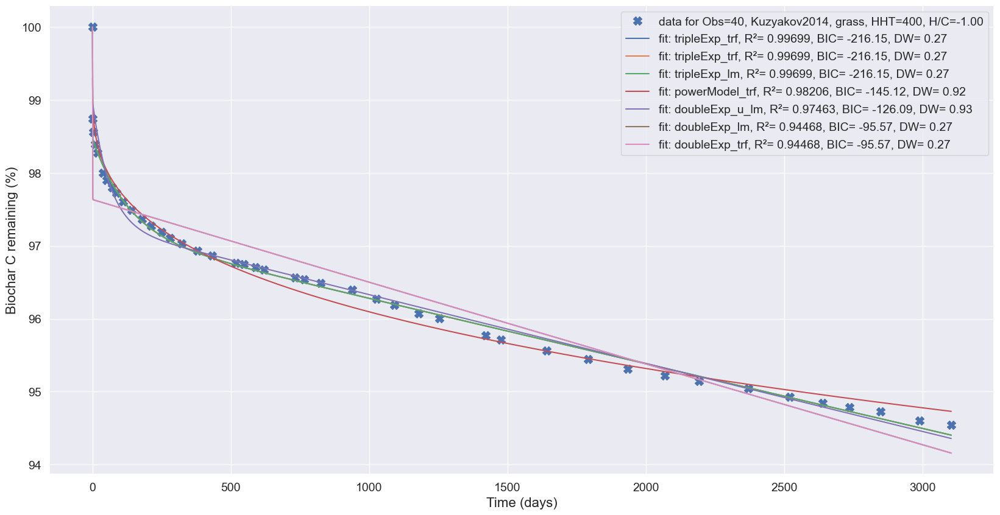

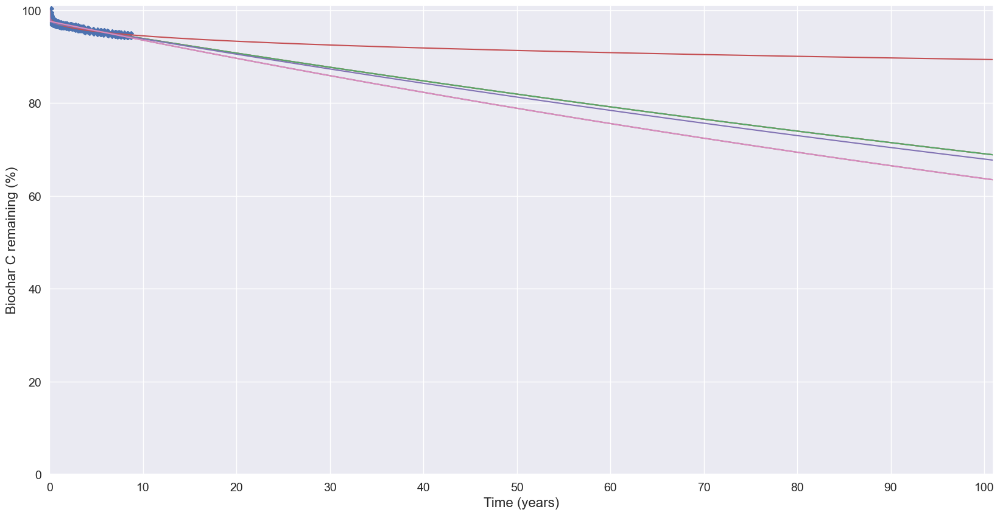

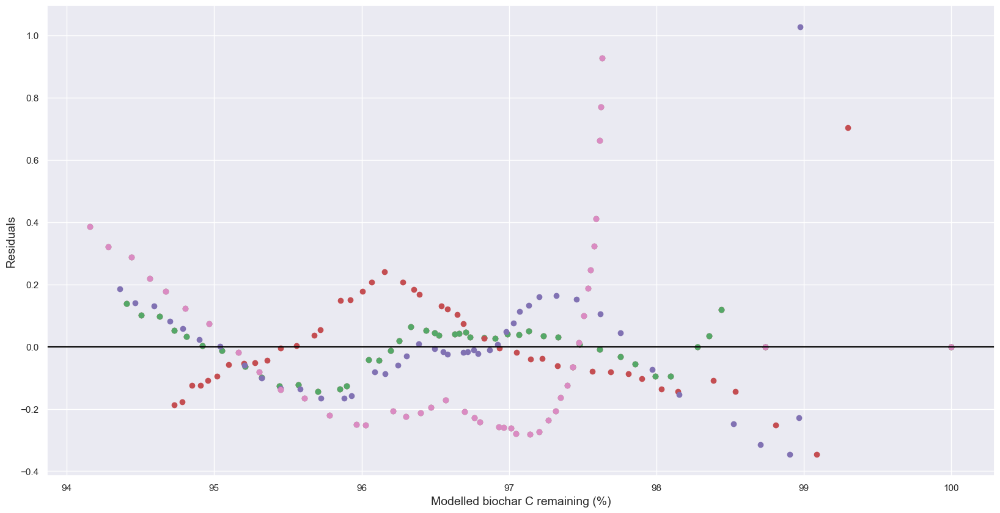

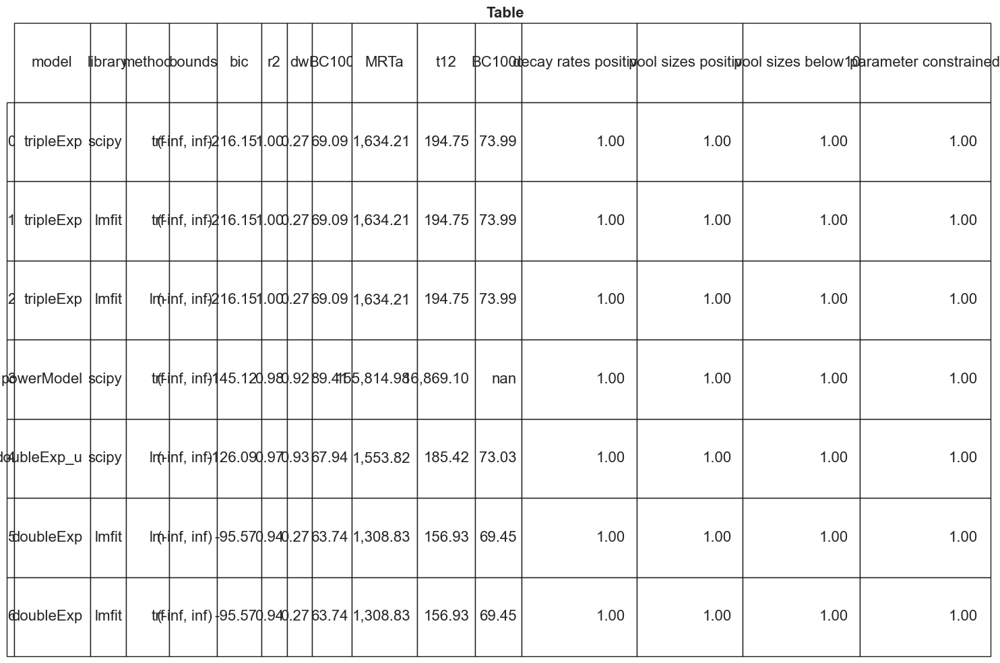

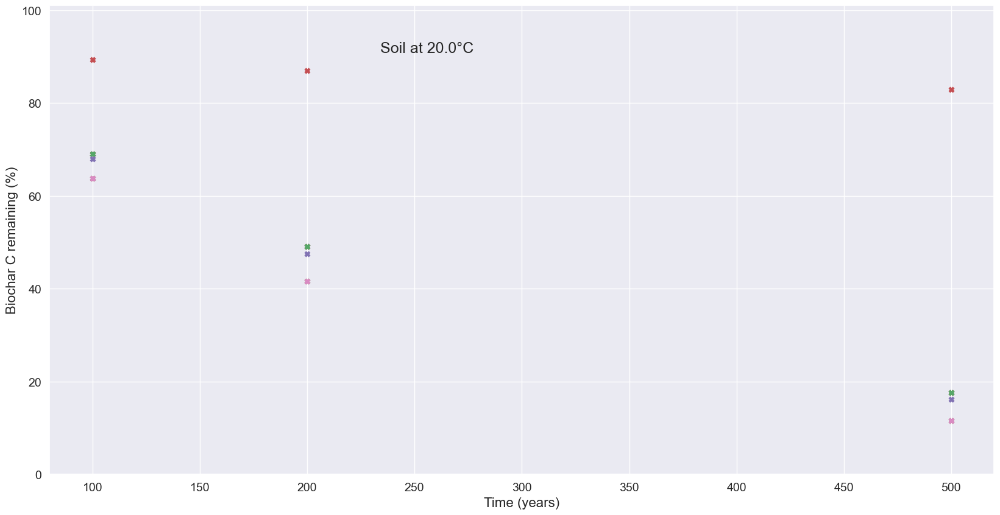

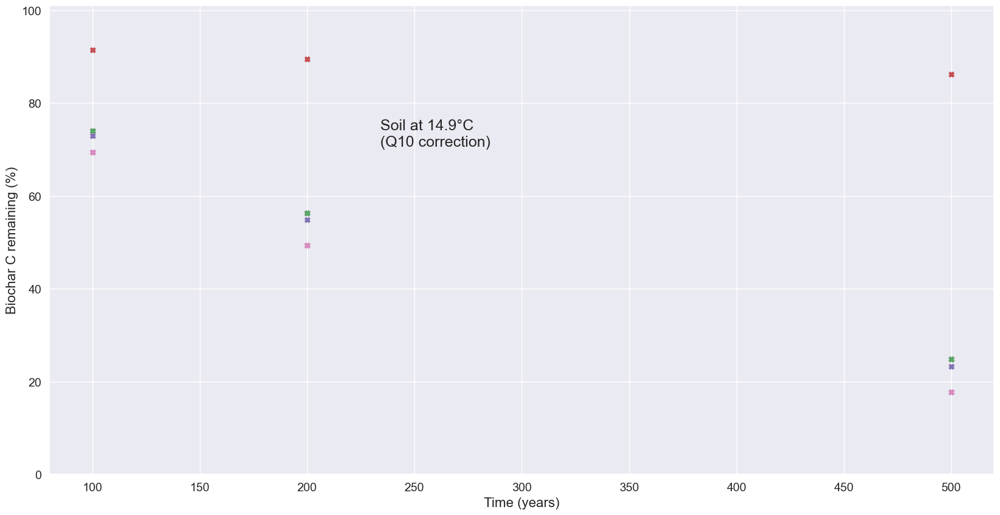

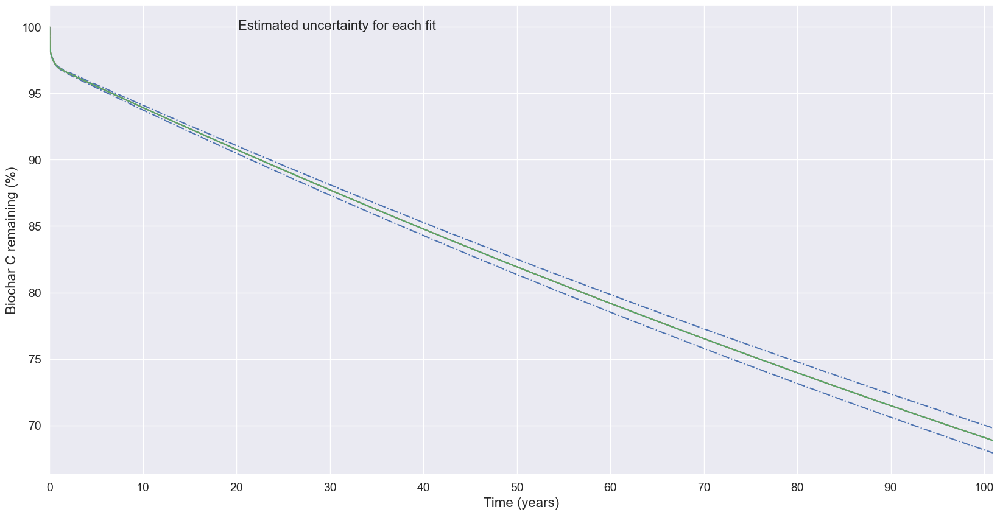

In [18]:
# select the fitdata for the observation
ID_obs, x, y, xdataHighRes, sub = select_multi_fits(40, df_all_fits_q10c, data, metadata, fit_limit=7, fit_rank='bic')

# plot 1
fig1, ax1 = plot_multi_fits(ID_obs, x, y, xdataHighRes, sub, metadata)

# plot 2 
fig2, ax2 = plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata)

# plot 3
fig3, ax3 = plot_multi_fits_residuals(ID_obs, x, y, xdataHighRes, sub, metadata)

# plot 4
fig4, ax4 = plot_multi_fits_report(ID_obs, x, y, xdataHighRes, sub, metadata)

# plot 5
fig5, ax5 = plot_multi_fits_snapshots(ID_obs, x, y, xdataHighRes, sub, metadata)

# plot 6
fig6, ax6 = plot_multi_fits_snapshots_q10(ID_obs, x, y, xdataHighRes, sub, metadata)

# plot 7
fig7, ax7 = plot_best_fits_uncertainty(ID_obs, x, y, xdataHighRes, sub, metadata)


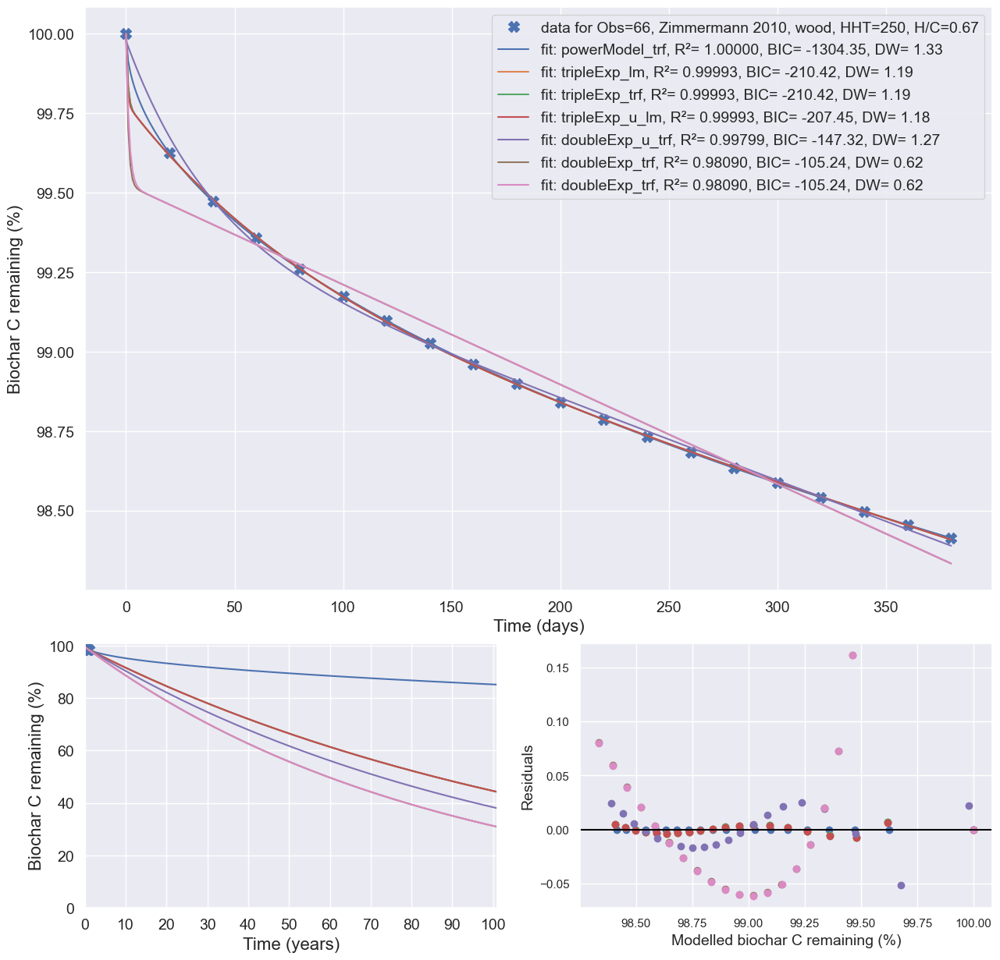

In [20]:
# COMBINE THE PLOTS
# select the fitdata for the observation
ID_obs, x, y, xdataHighRes, sub = select_multi_fits(66, df_all_fits_q10c, data, metadata, fit_limit=7, fit_rank='bic')

# initialise plot & insert
fig = plt.figure(figsize=(15, 15))
ax = plt.subplot(3,1,(1, 2))
ax2 = plt.subplot(3,2,5)
ax3 = plt.subplot(3,2,6)
axes = [ax, ax2, ax3]

_, ax = plot_multi_fits(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax, fig=fig)
_, ax2 = plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax2, fig=fig)
_, ax3 = plot_multi_fits_residuals(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax3, fig=fig)


#fig.tight_layout()

### Single figure

['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c0', 'b', 'm', 'c3'] [nan nan 0.0002093738181170997 0.01663787132138416 95.30464561551894
 4.782830220597951 nan nan nan nan nan] [nan nan 1.986945210468792e-05 0.001245166452596777 0.3834368150373001
 0.3721057027965414 nan nan nan nan nan]
dicStdev 
 {'k1': 1.986945210468792e-05, 'k2': 0.001245166452596777, 'c1': 0.3834368150373001, 'c2': 0.3721057027965414}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c0', 'b', 'm', 'c3'] [nan nan 0.01663714920692529 0.000209470526970313 4.783042300487397
 47.54772614466992 0.000209255050198913 nan nan nan 47.75669938887245] [nan nan 0.002261748138491181 2.257651319247492 1.152528389981219 nan
 2.248443791018921 nan nan nan nan]
dicStdev 
 {'k1': 0.002261748138491181, 'k2': 2.257651319247492, 'c1': 1.152528389981219, 'c2': nan, 'k3': 2.248443791018921, 'c3': nan}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c0', 'b', 'm', 'c3'] [nan nan 0.0001748538813468004 0.01422034511087994 94.55645360948738 nan
 nan nan nan n

C:\Users\Elias S. Azzi\AppData\Local\Temp\ipykernel_22616\3768267341.py:53: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


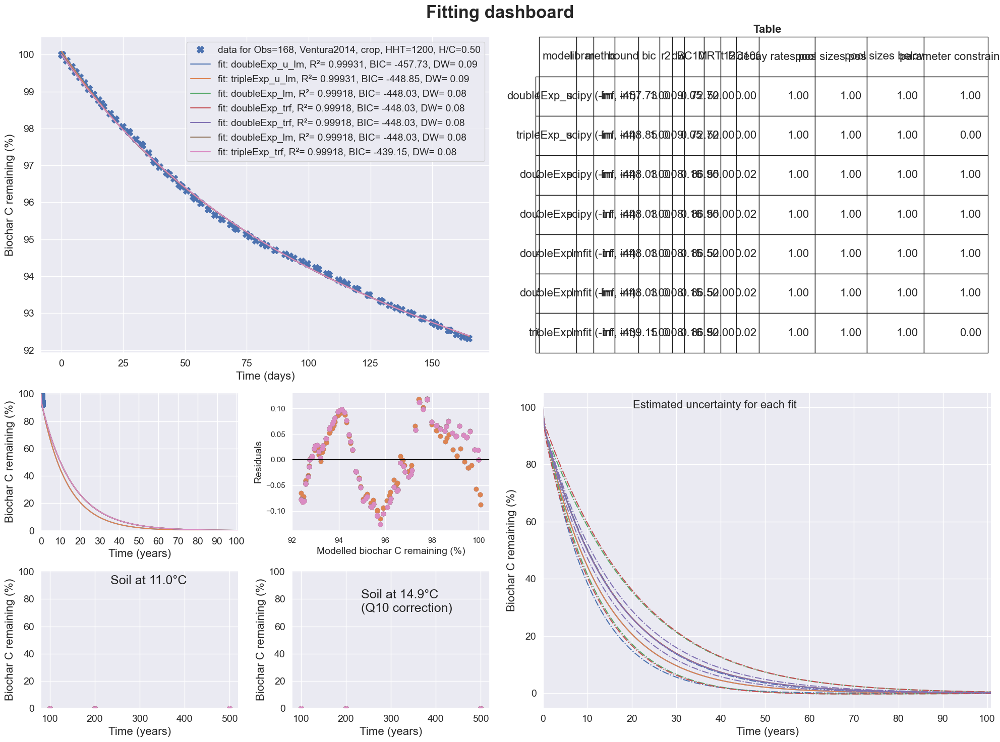

In [11]:
ID_obs, x, y, xdataHighRes, sub = select_multi_fits(168, df_all_fits_q10c, data, metadata, fit_limit=7, fit_rank='bic')

# initialise plot & insert
fig = plt.figure(figsize=(20, 15))
t = fig.suptitle("Fitting dashboard", fontsize=25, fontweight='bold')

r = 4
c = 4
ax1 = plt.subplot(r,c,(1, 6)) # decay fits
ax2 = plt.subplot(r,c,(9, 9)) # 100 year extrapo
ax3 = plt.subplot(r,c,(10, 10)) # residuals
ax4 = plt.subplot(r,c,(3, 8)) # table
ax5 = plt.subplot(r,c,(13, 13)) # scatter multi-time horizon snapshots 
ax6 = plt.subplot(r,c,(14, 14)) # q10 correction
ax7 = plt.subplot(r,c,(11, 16)) # best fit with uncertainty and q10 correction

_, ax1 = plot_multi_fits(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax1, fig=fig)
_, ax2 = plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax2, fig=fig)
_, ax3 = plot_multi_fits_residuals(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax3, fig=fig)

_, ax4 = plot_multi_fits_report(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax4, fig=fig)
_, ax5 = plot_multi_fits_snapshots(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax5, fig=fig)
_, ax6 = plot_multi_fits_snapshots_q10(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax6, fig=fig)

_, ax7 = plot_best_fits_uncertainty(ID_obs, x, y, xdataHighRes, sub, metadata, bic_limit=5, ax=ax7, fig=fig)


fig.tight_layout()

plt.savefig('simulations/fit-dashboard.png', dpi=300)

### Loop on all observations

0 1
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.353984180932005e-05 0.02258850733546113 98.58283626975133
 22.52097483046178 0.02457798985494755 nan nan nan nan] [nan nan 8.511653249437791e-06 0.349402420745958 0.3797154420487021
 8175.114721951629 0.3990260712782104 nan nan nan nan]
dicStdev 
 {'k1': 8.511653249437791e-06, 'k2': 0.349402420745958, 'c1': 0.3797154420487021, 'c2': 8175.114721951629, 'k3': 0.3990260712782104}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 6.842272731906639e-06 0.007297013506234226 98.18621397366334 nan
 nan nan nan nan nan] [nan nan 1.551335311530825e-05 0.00419174393322217 0.8398850579720194 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 1.551335311530825e-05, 'k2': 0.00419174393322217, 'c1': 0.8398850579720194}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0072974696966135 6.843847483567012e-06 1.813697557061556 nan
 nan nan nan nan nan] [nan nan 0.00419162317309698 1.55156

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.995361898448874e-05 0.0961890903477735 99.14371431200422
 0.2791421935724596 0.00922014562412409 nan nan nan nan] [nan nan 3.476210489425441e-07 0.004030959146320619 0.01502714235702783
 0.006195507672914231 0.0003557290170918706 nan nan nan nan]
dicStdev 
 {'k1': 3.476210489425441e-07, 'k2': 0.004030959146320619, 'c1': 0.01502714235702783, 'c2': 0.006195507672914231, 'k3': 0.0003557290170918706}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.995350337074179e-05 0.009219984688040282 99.1437089524352
 0.5771446278139305 0.09617746384091512 0.2790960514954025 nan nan nan] [nan nan 3.598441557780148e-07 0.0003682399365541375 0.01555579435474109
 0.01088142945182059 0.004183568049778629 0.006550885546369677 nan nan nan]
dicStdev 
 {'k1': 3.598441557780148e-07, 'k2': 0.0003682399365541375, 'c1': 0.01555579435474109, 'c2': 0.01088142945182059, 'k3': 0.004183568049778629, 'c3': 0.0065508855463

C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


2 67
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 99.99999999999999 -8.272950729719682
 -0.5199999999999776] [nan nan nan nan nan nan nan nan 9.929604476450079e-15
 4.897895441078889e-14 1.104432021775408e-14]
dicStdev 
 {'c0': 9.929604476450079e-15, 'b': 4.897895441078889e-14, 'm': 1.104432021775408e-14}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.13048798326986e-05 0.009282244562068553 99.49475995357662
 0.3372058893021944 0.09725145863933259 nan nan nan nan] [nan nan 2.020194304194904e-07 0.0003588247194351793 0.008728517213672482
 0.006076372253131577 0.004055316233685703 nan nan nan nan]
dicStdev 
 {'k1': 2.020194304194904e-07, 'k2': 0.0003588247194351793, 'c1': 0.008728517213672482, 'c2': 0.006076372253131577, 'k3': 0.004055316233685703}


C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.130480187805541e-05 0.009282066884442296 99.49475639306425
 0.337206896740915 0.09724028086825297 0.1680080727827103 nan nan nan] [nan nan 2.091152119834728e-07 0.0003714406897840999 0.009035152288034863
 0.006289532482252887 0.004208646195241533 0.003873624183280472 nan nan
 nan]
dicStdev 
 {'k1': 2.091152119834728e-07, 'k2': 0.0003714406897840999, 'c1': 0.009035152288034863, 'c2': 0.006289532482252887, 'k3': 0.004208646195241533, 'c3': 0.003873624183280472}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.130479086924955e-05 0.009282037547339585 99.49475586309076
 0.3372069921209466 0.09723973427464158 0.1680085067477844 nan nan nan] [nan nan 2.091159401467233e-07 0.000371435041308965 0.009035270164209432
 0.006289659571635444 0.004208516353333239 0.003873650243722597 nan nan
 nan]
dicStdev 
 {'k1': 2.091159401467233e-07, 'k2': 0.000371435041308965, 'c1': 0.009035270164209432, 'c2': 0.0

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 9.798792395158214e-06 0.009878891599180817 99.453377087052
 0.3353561968403436 0.1056873652177625 nan nan nan nan] [nan nan 1.976999488137984e-07 0.0003846586059159032 0.00826139604209801
 0.005529419107363788 0.004219449032612221 nan nan nan nan]
dicStdev 
 {'k1': 1.976999488137984e-07, 'k2': 0.0003846586059159032, 'c1': 0.00826139604209801, 'c2': 0.005529419107363788, 'k3': 0.004219449032612221}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 9.79878657545636e-06 0.1056811815965463 99.45337676068424
 0.2112451255526301 0.009878858417392595 0.3353557012046294 nan nan nan] [nan nan 2.046382939384241e-07 0.004375401435569846 0.008551371235343117
 0.004232041679270863 0.0003981616752275864 0.00572339729147084 nan nan
 nan]
dicStdev 
 {'k1': 2.046382939384241e-07, 'k2': 0.004375401435569846, 'c1': 0.008551371235343117, 'c2': 0.004232041679270863, 'k3': 0.0003981616752275864, 'c3': 0.00572339729

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.784158842984466e-05 0.008544675816393198 99.4047193004731
 0.4332571736971256 0.0876039737681557 nan nan nan nan] [nan nan 2.640931266427324e-07 0.0003267600783306302 0.01193354319228976
 0.008756724380813524 0.003829101918036887 nan nan nan nan]
dicStdev 
 {'k1': 2.640931266427324e-07, 'k2': 0.0003267600783306302, 'c1': 0.01193354319228976, 'c2': 0.008756724380813524, 'k3': 0.003829101918036887}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.08831061382713612 0.008658736665223543 0.1610070234598915
 0.4296074614056899 1.795037668506083e-05 nan nan nan nan] [nan nan 0.0030898746575982 8.569009941311546e-05 0.002488162101608215
 0.002129318146835124 2.459207684245977e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.0030898746575982, 'k2': 8.569009941311546e-05, 'c1': 0.002488162101608215, 'c2': 0.002129318146835124, 'k3': 2.459207684245977e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0'

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


5 70
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 99.99999823575737 -7.384841787864165
 -0.6451504727660227] [nan nan nan nan nan nan nan nan 2.546047199345759e-06
 5.188623546151818e-06 1.320407887460738e-06]
dicStdev 
 {'c0': 2.546047199345759e-06, 'b': 5.188623546151818e-06, 'm': 1.320407887460738e-06}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.351258946673042e-05 0.01050111779850409 99.05619863221037
 0.5214167854322731 0.1152546434956316 nan nan nan nan] [nan nan 3.027832650001738e-07 0.0004115383399236275 0.01221646384703673
 0.007905515054172235 0.004373349052172267 nan nan nan nan]
dicStdev 
 {'k1': 3.027832650001738e-07, 'k2': 0.0004115383399236275, 'c1': 0.01221646384703673, 'c2': 0.007905515054172235, 'k3': 0.004373349052172267}


C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.35125894422412e-05 0.01050112050279288 99.0561986440572
 0.5214169028083384 0.1152547713433708 nan nan nan nan] [nan nan 3.027732533895604e-07 0.0004115285431873234 0.01221600948586812
 0.007905298687059165 0.004373396870195603 nan nan nan nan]
dicStdev 
 {'k1': 3.027732533895604e-07, 'k2': 0.0004115285431873234, 'c1': 0.01221600948586812, 'c2': 0.007905298687059165, 'k3': 0.004373396870195603}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.351256577034876e-05 0.0105010750250163 99.05619761547835
 0.5214168173889001 0.1152509999839291 0.4223596707695262 nan nan nan] [nan nan 3.134063936599821e-07 0.0004259842704075263 0.01264507709433858
 0.008182792298469063 0.004532402098748893 0.007189328906731193 nan nan
 nan]
dicStdev 
 {'k1': 3.134063936599821e-07, 'k2': 0.0004259842704075263, 'c1': 0.01264507709433858, 'c2': 0.008182792298469063, 'k3': 0.004532402098748893, 'c3': 0.00718932890673

C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


6 71
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 99.99953184734443 -7.916937854512004
 -0.5574036220345254] [nan nan nan nan nan nan nan nan 0.0004548926244008694
 0.001609374902738764 0.0003728066265674504]
dicStdev 
 {'c0': 0.0004548926244008694, 'b': 0.001609374902738764, 'm': 0.0003728066265674504}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.313407539104636e-05 0.009649800323546544 99.33984772039447
 0.4173576935254978 0.1031929207894232 nan nan nan nan] [nan nan 2.488534854095677e-07 0.0003753016786103179 0.01051401763602096
 0.007158966399904684 0.004186441631336637 nan nan nan nan]
dicStdev 
 {'k1': 2.488534854095677e-07, 'k2': 0.0003753016786103179, 'c1': 0.01051401763602096, 'c2': 0.007158966399904684, 'k3': 0.004186441631336637}


C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.313408665003261e-05 0.009649816660132655 99.33984819498826
 0.4173573863572813 0.1031930209667541 nan nan nan nan] [nan nan 2.488522915512217e-07 0.000375312271470399 0.01051391862454886
 0.007158736534059833 0.004186761886202896 nan nan nan nan]
dicStdev 
 {'k1': 2.488522915512217e-07, 'k2': 0.000375312271470399, 'c1': 0.01051391862454886, 'c2': 0.007158736534059833, 'k3': 0.004186761886202896}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.009534619182516302 0.1023144012817778 0.419335409623578
 0.2437867639969449 1.307255859117618e-05 nan nan nan nan] [nan nan 0.0001103822948566354 0.003300153937397899 0.002597733112162702
 0.003020635248502143 2.598483460848133e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.0001103822948566354, 'k2': 0.003300153937397899, 'c1': 0.002597733112162702, 'c2': 0.003020635248502143, 'k3': 2.598483460848133e-08}


C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.009534619182516302 0.1023144012817778 0.419335409623578
 0.2437867639969449 1.307255859117618e-05 nan nan nan nan] [nan nan 0.0001103822948566354 0.003300153937397899 0.002597733112162702
 0.003020635248502143 2.598483460848133e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.0001103822948566354, 'k2': 0.003300153937397899, 'c1': 0.002597733112162702, 'c2': 0.003020635248502143, 'k3': 2.598483460848133e-08}
7 72
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 100.0 -7.529375775445444
 -0.7640000000000083] [nan nan nan nan nan nan nan nan 1.330783738111598e-14
 2.293012044212489e-14 7.706504335584595e-15]
dicStdev 
 {'c0': 1.330783738111598e-14, 'b': 2.293012044212489e-14, 'm': 7.706504335584595e-15}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 5.957986659973076e-06 0.1386134722221514 99.29522849835887
 0.4147518974853924 0.01172537291186612 nan na

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 5.957983866457564e-06 0.1386124564691221 99.29522837207142
 0.4147456157801825 0.01172535787488604 0.2900195197190301 nan nan nan] [nan nan 1.663181183939686e-07 0.004809815920496923 0.006373397555466713
 0.004667569370031555 0.0004814771787132023 0.004014434970849586 nan nan
 nan]
dicStdev 
 {'k1': 1.663181183939686e-07, 'k2': 0.004809815920496923, 'c1': 0.006373397555466713, 'c2': 0.004667569370031555, 'k3': 0.0004814771787132023, 'c3': 0.004014434970849586}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.3849744512443021 0.01542310338936703 0.3719825701632984
 0.302426872639594 6.750824677048683e-06 nan nan nan nan] [nan nan nan 0.0004052132367750482 0.004802656143078344
 0.004495819156671558 4.62970486452248e-08 nan nan nan nan]
dicStdev 
 {'k1': nan, 'k2': 0.0004052132367750482, 'c1': 0.004802656143078344, 'c2': 0.004495819156671558, 'k3': 4.62970486452248e-08}
['k', 'c', 'k1', 'k2', 

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1559345392109224 0.009861226012153335 0.05912613494157837
 0.2914170557190565 2.051754782739224e-05 nan nan nan nan] [nan nan nan 2.669063659223417e-05 nan nan 4.042809253229933e-08 nan nan
 nan nan]
dicStdev 
 {'k1': nan, 'k2': 2.669063659223417e-05, 'c1': nan, 'c2': nan, 'k3': 4.042809253229933e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1559345392109224 0.009861226012153335 0.05912613494157837
 0.2914170557190565 2.051754782739224e-05 nan nan nan nan] [nan nan nan 2.669063659223417e-05 nan nan 4.042809253229933e-08 nan nan
 nan nan]
dicStdev 
 {'k1': nan, 'k2': 2.669063659223417e-05, 'c1': nan, 'c2': nan, 'k3': 4.042809253229933e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1559345392109224 0.009861226012153335 0.05912613494157837
 0.2914170557190565 2.051754782739224e-05 nan nan nan nan] [nan nan nan 2.669063659223417e-05 nan nan 4.0428092532

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.01258881148347157 0.5010784456275785 1.149000623814844
 0.4988726268291277 4.377394308141547e-05 nan nan nan nan] [nan nan 0.0003321801535847551 nan 0.01500625984899286 0.01349195610558216
 3.650869083955163e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.0003321801535847551, 'k2': nan, 'c1': 0.01500625984899286, 'c2': 0.01349195610558216, 'k3': 3.650869083955163e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.01258881148347157 0.5010784456275785 1.149000623814844
 0.4988726268291277 4.377394308141547e-05 nan nan nan nan] [nan nan 0.0003321801535847551 nan 0.01500625984899286 0.01349195610558216
 3.650869083955163e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.0003321801535847551, 'k2': nan, 'c1': 0.01500625984899286, 'c2': 0.01349195610558216, 'k3': 3.650869083955163e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.01258881148347157 0.5010784456275785 1.14900062381

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.626909759767735e-05 0.01236600273478262 99.0431528340704
 0.6789280544078206 74.05823248032443 nan nan nan nan] [nan nan 5.812476622664324e-07 0.000633066888512416 0.02102732039142412
 0.01675327598004399 2.985671672982902e-18 nan nan nan nan]
dicStdev 
 {'k1': 5.812476622664324e-07, 'k2': 0.000633066888512416, 'c1': 0.02102732039142412, 'c2': 0.01675327598004399, 'k3': 2.985671672982902e-18}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.451282751680105 0.01231920357930294 0.2782115080978143
 0.6806514121693863 2.621463240926047e-05 nan nan nan nan] [nan nan nan 0.0002918689544033837 0.007621671953545193
 0.007983756087504942 1.657080594151004e-07 nan nan nan nan]
dicStdev 
 {'k1': nan, 'k2': 0.0002918689544033837, 'c1': 0.007621671953545193, 'c2': 0.007983756087504942, 'k3': 1.657080594151004e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.45128275168010

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.545046410190226e-05 0.009626732769039543 99.64939046885578
 0.301138401013759 0.9988356621503802 0.04947113013137273 nan nan nan] [nan nan inf inf inf inf inf inf nan nan nan]
dicStdev 
 {'k1': inf, 'k2': inf, 'c1': inf, 'c2': inf, 'k3': inf, 'c3': inf}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.545047803164662e-05 0.00962675592808685 99.64939104122726
 0.3011379114724804 1.0 0.04947104729072964 nan nan nan] [nan nan inf inf inf inf inf inf nan nan nan]
dicStdev 
 {'k1': inf, 'k2': inf, 'c1': inf, 'c2': inf, 'k3': inf, 'c3': inf}


C:\github\biocharStability\biocharStability\analyse.py:893: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.545046607579534e-05 1.591346817874169 99.64939054054095
 0.04947114971290284 0.009626734114782926 0.301138309746351 nan nan nan] [nan nan inf inf inf inf inf inf nan nan nan]
dicStdev 
 {'k1': inf, 'k2': inf, 'c1': inf, 'c2': inf, 'k3': inf, 'c3': inf}
12 77
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 99.99998770141185 -6.916285996406768
 -0.5688610006291445] [nan nan nan nan nan nan nan nan 1.251041521478988e-05
 1.62711141869873e-05 3.820320490126776e-06]
dicStdev 
 {'c0': 1.251041521478988e-05, 'b': 1.62711141869873e-05, 'm': 3.820320490126776e-06}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.009797906127633977 0.1038641167869075 1.093686872099866
 0.6565262338949629 3.391141694744841e-05 nan nan nan nan] [nan nan 0.0003801734068829007 0.0041823227122341 0.01832088420942298
 0.01281803633816446 6.552215412841717e-07 nan nan nan na

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 3.391140614227454e-05 0.1038639882311741 98.24978641573419
 0.6565265845809503 0.009797897969639983 nan nan nan nan] [nan nan 6.552300736785404e-07 0.004182303471050022 0.02719435446459372
 0.01281818940849958 0.0003801771420811115 nan nan nan nan]
dicStdev 
 {'k1': 6.552300736785404e-07, 'k2': 0.004182303471050022, 'c1': 0.02719435446459372, 'c2': 0.01281818940849958, 'k3': 0.0003801771420811115}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 3.750304252652365e-05 6.393593799375869 98.39596625357576
 0.5312448576658811 0.01297068321058559 nan nan nan nan] [nan nan 9.069517315826872e-07 1.552650526071028e-17 0.03194463402404712
 0.01585238537540831 0.000668693663966591 nan nan nan nan]
dicStdev 
 {'k1': 9.069517315826872e-07, 'k2': 1.552650526071028e-17, 'c1': 0.03194463402404712, 'c2': 0.01585238537540831, 'k3': 0.000668693663966591}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b'

C:\github\biocharStability\biocharStability\analyse.py:893: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


13 78
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 100.0 -7.052955862040474
 -0.5699999999999998] [nan nan nan nan nan nan nan nan 4.740522413124777e-15
 7.076839980118851e-15 1.661746491912546e-15]
dicStdev 
 {'c0': 4.740522413124777e-15, 'b': 7.076839980118851e-15, 'm': 1.661746491912546e-15}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.925887974386152e-05 0.1039807721208977 98.47569420550363
 0.5728708061896249 0.009797923293985083 nan nan nan nan] [nan nan 5.685229025835988e-07 0.004185076486138621 0.02364516104516215
 0.01115961759833044 0.0003803645495200086 nan nan nan nan]
dicStdev 
 {'k1': 5.685229025835988e-07, 'k2': 0.004185076486138621, 'c1': 0.02364516104516215, 'c2': 0.01115961759833044, 'k3': 0.0003803645495200086}


C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.925888053448488e-05 0.1039807140630715 98.4756942308376
 0.5728708963478241 0.009797922835545423 nan nan nan nan] [nan nan 5.685060695311968e-07 0.004185245328211076 0.02364429263914156
 0.01115961003945217 0.0003803631009818505 nan nan nan nan]
dicStdev 
 {'k1': 5.685060695311968e-07, 'k2': 0.004185245328211076, 'c1': 0.02364429263914156, 'c2': 0.01115961003945217, 'k3': 0.0003803631009818505}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.925877417648783e-05 0.1039734515350816 98.47568950871191
 0.5728083099556953 0.009797827167337009 0.9514355011095995 nan nan nan] [nan nan 5.884821866009698e-07 0.004340430048206891 0.02447528456492518
 0.01182063834218714 0.000393725239478442 0.01648379184668151 nan nan nan]
dicStdev 
 {'k1': 5.884821866009698e-07, 'k2': 0.004340430048206891, 'c1': 0.02447528456492518, 'c2': 0.01182063834218714, 'k3': 0.000393725239478442, 'c3': 0.01648379184668151}

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.194318448420492e-05 0.009874057973534215 99.33777984984465
 0.4068056612608769 0.1055584955601137 nan nan nan nan] [nan nan 2.401676211755792e-07 0.0003843532445731833 0.01002795892240877
 0.006714765354073777 0.004216624236424149 nan nan nan nan]
dicStdev 
 {'k1': 2.401676211755792e-07, 'k2': 0.0003843532445731833, 'c1': 0.01002795892240877, 'c2': 0.006714765354073777, 'k3': 0.004216624236424149}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.194314994157695e-05 0.009874006821889166 99.33777841963638
 0.4068066213807029 0.1055582314444705 nan nan nan nan] [nan nan 2.401726938120151e-07 0.0003843571749899312 0.01002812770872493
 0.00671492340945788 0.004216511450655229 nan nan nan nan]
dicStdev 
 {'k1': 2.401726938120151e-07, 'k2': 0.0003843571749899312, 'c1': 0.01002812770872493, 'c2': 0.00671492340945788, 'k3': 0.004216511450655229}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0',

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


15 80
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 99.99967199871189 -7.566538281626143
 -0.6384919680086187] [nan nan nan nan nan nan nan nan 0.0004576523008362578
 0.001125986206471018 0.0002837325120809203]
dicStdev 
 {'c0': 0.0004576523008362578, 'b': 0.001125986206471018, 'm': 0.0002837325120809203}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.174527061045479e-05 0.01042459439776768 99.20502614088
 0.4423036955914528 0.1150406271632109 nan nan nan nan] [nan nan 2.5776977738148e-07 0.0004088346796275177 0.01045120687566128
 0.006802261893454175 0.004383309801156604 nan nan nan nan]
dicStdev 
 {'k1': 2.5776977738148e-07, 'k2': 0.0004088346796275177, 'c1': 0.01045120687566128, 'c2': 0.006802261893454175, 'k3': 0.004383309801156604}


C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.174524174934102e-05 0.01042453350047172 99.20502489482561
 0.4423037719837819 0.1150366025055932 0.3526492814918541 nan nan nan] [nan nan 2.668149147041317e-07 0.0004231850284520058 0.01081796646842115
 0.007040828549858637 0.004542715140368418 0.006029269086787 nan nan nan]
dicStdev 
 {'k1': 2.668149147041317e-07, 'k2': 0.0004231850284520058, 'c1': 0.01081796646842115, 'c2': 0.007040828549858637, 'k3': 0.004542715140368418, 'c3': 0.006029269086787}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.310394287833205e-05 0.01375712745395115 99.25937200640433
 0.443109582627897 73.9538576805441 nan nan nan nan] [nan nan 3.606498848845652e-07 0.000718535976342365 0.01250521620421631
 0.009816289945580517 1.982424606685348e-18 nan nan nan nan]
dicStdev 
 {'k1': 3.606498848845652e-07, 'k2': 0.000718535976342365, 'c1': 0.01250521620421631, 'c2': 0.009816289945580517, 'k3': 1.982424606685348e-18}
[

C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


16 81
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 3.32734936953071e-05 0.01987313567104531 98.25561052415459
 2.501011188843679 0.9197135106772705 nan nan nan nan] [nan nan inf inf inf inf inf nan nan nan nan]
dicStdev 
 {'k1': inf, 'k2': inf, 'c1': inf, 'c2': inf, 'k3': inf}


C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.941327234969717e-05 0.01128908600952683 97.75356916916655
 2.397027938909533 nan nan nan nan nan] [nan nan 9.421654465669018e-06 0.002139107082555098 0.341453822776299
 0.3206161603905218 nan nan nan nan nan]
dicStdev 
 {'k1': 9.421654465669018e-06, 'k2': 0.002139107082555098, 'c1': 0.341453822776299, 'c2': 0.3206161603905218}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.941298779560253e-05 0.01128901669579408 97.7535585341971
 2.397037342017112 nan nan nan nan nan] [nan nan 9.421791303705253e-06 0.002139100581603217 0.3414590009078474
 0.3206210622341496 nan nan nan nan nan]
dicStdev 
 {'k1': 9.421791303705253e-06, 'k2': 0.002139100581603217, 'c1': 0.3414590009078474, 'c2': 0.3206210622341496}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.941296206298789e-05 0.01128901113973787 97.75355759560065
 2.397038228049315 nan nan nan nan nan] [nan nan 9.4217932044

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.658257524055232e-05 0.008710250026330718 99.4083715022067
 0.4229748216320062 0.08968983492245305 nan nan nan nan] [nan nan 2.569974629890038e-07 0.0003339454026617117 0.01148912868646825
 0.008330735535324806 0.003881706085646688 nan nan nan nan]
dicStdev 
 {'k1': 2.569974629890038e-07, 'k2': 0.0003339454026617117, 'c1': 0.01148912868646825, 'c2': 0.008330735535324806, 'k3': 0.003881706085646688}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.658237005121628e-05 0.008709920030125964 99.40836186005706
 0.4229788847266122 0.08967224592581813 0.1686157624121892 nan nan nan] [nan nan 2.660405404011694e-07 0.0003457039127602489 0.01189375975830988
 0.008623592061906328 0.004032159697874549 0.004397731128610047 nan nan
 nan]
dicStdev 
 {'k1': 2.660405404011694e-07, 'k2': 0.0003457039127602489, 'c1': 0.01189375975830988, 'c2': 0.008623592061906328, 'k3': 0.004032159697874549, 'c3': 0.00439773

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.009444284123421867 0.09953729028353982 0.397729913894774
 0.2111540961291775 1.290593237240552e-05 nan nan nan nan] [nan nan 0.0003658287608394948 0.004104131093015157 0.007000298394418951
 0.004429893554039372 2.376503419422966e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.0003658287608394948, 'k2': 0.004104131093015157, 'c1': 0.007000298394418951, 'c2': 0.004429893554039372, 'k3': 2.376503419422966e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.29059513286242e-05 0.009444313798782954 99.39111681158826
 0.3977293971449201 0.09953748570965922 nan nan nan nan] [nan nan 2.37645363665459e-07 0.0003658224296755964 0.01016300066654867
 0.007000159467344312 0.004104141910458835 nan nan nan nan]
dicStdev 
 {'k1': 2.37645363665459e-07, 'k2': 0.0003658224296755964, 'c1': 0.01016300066654867, 'c2': 0.007000159467344312, 'k3': 0.004104141910458835}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


19 84
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 99.99987892625245 -8.00763608383666
 -0.560399135447266] [nan nan nan nan nan nan nan nan 0.0001190028523614103
 0.0004616691378951958 0.0001071736234428115]
dicStdev 
 {'c0': 0.0001190028523614103, 'b': 0.0004616691378951958, 'm': 0.0001071736234428115}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.172185075992491e-05 0.009667872610088708 99.39937440402433
 0.3798902547654229 0.1028495478362524 nan nan nan nan] [nan nan 2.256945726800259e-07 0.000375647852540529 0.00953310499787792
 0.006471762580468158 0.004171015961852451 nan nan nan nan]
dicStdev 
 {'k1': 2.256945726800259e-07, 'k2': 0.000375647852540529, 'c1': 0.00953310499787792, 'c2': 0.006471762580468158, 'k3': 0.004171015961852451}


C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.172185500618433e-05 0.009667873886524497 99.39937455530426
 0.3798899933585876 0.1028493444113269 nan nan nan nan] [nan nan 2.256819311876714e-07 0.0003756278382345273 0.009532557205023079
 0.006471440078161386 0.004170940478061902 nan nan nan nan]
dicStdev 
 {'k1': 2.256819311876714e-07, 'k2': 0.0003756278382345273, 'c1': 0.009532557205023079, 'c2': 0.006471440078161386, 'k3': 0.004170940478061902}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.172179901478941e-05 0.009667754453981544 99.39937205679252
 0.3798905673627365 0.1028414243331099 0.2207098290858089 nan nan nan] [nan nan 2.336149765630874e-07 0.0003888309211497407 0.009867724619822797
 0.00669883593538652 0.004326128815686346 0.004638808367458671 nan nan nan]
dicStdev 
 {'k1': 2.336149765630874e-07, 'k2': 0.0003888309211497407, 'c1': 0.009867724619822797, 'c2': 0.00669883593538652, 'k3': 0.004326128815686346, 'c3': 0.00463880

C:\Users\Elias S. Azzi\AppData\Local\Temp\ipykernel_24340\877925475.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(20, 15))


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.337344082793867e-05 0.0931933581442533 99.08276779590378
 0.2817110290997611 0.008999585601407279 nan nan nan nan] [nan nan 3.850164313324906e-07 0.003963423933207641 0.01685663864745489
 0.006572699889367941 0.0003460222664394047 nan nan nan nan]
dicStdev 
 {'k1': 3.850164313324906e-07, 'k2': 0.003963423933207641, 'c1': 0.01685663864745489, 'c2': 0.006572699889367941, 'k3': 0.0003460222664394047}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.337342532170439e-05 0.008999567791226896 99.08276707109147
 0.6355214797312386 0.09319311487254288 nan nan nan nan] [nan nan 3.850211695461973e-07 0.0003460265932079649 0.01685683454908712
 0.01197838157724168 0.003963477173074997 nan nan nan nan]
dicStdev 
 {'k1': 3.850211695461973e-07, 'k2': 0.0003460265932079649, 'c1': 0.01685683454908712, 'c2': 0.01197838157724168, 'k3': 0.003963477173074997}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0'

C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


21 86
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 100.0 -6.86216530551088
 -0.6620000000000014] [nan nan nan nan nan nan nan nan 5.899819992735506e-15
 6.971475407855595e-15 1.825077086617591e-15]
dicStdev 
 {'c0': 5.899819992735506e-15, 'b': 6.971475407855595e-15, 'm': 1.825077086617591e-15}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.090523568413808e-05 0.0106864064111196 98.45554314726179
 0.8251007824111076 0.118136010621916 nan nan nan nan] [nan nan 4.794495006032185e-07 0.0004193840697957574 0.01906438027396294
 0.01224190799331819 0.004413327390411744 nan nan nan nan]
dicStdev 
 {'k1': 4.794495006032185e-07, 'k2': 0.0004193840697957574, 'c1': 0.01906438027396294, 'c2': 0.01224190799331819, 'k3': 0.004413327390411744}


C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.090519463454972e-05 0.1181355869157463 98.45554147229844
 0.7193571086079072 0.01068636711749381 nan nan nan nan] [nan nan 4.794690388406516e-07 0.00441300501545728 0.01906538868595131
 0.01097435035168953 0.0004193856717960672 nan nan nan nan]
dicStdev 
 {'k1': 4.794690388406516e-07, 'k2': 0.00441300501545728, 'c1': 0.01906538868595131, 'c2': 0.01097435035168953, 'k3': 0.0004193856717960672}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.09052013414689e-05 0.01068636598296696 98.45554168946445
 0.8251007632543679 0.1181328477893898 0.7193202735463577 nan nan nan] [nan nan 4.962813369707973e-07 0.0004341070339727522 0.01973381772372364
 0.012671661004143 0.004572960821978144 0.01165238289635032 nan nan nan]
dicStdev 
 {'k1': 4.962813369707973e-07, 'k2': 0.0004341070339727522, 'c1': 0.01973381772372364, 'c2': 0.012671661004143, 'k3': 0.004572960821978144, 'c3': 0.01165238289635032}
['k',

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.745264106212084e-05 0.1001218156338176 99.1643055027852
 0.293312997896138 0.009503948170882574 nan nan nan nan] [nan nan 3.242200285762662e-07 0.004113099919797301 0.01379110958001655
 0.006094292137849241 0.0003681059539584252 nan nan nan nan]
dicStdev 
 {'k1': 3.242200285762662e-07, 'k2': 0.004113099919797301, 'c1': 0.01379110958001655, 'c2': 0.006094292137849241, 'k3': 0.0003681059539584252}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.745257507410691e-05 0.009503838990553555 99.16430244684133
 0.5423816513832529 0.100112644317702 0.2932733708057443 nan nan nan] [nan nan 3.356210427638249e-07 0.0003810528397123148 0.01427632298691609
 0.009793220398276846 0.004267164769047546 0.006450653712302152 nan nan
 nan]
dicStdev 
 {'k1': 3.356210427638249e-07, 'k2': 0.0003810528397123148, 'c1': 0.01427632298691609, 'c2': 0.009793220398276846, 'k3': 0.004267164769047546, 'c3': 0.006450653712

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 7.057778957411478e-06 0.01050648004540972 99.49948154199618
 0.2757033714481697 0.115515569329552 0.2248014933504348 nan nan nan] [nan nan 1.648444618973086e-07 0.0004264377001916741 0.006677502095924615
 0.004318601197399305 0.004537223679523482 0.00380796196902676 nan nan nan]
dicStdev 
 {'k1': 1.648444618973086e-07, 'k2': 0.0004264377001916741, 'c1': 0.006677502095924615, 'c2': 0.004318601197399305, 'k3': 0.004537223679523482, 'c3': 0.00380796196902676}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 7.057776885537245e-06 0.01050647701337288 99.49948146247888
 0.2757034761962745 0.1155156894632074 0.2248014779413853 nan nan nan] [nan nan 1.648432767416955e-07 0.000426423072802436 0.006677448619272534
 0.004318676299832134 0.004536858298148203 0.003807726078183932 nan nan
 nan]
dicStdev 
 {'k1': 1.648432767416955e-07, 'k2': 0.000426423072802436, 'c1': 0.006677448619272534, 'c2': 0.00431867

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


24 89
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 100.0 -6.949269514013194
 -0.703000000000179] [nan nan nan nan nan nan nan nan 7.400011605350451e-13
 8.841188362327915e-13 2.500130390117436e-13]
dicStdev 
 {'c0': 7.400011605350451e-13, 'b': 8.841188362327915e-13, 'm': 2.500130390117436e-13}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.513461701021216e-05 0.01109607219890834 98.66801551351595
 0.6501599301611828 0.1255902935286518 nan nan nan nan] [nan nan 3.714476181857375e-07 0.0004374289262753772 0.01452694335797711
 0.00920223793341139 0.004509068174239945 nan nan nan nan]
dicStdev 
 {'k1': 3.714476181857375e-07, 'k2': 0.0004374289262753772, 'c1': 0.01452694335797711, 'c2': 0.00920223793341139, 'k3': 0.004509068174239945}


C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.513460798194435e-05 0.1255902725954158 98.66801516292081
 0.6818246672040257 0.01109606288044822 nan nan nan nan] [nan nan 3.714570948188798e-07 0.004508990194883413 0.01452740279586
 0.00911836261102211 0.0004374358725922707 nan nan nan nan]
dicStdev 
 {'k1': 3.714570948188798e-07, 'k2': 0.004508990194883413, 'c1': 0.01452740279586, 'c2': 0.00911836261102211, 'k3': 0.0004374358725922707}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.513458839892443e-05 0.01109603451384704 98.66801436518224
 0.6501602067874255 0.1255882232980047 0.6818025040766288 nan nan nan] [nan nan 3.844916985825605e-07 0.0004527920155264704 0.01503715142442267
 0.009525291786403399 0.004670933139582461 0.009689902404946594 nan nan
 nan]
dicStdev 
 {'k1': 3.844916985825605e-07, 'k2': 0.0004527920155264704, 'c1': 0.01503715142442267, 'c2': 0.009525291786403399, 'k3': 0.004670933139582461, 'c3': 0.009689902404946594}

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1346956411481526 0.01155084065379564 0.2542164233748645
 0.1949395800549536 4.117669316627826e-06 nan nan nan nan] [nan nan 0.003839758075284801 0.0001577085703881538 0.001946156129873825
 0.001731371424493885 8.979706854845756e-09 nan nan nan nan]
dicStdev 
 {'k1': 0.003839758075284801, 'k2': 0.0001577085703881538, 'c1': 0.001946156129873825, 'c2': 0.001731371424493885, 'k3': 8.979706854845756e-09}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1346956411481526 0.01155084065379564 0.2542164233748645
 0.1949395800549536 4.117669316627826e-06 nan nan nan nan] [nan nan 0.003839758075284801 0.0001577085703881538 0.001946156129873825
 0.001731371424493885 8.979706854845756e-09 nan nan nan nan]
dicStdev 
 {'k1': 0.003839758075284801, 'k2': 0.0001577085703881538, 'c1': 0.001946156129873825, 'c2': 0.001731371424493885, 'k3': 8.979706854845756e-09}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3',

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1091682663794669 0.009527024912303617 0.2233827414941936
 0.2645916899218781 5.990763163321589e-06 nan nan nan nan] [nan nan 0.003439419241107418 0.0001409605953830392 0.002428914120341556
 0.002042551833801786 1.487128631647384e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.003439419241107418, 'k2': 0.0001409605953830392, 'c1': 0.002428914120341556, 'c2': 0.002042551833801786, 'k3': 1.487128631647384e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1091682663794669 0.009527024912303617 0.2233827414941936
 0.2645916899218781 5.990763163321589e-06 nan nan nan nan] [nan nan 0.003439419241107418 0.0001409605953830392 0.002428914120341556
 0.002042551833801786 1.487128631647384e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.003439419241107418, 'k2': 0.0001409605953830392, 'c1': 0.002428914120341556, 'c2': 0.002042551833801786, 'k3': 1.487128631647384e-08}


C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1091682663794669 0.009527024912303617 0.2233827414941936
 0.2645916899218781 5.990763163321589e-06 nan nan nan nan] [nan nan 0.003439419241107418 0.0001409605953830392 0.002428914120341556
 0.002042551833801786 1.487128631647384e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.003439419241107418, 'k2': 0.0001409605953830392, 'c1': 0.002428914120341556, 'c2': 0.002042551833801786, 'k3': 1.487128631647384e-08}
27 92
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 99.99999999999972 -8.73195688845506
 -0.5800000000097479] [nan nan nan nan nan nan nan nan 7.737025953161004e-12
 6.233589180170162e-11 1.469529231767808e-11]
dicStdev 
 {'c0': 7.737025953161004e-12, 'b': 6.233589180170162e-11, 'm': 1.469529231767808e-11}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.09670198230299354 0.009313361887475224 0.1111401756064279
 0.1724353483251173 4.9612718378

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.09670198230299354 0.009313361887475224 0.1111401756064279
 0.1724353483251173 4.961271837800041e-06 nan nan nan nan] [nan nan 0.003283718087746541 0.0001321004887937255 0.001561114973637497
 0.001309270697607582 8.138481129626831e-09 nan nan nan nan]
dicStdev 
 {'k1': 0.003283718087746541, 'k2': 0.0001321004887937255, 'c1': 0.001561114973637497, 'c2': 0.001309270697607582, 'k3': 8.138481129626831e-09}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.09670198230299354 0.009313361887475224 0.1111401756064279
 0.1724353483251173 4.961271837800041e-06 nan nan nan nan] [nan nan 0.003283718087746541 0.0001321004887937255 0.001561114973637497
 0.001309270697607582 8.138481129626831e-09 nan nan nan nan]
dicStdev 
 {'k1': 0.003283718087746541, 'k2': 0.0001321004887937255, 'c1': 0.001561114973637497, 'c2': 0.001309270697607582, 'k3': 8.138481129626831e-09}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', '

['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.786000385073039e-06 0.1759236795078333 99.87505975903316 nan
 nan nan nan nan nan] [nan nan 6.086099241346079e-08 0.04756409200433634 0.005408515045767607
 nan nan nan nan nan nan]
dicStdev 
 {'k1': 6.086099241346079e-08, 'k2': 0.04756409200433634, 'c1': 0.005408515045767607}
39 97
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.01237325359951977 0.1900692054567477 0.3795277808020908
 0.2769587579531662 9.884277585193904e-06 nan nan nan nan] [nan nan 0.003779523343104768 0.09055335714017008 0.06195950383141317
 0.06554139993198693 2.266018906100013e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.003779523343104768, 'k2': 0.09055335714017008, 'c1': 0.06195950383141317, 'c2': 0.06554139993198693, 'k3': 2.266018906100013e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 9.884275392717678e-06 0.01237303406008879 99.34351311354015
 0.3795229172015964 0.1900605726364653 nan

43 101
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 7.231559653202811e-06 0.1929702155134201 99.32855955651719 nan
 nan nan nan nan nan] [nan nan 2.148830238858104e-07 0.03463480817668589 0.01885657642780185 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 2.148830238858104e-07, 'k2': 0.03463480817668589, 'c1': 0.01885657642780185}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 7.231558926832605e-06 0.1929698765437296 99.32855948061155 nan
 nan nan nan nan nan] [nan nan 2.148826403182614e-07 0.03463627674466026 0.01885651489244417 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 2.148826403182614e-07, 'k2': 0.03463627674466026, 'c1': 0.01885651489244417}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 7.231557047326523e-06 0.1929702743700389 99.32855939732575 nan
 nan nan nan nan nan] [nan nan 2.148856848940492e-07 0.03463516946780705 0.01885660706372948 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 2.148856848940492e-07, 

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.03131243084908419 0.4537160154992614 1.02365439492208
 0.7825039207769446 2.986343566879768e-05 nan nan nan nan] [nan nan 0.01412336622434871 0.4025308763405391 0.2953464834440155
 0.3031859600848303 7.110539270981262e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.01412336622434871, 'k2': 0.4025308763405391, 'c1': 0.2953464834440155, 'c2': 0.3031859600848303, 'k3': 7.110539270981262e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.03131243084908419 0.4537160154992614 1.02365439492208
 0.7825039207769446 2.986343566879768e-05 nan nan nan nan] [nan nan 0.01412336622434871 0.4025308763405391 0.2953464834440155
 0.3031859600848303 7.110539270981262e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.01412336622434871, 'k2': 0.4025308763405391, 'c1': 0.2953464834440155, 'c2': 0.3031859600848303, 'k3': 7.110539270981262e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.03131243

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1064232008983756 0.01015926328767902 0.2149013856362902
 0.4183150007645575 6.877888369949403e-06 nan nan nan nan] [nan nan 0.04119084481873556 0.001903560983099934 0.05249804240264806
 0.04805970457805826 1.787554727827583e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.04119084481873556, 'k2': 0.001903560983099934, 'c1': 0.05249804240264806, 'c2': 0.04805970457805826, 'k3': 1.787554727827583e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1064232008983756 0.01015926328767902 0.2149013856362902
 0.4183150007645575 6.877888369949403e-06 nan nan nan nan] [nan nan 0.04119084481873556 0.001903560983099934 0.05249804240264806
 0.04805970457805826 1.787554727827583e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.04119084481873556, 'k2': 0.001903560983099934, 'c1': 0.05249804240264806, 'c2': 0.04805970457805826, 'k3': 1.787554727827583e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm']

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.01858219397193883 0.3187587822423565 0.1323773036601694
 0.08685791790824515 3.642996349029204e-06 nan nan nan nan] [nan nan 0.004590390930538769 0.1244997356371585 0.01519374905619301
 0.01584942428506776 6.990617822095042e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.004590390930538769, 'k2': 0.1244997356371585, 'c1': 0.01519374905619301, 'c2': 0.01584942428506776, 'k3': 6.990617822095042e-08}
57 12
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.502420027731813e-05 0.01924344088159915 99.5540194429791
 0.3058819930566483 0.2538066659161393 nan nan nan nan] [nan nan 8.821647472871944e-07 0.01032227435623439 0.04324197422725266
 0.08222549022353613 0.2596948266766966 nan nan nan nan]
dicStdev 
 {'k1': 8.821647472871944e-07, 'k2': 0.01032227435623439, 'c1': 0.04324197422725266, 'c2': 0.08222549022353613, 'k3': 0.2596948266766966}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] 

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


58 13
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.874911981623932e-05 0.3629775131602721 99.72463836167118 nan
 nan nan nan nan nan] [nan nan 1.034596106004214e-06 0.2510336391103922 0.03904171105770747 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 1.034596106004214e-06, 'k2': 0.2510336391103922, 'c1': 0.03904171105770747}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.87491194335864e-05 0.3629772626608656 99.72463834326041 nan nan
 nan nan nan nan] [nan nan 1.034596001839218e-06 0.2510329770850011 0.03904170335953946 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 1.034596001839218e-06, 'k2': 0.2510329770850011, 'c1': 0.03904170335953946}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.874911925947585e-05 0.3629771459587683 99.72463833486245 nan
 nan nan nan nan nan] [nan nan 1.034595440134057e-06 0.2510335884737951 0.03904166797745442 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 1.034595440134057e-06, 'k2': 0

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.009950385913948256 0.1344437837136336 0.360165972672466
 0.1897140912892059 6.896015369850517e-06 nan nan nan nan] [nan nan 0.0007361934649002728 0.01802896614664635 0.01345975941692192
 0.01423154042853533 8.144655466321964e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.0007361934649002728, 'k2': 0.01802896614664635, 'c1': 0.01345975941692192, 'c2': 0.01423154042853533, 'k3': 8.144655466321964e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.009950385913948256 0.1344437837136336 0.360165972672466
 0.1897140912892059 6.896015369850517e-06 nan nan nan nan] [nan nan 0.0007361934649002728 0.01802896614664635 0.01345975941692192
 0.01423154042853533 8.144655466321964e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.0007361934649002728, 'k2': 0.01802896614664635, 'c1': 0.01345975941692192, 'c2': 0.01423154042853533, 'k3': 8.144655466321964e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.010817113350714 0.4066369558990424 0.1488291825239019
 0.08678624464092399 2.593099013292743e-06 nan nan nan nan] [nan nan 0.0006865524237293155 0.05366457935270354 0.003608610232818645
 0.003535236628052262 2.368433583220032e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.0006865524237293155, 'k2': 0.05366457935270354, 'c1': 0.003608610232818645, 'c2': 0.003535236628052262, 'k3': 2.368433583220032e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.010817113350714 0.4066369558990424 0.1488291825239019
 0.08678624464092399 2.593099013292743e-06 nan nan nan nan] [nan nan 0.0006865524237293155 0.05366457935270354 0.003608610232818645
 0.003535236628052262 2.368433583220032e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.0006865524237293155, 'k2': 0.05366457935270354, 'c1': 0.003608610232818645, 'c2': 0.003535236628052262, 'k3': 2.368433583220032e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0',

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.6497825727649342 0.02272383596829686 0.162561212900203
 0.1557812490571298 1.299129676057831e-05 nan nan nan nan] [nan nan 0.5589684015571873 0.01291565804761307 0.04368396087454342
 0.04760342191139313 4.639263958081984e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.5589684015571873, 'k2': 0.01291565804761307, 'c1': 0.04368396087454342, 'c2': 0.04760342191139313, 'k3': 4.639263958081984e-07}
65 20
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 7.439423388498498e-06 0.009689234070603493 99.46553532442418
 0.3930583891108209 0.2909308276217802 nan nan nan nan] [nan nan 7.472484886920591e-07 0.002405660023819815 0.04545841748454078
 0.03976429621966673 0.1314383198471646 nan nan nan nan]
dicStdev 
 {'k1': 7.472484886920591e-07, 'k2': 0.002405660023819815, 'c1': 0.04545841748454078, 'c2': 0.03976429621966673, 'k3': 0.1314383198471646}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] 

C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 7.7374607766509e-06 0.01183958772262579 99.48510581302543
 0.4076603851688868 85.89398874173051 0.1072338018056859 nan nan nan] [nan nan 8.195696679379431e-07 0.002997516156488128 0.04671398986716269
 0.04428715404147284 7.932333651277211e-17 0.03249307368852126 nan nan nan]
dicStdev 
 {'k1': 8.195696679379431e-07, 'k2': 0.002997516156488128, 'c1': 0.04671398986716269, 'c2': 0.04428715404147284, 'k3': 7.932333651277211e-17, 'c3': 0.03249307368852126}
66 21
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 6.748449797775713e-05 0.1151727079415615 99.60505745522056 nan
 nan nan nan nan nan] [nan nan 1.545217883015012e-06 0.06691583789747044 0.06302513956156669 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 1.545217883015012e-06, 'k2': 0.06691583789747044, 'c1': 0.06302513956156669}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 6.748450601167667e-05 0.1151729766050606 99.60

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.01025184788561173 7.544041855788775 0.1238058162847389
 0.05796690332438015 3.507684309678183e-06 nan nan nan nan] [nan nan 0.001265611544363633 229872.4549568141 0.005512283332851916
 0.004326077682691643 5.361837311186675e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.001265611544363633, 'k2': 229872.4549568141, 'c1': 0.005512283332851916, 'c2': 0.004326077682691643, 'k3': 5.361837311186675e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.01025184788561173 7.544041855788775 0.1238058162847389
 0.05796690332438015 3.507684309678183e-06 nan nan nan nan] [nan nan 0.001265611544363633 229872.4549568141 0.005512283332851916
 0.004326077682691643 5.361837311186675e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.001265611544363633, 'k2': 229872.4549568141, 'c1': 0.005512283332851916, 'c2': 0.004326077682691643, 'k3': 5.361837311186675e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm']

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [3.443110412084042e-05 nan nan nan nan nan nan nan nan nan nan] [1.266084158460598e-06 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 1.266084158460598e-06}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [3.443110011926179e-05 nan nan nan nan nan nan nan nan nan nan] [1.266089344596352e-06 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 1.266089344596352e-06}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [3.439388318593473e-05 nan nan nan nan nan nan nan nan nan nan] [1.232121096690659e-06 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 1.232121096690659e-06}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [3.439388318593473e-05 nan nan nan nan nan nan nan nan nan nan] [1.232121096690659e-06 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 1.232121096690659e-06}
70 25
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan na

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.5546516538541546 0.005723990101458298 0.04598639319314257
 1.001737416798876 7.141808699984153e-06 nan nan nan nan] [nan nan 0.8816916793440344 0.0001986235981137032 0.01208622935369127
 0.01311482879967958 1.213483475203773e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.8816916793440344, 'k2': 0.0001986235981137032, 'c1': 0.01208622935369127, 'c2': 0.01311482879967958, 'k3': 1.213483475203773e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.5546516538541546 0.005723990101458298 0.04598639319314257
 1.001737416798876 7.141808699984153e-06 nan nan nan nan] [nan nan 0.8816916793440344 0.0001986235981137032 0.01208622935369127
 0.01311482879967958 1.213483475203773e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.8816916793440344, 'k2': 0.0001986235981137032, 'c1': 0.01208622935369127, 'c2': 0.01311482879967958, 'k3': 1.213483475203773e-07}
72 27
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', '

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1144234653056575 0.001828448352114709 0.5304217105872588
 4.377750755386545 7.285541187007638e-05 nan nan nan nan] [nan nan 0.05525216512415962 0.0004146377649438662 0.1063412977334439
 0.798492179513175 5.190186546188726e-06 nan nan nan nan]
dicStdev 
 {'k1': 0.05525216512415962, 'k2': 0.0004146377649438662, 'c1': 0.1063412977334439, 'c2': 0.798492179513175, 'k3': 5.190186546188726e-06}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1144234653056575 0.001828448352114709 0.5304217105872588
 4.377750755386545 7.285541187007638e-05 nan nan nan nan] [nan nan 0.05525216512415962 0.0004146377649438662 0.1063412977334439
 0.798492179513175 5.190186546188726e-06 nan nan nan nan]
dicStdev 
 {'k1': 0.05525216512415962, 'k2': 0.0004146377649438662, 'c1': 0.1063412977334439, 'c2': 0.798492179513175, 'k3': 5.190186546188726e-06}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan na

C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.408327057545759e-06 0.008518264570216531 99.70218699368938
 0.2667119828237055 87.77065679937209 0.03110102348691879 nan nan nan] [nan nan 4.997127202183634e-07 0.001735947790203233 0.03132960677590086
 0.02932404584834455 7.59766975397826e-18 0.01354562553339879 nan nan nan]
dicStdev 
 {'k1': 4.997127202183634e-07, 'k2': 0.001735947790203233, 'c1': 0.03132960677590086, 'c2': 0.02932404584834455, 'k3': 7.59766975397826e-18, 'c3': 0.01354562553339879}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.408317788248608e-06 0.008518247075785995 99.70218645951003
 0.2667125240449125 63.82208403567101 0.03110101644279829 nan nan nan] [nan nan inf inf inf inf inf inf nan nan nan]
dicStdev 
 {'k1': inf, 'k2': inf, 'c1': inf, 'c2': inf, 'k3': inf, 'c3': inf}


C:\github\biocharStability\biocharStability\analyse.py:893: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


75 30
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.03186555527555384 1.637443241771682e-05 0.3966069883626204 nan
 nan nan nan nan nan] [nan nan 0.008135959173561344 8.608506469341484e-07 0.03965746224589973
 nan nan nan nan nan nan]
dicStdev 
 {'k1': 0.008135959173561344, 'k2': 8.608506469341484e-07, 'c1': 0.03965746224589973}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.637440165981749e-05 0.03186509222860841 99.6033914312105 nan
 nan nan nan nan nan] [nan nan 8.608541099844635e-07 0.008135810186615114 0.03965767310676452
 nan nan nan nan nan nan]
dicStdev 
 {'k1': 8.608541099844635e-07, 'k2': 0.008135810186615114, 'c1': 0.03965767310676452}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.637440157064098e-05 0.03186509071756827 99.60339142659875 nan
 nan nan nan nan nan] [nan nan 8.608540965964051e-07 0.008135809958445681 0.03965767315517463
 nan nan nan nan nan nan]
dicStdev 
 {'k1': 8.60854096596405

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 3.608403296362673e-05 0.008967024979448098 99.42324842265327
 0.4049781998069159 0.2435224979849245 nan nan nan nan] [nan nan 3.288463403088597e-06 0.009057429674070234 0.197929616407928
 0.1634946089979921 0.3076826320406999 nan nan nan nan]
dicStdev 
 {'k1': 3.288463403088597e-06, 'k2': 0.009057429674070234, 'c1': 0.197929616407928, 'c2': 0.1634946089979921, 'k3': 0.3076826320406999}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 3.60838582085962e-05 0.008966934978434326 99.42323909338947
 0.4049878341928062 0.2435110641015397 nan nan nan nan] [nan nan 3.287850880642413e-06 0.009058330767082748 0.1978801601823139
 0.1634525247202213 0.3077152694051069 nan nan nan nan]
dicStdev 
 {'k1': 3.287850880642413e-06, 'k2': 0.009058330767082748, 'c1': 0.1978801601823139, 'c2': 0.1634525247202213, 'k3': 0.3077152694051069}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.008

C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 6.398367371616238e-06 0.04204198545274519 99.60259793230097 nan
 nan nan nan nan nan] [nan nan 6.339303725197235e-07 0.0089752984687487 0.03021210474770204 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 6.339303725197235e-07, 'k2': 0.0089752984687487, 'c1': 0.03021210474770204}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 6.398367149433115e-06 0.0420419799851742 99.60259792026132 nan
 nan nan nan nan nan] [nan nan 6.339303084389329e-07 0.008975293824640818 0.0302120998248365 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 6.339303084389329e-07, 'k2': 0.008975293824640818, 'c1': 0.0302120998248365}
78 33
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.096267809747498e-05 0.01295537951403319 98.43530393434874
 1.147975972862307 0.07721946663253113 nan nan nan nan] [nan nan 1.710829602475477e-06 0.004927686313569929 0.09403253223357233
 0.2557316492330868 0.053458587700714

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.003747880871818321 0.2650471504713758 0.481382693418686
 0.06910175310070876 4.829364685932092e-08 nan nan nan nan] [nan nan 0.0002619321579044455 0.0934129785138157 0.01054599720611864
 0.007706554240882109 9.700668445178283e-09 nan nan nan nan]
dicStdev 
 {'k1': 0.0002619321579044455, 'k2': 0.0934129785138157, 'c1': 0.01054599720611864, 'c2': 0.007706554240882109, 'k3': 9.700668445178283e-09}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.003747880871818321 0.2650471504713758 0.481382693418686
 0.06910175310070876 4.829364685932092e-08 nan nan nan nan] [nan nan 0.0002619321579044455 0.0934129785138157 0.01054599720611864
 0.007706554240882109 9.700668445178283e-09 nan nan nan nan]
dicStdev 
 {'k1': 0.0002619321579044455, 'k2': 0.0934129785138157, 'c1': 0.01054599720611864, 'c2': 0.007706554240882109, 'k3': 9.700668445178283e-09}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b'

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 10.09627730889617 0.007890294057844027 1.534516270979003
 1.28292570730576 9.349057528140747e-06 nan nan nan nan] [nan nan 1.777114677965761 0.0007890336027877471 0.04812250584857701
 0.04835515478542333 1.306526371230933e-07 nan nan nan nan]
dicStdev 
 {'k1': 1.777114677965761, 'k2': 0.0007890336027877471, 'c1': 0.04812250584857701, 'c2': 0.04835515478542333, 'k3': 1.306526371230933e-07}
84 41
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.017744997981284e-05 0.111762957100744 97.17869513583794
 1.380447574816017 0.003199260103101323 1.263605401828308 nan nan nan] [nan nan 3.051232449875962e-07 0.0180569118368276 0.06712765065921725
 0.07704712588718439 0.0004538716865867776 0.07187148261430312 nan nan nan]
dicStdev 
 {'k1': 3.051232449875962e-07, 'k2': 0.0180569118368276, 'c1': 0.06712765065921725, 'c2': 0.07704712588718439, 'k3': 0.0004538716865867776, 'c3': 0.07187148261430312}
['k', 

C:\github\biocharStability\biocharStability\analyse.py:893: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 3.00000000000138e-05 0.002300000000000173 86.50000000000136
 12.39999999999866 2.52610404461699 nan nan nan nan] [nan nan 2.117376508658492e-17 2.743045191019794e-16 2.138970659354432e-12
 2.118112883905131e-12 9.190562659586735e-28 nan nan nan nan]
dicStdev 
 {'k1': 2.117376508658492e-17, 'k2': 2.743045191019794e-16, 'c1': 2.138970659354432e-12, 'c2': 2.118112883905131e-12, 'k3': 9.190562659586735e-28}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 3.000000000001429e-05 0.002300000000000204 86.5000000000015
 12.39999999999851 1.0 1.09999999999998 nan nan nan] [nan nan inf inf inf inf inf inf nan nan nan]
dicStdev 
 {'k1': inf, 'k2': inf, 'c1': inf, 'c2': inf, 'k3': inf, 'c3': inf}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.999999999998396e-05 0.00229999999999979 86.49999999999838
 12.4000000000016 1.003344068622597 1.100000000000021 nan nan nan] [nan nan 2.28

['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 9.894253692831968e-07 0.02692594111696463 99.84711990923519 nan
 nan nan nan nan nan] [nan nan 5.360106949851517e-07 0.00490358638462446 0.01511504179468314 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 5.360106949851517e-07, 'k2': 0.00490358638462446, 'c1': 0.01511504179468314}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 9.894254855119878e-07 0.02692594250200169 99.84711991284789 nan
 nan nan nan nan nan] [nan nan 5.360106050439138e-07 0.004903588292463831 0.0151150405842631 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 5.360106050439138e-07, 'k2': 0.004903588292463831, 'c1': 0.0151150405842631}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0269259486750156 9.894261260528817e-07 0.1528800677930535 nan
 nan nan nan nan nan] [nan nan 0.004903592645945217 5.360109202059039e-07 0.01511505390584158
 nan nan nan nan nan nan]
dicStdev 
 {'k1': 0.004903592645945217, 'k2'

['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0001407826123894046 0.03838645148699193 98.33604333868936
 0.7442138698672229 0.317790978364427 nan nan nan nan] [nan nan 1.826103504984436e-06 0.01530870116317143 0.04581477959526405
 0.1496390031394629 0.06639936626499433 nan nan nan nan]
dicStdev 
 {'k1': 1.826103504984436e-06, 'k2': 0.01530870116317143, 'c1': 0.04581477959526405, 'c2': 0.1496390031394629, 'k3': 0.06639936626499433}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0001407827905432536 0.3177995042713638 98.33604869328488
 0.919716856850048 0.03838895724350555 nan nan nan nan] [nan nan 1.826020832826267e-06 0.06640554448267444 0.04581152952791207
 0.1702636785270456 0.01530922545818321 nan nan nan nan]
dicStdev 
 {'k1': 1.826020832826267e-06, 'k2': 0.06640554448267444, 'c1': 0.04581152952791207, 'c2': 0.1702636785270456, 'k3': 0.01530922545818321}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.6417822709010035 0.002699291033636531 0.03131199925532346
 0.9325000448856535 6.846611055877361e-07 nan nan nan nan] [nan nan 0.5364266365642426 0.0004393922116020363 0.008708585674901728
 0.09471844775110969 1.394688648531846e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.5364266365642426, 'k2': 0.0004393922116020363, 'c1': 0.008708585674901728, 'c2': 0.09471844775110969, 'k3': 1.394688648531846e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.6417822709010035 0.002699291033636531 0.03131199925532346
 0.9325000448856535 6.846611055877361e-07 nan nan nan nan] [nan nan 0.5364266365642426 0.0004393922116020363 0.008708585674901728
 0.09471844775110969 1.394688648531846e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.5364266365642426, 'k2': 0.0004393922116020363, 'c1': 0.008708585674901728, 'c2': 0.09471844775110969, 'k3': 1.394688648531846e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', '

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.296864068811014e-05 0.06813444552611331 99.82939021392798 nan
 nan nan nan nan nan] [nan nan 1.131493481066196e-06 0.02348215894666566 0.02532132126662734 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 1.131493481066196e-06, 'k2': 0.02348215894666566, 'c1': 0.02532132126662734}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.296863826027483e-05 0.0681343469459594 99.82939014828811 nan
 nan nan nan nan nan] [nan nan 1.131488100983942e-06 0.02348128552873594 0.02532134852273761 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 1.131488100983942e-06, 'k2': 0.02348128552873594, 'c1': 0.02532134852273761}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0681343294386627 1.296863750839036e-05 0.1706098696517391 nan
 nan nan nan nan nan] [nan nan 0.0234821018675355 1.131493153433589e-06 0.02532131580859004 nan
 nan nan nan nan nan]
dicStdev 
 {'k1': 0.0234821018675355, 'k2': 1.1

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1919148148442074 0.01250666172458725 0.2131471646854566
 2.258593540707621 6.036970268130659e-05 nan nan nan nan] [nan nan 0.1006613456777114 0.001115627789683785 0.0644318816850924
 0.1089904694598751 3.308936806185099e-06 nan nan nan nan]
dicStdev 
 {'k1': 0.1006613456777114, 'k2': 0.001115627789683785, 'c1': 0.0644318816850924, 'c2': 0.1089904694598751, 'k3': 3.308936806185099e-06}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1919148148442074 0.01250666172458725 0.2131471646854566
 2.258593540707621 6.036970268130659e-05 nan nan nan nan] [nan nan 0.1006613456777114 0.001115627789683785 0.0644318816850924
 0.1089904694598751 3.308936806185099e-06 nan nan nan nan]
dicStdev 
 {'k1': 0.1006613456777114, 'k2': 0.001115627789683785, 'c1': 0.0644318816850924, 'c2': 0.1089904694598751, 'k3': 3.308936806185099e-06}
103 119
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan 

C:\github\biocharStability\biocharStability\analyse.py:828: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.003915806264909172 2.607974947110847e-08 9.402425481316035 nan
 nan nan nan nan nan] [nan nan 0.0002940456979154296 2.461007339987411e-07 0.4424814088251382
 nan nan nan nan nan nan]
dicStdev 
 {'k1': 0.0002940456979154296, 'k2': 2.461007339987411e-07, 'c1': 0.4424814088251382}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.003915806264909172 2.607974947110847e-08 9.402425481316035 nan
 nan nan nan nan nan] [nan nan 0.0002940456979154296 2.461007339987411e-07 0.4424814088251382
 nan nan nan nan nan nan]
dicStdev 
 {'k1': 0.0002940456979154296, 'k2': 2.461007339987411e-07, 'c1': 0.4424814088251382}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.003915806264909172 2.607974947110847e-08 9.402425481316035 nan
 nan nan nan nan nan] [nan nan 0.0002940456979154296 2.461007339987411e-07 0.4424814088251382
 nan nan nan nan nan nan]
dicStdev 
 {'k1': 0.00029404569791542

C:\github\biocharStability\biocharStability\analyse.py:828: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.01384404297827269 1.555305328970746e-07 3.121411747071423 nan
 nan nan nan nan nan] [nan nan 0.0001546401171790526 9.705970749347976e-08 0.01661345578957921
 nan nan nan nan nan nan]
dicStdev 
 {'k1': 0.0001546401171790526, 'k2': 9.705970749347976e-08, 'c1': 0.01661345578957921}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.01384404297827269 1.555305328970746e-07 3.121411747071423 nan
 nan nan nan nan nan] [nan nan 0.0001546401171790526 9.705970749347976e-08 0.01661345578957921
 nan nan nan nan nan nan]
dicStdev 
 {'k1': 0.0001546401171790526, 'k2': 9.705970749347976e-08, 'c1': 0.01661345578957921}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.01384404297827269 1.555305328970746e-07 3.121411747071423 nan
 nan nan nan nan nan] [nan nan 0.0001546401171790526 9.705970749347976e-08 0.01661345578957921
 nan nan nan nan nan nan]
dicStdev 
 {'k1': 0.000154640117179

C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0004423104448245234 0.0541541494240145 77.09418072126508
 28.91469712218055 21.45512351498239 nan nan nan nan] [nan nan inf inf inf inf inf nan nan nan nan]
dicStdev 
 {'k1': inf, 'k2': inf, 'c1': inf, 'c2': inf, 'k3': inf}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0004423103355350369 0.05415411471375182 77.09417838297989
 28.91468983313624 4.982509972822391 nan nan nan nan] [nan nan 1.513699460481471e-05 0.002351039736295908 0.269750222221625
 0.7441017732261602 1.052011962350007e-16 nan nan nan nan]
dicStdev 
 {'k1': 1.513699460481471e-05, 'k2': 0.002351039736295908, 'c1': 0.269750222221625, 'c2': 0.7441017732261602, 'k3': 1.052011962350007e-16}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0004096563919515383 0.0431618035107526 76.42099223216181
 25.04405706717098 nan nan nan nan nan] [nan nan 2.647917469746785e-05 0.002540400645762811 0.4794120732794

C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.04477030804731204 0.0001567293271720906 11.05248653254333
 89.69294761735007 nan nan nan nan nan] [nan nan 0.002557372063906189 9.098817150980716e-06 0.2913763473909975
 0.1949201393945892 nan nan nan nan nan]
dicStdev 
 {'k1': 0.002557372063906189, 'k2': 9.098817150980716e-06, 'c1': 0.2913763473909975, 'c2': 0.1949201393945892}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0001567293510745188 0.04477031871664398 89.69294819487618
 11.05248650395984 nan nan nan nan nan] [nan nan 9.098824485152646e-06 0.002557385616420231 0.194919777438549
 0.2913764591508735 nan nan nan nan nan]
dicStdev 
 {'k1': 9.098824485152646e-06, 'k2': 0.002557385616420231, 'c1': 0.194919777438549, 'c2': 0.2913764591508735}
110 51
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 99.95577780676264 -12.28861433124881
 0.218977606672449] [nan nan nan nan nan nan nan nan

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.388464741139551e-05 99.98050761238763 nan nan nan nan nan nan nan nan
 nan] [2.432557177641561e-07 0.004817956778982944 nan nan nan nan nan nan nan
 nan nan]
dicStdev 
 {'k': 2.432557177641561e-07, 'c': 0.004817956778982944}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.388586851058804e-05 99.98178297178545 nan nan nan nan nan nan nan nan
 nan] [1.980777263497643e-07 0.004242658603683475 nan nan nan nan nan nan nan
 nan nan]
dicStdev 
 {'k': 1.980777263497643e-07, 'c': 0.004242658603683475}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.388586851058804e-05 99.98178297178545 nan nan nan nan nan nan nan nan
 nan] [1.980777263497643e-07 0.004242658603683475 nan nan nan nan nan nan nan
 nan nan]
dicStdev 
 {'k': 1.980777263497643e-07, 'c': 0.004242658603683475}
111 52
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 3.79424616582735e-08 0.0006623498415207931 98.70

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.329876247026384e-05 nan nan nan nan nan nan nan nan nan nan] [1.386704694124096e-07 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 1.386704694124096e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.329876190675408e-05 nan nan nan nan nan nan nan nan nan nan] [1.386708412951658e-07 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 1.386708412951658e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.323617088155871e-05 nan nan nan nan nan nan nan nan nan nan] [1.282064864325699e-07 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 1.282064864325699e-07}
113 54
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 99.97148073488594 -13.60795150096609
 0.4114040024577011] [nan nan nan nan nan nan nan nan 0.003583908778028741 0.2601317222488636
 0.05019779283895185]
dicStdev 
 {'c0': 0.003583908778028741, 'b': 0.2601

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [9.91274799673613e-06 nan nan nan nan nan nan nan nan nan nan] [1.512925609608847e-07 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 1.512925609608847e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [9.912747523317644e-06 nan nan nan nan nan nan nan nan nan nan] [1.512923124824823e-07 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 1.512923124824823e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [9.894095209794784e-06 nan nan nan nan nan nan nan nan nan nan] [1.357437176146735e-07 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 1.357437176146735e-07}
114 55
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 99.93873435736225 -13.32582028631558
 0.4071498975239028] [nan nan nan nan nan nan nan nan 0.006124898722306053 0.3412300088096554
 0.06586915425275627]
dicStdev 
 {'c0': 0.006124898722306053, 'b': 0.34123

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.287150081054727e-05 99.97558246699083 nan nan nan nan nan nan nan nan
 nan] [3.668478281425653e-07 0.007266328486964147 nan nan nan nan nan nan nan
 nan nan]
dicStdev 
 {'k': 3.668478281425653e-07, 'c': 0.007266328486964147}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.283843231725257e-05 99.97572167023911 nan nan nan nan nan nan nan nan
 nan] [2.934875150252637e-07 0.006326841203024802 nan nan nan nan nan nan nan
 nan nan]
dicStdev 
 {'k': 2.934875150252637e-07, 'c': 0.006326841203024802}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.283843231725257e-05 99.97572167023911 nan nan nan nan nan nan nan nan
 nan] [2.934875150252637e-07 0.006326841203024802 nan nan nan nan nan nan nan
 nan nan]
dicStdev 
 {'k': 2.934875150252637e-07, 'c': 0.006326841203024802}
115 56
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0004737655218779876 0.03521577758177212 72.453

C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0001282659900491383 0.04953323704385587 94.05195723547405
 7.134271198863129 116.9489644136069 nan nan nan nan] [nan nan 2.607571762049865e-06 0.001816949409358507 0.05844394543728777
 0.1509820395131243 5.348757205855869e-16 nan nan nan nan]
dicStdev 
 {'k1': 2.607571762049865e-06, 'k2': 0.001816949409358507, 'c1': 0.05844394543728777, 'c2': 0.1509820395131243, 'k3': 5.348757205855869e-16}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0001233655879224995 0.04170899468719236 93.92584713078432
 6.391112649474506 nan nan nan nan nan] [nan nan 4.345326364510254e-06 0.002008066766686687 0.09871842896728765
 0.1417879215272743 nan nan nan nan nan]
dicStdev 
 {'k1': 4.345326364510254e-06, 'k2': 0.002008066766686687, 'c1': 0.09871842896728765, 'c2': 0.1417879215272743}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.0001233655880679494 0.04170899757437161 93.92584715

121 61
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan nan nan nan nan nan 99.98343354700823 -12.41462620059043
 0.2834909545007663] [nan nan nan nan nan nan nan nan 0.00580723095470788 0.2124401804865143
 0.04139404933618385]
dicStdev 
 {'c0': 0.00580723095470788, 'b': 0.2124401804865143, 'm': 0.04139404933618385}


C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.614767961666185e-05 nan nan nan nan nan nan nan nan nan nan] [2.304593787792684e-07 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 2.304593787792684e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.614767879251148e-05 nan nan nan nan nan nan nan nan nan nan] [2.304598368837515e-07 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 2.304598368837515e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.61373281404309e-05 nan nan nan nan nan nan nan nan nan nan] [2.15284896524003e-07 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 2.15284896524003e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.61373281404309e-05 nan nan nan nan nan nan nan nan nan nan] [2.15284896524003e-07 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 2.15284896524003e-07}
122 62
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan nan

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.513284978692655e-05 nan nan nan nan nan nan nan nan nan nan] [9.50360393097057e-08 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 9.50360393097057e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.51328498996895e-05 nan nan nan nan nan nan nan nan nan nan] [9.50362235352949e-08 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 9.50362235352949e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.516294501069382e-05 nan nan nan nan nan nan nan nan nan nan] [8.849483712844592e-08 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 8.849483712844592e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [1.516294501069382e-05 nan nan nan nan nan nan nan nan nan nan] [8.849483712844592e-08 nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k': 8.849483712844592e-08}
123 63
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 8.

C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: divide by zero encountered in log
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X
C:\github\biocharStability\biocharStability\analyse.py:918: RuntimeWarning: invalid value encountered in double_scalars
  gX = np.array([ 1 - fT * np.exp(b) / (m+1) * (t**(m+1)) , fT * c0 * np.exp(b) / (m+1) * (t**(m+1))  , -1 * fT * np.exp(b) / (m+1) / (m+1) * (t**(m+1)) * (np.log(t)*(m+1) - 1 ) ]) # gradient of doubleExp_u, for vector X


125 120
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.825416109285218e-06 0.05121015455315657 99.88742229144516
 0.09632598852823711 7.632808494631525 nan nan nan nan] [nan nan inf inf inf inf inf nan nan nan nan]
dicStdev 
 {'k1': inf, 'k2': inf, 'c1': inf, 'c2': inf, 'k3': inf}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 1.825612331170038e-06 2.397331153862823 99.8874241281424
 0.01625086498615605 0.05121195414775367 nan nan nan nan] [nan nan 9.363992980454761e-07 6.944825128976493e-19 0.008626055363568167
 0.004982797833809916 0.0083896340643549 nan nan nan nan]
dicStdev 
 {'k1': 9.363992980454761e-07, 'k2': 6.944825128976493e-19, 'c1': 0.008626055363568167, 'c2': 0.004982797833809916, 'k3': 0.0083896340643549}


C:\github\biocharStability\biocharStability\analyse.py:869: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 2.024070024747436 0.05121157950114476 0.01625107118670767
 0.09632514915797452 1.82557615746743e-06 nan nan nan nan] [nan nan 0.0 0.0083895976158402 0.004982778704476165 0.006432802449807749
 9.364078459762152e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.0, 'k2': 0.0083895976158402, 'c1': 0.004982778704476165, 'c2': 0.006432802449807749, 'k3': 9.364078459762152e-07}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.454894765496372 0.0496320804257433 0.01775616783605827
 0.0961406309606394 1.689329121035144e-06 nan nan nan nan] [nan nan 0.3716419020326068 0.003665310040796539 0.005032687097295522
 0.004594431913598638 7.858570419572709e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.3716419020326068, 'k2': 0.003665310040796539, 'c1': 0.005032687097295522, 'c2': 0.004594431913598638, 'k3': 7.858570419572709e-08}


C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.454894765496372 0.0496320804257433 0.01775616783605827
 0.0961406309606394 1.689329121035144e-06 nan nan nan nan] [nan nan 0.3716419020326068 0.003665310040796539 0.005032687097295522
 0.004594431913598638 7.858570419572709e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.3716419020326068, 'k2': 0.003665310040796539, 'c1': 0.005032687097295522, 'c2': 0.004594431913598638, 'k3': 7.858570419572709e-08}
126 121
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 4.625165024558342 0.02495746487451989 0.01273721358702185
 0.09265029274840852 1.665334536937735e-13 nan nan nan nan] [nan nan nan nan nan nan nan nan nan nan nan]
dicStdev 
 {'k1': nan, 'k2': nan, 'c1': nan, 'c2': nan, 'k3': nan}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 4.625165024558342 0.02495746487451989 0.01273721358702185
 0.09265029274840852 1.665334536937735e-13 nan nan nan nan] [nan nan nan nan nan nan nan 

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.004778416933470808 0.1079683466809755 0.9793908297170972
 0.2638799570408579 1.914824243609559e-06 nan nan nan nan] [nan nan 0.0003883361207535501 0.01999288259278945 0.02504572385445092
 0.02484239763044246 1.548384086030307e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.0003883361207535501, 'k2': 0.01999288259278945, 'c1': 0.02504572385445092, 'c2': 0.02484239763044246, 'k3': 1.548384086030307e-07}
129 124
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 3.818988344564557e-06 0.007021725857367868 98.75956324768667
 0.9697977681875367 0.1506738697047743 nan nan nan nan] [nan nan 1.257747814103818e-06 0.001027400014036526 0.0848531314983757
 0.07103461136957104 0.03028973504731182 nan nan nan nan]
dicStdev 
 {'k1': 1.257747814103818e-06, 'k2': 0.001027400014036526, 'c1': 0.0848531314983757, 'c2': 0.07103461136957104, 'k3': 0.03028973504731182}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.1514700024801141 0.007060797783731143 0.269643223896443
 0.9671470941947646 3.869285170043923e-06 nan nan nan nan] [nan nan 0.03030502144487372 0.0005069688478381955 0.0266279780984075
 0.02663833875083966 2.132545814080201e-07 nan nan nan nan]
dicStdev 
 {'k1': 0.03030502144487372, 'k2': 0.0005069688478381955, 'c1': 0.0266279780984075, 'c2': 0.02663833875083966, 'k3': 2.132545814080201e-07}
130 125
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.005120839517384333 3.77618074936903e-06 0.8824935331349768
 98.3461153476799 0.0372056784299197 0.7425076995455814 nan nan nan] [nan nan 0.004013432105261448 5.110336509252109e-06 0.268946635984428
 0.4195598211624879 0.00999694970220791 0.2051552382076523 nan nan nan]
dicStdev 
 {'k1': 0.004013432105261448, 'k2': 5.110336509252109e-06, 'c1': 0.268946635984428, 'c2': 0.4195598211624879, 'k3': 0.00999694970220791, 'c3': 0.2051552382076523}
['k', 

C:\github\biocharStability\biocharStability\analyse.py:893: RuntimeWarning: invalid value encountered in matmul
  std_f2 = gX.T @ p_cov @ gX
C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.006177779702964958 0.7006651574025802 0.6622780306502762
 0.08715895209115976 4.571480416437623e-07 nan nan nan nan] [nan nan 0.0003466505773207097 0.3014977855120081 0.01177937846209278
 0.008815492504698416 5.291986816155646e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.0003466505773207097, 'k2': 0.3014977855120081, 'c1': 0.01177937846209278, 'c2': 0.008815492504698416, 'k3': 5.291986816155646e-08}
132 127
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 7.492816686534642e-07 0.005985437984702708 99.42412031469281
 0.4028924213664521 0.3676631541134139 nan nan nan nan] [nan nan 7.078262109001869e-07 0.001012272725445344 0.05067040767220538
 0.04688333387773625 0.04793327031703091 nan nan nan nan]
dicStdev 
 {'k1': 7.078262109001869e-07, 'k2': 0.001012272725445344, 'c1': 0.05067040767220538, 'c2': 0.04688333387773625, 'k3': 0.04793327031703091}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.3685939758721335 0.005989172301601453 0.1728809713194557
 0.4029494575789605 7.492095832617451e-07 nan nan nan nan] [nan nan 0.04992777092819176 0.0004212772776098787 0.007689830843520085
 0.008879770712650932 4.590535653172669e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.04992777092819176, 'k2': 0.0004212772776098787, 'c1': 0.007689830843520085, 'c2': 0.008879770712650932, 'k3': 4.590535653172669e-08}
133 128
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.003821340027354569 0.2591064311208147 0.4629864853818444
 0.282953137477171 3.352347843765813e-07 nan nan nan nan] [nan nan 0.0003905399360129896 0.02427312354241811 0.0150127180264415
 0.0093233746829553 4.042726207304242e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.0003905399360129896, 'k2': 0.02427312354241811, 'c1': 0.0150127180264415, 'c2': 0.0093233746829553, 'k3': 4.042726207304242e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.003821340027354569 0.2591064311208147 0.4629864853818444
 0.282953137477171 3.352347843765813e-07 nan nan nan nan] [nan nan 0.0003905399360129896 0.02427312354241811 0.0150127180264415
 0.0093233746829553 4.042726207304242e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.0003905399360129896, 'k2': 0.02427312354241811, 'c1': 0.0150127180264415, 'c2': 0.0093233746829553, 'k3': 4.042726207304242e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [nan nan 0.003821340027354569 0.2591064311208147 0.4629864853818444
 0.282953137477171 3.352347843765813e-07 nan nan nan nan] [nan nan 0.0003905399360129896 0.02427312354241811 0.0150127180264415
 0.0093233746829553 4.042726207304242e-08 nan nan nan nan]
dicStdev 
 {'k1': 0.0003905399360129896, 'k2': 0.02427312354241811, 'c1': 0.0150127180264415, 'c2': 0.0093233746829553, 'k3': 4.042726207304242e-08}
['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c3', 'c0', 'b', 'm'] [na

C:\github\biocharStability\biocharStability\analyse.py:870: RuntimeWarning: invalid value encountered in sqrt
  return np.sqrt(std_f2)


135 130
<class 'Exception'>
136 131
<class 'Exception'>
137 132
<class 'Exception'>
138 133
<class 'Exception'>
139 134
<class 'Exception'>
140 135
<class 'Exception'>
141 136
<class 'Exception'>
142 137
<class 'Exception'>
143 138
<class 'Exception'>
144 139
<class 'Exception'>
145 140
<class 'Exception'>
146 141
<class 'Exception'>
147 142
<class 'Exception'>
148 143
<class 'Exception'>
149 144
<class 'Exception'>
150 145
<class 'Exception'>
151 146
<class 'Exception'>
152 147
<class 'Exception'>
153 148
<class 'Exception'>
154 149
<class 'Exception'>
155 150
<class 'Exception'>
156 151
<class 'Exception'>
157 152
<class 'Exception'>
158 153
<class 'Exception'>
159 154
<class 'Exception'>
160 155
<class 'Exception'>
161 156
<class 'Exception'>
162 157
<class 'Exception'>
163 158
<class 'Exception'>
164 159
<class 'Exception'>
165 160
<class 'Exception'>


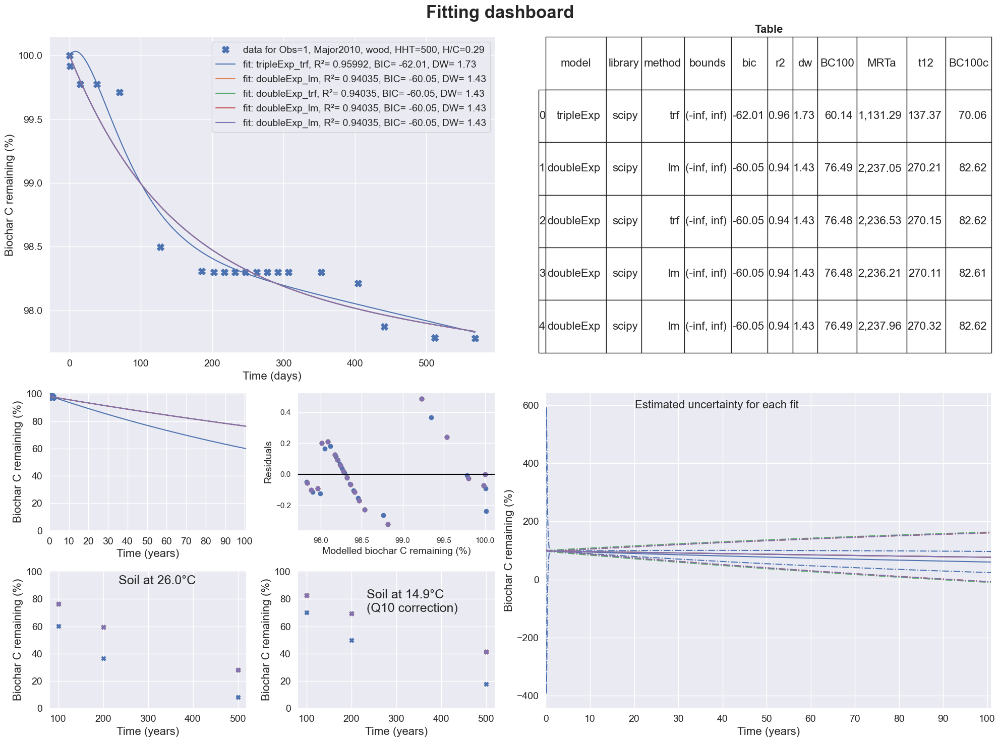

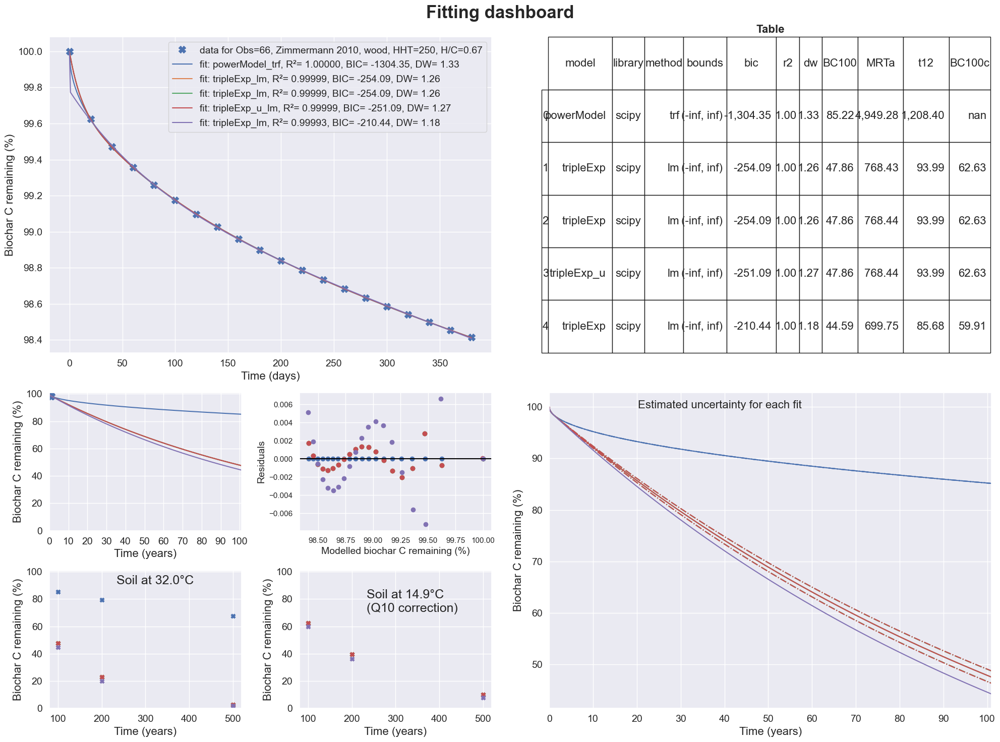

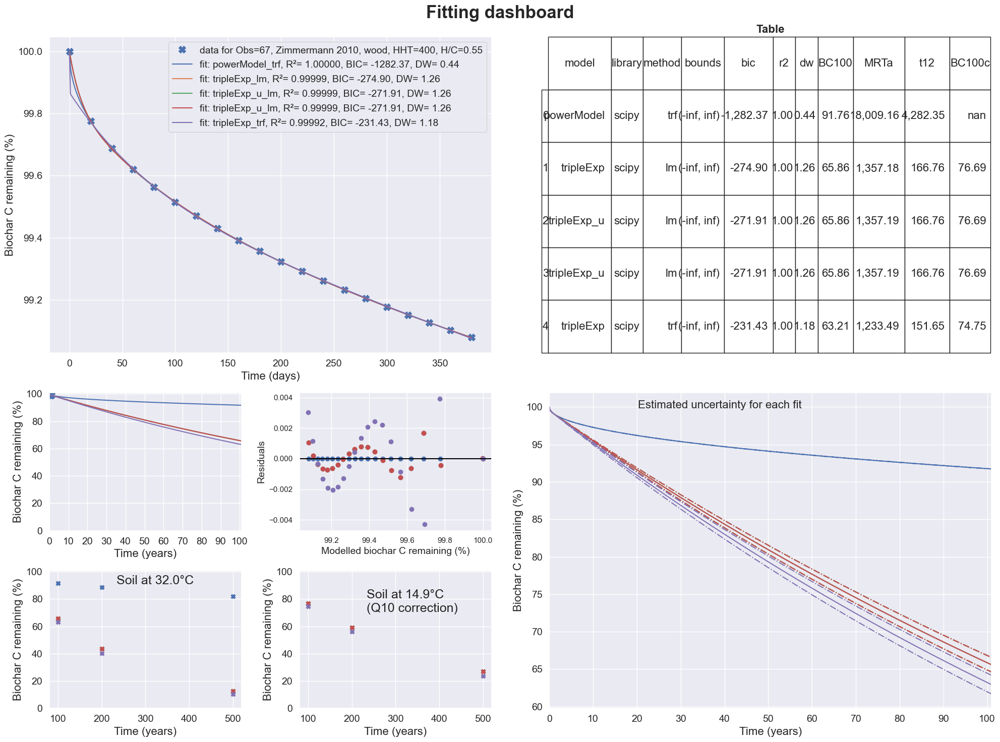

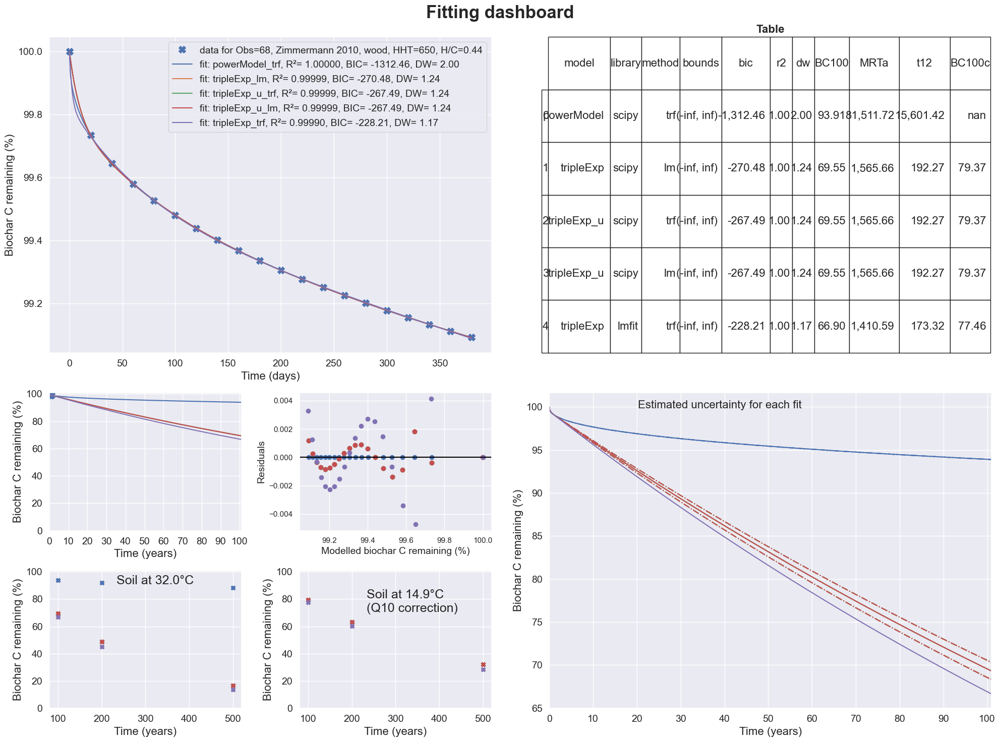

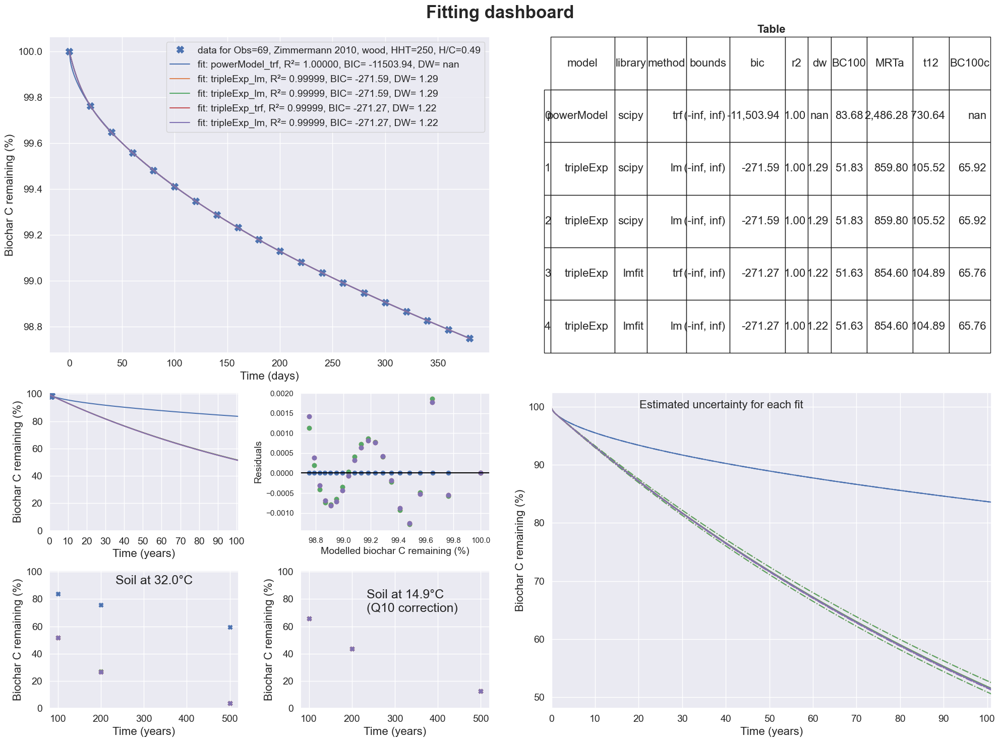

...

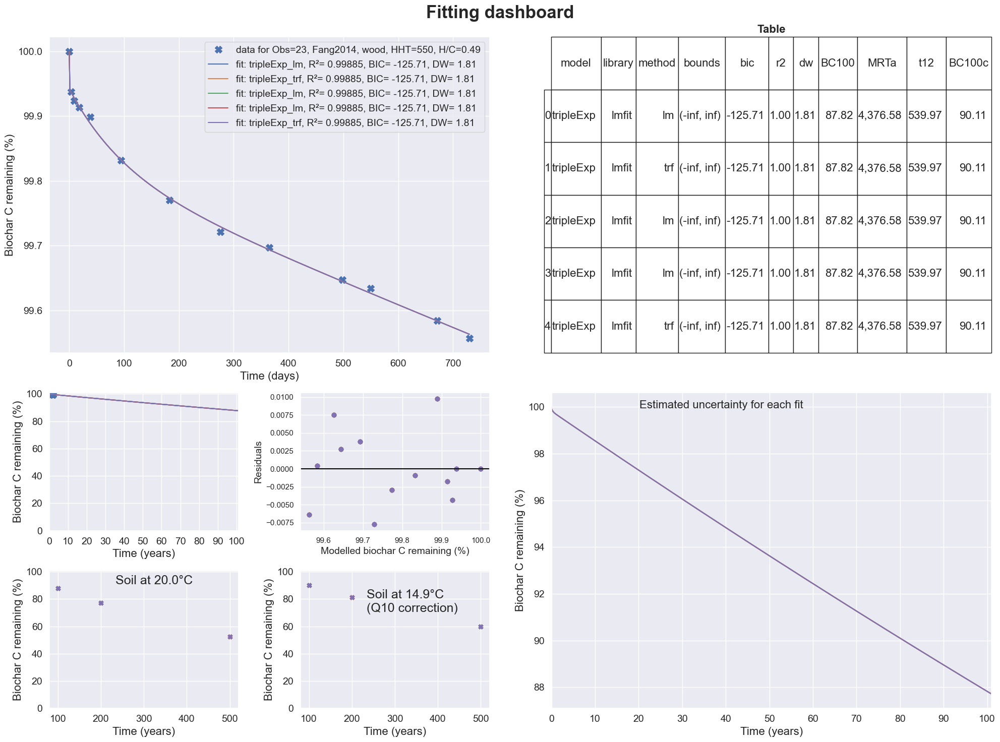

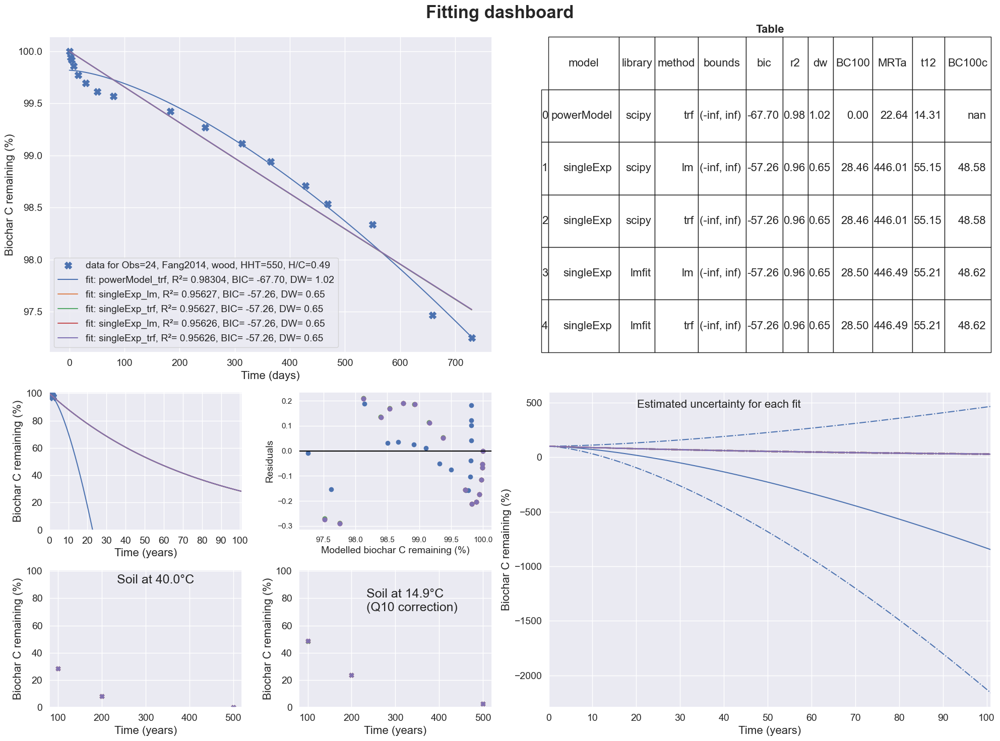

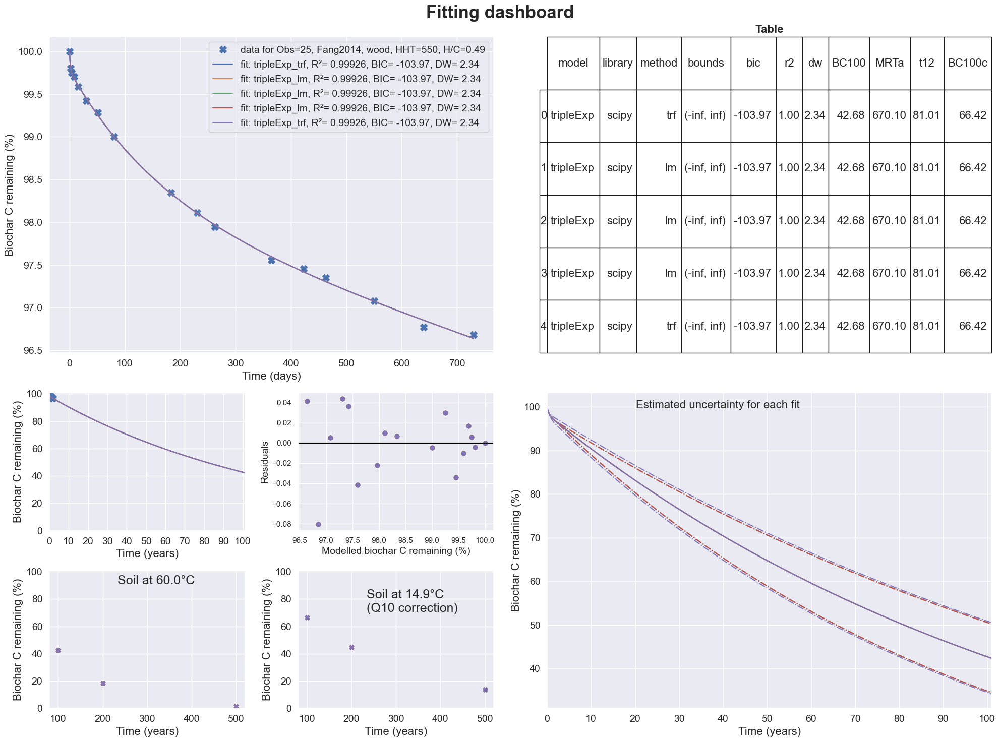

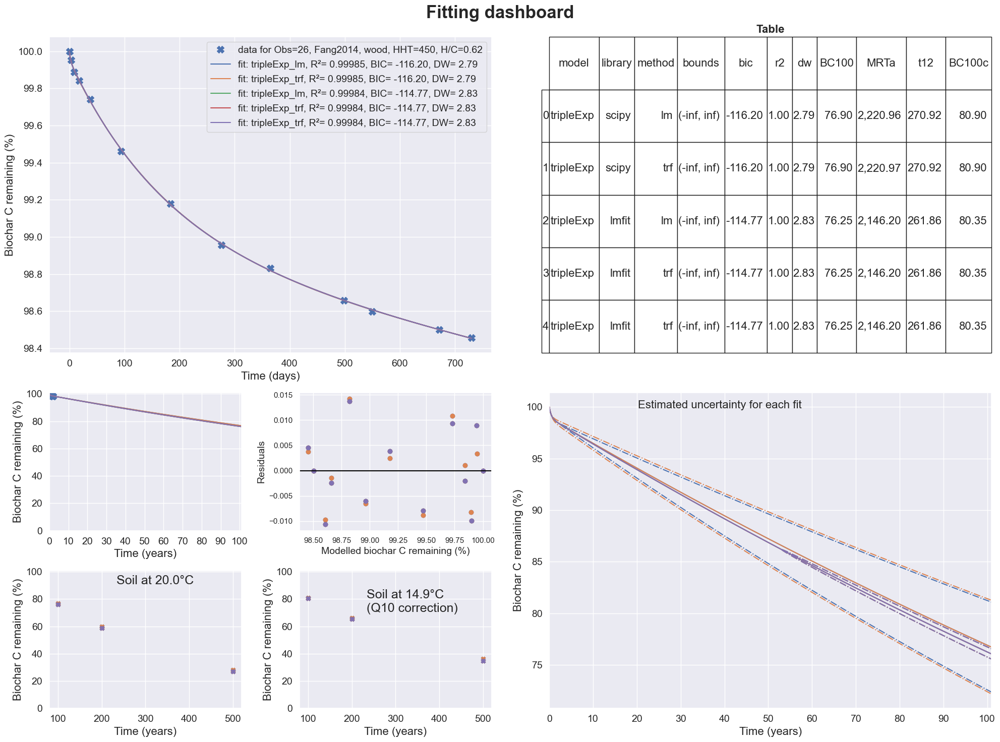

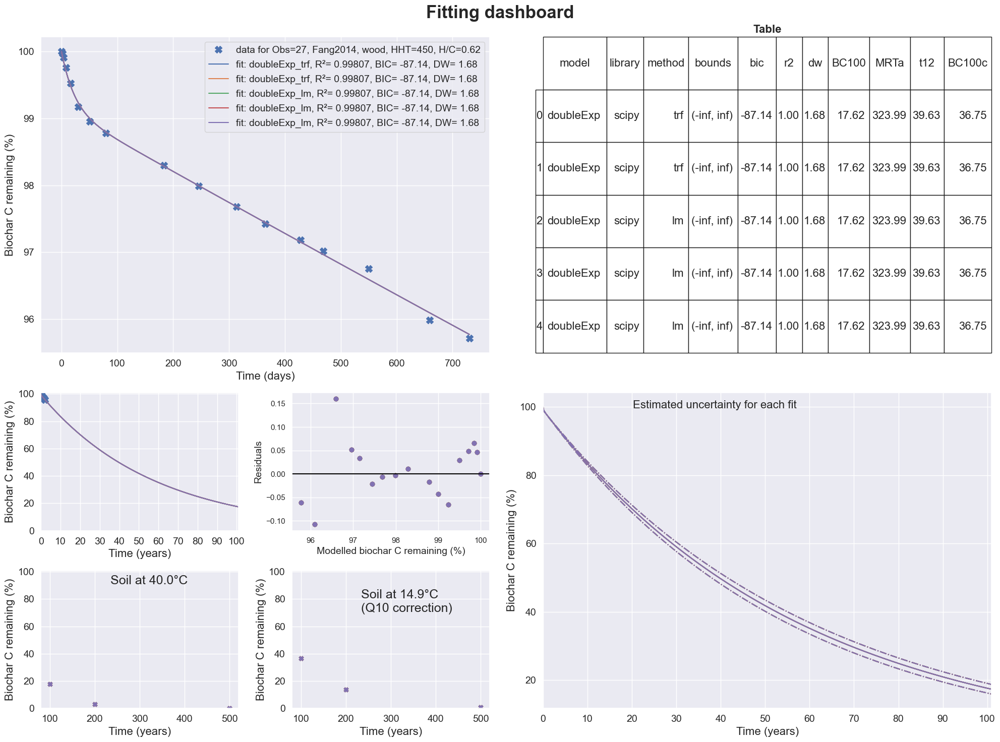

Error in callback <function flush_figures at 0x0000020078F111F0> (for post_execute):


KeyboardInterrupt: 

In [25]:
observations = metadata.index

for z, j in enumerate(observations):
    print(z,j)
    try:
        # select the fitdata for the observation
        ID_obs, x, y, xdataHighRes, sub = bs.select_multi_fits(j, df_all_fits_q10c, data, metadata, 
                                                            fit_limit=5, fit_rank='bic',
                                                            exclude_non_physical=True)
    except Exception:
        print(Exception)
        continue
        
    # initialise plot & insert
    fig = plt.figure(figsize=(20, 15))
    t = fig.suptitle("Fitting dashboard", fontsize=25, fontweight='bold')

    r = 4
    c = 4
    ax1 = plt.subplot(r,c,(1, 6)) # decay fits
    ax2 = plt.subplot(r,c,(9, 9)) # 100 year extrapo
    ax3 = plt.subplot(r,c,(10, 10)) # residuals
    ax4 = plt.subplot(r,c,(3, 8)) # table
    ax5 = plt.subplot(r,c,(13, 13)) # scatter multi-time horizon snapshots 
    ax6 = plt.subplot(r,c,(14, 14)) # q10 correction
    ax7 = plt.subplot(r,c,(11, 16)) # best fit with uncertainty and q10 correction

    _, ax1 = bs.plot_multi_fits(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax1, fig=fig)
    _, ax2 = bs.plot_multi_fits_extended(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax2, fig=fig)
    _, ax3 = bs.plot_multi_fits_residuals(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax3, fig=fig)

    _, ax4 = bs.plot_multi_fits_report(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax4, fig=fig)
    _, ax5 = bs.plot_multi_fits_snapshots(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax5, fig=fig)
    _, ax6 = bs.plot_multi_fits_snapshots_q10(ID_obs, x, y, xdataHighRes, sub, metadata, ax=ax6, fig=fig)

    _, ax7 = bs.plot_best_fits_uncertainty(ID_obs, x, y, xdataHighRes, sub, metadata, bic_limit=5, ax=ax7, fig=fig)


    fig.tight_layout()

    plt.savefig('../simulations/curvefits-p0/obs-'+str(ID_obs)+'.png', dpi=300)



## Testing: Select best fit based on criteria

In [421]:
fitdata = bs.load_fitted_observations('all_libs_allfits_p0.xlsx')
fitdata = bs.applyQ10(fitdata, metadata, tTs=14.9)

model_pool = ['singleExp', 'doubleExp', 'tripleExp', 'singleExp_u', 'doubleExp_u', 'tripleExp_u']

checks = {'decay rates positive':True,
          'pool sizes positive':True,
          #'pool sizes below100':'TRUE',
          'parameter constrained':True # Major2010 > double exponential would fail on that check, and resort to a single exp?
         }
spec_val = {}
rank = ('bic', True)

no_best, df_best = bs.select_best_fit(fitdata, model_pool, checks, spec_val, rank, saveExcel='all_libs_bestfits_p0.xlsx')
len(no_best), len(df_best)

0 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 singleExp 14.41425854901042 26.214534684742187
1 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 singleExp 14.4142520133938 26.21452646891217
2 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 singleExp_u 22.70287140673068 35.83680279826909
3 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 singleExp_u 22.70286599949025 35.83679691556735
4 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.48715846635959 82.61894462198626
5 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.48283114418501 82.61573666578562
6 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.49484421965968 82.62464208714857
7 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.49569873572361 82.62527602408993
8 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.4800863672781 82.61370182055337
9 11 Q10:  1.3947327240777447 fT:  0.6912179383096877 doubleExp 76.49569499403655 82.625273384377

248 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 41.77818900910379 57.53156272189664
249 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 41.77818747907687 57.531561397180795
250 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 48.5708423123061 63.240052669157954
251 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 48.57083830553948 63.24004939285808
252 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 41.77818143016796 57.53155615992767
253 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 41.77818140302448 57.53155613646658
254 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 0.0 0.0
255 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 41.77818193155982 57.53155659357374
256 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 60.48998635176757 72.57263373381956
257 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 57.09769122470558 69.9948067196

484 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 0.0 0.0
485 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 24.63509882492305 41.234394971184116
486 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
487 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 24.63511844646359 41.234415711783456
488 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
489 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 41.36866629967923 57.082986533597804
490 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
491 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
492 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 819124839.9692996 1776440.2937484528
493 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 37.96761577973948 54.0962008311172
494 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 37.96761710908798 54.09620201918681
495 11 Q10:  

747 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp 62.64027280400062 73.74175235654636
748 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp 9.15086016117121 22.058203454945556
749 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp 62.64119202484763 73.74243033492532
750 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 9.150865802868928 22.058212007984782
751 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 48.12749135196437 62.52033690679686
752 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 48.12805497891346 62.52079587878918
753 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 48.12728181796694 62.52016626145506
754 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 9.150864848706982 22.05821056185159
755 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 9.15086352881938 22.058208561421882
756 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 4

1217 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u nan nan
1218 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 65.85550197662441 76.74825269247191
1219 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 doubleExp_u 65.85546055999022 76.74822237492847
1220 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 0.0 0.0
1221 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 65.85541558463201 76.7481894526967
1222 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 70.65386869554324 80.21388060796596
1223 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 65.85541941333267 76.74819228234486
1224 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
1225 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 70.65380168546203 80.21383274648474
1226 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
1227 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp nan nan
12

1467 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u nan nan
1468 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u 93.57991276574984 95.09053656079517
1469 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 tripleExp_u 93.57990287687893 95.09052906584931
1470 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 powerModel 99.78331902921603 nan
1471 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 powerModel 96.90060531409982 nan
1472 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 singleExp 56.67541754909655 65.17107404714653
1473 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 singleExp 56.67539817715686 65.17105725076584
1474 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 singleExp_u 64.54500456870315 71.80929369609187
1475 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 singleExp_u 64.54499263890841 71.80928373984608
1476 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 68.21108691068919 74.83018473109627
1477 11 Q10:  

1851 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 29.18773088409079 49.205819698352116
1852 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 29.18778928864398 49.205875694588066
1853 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp 27.53160526905321 47.597893837320235
1854 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 26.77041120650633 46.84482992012763
1855 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u nan nan
1856 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u nan nan
1857 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u nan nan
1858 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 27.5316124447078 47.59790088511913
1859 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 29.18512624910855 49.20332285040144
1860 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u nan nan
1861 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp

2138 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 45.07204320718741 63.15648930157544
2139 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 45.07204494183128 63.15649068388878
2140 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp nan nan
2141 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp 45.07537802864049 63.159146291550506
2142 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp nan nan
2143 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp nan nan
2144 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp nan nan
2145 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp 45.03317829174108 63.12551839012767
2146 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp nan nan
2147 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp nan nan
2148 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp 3814.037145169615 604.0626093643324
2149 11 Q10:  1.24708347347464

2489 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 85.65565803791192 88.3394757686779
2490 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 85.65623126927626 88.33994627993506
2491 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 85.65621587978742 88.33993365758965
2492 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 83.0650830077704 86.20628471925897
2493 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 85.65563582343117 88.33945754364085
2494 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 85.6561620036046 88.33988943074338
2495 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 85.65616352681073 88.33989068101096
2496 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 83.06509162221057 86.20629182438806
2497 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 85.65570560678007 88.33951481385716
2498 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 87.1026

2659 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 74.33551506727378 78.74549931661377
2660 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
2661 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 75.88334781175767 80.04559813768822
2662 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
2663 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 39.42320322692593 47.5387870113001
2664 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
2665 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 76.90555763948191 80.90106624858473
2666 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 powerModel 99.23576151926534 nan
2667 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 powerModel 88.73813029895373 nan
2668 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 singleExp 9.289473023459925 25.53255148077384
2669 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 singleExp 

2981 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp_u 43.83673188579643 61.86538691815137
2982 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp_u 34.82094587635801 56.353705056424104
2983 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp_u 43.83670508127534 61.865365423305235
2984 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp_u nan nan
2985 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp_u 45.80974213394573 63.43077078034163
2986 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp_u 43.58906859011542 61.66660327260883
2987 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 tripleExp_u 43.58888699905502 61.66645719662168
2988 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 powerModel 98.45416075183931 nan
2989 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 powerModel 85.69996098126562 nan
2990 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 singleExp 2.069438093256695 16.194441260615065
2991 1

3253 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 62.62306723534297 68.46947874018235
3254 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
3255 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
3256 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 67.02592635324612 72.22451778678821
3257 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 64.2490506329272 69.8639499252948
3258 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 67.02597617367663 72.224559884865
3259 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 64.24870406723034 69.86365360156783
3260 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 67.02559607013016 72.22423866064217
3261 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 67.02556501606384 72.22421241916335
3262 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 67.02554438238421 72.224194982665
3263 11 Q10:  

3980 11 Q10:  1.668107719918026 fT:  0.8844356051446082 tripleExp 7.60401054630075 10.215689766645227
3981 11 Q10:  1.668107719918026 fT:  0.8844356051446082 tripleExp 10.76740954218285 13.890204669229007
3982 11 Q10:  1.668107719918026 fT:  0.8844356051446082 tripleExp nan nan
3983 11 Q10:  1.668107719918026 fT:  0.8844356051446082 tripleExp nan nan
3984 11 Q10:  1.668107719918026 fT:  0.8844356051446082 tripleExp nan nan
3985 11 Q10:  1.668107719918026 fT:  0.8844356051446082 tripleExp 7.603510759378286 10.21509728338683
3986 11 Q10:  1.668107719918026 fT:  0.8844356051446082 tripleExp 0.6797175232114655 1.2095807209633842
3987 11 Q10:  1.668107719918026 fT:  0.8844356051446082 tripleExp nan nan
3988 11 Q10:  1.668107719918026 fT:  0.8844356051446082 tripleExp 1700820553665.932 103174004881.37436
3989 11 Q10:  1.668107719918026 fT:  0.8844356051446082 tripleExp 10.76804879463602 13.890933073199626
3990 11 Q10:  1.668107719918026 fT:  0.8844356051446082 tripleExp_u nan nan
3991 11 Q10

4568 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 3.724520523563074e-05 0.0006819738834054206
4569 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u nan nan
4570 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 3.724496720400533e-05 0.0006819704082526664
4571 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 3.724625497579753e-05 0.0006819892090881868
4572 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 9.192519239043141e-17 3.7702261906664396e-13
4573 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 3.724566348874695e-05 0.0006819805735863931
4574 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u nan nan
4575 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u nan nan
4576 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 9.194052219538736e-17 3.770727471860931e-13
4577 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 3.724616420440727e-05

4891 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u nan nan
4892 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 57.43639000750647 64.21167297067073
4893 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u nan nan
4894 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 57.42299527389268 64.19972932034389
4895 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 57.42299341153275 64.19972765889285
4896 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 57.4447022841894 64.21905688387211
4897 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 57.4447048376261 64.21905916757808
4898 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 57.42300207313547 64.19973538351377
4899 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 55.2514965342754 62.2563103792314
4900 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
4901 11 Q10:  1.5530415047033828 fT:  0.

5164 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 71.67485003477671 76.52184909404922
5165 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 71.67489078989139 76.52188371822811
5166 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 77.28004881295087 81.24600284785683
5167 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u nan nan
5168 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 77.27997223883663 81.24593879202274
5169 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 77.2800316476838 81.24598848213186
5170 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 51.44616106055706 58.76916692598114
5171 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 77.27913487615889 81.24523846806804
5172 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u nan nan
5173 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 77.280062925775 81.24601465806607
5174 11 Q10: 

5460 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 78.98069507679524 82.73843525910013
5461 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp nan nan
5462 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
5463 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
5464 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 79.18692286214298 82.91036474603371
5465 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 79.18740943126258 82.91077058787079
5466 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 86.01723587673831 88.55213635605016
5467 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 79.40173969730722 83.08935439338921
5468 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
5469 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u nan nan
5470 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 79.18697129429344 82.9104

5964 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 38.04239542645885 54.162974861025006
5965 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 38.04239542645885 54.162974861025006
5966 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 38.04239542645885 54.162974861025006
5967 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 38.04239542645885 54.162974861025006
5968 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 29.90816534511925 45.094281608642426
5969 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 29.90816534511925 45.094281608642426
5970 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 29.90816534511925 45.094281608642426
5971 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 29.90816534511925 45.094281608642426
5972 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp_u 29.90816534511925 45.094281608642426
5973 11 Q10:  1.3092915914370866 fT:  0.63076529806001

6648 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 85.6589383662932 90.54687588944707
6649 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 85.6589383662932 90.54687588944707
6650 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 85.6589383662932 90.54687588944707
6651 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 85.6589383662932 90.54687588944707
6652 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 85.6589383662932 90.54687588944707
6653 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 85.6589383662932 90.54687588944707
6654 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 85.6589383662932 90.54687588944707
6655 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 85.6589383662932 90.54687588944707
6656 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 85.6589383662932 90.54687588944707
6657 11 Q10:  1.3092915914370866 fT:  0.6307652980600114 tripleExp 85.658938366293

6857 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 singleExp_u 69.06393919990718 75.61668510916873
6858 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 70.78187559864348 77.01498029299678
6859 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 70.78187559864348 77.01498029299678
6860 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 70.78187559864348 77.01498029299678
6861 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 70.78187559864348 77.01498029299678
6862 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 70.78187559864348 77.01498029299678
6863 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 70.78187559864348 77.01498029299678
6864 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 70.78187559864348 77.01498029299678
6865 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 70.78187559864348 77.01498029299678
6866 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 70.7

7181 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 32.24068711544921 42.40986413405789
7182 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 32.24068711544921 42.40986413405789
7183 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 32.24068711544921 42.40986413405789
7184 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 32.24068711544921 42.40986413405789
7185 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 32.24068711544921 42.40986413405789
7186 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 32.24068711544921 42.40986413405789
7187 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 32.24068711544921 42.40986413405789
7188 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 32.24068711544921 42.40986413405789
7189 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp 32.24068711544921 42.40986413405789
7190 11 Q10:  1.4883353570075042 fT:  0.7540192486404629 doubleExp_u 29.9

7604 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 42.66070864372686 61.21189714060044
7605 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 42.66070864372686 61.21189714060044
7606 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 42.66070864372686 61.21189714060044
7607 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 42.66070864372686 61.21189714060044
7608 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 42.66070864372686 61.21189714060044
7609 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 42.66070864372686 61.21189714060044
7610 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 42.66070864372686 61.21189714060044
7611 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 42.66070864372686 61.21189714060044
7612 11 Q10:  1.2470834734746485 fT:  0.5745161413354435 doubleExp_u 42.66070864372686 61.21189714060044
7613 11 Q10:  1.2470834734746485 fT:  0.574516141335443

7949 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp_u 0.2727065130859861 6.221923484875015
7950 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp_u 0.2727065130859861 6.221923484875015
7951 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp_u 0.2727065130859861 6.221923484875015
7952 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp_u 0.2727065130859861 6.221923484875015
7953 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp_u 0.2727065130859861 6.221923484875015
7954 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp_u 0.2727065130859861 6.221923484875015
7955 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp_u 0.2727065130859861 6.221923484875015
7956 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 powerModel 0.0 nan
7957 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 powerModel 0.0 nan
7958 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp 77.63041519709597 81.685625502

8645 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 tripleExp_u 25.45077567731307 52.48229546109299
8646 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 powerModel 0.0 nan
8647 11 Q10:  1.1825431388578633 fT:  0.46945650711012077 powerModel 0.0 nan
8648 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp 41.23304779892839 49.2738611398812
8649 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp 41.23304779892839 49.2738611398812
8650 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp_u 61.77803348290771 67.75698441562312
8651 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 singleExp_u 61.77803348290771 67.75698441562312
8652 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 63.73890712099552 69.44579854039223
8653 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 63.73890712099552 69.44579854039223
8654 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp 63.73890712099552 69.44579854039223
8655 11 Q10:  1.5

9257 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp 34.43787358441937 45.619985459624175
9258 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp 34.43787358441937 45.619985459624175
9259 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp 34.43787358441937 45.619985459624175
9260 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 40.01670962108114 47.82189271323903
9261 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 40.01670962108114 47.82189271323903
9262 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 40.01670962108114 47.82189271323903
9263 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 40.01670962108114 47.82189271323903
9264 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 40.01670962108114 47.82189271323903
9265 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 doubleExp_u 40.01670962108114 47.82189271323903
9266 11 Q10:  1.4610341801397224 fT:  0.7355718410032391 d

9924 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 60.99738092035076 67.37343064243898
9925 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 60.99738092035076 67.37343064243898
9926 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 60.99738092035076 67.37343064243898
9927 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 60.99738092035076 67.37343064243898
9928 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 60.99738092035076 67.37343064243898
9929 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 60.99738092035076 67.37343064243898
9930 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 60.99738092035076 67.37343064243898
9931 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 60.99738092035076 67.37343064243898
9932 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 60.99738092035076 67.37343064243898
9933 11 Q10:  1.5530415047033828 fT:  0.798907757473073

10324 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 53.79021533953052 60.93610072891352
10325 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 53.79021533953052 60.93610072891352
10326 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 53.79021533953052 60.93610072891352
10327 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 doubleExp_u 53.79021533953052 60.93610072891352
10328 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 55.48278557858648 62.4594434993557
10329 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 55.48278557858648 62.4594434993557
10330 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 55.48278557858648 62.4594434993557
10331 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 55.48278557858648 62.4594434993557
10332 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 55.48278557858648 62.4594434993557
10333 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tri

10888 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 98.04698079864967 98.28853016313201
10889 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp 98.04698079864967 98.28853016313201
10890 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 74.46831250239457 78.97382139457447
10891 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 74.46831250239457 78.97382139457447
10892 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 74.46831250239457 78.97382139457447
10893 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 74.46831250239457 78.97382139457447
10894 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 74.46831250239457 78.97382139457447
10895 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 74.46831250239457 78.97382139457447
10896 11 Q10:  1.5530415047033828 fT:  0.7989077574730733 tripleExp_u 74.46831250239457 78.97382139457447
10897 11 Q10:  1.5530415047033828 fT:  0.798907757

(0, 119)

## Testing: Filter list of observations based on criteria

In [22]:
# starting from all observations in the dataset, filters out a subset of observations for building the stability model
# reasons for excluding variables shall be motivated
obs = metadata.index
obs = bs.apply_has_decay_data(obs, metadata, data, withPrint=True) # obvious

# we excluded observations with pyrolysis temperature below 150, as they correspond to biomass control (dried biomass, not biochar)
obs = bs.apply_exclude_by_numeric(obs, metadata, var='HHT', excl_lower_than=150, excl_higher_than=None, withPrint=True)

# we excluded incubations durations shorter than 1.5 years because...
obs = bs.apply_exclude_by_duration(obs, metadata, excl_shorter_than=365*1., excl_longer_than=None) 

# we could selectively remove some observations because they have bad decay data or poor fitting
obs = bs.apply_exclude_exactly(obs, excl=[])

Applying: HasDecayData. Excluded 45 observations, reducing from 166 to 121 remaining observations.
Applying: HHT. Excluded 2 observations, reducing from 121 to 119 remaining observations.
Applying: IncubationDuration. Excluded 7 observations, reducing from 119 to 112 remaining observations.
Applying: RemoveExactly. Excluded 0 observations, reducing from 112 to 112 remaining observations.


In [23]:
for_model = bs.apply_intersect_best_fits(obs, df_best)
for_model.head()

NameError: name 'df_best' is not defined

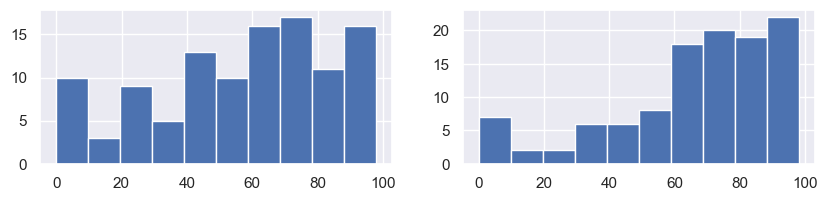

In [16]:
fig = plt.figure(figsize=(10, 2))
r = 1
c = 2
ax1 = plt.subplot(r,c,(1, 1)) # decay fits
ax2 = plt.subplot(r,c,(2, 2)) # 100 year extrapo
ax1 = for_model['BC100'].hist(ax=ax1)
ax2 = for_model['BC100c'].hist(ax=ax2) 

In [19]:
for_model['model'].value_counts()

tripleExp      64
doubleExp      29
doubleExp_u     7
singleExp_u     4
singleExp       4
tripleExp_u     2
Name: model, dtype: int64

In [20]:
for_model['library'].value_counts()

scipy    99
lmfit    11
Name: library, dtype: int64

In [21]:
for_model[['p0']].value_counts(dropna=False)

p0                               
NaN                                  37
[0.001, 0.1, 1, 100, 50]             22
[1e-06, 0.001, 0.1, 100, 50]         13
[1e-06, 0.001, 100]                   8
[0.0001, 1, 100]                      7
[1e-08, 0.001, 100]                   6
[1e-05, 10, 100]                      4
[1e-08, 1e-05, 0.001, 100, 50]        4
[0.0001, 1, 100, 1]                   2
[1e-06, 0.001, 1, 100, 50]            2
[1e-06, 0.001, 100, 1]                2
[1e-06, 0.001, 0.1, 100, 50, 1]       1
[1e-08, 0.001, 100, 1]                1
[1e-08, 1e-05, 0.001, 100, 50, 1]     1
dtype: int64

In [425]:
for_model.to_excel('bestfitdata-p0_2022-10-27.xlsx')
for_model.head()

name,ID_obs,id,library,method,model,bounds,p0,k,c,k1,...,"cov(k2, c3)","cov(k3, c3)","cov(c1, c3)","cov(c2, c3)","cov(c0, b)","cov(c0, m)","cov(b, m)",Q10,fT,BC100c
5478,1,4,lmfit,lm,doubleExp,"(-inf, inf)",NaN,NaN,NaN,7.284478e-03,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.394733,0.691218,82.674756
3455,3,5,scipy,trf,doubleExp,"(-inf, inf)",NaN,NaN,NaN,5.488576e-02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,91.975456
3506,4,10,scipy,trf,doubleExp,"(-inf, inf)","[1e-06, 0.001, 100]",NaN,NaN,9.894254e-07,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,97.338856
3548,5,6,scipy,lm,doubleExp,"(-inf, inf)","[1e-06, 0.001, 100]",NaN,NaN,1.453973e-06,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,96.223473
3611,6,23,scipy,trf,doubleExp_u,"(-inf, inf)","[0.0001, 1, 100, 1]",NaN,NaN,2.364230e-06,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,93.985261


## Testing: Comparison best-fits with Woolf et al. 2022

In [18]:
for_model =pd.read_excel('../simulations/bestfitdata-p0_2022-10-27.xlsx', index_col=0)
for_model.head()

,ID_obs,id,library,method,model,bounds,p0,k,c,k1,...,"cov(k2, c3)","cov(k3, c3)","cov(c1, c3)","cov(c2, c3)","cov(c0, b)","cov(c0, m)","cov(b, m)",Q10,fT,BC100c
5478,1,4,lmfit,lm,doubleExp,"(-inf, inf)",NaN,NaN,NaN,7.284478e-03,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.394733,0.691218,82.674756
3455,3,5,scipy,trf,doubleExp,"(-inf, inf)",NaN,NaN,NaN,5.488576e-02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,91.975456
3506,4,10,scipy,trf,doubleExp,"(-inf, inf)","[1e-06, 0.001, 100]",NaN,NaN,9.894254e-07,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,97.338856
3548,5,6,scipy,lm,doubleExp,"(-inf, inf)","[1e-06, 0.001, 100]",NaN,NaN,1.453973e-06,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,96.223473
3611,6,23,scipy,trf,doubleExp_u,"(-inf, inf)","[0.0001, 1, 100, 1]",NaN,NaN,2.364230e-06,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,93.985261


In [13]:
# we start with 2 dataframes: 
# - metadata (just because it contains all the properties) (could filter on the relevant observations only) & 
# - for_model (which contains the best fit of the selected observations for the model)

Benchmark of our fit procedures to the one performed by Woolf 2021; noting that we don't have the same incubation data (we probably digitized differently) and only a partial overlap of observations.

In [14]:
# load woolf data
woolf_fp= '../biocharStability/database/former-assessment/2021_Woolf_EST_Supporting Information_edited_ESA.xlsx'
woolf = pd.read_excel(woolf_fp, sheet_name='Fperm', index_col=None, usecols='A:T', skiprows=7)
woolf.set_index('ID_Woolf2021', inplace=True)

C:\anaconda\envs\bw2\lib\site-packages\openpyxl\worksheet\_read_only.py:79: UserWarning: Unknown extension is not supported and will be removed
  for idx, row in parser.parse():
C:\anaconda\envs\bw2\lib\site-packages\openpyxl\worksheet\_read_only.py:79: UserWarning: Conditional Formatting extension is not supported and will be removed
  for idx, row in parser.parse():


In [15]:
woolf_ids = list(woolf.index)
subset_metadata = metadata[metadata['ID_Woolf2021'].isin(woolf_ids)]
subset_data = data[ data['ID_obs'].isin(list(subset_metadata.index))]
subset_ids = list(subset_metadata.index)
subset_fitdata = for_model[ for_model['ID_obs'].isin(subset_ids)].copy(deep=True)
subset_fitdata['ID_Woolf2021'] = [ subset_metadata.loc[ids, 'ID_Woolf2021'] for ids in subset_fitdata['ID_obs']] # the matching

cols=['Molar Hydrogen to organic carbon ratio of the biochar', 'Temperature at which decomposition experiment was conducted (°C)',
 'C1', 'C2', 'C3', 'k1', 'k2', 'k3', 'Q10', 'fT', 'k1_fperm', 'k2_fperm', 'k3_fperm', 'Fperm', 'Fperm,initial', 'DeltaFperm']
subset_fitdata_ext = subset_fitdata.merge(woolf[cols], on='ID_Woolf2021', suffixes=(None, '_W'), validate='1:1') # the dataframe with both data

print("Our dataset & Woolf dataset have {} observations in common, for metadata.".format(len(subset_ids)))
print("Our dataset & Woolf dataset have {} observations in common, for metadata and fitdata.".format(len(subset_fitdata_ext)))


Our dataset & Woolf dataset have 71 observations in common, for metadata.
Our dataset & Woolf dataset have 66 observations in common, for metadata and fitdata.


In [16]:
subset_fitdata_ext

,ID_obs,id,library,method,model,bounds,p0,k,c,k1,...,k2_W,k3_W,Q10_W,fT_W,k1_fperm,k2_fperm,k3_fperm,Fperm,"Fperm,initial",DeltaFperm
0,1,4,lmfit,lm,doubleExp,"(-inf, inf)",NaN,NaN,NaN,7.284478e-03,...,0.002472,0.0,1.394733,0.691218,1.837230,0.001709,0.0,0.827614,0.766794,0.060820
1,3,5,scipy,trf,doubleExp,"(-inf, inf)",NaN,NaN,NaN,5.488576e-02,...,0.001167,0.0,1.414552,0.704490,13.533621,0.000822,0.0,0.919794,0.888619,0.031176
2,4,10,scipy,trf,doubleExp,"(-inf, inf)","[1e-06, 0.001, 100]",NaN,NaN,9.894254e-07,...,0.000353,0.0,1.414552,0.704490,6.949697,0.000249,0.0,0.973844,0.963725,0.010120
3,5,6,scipy,lm,doubleExp,"(-inf, inf)","[1e-06, 0.001, 100]",NaN,NaN,1.453973e-06,...,0.000527,0.0,1.414552,0.704490,14.285489,0.000372,0.0,0.962465,0.947581,0.014885
4,6,23,scipy,trf,doubleExp_u,"(-inf, inf)","[0.0001, 1, 100, 1]",NaN,NaN,2.364230e-06,...,0.001030,0.0,1.414552,0.704490,12.244705,0.000726,0.0,0.928807,0.900966,0.027841
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61,125,25,scipy,trf,tripleExp,"(-inf, inf)",NaN,NaN,NaN,4.299380e-02,...,0.003187,0.0,1.553042,0.798908,209.254511,0.002546,0.0,0.767205,0.719580,0.047626
62,126,24,lmfit,lm,tripleExp,"(-inf, inf)",NaN,NaN,NaN,6.177780e-03,...,0.001023,0.0,1.553042,0.798908,119.326645,0.000817,0.0,0.917351,0.898673,0.018678
63,127,29,scipy,lm,tripleExp,"(-inf, inf)","[0.001, 0.1, 1, 100, 50]",NaN,NaN,7.492817e-07,...,0.001556,0.0,1.553042,0.798908,82.162513,0.001243,0.0,0.880612,0.853485,0.027127
64,128,24,lmfit,lm,tripleExp,"(-inf, inf)",NaN,NaN,NaN,3.821340e-03,...,0.001710,0.0,1.553042,0.798908,99.150980,0.001366,0.0,0.869266,0.839884,0.029382


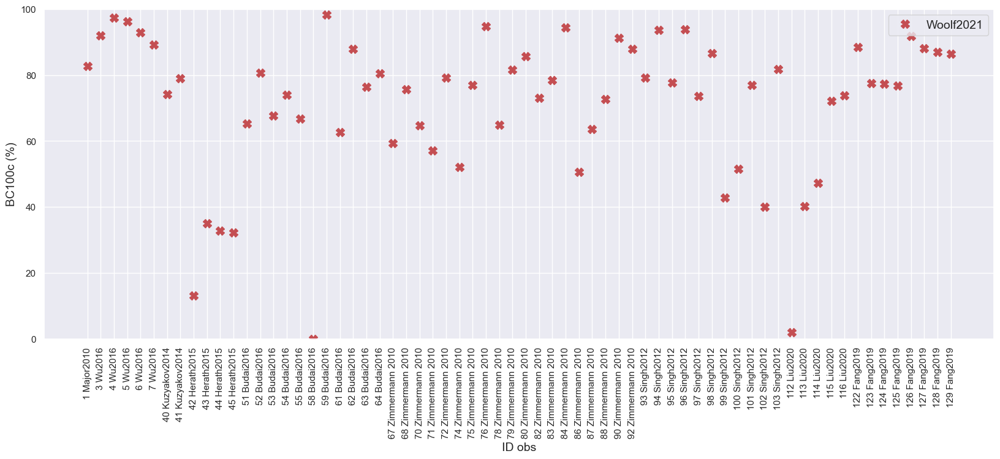

In [17]:
fig, ax = plt.subplots(figsize=(20,7))
j=10
#woolfies = list(final.drop_duplicates(subset=['ID_obs'])['Fperm,initial'])
ax.plot(subset_fitdata_ext['Fperm']*100, 'rX', markersize=j)

ax.xaxis.grid()
ax.yaxis.grid()

#names = [ ad+' - '+str(idobs) for ad, idobs in zip(df_comp['AuthorDate'], df_comp['ID_obs']) ]
names = list(subset_fitdata_ext['ID_obs'])
names = [ str(i)+' '+metadata.loc[i, 'AuthorDate'] for i in list(subset_fitdata_ext['ID_obs'])]

plt.xticks(ticks=np.arange(0, len(subset_fitdata_ext)), labels=names)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, horizontalalignment='center')
plt.xlabel('ID obs', fontsize=14)
plt.ylabel('BC100c (%)', fontsize=14)
ax.set_ylim(0,100)
plt.legend(['Woolf2021', 'Some naive fits'], fontsize=14)
plt.grid()

if False:
    plt.savefig('img/comparison-woolf-alone.png', dpi=300, bbox_inches='tight')

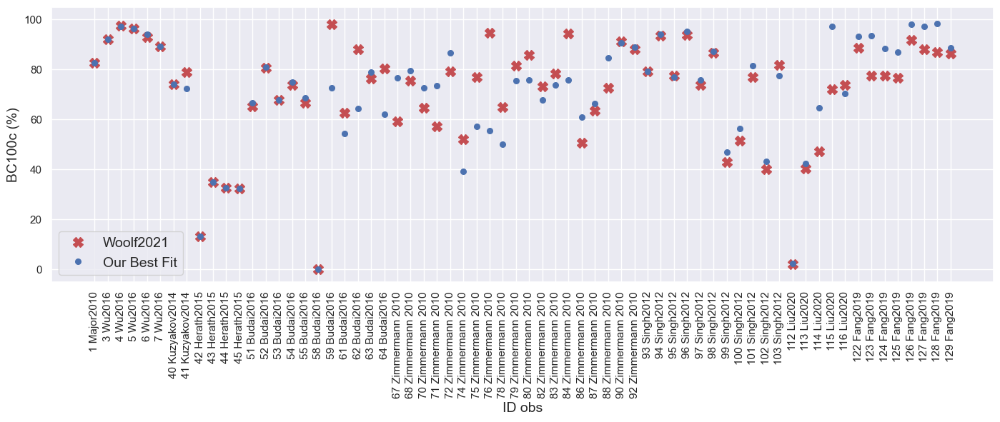

In [18]:
fig, ax = plt.subplots(figsize=(17,5))

j=10
ax.plot(subset_fitdata_ext['Fperm']*100, 'rX', markersize=j)
j=11
ax.plot(subset_fitdata_ext['BC100c'], 'b.', markersize=j)



ax.xaxis.grid()
ax.yaxis.grid()

#names = [ ad+' - '+str(idobs) for ad, idobs in zip(df_comp['AuthorDate'], df_comp['ID_obs']) ]
names = list(subset_fitdata_ext['ID_obs'])
names = [ str(i)+' '+metadata.loc[i, 'AuthorDate'] for i in list(subset_fitdata_ext['ID_obs'])]

plt.xticks(ticks=np.arange(0, len(subset_fitdata_ext)), labels=names)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, horizontalalignment='center')
plt.xlabel('ID obs', fontsize=14)
plt.ylabel('BC100c (%)', fontsize=14)
ax.set_ylim(0-5,100+5)
plt.legend(['Woolf2021', 'Our Best Fit'], fontsize=14)
plt.grid()

if True:
    plt.savefig('../simulations/comparison-woolf-fits-p0.png', dpi=300, bbox_inches='tight')

Differences between Woolf & our data can arise from several factors:

- We may have performed a `not good enough fit`, and need to improve it (using initial guess and bounds)

- Woolf incubation data and our incubation data are slightly different:
        - We may have digitized figures differently, 
        - Woolf may have had primary data while we had only digitized or modelled data (in particular, likely for Zimmerman observations, for which I reconstructred incubation curves from powerModel parameters given by Zimmerman)

- For the Fang observations, we have incubation data for 2 years, while Woolf used incubation data from an older paper based on 1 year experimental duration. This can be seen in the result has we nearly systematically overestimate BC100c compared to Woolf, which is usually the case when experiments get longer.

We can compare further the two datasets by plotting our raw data, our best fit, and Woolf's best fit (before temperature correction).

In [19]:
ID_obs=1
def plot_woolf_comparison(ID_obs, subset_fitdata_ext, data, metadata):
    ID_obs, x, y, xdataHighRes, sub = bs.select_multi_fits(ID_obs, subset_fitdata_ext, data, metadata)

    AuthorDate = metadata.loc[ID_obs, 'AuthorDate']
    BiomassClass = metadata.loc[ID_obs, 'BiomassClass']
    HHT=metadata.loc[ID_obs, 'HHT']
    HC= metadata.loc[ID_obs, 'H/C_tot'] if not (metadata.loc[ID_obs, 'H/C_tot'] == 'na' ) else -1

    #fig, ax = plt.subplots(figsize=(14,6))
    fig = plt.figure(figsize=(14,6))
    r = 1
    c = 3
    ax = plt.subplot(r,c,(1, 2)) # decay fits
    ax2 = plt.subplot(r,c,(3, 3)) # 100 year extrapo

    ax.plot(x, y, 'kX', ms=10, 
        label='data for Obs={obs}, {AuthorDate}, {Bio}, HHT={HHT:.0f}, H/C={HC:.2f}'.format(
            obs=ID_obs, AuthorDate=AuthorDate, Bio=BiomassClass,
            HHT=HHT,
            HC= HC
        ))


    map_model_function = {
        "singleExp":bs.singleExp,
        "singleExp_u":bs.singleExp_u,
        "doubleExp":bs.doubleExp,
        "doubleExp_u":bs.doubleExp_u,
        "tripleExp":bs.tripleExp,
        "tripleExp_u":bs.tripleExp_u,
        "powerModel":bs.powerModel,
    }
    tpl_model = 'model'
    tpl_method = 'method'
    tpl_r2 = 'r2'
    tpl_ID_obs = 'ID_obs'
    tpl_bic = 'bic'
    tpl_DW = 'dw'

    sub = sub.iloc[0] # there is only one row here! 
    f_model = map_model_function[sub[tpl_model]]
    method = sub[tpl_method]
    r2= sub[tpl_r2]
    bic=sub[tpl_bic]
    dw = sub[tpl_DW]
    param_cols = ['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c0', 'b', 'm', 'c3',]
    params = sub[param_cols].dropna()

    def sort_params(f_model, params):
        '''
        Sort parameters from the dataframe, so they match the order of the params in the model function
        f_model : a python function, with arguments (t, p1, p2, p3)
        param_names : a list of str p1, p2, p3 
        param_values: a list of values, in the order of the param_names
        Returns: param_names and param_values in same order as required by f_model 
        '''
        param_names = params.index.to_list()
        param_values = params.values #.flatten()
        dic = {p:v for p,v in zip(param_names, param_values)}
        f_params = getfullargspec(f_model)[0][1:] # excluding time
        p_opt_values =[dic[k] for k in f_params]
        return f_params, p_opt_values

    p_opt_names, p_opt = sort_params(f_model, params)

    ax.plot(xdataHighRes, f_model(xdataHighRes, *p_opt), '-',
            label='fit: {fit}, R\u00B2= {r2:.5f}, BIC= {bic:.2f}, DW= {dw:.2f}'.format(
                    fit=f_model.__name__+'_'+str(method), 
                    r2=r2, 
                    bic=bic, 
                    dw=dw),
                   )
    
    xdata100 = np.arange(0, 365*101, 10)
    ax2.plot(xdata100, f_model(xdata100, *p_opt), '-',
            label='fit: {fit}'.format(fit=f_model.__name__+'_'+str(method)))
    # Woolf's fit to plot
    param_woolf_pool = ['C1','C2', 'C3']
    param_woolf_decay = ['k1_W', 'k2_W', 'k3_W']
    param_woolf = param_woolf_pool + param_woolf_decay
    params = sub[param_woolf].dropna()
    params[param_woolf_pool] = params[param_woolf_pool].multiply(other=100)
    params[param_woolf_decay] = params[param_woolf_decay].multiply(other=1/365)
    params.rename({'C1':'c1','C2':'c2', 'C3':'c3', 'k1_W':'k1', 'k2_W':'k2', 'k3_W':'k3'}, inplace=True)

    p_opt_names, p_opt = sort_params(bs.tripleExp_u, params)


    if len(params[params == 0]) == 2:
        m = 'doubleExp_u'
    elif len(params[params == 0]) == 0:
        m = 'tripleExp_u'
    elif len(params[params == 0]) == 4:
        m = 'singleExp'
    ax.plot(xdataHighRes, bs.tripleExp_u(xdataHighRes, *p_opt), '-',
            label='fit: {} from Woolf2021'.format(m)
            )
    ax2.plot(xdata100, bs.tripleExp_u(xdata100, *p_opt), '-',
            label='fit: {} from Woolf2021'.format(m)
            )

    ## annotate the chart
    ax.set_xlabel('Time (days)', fontsize=16)
    ax.set_ylabel('Biochar C remaining (%)', fontsize=16) 
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.legend(fontsize=14);

    x_ticks = [day for day in xdata100 if day%3650 == 0] # Only pull out full years
    x_labels = [str(i//365) for i in x_ticks]
    #ax2.yaxis.tick_right()
    ax2.set_xlabel('Time (years)', fontsize=16)
    ax2.set_xticks(x_ticks)
    ax2.set_xticklabels(x_labels)
    ax2.set_xlim(0, 365*101)
    ax2.set_ylabel('Biochar C remaining (%)', fontsize=16)
    ax2.set_ylim(0-5, 100+5)
    ax2.tick_params(axis='both', which='major', labelsize=14)
    
    saveTo = '../simulations/woolf-comparison-p0/ID_obs_'+str(ID_obs)+'.png'
    if saveTo is not False:
        #print("saving chart to:", saveTo)
        fig.tight_layout()
        fig.savefig(saveTo, dpi=300)        
        plt.close()
    return fig, ax

KeyboardInterrupt: 

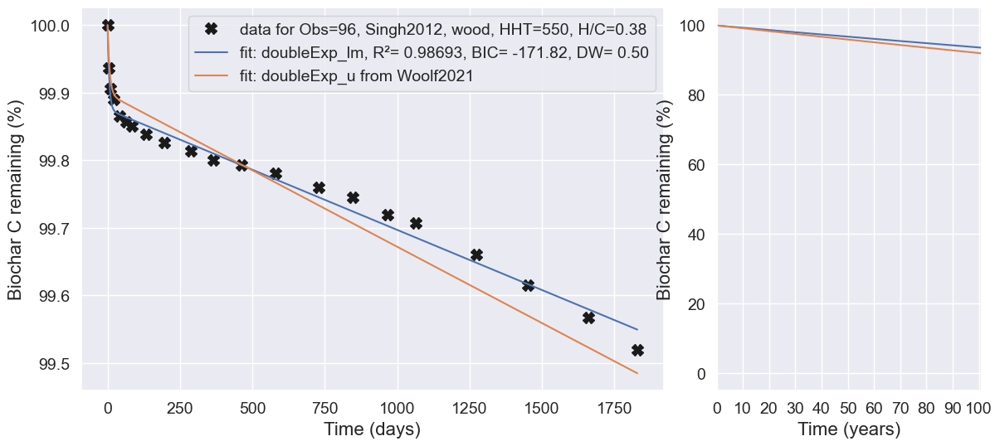

In [35]:
for i in subset_fitdata_ext['ID_obs']:
    plot_woolf_comparison(i, subset_fitdata_ext, data, metadata)

![comparison-naive-fits](simulations/comparison-woolf-fits.png)


**Looking at the figures plotted above (without specifying initial guess p0 in the fitting strategies), we noticed**:

- Sing2012, Wu2016, Liu2020: pretty similar results


- Major2010: 1 observation, very different, due to our "constraint" on uncertainty of the fit, which is way to high for a double exponential compared to a single exponential. Otherwise, we would have found similar fit.


- Herath2015 observations: we need to better constraint the fit


- Budai2016: there are a 3 observations with a large difference, to investigate


- Zimmerman2010 observations: it would be better to have the primary incubation data, rather than the current simulated data based on the powerModel parameters reported by Zimmerman


- Kuzyakov2014: good for 1 out of 2 observations; maybe difference in digitizing


- Farang2019: we tend to have higher stability, but we also know having different incubation data (1 year longer)


![comparison-naive-fits](simulations/comparison-woolf-fits-p0.png)

**Looking at the figures plotted above (after specifying initial guess p0 in the fitting strategies), we noticed**:

- Sing2012, Wu2016, pretty similar results

- Liu2020: 2 out of 4 observations have now much higher stability than without p0 guesses; before we had similar match to Woolf on all 4 observations


- Major2010: we now get same fit, passing uncertainty test


- Herath2015 observations: initial guess helped finding better solution


- Budai2016: initial guess helped finding better solution - but the data still has irregularities that are not matching an exponential function


- Zimmerman2010 observations: it would be better to have the primary incubation data, rather than the current simulated data based on the powerModel parameters reported by Zimmerman


- Kuzyakov2014: despite initial guesses, still a difference in projection, both fits "look" equally good, but lead to 5-10% difference in 100 years


- Farang2019: we still tend to have higher stability, but now with p0 guesses, stability is even higher


### Reproduce linear correlations between BC100 and single metadata

In [4]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, explained_variance_score

def rebuild_cov2(f_model, params, stdev, covar):
    '''
    Rebuild the covariance matrix, in correct order from data saved as Excel...
    '''    
    f_params = getfullargspec(f_model)[0][1:] # excluding time

    param_names = params.index.to_list()
    param_values = params.values
    param_std_values = stdev.values # in same order as above
    covar = covar #.droplevel(level=[0,2])
    
    def search_param(param_names, p):
        '''Returns an integer, position of search of param in params'''
        for s in range(len(params)):
            if p in param_names[s]:
                return s
    
    def search_covar(covar, p1, p2):
        '''Returns an integer, position of search covariance in matrix'''
        for s in range(len(covar.index)):
            if p1 in covar.index[s] and p2 in covar.index[s]:
                return s

    dicVal = {p:v for p,v in zip(param_names, param_values) if p in f_params}
    dicStdev = {p:v for p,v in zip(param_names, param_std_values) if p in f_params}
    #print(param_names, param_values, param_std_values)
    #print("dicStdev \n", dicStdev)
    
    p_opt_values =[dicVal[k] for k in f_params]
    
    p_cov = np.zeros((len(f_params),len(f_params)))
    for i in range(len(f_params)):
        for j in range(len(f_params)):
            if i == j:
                p_cov[i,j] = dicStdev[f_params[i]]**2
            else:
                p1 = f_params[i]
                p2 = f_params[j]
                s = search_covar(covar, p1, p2)
                p_cov[i,j] = covar[s]
    
    return f_params, p_opt_values, p_cov



def apply_Q10_bis(Th, tTs, Ts, FIT_func, params, p_opt, p_cov):
    '''
    Given an observation, its model function, its parameters, a given TH and TS, the function:
    - calculates BC remaining at any given TH and TS, BC_TH_TS.
    - calculates a propagaged error on BC_TH_TS based on fitting uncertainty of fitted params
    
        IMPROVEMENT/TODO LATER: Does not include: uncertaity from the Temperature correction!! 
        (would need uncertainty in fit kT, Q10, as well as new derative functions)
    
    '''
    
    def Q10(Ts, tTs=tTs):
        '''calculate Q10 factor, based on relationship given Woolf 2021 ES&T
        TO_DO: alternative: provide Q10 data, and calculate a relationship
        '''
        return 1.1 + ( 63.1579*(np.exp(-0.19*tTs) - np.exp(-0.19*Ts))/(Ts-tTs) )
    
    def fT(Ts, tTs=tTs):
        '''calculate the fT ratio of the decay rates at exp temperature Ts over target temperature tTs, based on Woolf 2021 ES&T'''
        return np.exp( np.log(Q10(Ts, tTs)) * (tTs-Ts)/10 )
    
    ft = 1 if Ts == tTs else fT(Ts, tTs)
    
    # apply correction to decay constants
    if FIT_func == 'singleExp':
        newBC100 = bs.singleExp(Th*365, ft*params['k'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k']], p_cov, bs.singleExp)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k']], p_cov, bs.singleExp)
    elif FIT_func == 'singleExp_u':
        newBC100 = bs.singleExp_u(Th*365, ft*params['k'], params['c'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k'], params['c']] , p_cov, bs.singleExp_u)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k'], params['c']] , p_cov, bs.singleExp_u)
    elif FIT_func == 'doubleExp':
        newBC100 = bs.doubleExp(Th*365, ft*params['k1'], ft*params['k2'], params['c1'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k1'], ft*params['k2'], params['c1']] , p_cov, bs.doubleExp)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k1'], params['k2'], params['c1']] , p_cov, bs.doubleExp)
    elif FIT_func == 'doubleExp_u':
        newBC100 = bs.doubleExp_u(Th*365, ft*params['k1'], ft*params['k2'], params['c1'], params['c2'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k1'], ft*params['k2'], params['c1'], params['c2']] , p_cov, bs.doubleExp_u)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k1'], params['k2'], params['c1'], params['c2']] , p_cov, bs.doubleExp_u)
    elif FIT_func == 'tripleExp':
        newBC100 = bs.tripleExp(Th*365, ft*params['k1'], ft*params['k2'], ft*params['k3'], params['c1'], params['c2'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k1'], ft*params['k2'], ft*params['k3'], params['c1'], params['c2']] , p_cov, bs.tripleExp)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k1'], params['k2'], params['k3'], params['c1'], params['c2']] , p_cov, bs.tripleExp)
    elif FIT_func == 'tripleExp_u':
        newBC100 = bs.tripleExp_u(Th*365, ft*params['k1'], ft*params['k2'], ft*params['k3'], params['c1'], params['c2'], params['c3'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k1'], ft*params['k2'], ft*params['k3'], params['c1'], params['c2'], params['c3']] , p_cov, bs.tripleExp_u)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k1'], params['k2'], params['k3'], params['c1'], params['c2'], params['c3']] , p_cov, bs.tripleExp_u)
    elif FIT_func == 'powerModel':
        newBC100 = bs.powerModel_q10(Th*365, ft, params['c0'], params['b'], params['m'], )
    else:
        # not supported
        print("Warning: encoutered model function not supported by Q10 recalibration for obs: ", FIT_func)
        newBC100 = np.nan
        sigmaBC100 = np.nan

    
    return newBC100, sigmaBC100

def correlation_linear(fitdata, metadata, x, y='BC_Th_Ts', Ts=15, Th=100, plot=True, interactive=False, ax=None, outliers=None, ifig=None, iobs=None):
    '''
    Performs a linear correlation between the two variables x and y (which must be one column in either fitdata or metadata),
    for a given soil temperature and a time horizon (if relevant, usually the case, when calculating BC_t. 
    
    Normal use case: y='BC_Th_Ts' will calculate amount of biochar C remaining at Th and Ts passed as argument; while x is usually taken from the metadata columns
    - y can be one of the following values:
        - 
    - x must be from a metadata column, e.g. H/C_org, H/C_tot, HHT, Carbon, Carbon, organic

    - must count nan also, for datagaps in metadata. 
    
    '''
    fitdata = fitdata.copy(deep=True)
    obs = list(fitdata['ID_obs'].unique())
    # exclude identified outliers specified in *outliers*
    if outliers is not None:
        obs = set(obs)-set(outliers)
        
    fitdata = fitdata.set_index('ID_obs') # change index to ID_obs, so that series have the same index
    
    
    fitdata = fitdata[fitdata.index.isin(obs)].copy(deep=True) # filter metadata for the observations in the model minus outliers
    sub_metadata = metadata[metadata.index.isin(obs)] # filter metadata for the observations in the model
    sub_metadata = sub_metadata.replace('na',np.NaN) # replaces 'na' strings by NaN, for correct handling 
    
    # Make sure fitdata and sub_metadata have same index elements & order
    fitdata = fitdata.sort_index() # sort index, to be sure it matches with metadata
    sub_metadata = sub_metadata.sort_index() # sort index, to be sure it matches with metadata
    if not fitdata.index.equals(sub_metadata.index):
        # True if “other” is an Index and it has the same elements and order as the calling index; False otherwise.
        raise Exception("Warning: the indexes of fitdata & sub_metadata do not have same elments or same order")

    # Retrieving vX
    acc_x = ['H/C_all'] # special values of x that are accepted (e.g. H/C_all > using H/C_org if available, but bridging with H/C_tot if not available)
    if x not in metadata.columns and x not in acc_x: # verify x is in metadata.columns
        raise Exception("x = `{}` must be a column in `metadata` or an accepted value (check documentation)".format(x))
    elif x in metadata.columns:
        vX = sub_metadata[x]
    else: # x is a special value, swith and handle separately
        if x == 'H/C_all':
            vX = sub_metadata['H/C_org'].fillna(sub_metadata['H/C_tot'], inplace=False) 

    # Counting NaNs in vX
    vXnan = list(vX[vX.isna()].index)

    # Retrieving vY
    if y == 'BC_Th_Ts':
        # recalculate BC for given Th and Ts, and save it as vY, based on Q10 and fT saved in fitdata
        vY = []
        sigvY =[]
        for obs, row in fitdata.iterrows():
            Ts_ini = metadata.loc[obs, 'IncubationTemperature']
            FIT_func = row['model']
            params = row[['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c0', 'b', 'm', 'c3']]
            # std is in absolute value (other named .1 => relative value, in %)
            params_std = row[['std_k', 'std_c','std_k1', 'std_k2', 'std_c1', 'std_c2', 'std_k3', 'std_c3', 'std_c0', 'std_b', 'std_m']]
            params_corr = ['corr(k, c)', 'corr(k1, k2)', 'corr(k1, c1)', 'corr(k2, c1)', 'corr(k1, c2)', 'corr(k2, c2)', 'corr(c1, c2)', 'corr(k1, k3)',
                            'corr(k2, k3)', 'corr(k3, c1)', 'corr(k3, c2)', 'corr(k1, c3)', 'corr(k2, c3)', 'corr(k3, c3)', 'corr(c1, c3)', 'corr(c2, c3)','corr(c0, b)', 'corr(c0, m)', 'corr(b, m)']
            params_cov = row[['cov(k, c)', 'cov(k1, k2)', 'cov(k1, c1)', 'cov(k2, c1)', 'cov(k1, c2)', 'cov(k2, c2)',
                           'cov(c1, c2)', 'cov(k1, k3)', 'cov(k2, k3)', 'cov(k3, c1)','cov(k3, c2)', 'cov(k1, c3)', 'cov(k2, c3)', 'cov(k3, c3)','cov(c1, c3)', 'cov(c2, c3)', 'cov(c0, b)', 'cov(c0, m)', 'cov(b, m)']]
            map_model_function = {"singleExp":singleExp,"singleExp_u":singleExp_u,"doubleExp":doubleExp,"doubleExp_u":doubleExp_u,"tripleExp":tripleExp,"tripleExp_u":tripleExp_u,"powerModel":powerModel,}            
            
            p_opt_names, p_opt, p_cov = rebuild_cov2(map_model_function[FIT_func],
                                                       params, params_std, params_cov)
            #print(p_opt_names, p_opt, p_cov)
            BC, sBC = apply_Q10_bis(Th, Ts, Ts_ini, FIT_func, params, p_opt, p_cov)
            vY.append(BC)
            sigvY.append(sBC[0]) # [0] because functions returns a time series
            
            if obs == iobs:
                print("BC_TH_TS", BC)
                print("sigma_BC", sBC[0])
                
        fitdata['BC_Th_Ts'] = vY
        fitdata['std_BC_Th_Ts'] = sigvY
        vY = fitdata['BC_Th_Ts']
        sigvY = fitdata['std_BC_Th_Ts']
    elif y in fitdata.columns:
        vY = fitdata[y]
    else:
        raise Exception("y = `{}` must be a column in `fitdata` or an accepted value (check documentation)".format(y))

    # Counting NaNs in vY
    vYnan = list(vY[vY.isna()].index)

    # Remove mutual any observation with nan values
    vXYnan = set(vXnan + vYnan)
    vX = vX.drop(vXYnan, axis=0).sort_index(axis=0)
    vY = vY.drop(vXYnan, axis=0).sort_index(axis=0)
    sigvY = sigvY.drop(vXYnan, axis=0).sort_index(axis=0) # removing irrelevant observations, as in vX, vY
    sigvY = sigvY.fillna(0) # remainin nan, where uncertainty could not be calculated for some reason, replaced by 0

    # Names of Obs, for interactive plot; and colors
    names = ["Obs "+str(i) for i in vX.index]
    norm = plt.Normalize(1,4)
    cmap = plt.cm.RdYlGn
    
    
    #for p in sigvY:
    #    print(p)
    
    ## WITH SKLEARN
    # Linear Curve fitting - without testing/training sets - full descriptive analysis
    reg_hc = LinearRegression()
    vXa = np.array(vX).reshape(-1,1)
    vYa = np.array(vY).reshape(-1,1)
    sigvYa = 1.96*sigvY.values #np.array([sigvY.values, sigvY.values])
    xxx = np.array([np.min(vXa),np.max(vXa)])
    
    reg_hc.fit(X = vXa, y = vYa )
    y_predict_reg_hc = reg_hc.predict(X = vXa )
    r2_regHC = reg_hc.score(X=vXa, y=vYa)
    rmse_regHC = np.sqrt(mean_squared_error(vYa, y_predict_reg_hc))
    exvar_regHC = explained_variance_score(vYa, y_predict_reg_hc)
    sl = float(reg_hc.coef_)
    it = float(reg_hc.intercept_)
    
    ## WITH SCIPY
    def linear(x, a, b):
        return a*x+b
    
    def std_linear(x, p_opt, p_cov):
        a = p_opt[0]
        b = p_opt[1]
        gX = np.array([x, 1])
        std_f2 = gX.T @ p_cov @ gX
        return np.sqrt(std_f2)
    
        
    p_opt1, p_cov1 = curve_fit(f=linear, xdata=vX, ydata=vY,p0=None, method='lm',
                             sigma=None, absolute_sigma=False)
    #print(p_opt1,"\n" , p_cov1)
    
    p_opt2, p_cov2 = curve_fit(f=linear, xdata=vX, ydata=vY,p0=p_opt1, method='lm',
                             sigma=1/sigvY, absolute_sigma=False, )
    ## why 1/sigvY suggested by some (as weighing factor) and why not just sigvY (which does not find a solution?)
    #print(p_opt2,"\n" , p_cov2)
    
    # plotting
    if plot:
        if len(vXnan)>0:
            print("The parameter x=`{}` contains {} NaN values, from observations: {}".format(x, len(vXnan), vXnan))
        if len(vYnan)>0:
            print("The parameter y=`{}` contains {} NaN values, from observations: {}".format(y, len(vYnan), vYnan))
        if outliers is not None:
                print("Specified outliers ({}) were removed from regression: {}".format(len(outliers), outliers))
            
        print("R2 of H:C ratio regression: ", r2_regHC)
        print("RMSE of H:C ratio regression: ", rmse_regHC)
        print("Explained variance: ", exvar_regHC)

        name="Linear regression between: {} and {}".format(x, y)
        #fig, ax = plt.subplots(nrows=1, ncols=2, sharey=False, figsize=[12,6])
        fig = plt.figure(figsize=(12,6))
        r = 1
        c = 3
        ax1 = plt.subplot(r,c,(1, 2)) # decay fits
        #ax2 = plt.subplot(r,c,(3, 3)) # 100 year extrapo
        ax2=''
        ax = [ax1, ax2]
        i=0
        ax[i].scatter(vXa, vYa, s=20, marker="o")
        ax[i].errorbar(vXa.flatten(), vYa.flatten(), yerr=sigvYa, fmt="none",
                       barsabove=True, elinewidth=0.5, ecolor='k', solid_capstyle='butt', capthick=0.5, capsize=2)
        
        ax[i].plot(xxx, reg_hc.predict(X = xxx.reshape(-1, 1) ), color='red')
        
        ax[i].plot(xxx, linear(np.array([np.min(vXa),np.max(vXa)]), *p_opt1), 'k--')
        ax[i].plot(xxx,
                   linear(xxx, *p_opt1) + 1.96* np.array([std_linear(xx, p_opt1, p_cov1) for xx in xxx]),
                   'k--', alpha=0.7)
        ax[i].plot(xxx,
                   linear(xxx, *p_opt1) - 1.96* np.array([std_linear(xx, p_opt1, p_cov1) for xx in xxx]),
                   'k--', alpha=0.7)
        
        ax[i].plot(xxx, linear(xxx, *p_opt2), 'b-')
        ax[i].plot(xxx,
                   linear(xxx, *p_opt2) + 1.96* np.array([std_linear(xx, p_opt2, p_cov2) for xx in xxx]),
                   'b--', alpha=0.5)
        ax[i].plot(xxx,
                   linear(xxx, *p_opt2) - 1.96* np.array([std_linear(xx, p_opt2, p_cov2) for xx in xxx]),
                   'b--', alpha=0.5)
        
        ax[i].set_ylim([0-5,100+5])
        ax[i].set_xlabel('H/C', fontsize=14)
        ax[i].set_ylabel('BC100c', fontsize=14)
        ax[i].annotate(text="{} = {:.2f} x {} + {:.2f}\nR2 = {:.2f}".format(y, sl, x ,it, r2_regHC), 
                       xy= (0.5, 0.9), xycoords='axes fraction', fontsize=10)
        #ax[i].axis('square')

        #i=1
        #ax[i].scatter(vYa, y_predict_reg_hc)
        #ax[i].plot(np.array([np.min(vYa) ,np.max(vYa)]), np.array([np.min(vYa) ,np.max(vYa)]), color='red')
        #ax[i].set_xlabel('BC100c', fontsize=14)
        #ax[i].set_ylabel('Prediction of BC100c', fontsize=14)
        #ax[i].axis('square')
        fig.suptitle(name, fontsize=15)
        fig.tight_layout()
        #tsp = str(datetime.now().strftime("%Y-%m-%d_%H-%M"))    
        #plt.savefig('data_analysed/img-fid/'+name+'_'+tsp+'.png',dpi=300)
        #plt.show()
        return fig, ax, reg_hc, sl, it 
    
    if interactive:
        #plt.clf()
        # we assume an ax was provided
        i=0
        #[l.remove() for l in ax[i].lines]
        ax[i].cla()
        
        ax[i].errorbar(vXa.flatten(), vYa.flatten(), yerr=sigvYa, fmt="none",
                       barsabove=True, elinewidth=0.5, ecolor='k', solid_capstyle='butt', capthick=0.5, capsize=2)
        ax[i].plot(np.array([np.min(vXa),np.max(vXa)]), reg_hc.predict(X = np.array([np.min(vXa),np.max(vXa)]).reshape(-1, 1) ), color='red')
        
        ax[i].plot(xxx, linear(np.array([np.min(vXa),np.max(vXa)]), *p_opt1), 'k--')
        ax[i].plot(xxx,
                   linear(xxx, *p_opt1) + 1.96* np.array([std_linear(xx, p_opt1, p_cov1) for xx in xxx]),
                   'k--', alpha=0.7)
        ax[i].plot(xxx,
                   linear(xxx, *p_opt1) - 1.96* np.array([std_linear(xx, p_opt1, p_cov1) for xx in xxx]),
                   'k--', alpha=0.7)
        
        sc = ax[i].scatter(vXa, vYa, s=20, marker="o")
        
        ax[i].set_ylim([0-5,100+5])
        ax[i].set_xlabel('H/C', fontsize=14)
        ax[i].set_ylabel('BC100c', fontsize=14)
        ax[i].annotate(text="{} = {:.2f} x {} + {:.2f}\nR2 = {:.2f}".format(y, sl, x ,it, r2_regHC), 
                       xy= (0.5, 0.9), xycoords='axes fraction', fontsize=10)
        
        # https://towardsdatascience.com/tooltips-with-pythons-matplotlib-dcd8db758846
        annot = ax[i].annotate("...", xy=(0,0), xytext=(20,20),textcoords="offset points",
                            bbox=dict(boxstyle="round", fc="w"),
                            arrowprops=dict(arrowstyle="->"))
        annot.set_visible(True)

        def update_annot(ind):

            pos = sc.get_offsets()[ind["ind"][0]]
            annot.xy = pos
            text = "{}".format(" ".join([names[n] for n in ind["ind"]]))
            annot.set_text(text)
            annot.get_bbox_patch().set_facecolor(cmap(norm(c[ind["ind"][0]])))
            annot.get_bbox_patch().set_alpha(0.4)


        def hover(event):
            vis = annot.get_visible()
            if event.inaxes == ax[i]:
                cont, ind = sc.contains(event)
                if cont:
                    update_annot(ind)
                    annot.set_visible(True)
                    ifig.canvas.draw_idle()
                else:
                    if vis:
                        annot.set_visible(False)
                        ifig.canvas.draw_idle()

        ifig.canvas.mpl_connect("button_press_event", hover)

    
    return reg_hc, sl, it 

    ## http://www.xavierdupre.fr/app/mlinsights/helpsphinx/notebooks/piecewise_linear_regression.html

    

In [6]:
fitdata =pd.read_excel('../simulations/bestfitdata-p0_2022-10-27.xlsx', index_col=0)
fitdata.head()

,ID_obs,id,library,method,model,bounds,p0,k,c,k1,...,"cov(k2, c3)","cov(k3, c3)","cov(c1, c3)","cov(c2, c3)","cov(c0, b)","cov(c0, m)","cov(b, m)",Q10,fT,BC100c
5478,1,4,lmfit,lm,doubleExp,"(-inf, inf)",NaN,NaN,NaN,7.284478e-03,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.394733,0.691218,82.674756
3455,3,5,scipy,trf,doubleExp,"(-inf, inf)",NaN,NaN,NaN,5.488576e-02,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,91.975456
3506,4,10,scipy,trf,doubleExp,"(-inf, inf)","[1e-06, 0.001, 100]",NaN,NaN,9.894254e-07,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,97.338856
3548,5,6,scipy,lm,doubleExp,"(-inf, inf)","[1e-06, 0.001, 100]",NaN,NaN,1.453973e-06,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,96.223473
3611,6,23,scipy,trf,doubleExp_u,"(-inf, inf)","[0.0001, 1, 100, 1]",NaN,NaN,2.364230e-06,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.414552,0.704490,93.985261


In [22]:
# get list of observations meeting certain criteria
exclusion = metadata.replace('na',np.NaN) 
exclusion['H/C_all'] = exclusion['H/C_org'].fillna(exclusion['H/C_tot'], inplace=False)
tooHighHC = list(exclusion[exclusion['H/C_all'] > 1.0].index)
tooHighHC

[49, 50, 56, 57, 58, 65, 102, 112, 169, 170, 175]

In [23]:
tooHighTemp = list(exclusion[exclusion['IncubationTemperature'] > 50.].index)
tooHighTemp

[10, 13, 16, 19, 22, 25, 28, 31, 34, 37]

In [33]:
VenturaHerath_Fang = [46,47,21,27,43,45,44,42]

The parameter x=`H/C_all` contains 2 NaN values, from observations: [40, 41]
Specified outliers (29) were removed from regression: [49, 50, 56, 57, 58, 65, 102, 112, 169, 170, 175, 10, 13, 16, 19, 22, 25, 28, 31, 34, 37, 46, 47, 21, 27, 43, 45, 44, 42]
Linear regression: BC_Th_Ts = -45.14 x H/C_all + 96.57 | R2 = 0.18


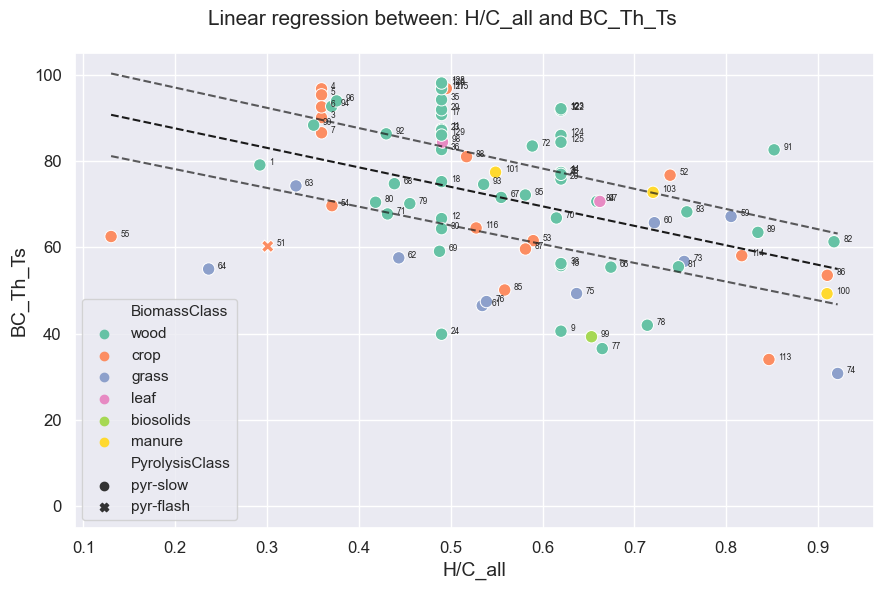

In [36]:
fig, ax = bs.correlation_linear(fitdata, metadata, x='H/C_all', y='BC_Th_Ts', Ts=20, Th=100, plot=True, 
                                outliers=tooHighHC+tooHighTemp+VenturaHerath_Fang, an = metadata.index)

R2 of H:C ratio regression:  0.018195154795690782
RMSE of H:C ratio regression:  25.22968135296497
Explained variance:  0.018195154795690782


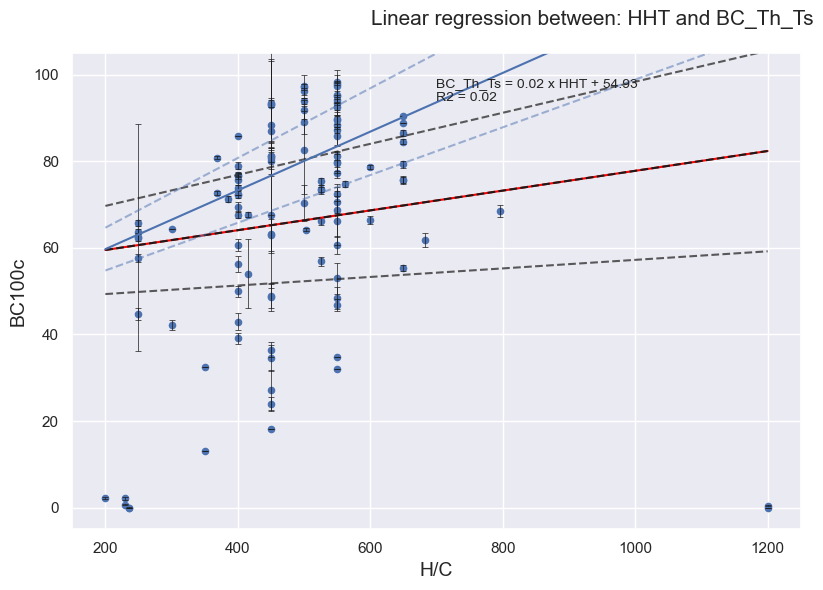

In [14]:
fig, ax, reg_hc, sl, it = correlation_linear(fitdata, metadata, x='HHT', y='BC_Th_Ts', Ts=15, Th=100, plot=True)

The parameter x=`Soil clay content` contains 1 NaN values, from observations: [41]
Specified outliers (4) were removed from regression: [46, 47, 168, 48]
R2 of H:C ratio regression:  0.03101419090310875
RMSE of H:C ratio regression:  23.786852851000972
Explained variance:  0.03101419090310864


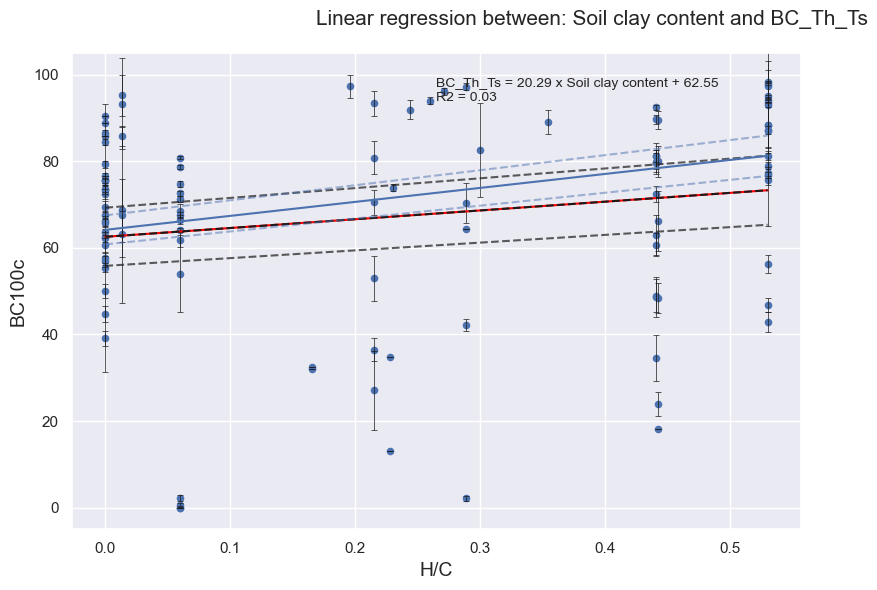

In [54]:
%matplotlib inline
fig, ax, reg_hc, sl, it = correlation_linear(fitdata, metadata, x='Soil clay content', y='BC_Th_Ts', Ts=15, Th=100, plot=True, 
                                    outliers=[46, 47, 168, 48])

The parameter x=`H/C_org` contains 20 NaN values, from observations: [1, 40, 41, 46, 47, 50, 51, 52, 53, 54, 55, 57, 58, 59, 60, 61, 62, 63, 64, 65]
R2 of H:C ratio regression:  0.2774022090769631
RMSE of H:C ratio regression:  18.65584057720521
Explained variance:  0.2774022090769631


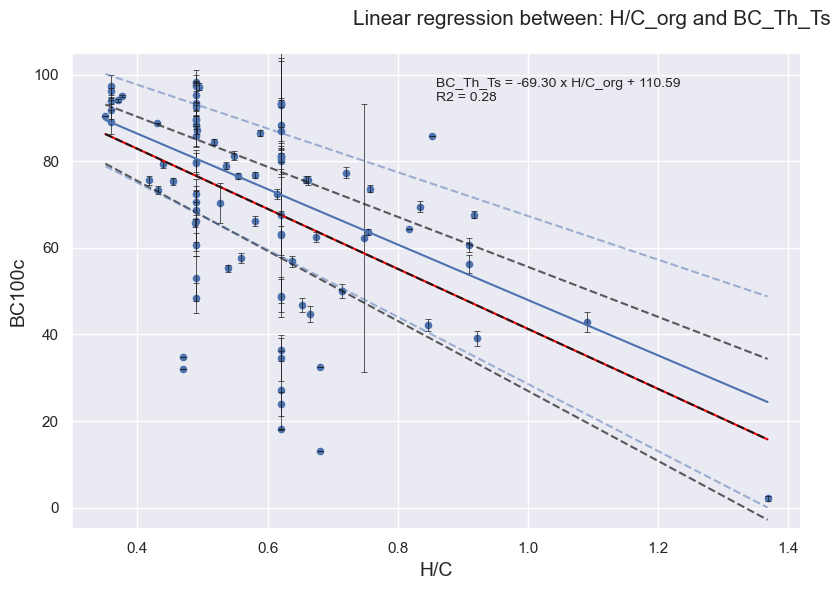

In [55]:
fig, ax, reg_hc, sl, it = correlation_linear(fitdata, metadata, x='H/C_org', y='BC_Th_Ts', Ts=15, Th=100, plot=True)

The parameter x=`H/C_all` contains 2 NaN values, from observations: [40, 41]
R2 of H:C ratio regression:  0.32054500889113735
RMSE of H:C ratio regression:  21.166845221694818
Explained variance:  0.32054500889113724


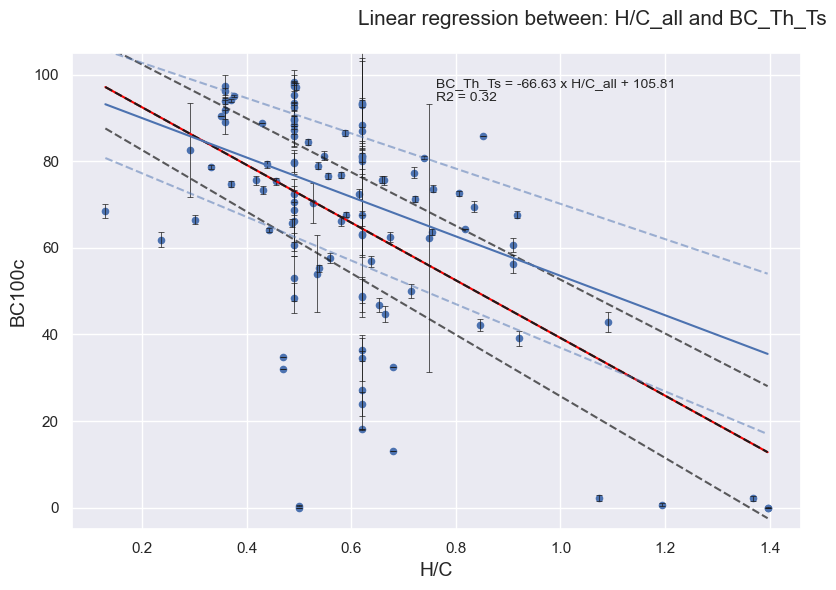

In [56]:
fig, ax, reg_hc, sl, it = correlation_linear(fitdata, metadata, x='H/C_all', y='BC_Th_Ts', Ts=15, Th=100, plot=True)

#### IP Widgets

In [54]:
%matplotlib widget
import ipywidgets as widgets
import matplotlib.pyplot as plt

The parameter x=`H/C_all` contains 2 NaN values, from observations: [40, 41]
R2 of H:C ratio regression:  0.32054500889113735
RMSE of H:C ratio regression:  21.166845221694818
Explained variance:  0.32054500889113724


interactive(children=(IntSlider(value=100, description='TimeHorizon', max=1000, step=50), FloatSlider(value=15…

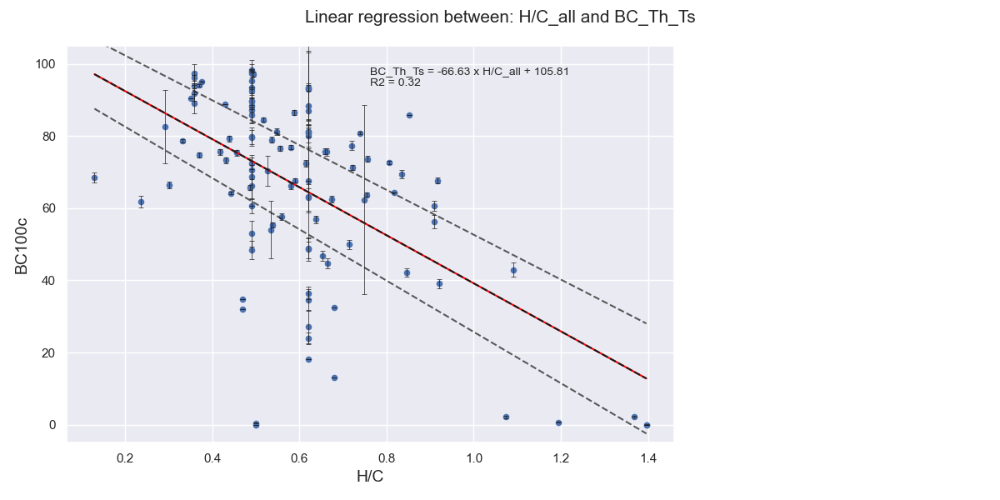

In [17]:
%matplotlib widget

TH_slider = widgets.IntSlider(
    value=100, 
    min=0, max=1000, step=50,
    description='TimeHorizon',
    continuous_update=True
)

TS_slider = widgets.FloatSlider(
    value=15, 
    min=0, max=30, step=0.5,
    description='SoilTemperature',
    continuous_update=True
)

fig, ax, reg_hc, sl, it = correlation_linear(fitdata, metadata, x='H/C_all', y='BC_Th_Ts', Ts=15, Th=100, plot=True)

def update(changeTH, changeTS):
    #print("change", change, type(change))
    reg_hc, sl, it = correlation_linear(fitdata, metadata, x='H/C_all', y='BC_Th_Ts', Ts=changeTS, Th=changeTH, plot=False, interactive=True, ax=ax, ifig=fig,
                                        iobs=73)
    fig.canvas.draw()

ie = widgets.interact(update, changeTH=TH_slider, changeTS=TS_slider)

#### Uncertainty analysis on linear corerlations

- plotting sigma of BC_TH_TS: done, adapting the uncertainty calculation through the TS recalcuation 
    - ==> some data points have an increasing sigma with time horizon? to check which ones


- from the linear corerlation itself (available in scipy, rather than sklearn, or to recalculate)
    - ==> Done: we can have the +/- 95% confidence interval, using scipy, on a linear regression curve


- combining uncertainty on BC100 estimate (in scipy) and on the linear correlation https://faculty1.coloradocollege.edu/~sburns/LinearFitting/SimpleDataFittingWithError.html 
https://faculty1.coloradocollege.edu/~sburns/toolbox/DataFitting.html
    - ==> Implemented but does not work as expected: sigma (standard deviation) does not fit at all; 1/sigma weighing provides another fit, but it is not good either
    - ==> TO DO: better understand what scipy does by reading the source code
    - ==> Hypothesis: well, the cloud of dots is not really a line.. it won't fit properly, even worse when adding relaxing with sigma
    
    
- checking the bootstrap method used by Woolf/IPCC https://datalesdatales.medium.com/the-bootstrap-or-why-you-should-care-about-uncertainty-c3fe1a5f36b5 


### Linear correlation - plotting timeseries

In [312]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, explained_variance_score

def rebuild_cov2(f_model, params, stdev, covar):
    '''
    Rebuild the covariance matrix, in correct order from data saved as Excel...
    '''    
    f_params = getfullargspec(f_model)[0][1:] # excluding time

    param_names = params.index.to_list()
    param_values = params.values
    param_std_values = stdev.values # in same order as above
    covar = covar #.droplevel(level=[0,2])
    
    def search_param(param_names, p):
        '''Returns an integer, position of search of param in params'''
        for s in range(len(params)):
            if p in param_names[s]:
                return s
    
    def search_covar(covar, p1, p2):
        '''Returns an integer, position of search covariance in matrix'''
        for s in range(len(covar.index)):
            if p1 in covar.index[s] and p2 in covar.index[s]:
                return s

    dicVal = {p:v for p,v in zip(param_names, param_values) if p in f_params}
    dicStdev = {p:v for p,v in zip(param_names, param_std_values) if p in f_params}
    #print(param_names, param_values, param_std_values)
    #print("dicStdev \n", dicStdev)
    
    p_opt_values =[dicVal[k] for k in f_params]
    
    p_cov = np.zeros((len(f_params),len(f_params)))
    for i in range(len(f_params)):
        for j in range(len(f_params)):
            if i == j:
                p_cov[i,j] = dicStdev[f_params[i]]**2
            else:
                p1 = f_params[i]
                p2 = f_params[j]
                s = search_covar(covar, p1, p2)
                p_cov[i,j] = covar[s]
    
    return f_params, p_opt_values, p_cov



def apply_Q10_bis(Th, tTs, Ts, FIT_func, params, p_opt, p_cov):
    '''
    Given an observation, its model function, its parameters, a given TH and TS, the function:
    - calculates BC remaining at any given TH and TS, BC_TH_TS.
    - calculates a propagaged error on BC_TH_TS based on fitting uncertainty of fitted params
    
        IMPROVEMENT/TODO LATER: Does not include: uncertaity from the Temperature correction!! 
        (would need uncertainty in fit kT, Q10, as well as new derative functions)
    
    '''
    
    def Q10(Ts, tTs=tTs):
        '''calculate Q10 factor, based on relationship given Woolf 2021 ES&T
        TO_DO: alternative: provide Q10 data, and calculate a relationship
        '''
        return 1.1 + ( 63.1579*(np.exp(-0.19*tTs) - np.exp(-0.19*Ts))/(Ts-tTs) )
    
    def fT(Ts, tTs=tTs):
        '''calculate the fT ratio of the decay rates at exp temperature Ts over target temperature tTs, based on Woolf 2021 ES&T'''
        return np.exp( np.log(Q10(Ts, tTs)) * (tTs-Ts)/10 )
    
    ft = 1 if Ts == tTs else fT(Ts, tTs)
    
    # apply correction to decay constants
    if FIT_func == 'singleExp':
        newBC100 = bs.singleExp(Th*365, ft*params['k'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k']], p_cov, bs.singleExp)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k']], p_cov, bs.singleExp)
    elif FIT_func == 'singleExp_u':
        newBC100 = bs.singleExp_u(Th*365, ft*params['k'], params['c'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k'], params['c']] , p_cov, bs.singleExp_u)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k'], params['c']] , p_cov, bs.singleExp_u)
    elif FIT_func == 'doubleExp':
        newBC100 = bs.doubleExp(Th*365, ft*params['k1'], ft*params['k2'], params['c1'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k1'], ft*params['k2'], params['c1']] , p_cov, bs.doubleExp)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k1'], params['k2'], params['c1']] , p_cov, bs.doubleExp)
    elif FIT_func == 'doubleExp_u':
        newBC100 = bs.doubleExp_u(Th*365, ft*params['k1'], ft*params['k2'], params['c1'], params['c2'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k1'], ft*params['k2'], params['c1'], params['c2']] , p_cov, bs.doubleExp_u)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k1'], params['k2'], params['c1'], params['c2']] , p_cov, bs.doubleExp_u)
    elif FIT_func == 'tripleExp':
        newBC100 = bs.tripleExp(Th*365, ft*params['k1'], ft*params['k2'], ft*params['k3'], params['c1'], params['c2'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k1'], ft*params['k2'], ft*params['k3'], params['c1'], params['c2']] , p_cov, bs.tripleExp)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k1'], params['k2'], params['k3'], params['c1'], params['c2']] , p_cov, bs.tripleExp)
    elif FIT_func == 'tripleExp_u':
        newBC100 = bs.tripleExp_u(Th*365, ft*params['k1'], ft*params['k2'], ft*params['k3'], params['c1'], params['c2'], params['c3'])
        #sigmaBC100 = bs.std_fmodel([Th*365*ft], [ft*params['k1'], ft*params['k2'], ft*params['k3'], params['c1'], params['c2'], params['c3']] , p_cov, bs.tripleExp_u)
        sigmaBC100 = bs.std_fmodel([Th*365*ft], [params['k1'], params['k2'], params['k3'], params['c1'], params['c2'], params['c3']] , p_cov, bs.tripleExp_u)
    elif FIT_func == 'powerModel':
        newBC100 = bs.powerModel_q10(Th*365, ft, params['c0'], params['b'], params['m'], )
    else:
        # not supported
        print("Warning: encoutered model function not supported by Q10 recalibration for obs: ", FIT_func)
        newBC100 = np.nan
        sigmaBC100 = np.nan

    
    return newBC100, sigmaBC100
    
def _align_dataframes(fitdata, metadata, outliers):
    '''
    fitdata, sub_metadata, obs = _align_dataframes(fitdata, metadata, outliers)
    '''
    fitdata = fitdata.copy(deep=True)
    obs = list(fitdata['ID_obs'].unique())
    # exclude identified outliers specified in *outliers*
    if outliers is not None:
        obs = set(obs)-set(outliers)
        
    fitdata = fitdata.set_index('ID_obs') # change index to ID_obs, so that series have the same index
    
    
    fitdata = fitdata[fitdata.index.isin(obs)].copy(deep=True) # filter metadata for the observations in the model minus outliers
    sub_metadata = metadata[metadata.index.isin(obs)] # filter metadata for the observations in the model
    sub_metadata = sub_metadata.replace('na',np.NaN) # replaces 'na' strings by NaN, for correct handling 
    
    # Make sure fitdata and sub_metadata have same index elements & order
    fitdata = fitdata.sort_index() # sort index, to be sure it matches with metadata
    sub_metadata = sub_metadata.sort_index() # sort index, to be sure it matches with metadata
    if not fitdata.index.equals(sub_metadata.index):
        # True if “other” is an Index and it has the same elements and order as the calling index; False otherwise.
        raise Exception("Warning: the indexes of fitdata & sub_metadata do not have same elments or same order")

    return fitdata, sub_metadata, obs

def _retrieveX(x, sub_metadata):
    '''
    vX, vXnan = _retrieveX(x, sub_metadata)
    '''
    acc_x = ['H/C_all'] # special values of x that are accepted (e.g. H/C_all > using H/C_org if available, but bridging with H/C_tot if not available)
    
    if len(x) == 1:
        x = x[0]
        if x not in sub_metadata.columns and x not in acc_x: # verify x is in metadata.columns
            raise Exception("x = `{}` must be a column in `metadata` or an accepted value (check documentation)".format(x))
        elif x in sub_metadata.columns:
            vX = sub_metadata[x]
        else: # x is a special value, swith and handle separately
            if x == 'H/C_all':
                vX = sub_metadata['H/C_org'].fillna(sub_metadata['H/C_tot'], inplace=False) 
        # Counting NaNs in vX
        vXnan = list(vX[vX.isna()].index)
        
    elif len(x) > 1:
       # if all(item in sub_metadata.columns for item in x):
       #     # yes, all items of x are in sub_metadata.columns
       #     vX = sub_metadata[x]
       # elif any(item in acc_x for item in x):
        vX = pd.DataFrame({})
        for item in x:
            if item in acc_x:
                if item == 'H/C_all':
                    vvX = sub_metadata['H/C_org'].fillna(sub_metadata['H/C_tot'], inplace=False) 
                    vX[item] = vvX
            elif item in sub_metadata.columns:
                    vvX = sub_metadata[item]
                    vX[item] = vvX
            else:
                raise Warning("x item `{}` not selected, because it is not in `metadata` or an accepted value (check documentation)".format(item))

        #counting NaNs in vX
        vXnan = list(vX[vX.isna().any(axis=1)].index)
    
    return vX, vXnan  

def _calculateY(fitdata, sub_metadata, Ts, Th):
    '''
    vY, sigvY, vYnan = _calculateY(fitdata, sub_metadata, Ts, Th)
    '''
    # some constants 
    map_model_function = {"singleExp":singleExp,"singleExp_u":singleExp_u,"doubleExp":doubleExp,"doubleExp_u":doubleExp_u,"tripleExp":tripleExp,"tripleExp_u":tripleExp_u,"powerModel":powerModel,}            
    
    # initialise lists to save calcs
    vY = []
    sigvY =[]
    for obs, row in fitdata.iterrows():
        Ts_ini = sub_metadata.loc[obs, 'IncubationTemperature']
        FIT_func = row['model']
        params = row[['k', 'c', 'k1', 'k2', 'c1', 'c2', 'k3', 'c0', 'b', 'm', 'c3']]
        # std is in absolute value (other named .1 => relative value, in %)
        params_std = row[['std_k', 'std_c','std_k1', 'std_k2', 'std_c1', 'std_c2', 'std_k3', 'std_c3', 'std_c0', 'std_b', 'std_m']]
        params_corr = ['corr(k, c)', 'corr(k1, k2)', 'corr(k1, c1)', 'corr(k2, c1)', 'corr(k1, c2)', 'corr(k2, c2)', 'corr(c1, c2)', 'corr(k1, k3)',
                        'corr(k2, k3)', 'corr(k3, c1)', 'corr(k3, c2)', 'corr(k1, c3)', 'corr(k2, c3)', 'corr(k3, c3)', 'corr(c1, c3)', 'corr(c2, c3)','corr(c0, b)', 'corr(c0, m)', 'corr(b, m)']
        params_cov = row[['cov(k, c)', 'cov(k1, k2)', 'cov(k1, c1)', 'cov(k2, c1)', 'cov(k1, c2)', 'cov(k2, c2)',
                       'cov(c1, c2)', 'cov(k1, k3)', 'cov(k2, k3)', 'cov(k3, c1)','cov(k3, c2)', 'cov(k1, c3)', 'cov(k2, c3)', 'cov(k3, c3)','cov(c1, c3)', 'cov(c2, c3)', 'cov(c0, b)', 'cov(c0, m)', 'cov(b, m)']]
        p_opt_names, p_opt, p_cov = rebuild_cov2(map_model_function[FIT_func], params, params_std, params_cov)
        BC, sBC = apply_Q10_bis(Th, Ts, Ts_ini, FIT_func, params, p_opt, p_cov)
        vY.append(BC)
        sigvY.append(sBC[0]) # [0] because functions returns a time series

    vY = pd.Series(data=vY, index=fitdata.index)
    sigvY = pd.Series(data=sigvY, index=fitdata.index)
    vYnan = list(vY[vY.isna()].index)
    return vY, sigvY, vYnan

def linear(x, a, b):
    return a*x+b

def std_linear(x, p_opt, p_cov):
    a = p_opt[0]
    b = p_opt[1]
    gX = np.array([x, 1])
    std_f2 = gX.T @ p_cov @ gX
    return np.sqrt(std_f2)

def calc_correlation_timeseries(fitdata, metadata,
                                x = ['H/C_all'],
                                outliers=None,
                                Ts=[10, 15, 20],
                                Th=[0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 120, 140, 160, 180, 200],
                               ):
    '''
    Ts: a list of values, or a single value provided as a list- soil temperatures to consider
    Th: a list of values, or a single value provided as a list- time points to calculate
    x : a list of values, or a single value provided as a list - variable in metadata to use for correlation (single variable or multiple variable)
    outliers: a list of ID_obs to exclude from analysis
    '''
    
    # data preparation
    fitdata, sub_metadata, obs = _align_dataframes(fitdata, metadata, outliers)
    # get X columns
    vX, vXnan = _retrieveX(x, sub_metadata)
    
    # calculate Y columns: i.e. calculate BC_Th_Ts & sigmaBC_Th_Ts, and save for range of Ts and Th 
    megaY = {} 
    megaSY = {}
    megaYnan = {}
    for ts in Ts:
        for th in Th:
            megaY[(ts, th)], megaSY[(ts, th)], megaYnan[(ts, th)] = _calculateY(fitdata, sub_metadata, ts, th)
            
    # perform correlation, for each Ts and Th; and save coefficients & their sigma
    megaCoeffs = {}
    megaSCoeffs = {}        
    for ts in Ts:
        for th in Th:
            # Remove any mutual observation with nan values
            vXYnan = set(vXnan + megaYnan[(ts, th)])
            cvX = vX.drop(vXYnan, axis=0).sort_index(axis=0)
            cvY = megaY[(ts, th)].drop(vXYnan, axis=0).sort_index(axis=0)
            sigvY = megaSY[(ts, th)].drop(vXYnan, axis=0).sort_index(axis=0) # removing irrelevant observations, as in vX, vY
            sigvY = sigvY.fillna(0) # remainin nan, where uncertainty could not be calculated for some reason, replaced by 0
            # Do the fit
            p_opt1, p_cov1 = curve_fit(f=linear, xdata=cvX, ydata=cvY, p0=None, method='lm', sigma=None, absolute_sigma=False)
            # Save the fit
            megaCoeffs[(ts, th)] = p_opt1
            megaSCoeffs[(ts, th)] = p_cov1
            
    # return array of BC_Th_Ts, sigmaBC_Th_Ts, coefficients & sigma, for each Ts & Th
    # second function: plot all the lines. 
    return vX, vXnan, megaY, megaYnan, megaCoeffs, megaSCoeffs

def _rebuild_timeseries(xx, ts, Th, megaCoeffs):
    BC = []
    for th in Th:
        # get the coefficients
        p_opt = megaCoeffs[(ts, th)]
        BC.append(max(0, min(100, linear(xx, *p_opt))) )
    return BC
    
def plot_correlation_timeseries(fitdata, metadata, x, Ts, Th,
                                vX, vXnan, megaY, megaYnan, megaCoeffs, megaSCoeffs,
                                fig=None, ax=None, TH_lim=1000,
                               ):
    '''
    Plot the results computed via `calc_correlation_timeseries`.
    x = values of X that need to be plotted, as a list // if multiple variables; should be a dictionnary of key:[values]
    '''
    if (fig, ax) == (None, None):
        fig, ax = plt.subplots(1,1, figsize=(9,5))
    ax.cla()
    # reconstruct the lines, for each H/C_all values, at given Ts
    for xx in x: 
        for ts in Ts:
            BC = _rebuild_timeseries(xx, ts, Th, megaCoeffs)
            ax.plot(Th, BC, label=r"H/C: {}".format(xx))
    #ax.plot(Th, Th)
    
    # styling    
    ax.set_ylim([0-5,100+5])
    ax.set_ylabel('Biochar C remaining (%)', fontsize=14)
    ax.set_xlim([0-10, TH_lim+10])
    ax.set_xlabel('Time (years)', fontsize=14)
    
    ax.legend(fontsize=8, loc=1)
    
    return fig, ax

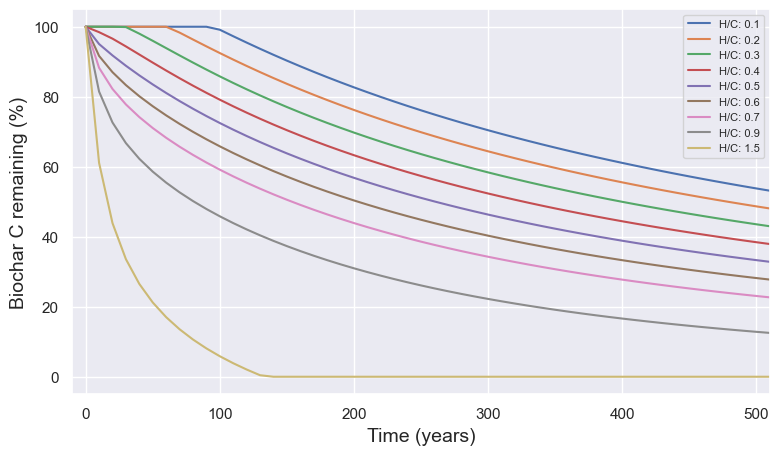

In [218]:
%matplotlib inline
fig, ax = plot_correlation_timeseries(fitdata, metadata, 
                            [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.9, 1.5], 
                            [15], 
                            TH,
                            vX, vXnan, megaY, megaYnan, megaCoeffs, megaSCoeffs,
                            fig=None, ax=None, TH_lim=500,
                               )

interactive(children=(FloatSlider(value=15.0, description='SoilTemperature', max=25.0, min=5.0, step=5.0), Out…

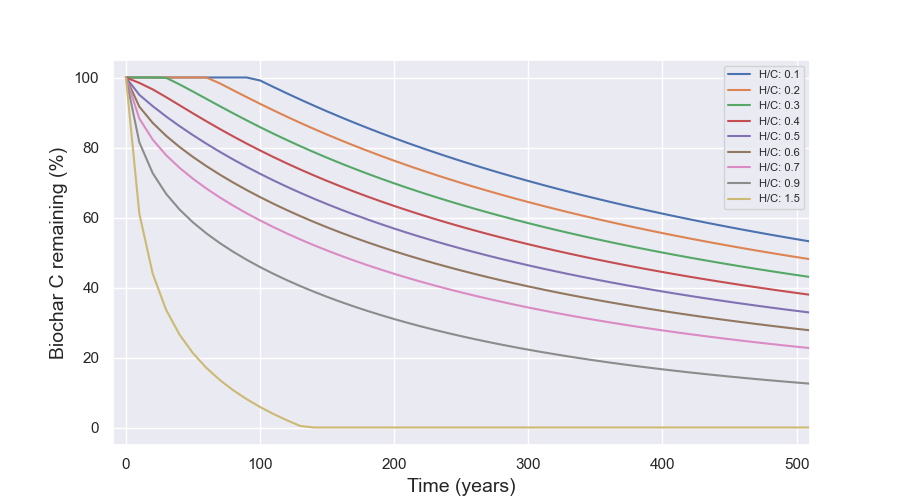

In [320]:
%matplotlib widget
TS_slider = widgets.FloatSlider(value=15, min=5, max=25, step=5, description='SoilTemperature', continuous_update=True)
figgy, ax = plot_correlation_timeseries(fitdata, metadata, 
                            [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.9, 1.5], 
                            [15], 
                            TH,
                            vX, vXnan, megaY, megaYnan, megaCoeffs, megaSCoeffs,
                            fig=None, ax=None, TH_lim=500)
def update(changeTS):
    #print("change", change, type(change))
    _, _ = plot_correlation_timeseries(fitdata, metadata, 
                            [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.9, 1.5], 
                            [changeTS], 
                            TH,
                            vX, vXnan, megaY, megaYnan, megaCoeffs, megaSCoeffs,
                            fig=figgy, ax=ax, TH_lim=500)    
    figgy.canvas.draw()
ie = widgets.interact(update, changeTS=TS_slider)

In [185]:
np.seterr(divide='ignore', invalid='ignore') # ignore message "divide by 0", occuring in stdev

#Warning - at high time & temperature resolution, the cell takes 2-3 minutes to run
TS = np.arange(5, 30, 5) #[10, 15, 20]
TH = np.arange(0, 1010, 10) #[0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 120, 140, 160, 180, 200]
vX, vXnan, megaY, megaYnan, megaCoeffs, megaSCoeffs = calc_correlation_timeseries(fitdata, metadata,
                                                        x = ['H/C_all'], outliers=None, Ts= TS, Th= TH)

In [311]:
# Timeseries correlations: it's a very high number of curve fits
len(TS)*len(TH), len(megaY)*len(megaY[(5,0)])

(505, 55550)

In [221]:
import pickle
with open('../simulations/correlation_HC_highres_2022-11-03.pkl', 'wb') as file:
    # A new file will be created
    pickle.dump([vX, vXnan, megaY, megaYnan, megaCoeffs, megaSCoeffs], file)

In [222]:
with open('../simulations/correlation_HC_highres_2022-11-03.pkl', 'rb') as file:  
    # Call load method to deserialze
    vX, vXnan, megaY, megaYnan, megaCoeffs, megaSCoeffsr = pickle.load(file)

## Testing: Correlation - Multivariate / Non-linear / Descriptive

Mainly using Scikit-Learn. 

Note to team: in course project, I had to write own functions for data preparation; here, instead, I'll use existing functions provided by Scikit-Learn.

Pre-processing: https://scikit-learn.org/stable/modules/classes.html#module-sklearn.preprocessing 

In [ ]:
# used
from sklearn.compose import make_column_selector as selector
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import make_pipeline

from sklearn.preprocessing import StandardScaler, RobustScaler, LabelEncoder, OneHotEncoder
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, roc_curve, explained_variance_score

def obs_per_feat(X, plot=True):
    '''
    Given a metadata df with a subset of relevant features, counts number of nan, and plots nb of observations available without nan as a function of features
    '''
    Xna = X.isna().sum()
    X = X[Xna.sort_values().index]
    saved = []
    Xc = set()
    colums = []
    x = []
    y = []
    for i, c in enumerate(X.columns):
        Xc = Xc.union(set(X[X[c].isna() == True].index))   
        saved.append({
            'columns': colums.append(c),
            'n_obs_complete': len(X) - len(Xc),
            'n_obs_nan': len(Xc),
            'set_nan': Xc,
        })
        x.append(i+1)
        y.append(saved[i]['n_obs_complete'])
    
    if plot:
        fig, ax = plt.subplots(1,1, figsize=(4,4))
        ax.scatter(x,y, s=5)
        ax.plot(x,y, linewidth=0.5)
        ax.set_xlabel('Nb of features')
        ax.set_ylabel('Nb observations complete')
    return saved, x, y

def featcombin(X, n):
    '''
    Given a metadata df where columns are relevant features, creates a list containing lists of all combination of features, without repetititons
    
    '''
    sample_list = list(X.columns)
    list_combinations = list()
    for i in range(n + 1):
        list_combinations += list(itertools.combinations(sample_list, i))
    return list_combinations

In [ ]:
# for later
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeClassifier, plot_tree, export_text
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, train_test_split

### Data preparation

In [13]:
# the data should be: for set of observations in the model:
# the corresponding subset of metadata and at least one target variable (BC100)
mod_bestfit = pd.read_excel('bestfitdata-p0_2022-10-27.xlsx', index_col=0)
mod_obs =  list(mod_bestfit['ID_obs'].unique())
mod_bestfit = mod_bestfit.set_index('ID_obs')
mod_metadata = metadata[metadata.index.isin(mod_obs)] # filter metadata for the observations in the model
mod_metadata = mod_metadata.replace('na',np.NaN) # replaces 'na' strings by NaN, for correct handling 

mod_bestfit.sort_index(inplace=True)
mod_metadata.sort_index(inplace=True)

if not mod_bestfit.index.equals(mod_metadata.index):
    # True if “other” is an Index and it has the same elements and order as the calling index; False otherwise.
    raise Exception("Warning: the indexes of fitdata & sub_metadata do not have same elments or same order")

len(mod_metadata), len(mod_bestfit)

(110, 110)

234 remaining nans, in various columns
Strategy for: SoilMoisture_WHC
	Mode: 0.7 will be replaced in 3 rows
Strategy for: pH_soil
	Mode: 6.8 will be replaced in 29 rows
Strategy for: pH_H2O
	Mode: 8.64 will be replaced in 35 rows
droping 2 columns
Strategy for: Ash
	Mode: 0.03 will be replaced in 2 rows
droping 2 columns
65 remaining nans, in various columns, filled with mode


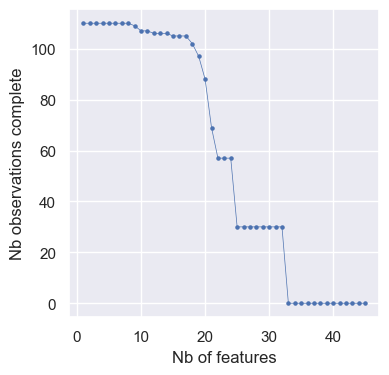

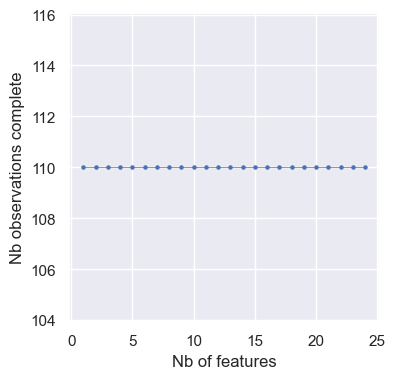

In [14]:
# X [features] cleaning, selecting columns, merging some 
X = mod_metadata.copy(deep=True)
info_cols = ['ID_art', 'AuthorDate', 'NameObs', 'Replicates','Biomass', 'Pyrolysis', 'BiomassLignin', 'Soil type',
             'SoilMoisture_Absolute', 'SoilOrigin', 'SoilGeolocation', 'TotalFluxMeasurement', 'BiocharFluxDetermination', 'OtherIncubationDescription', 'AssociatedControl',
             'Cultivated', 'ID_Lehmann2019', 'ID_Woolf2021', 'ID_Lehmann2021',
             ]
col_to_drop = ['pH_bc-soil', 'Magnesium', 'Potassium', 'Phosphorous', 'ParticleSize', 'BulkDensity',
              'TrueDensity', 'OxidationH2O2', 'BiocharYield', 'δ ¹³C biochar',
              'δ ¹³C soil', 'FixedCarbon', 'VolatileMatter', 'pH_CaCl2', 'CEC', 'SA_N2', 'SA_CO2', 'Sulphur', 'ApplicationRate',]

col_categorical = ['BiomassClass', 'PyrolysisClass', 'LabField']

col_numerical = ['HHT', 'RT', 'HR', 'Soil clay content', 'Soil sand content', 'Soil silt content', 'Soil organic matter content',
                'SoilMoisture_WHC', 'pH_soil', 'IncubationTemperature', 'IncubationDuration', 
                'Ash550', 'Ash700', 'Carbon', 'Carbon, organic', 'Hydrogen', 'Nitrogen',
                'Oxygen', 'H/C_org', 'H/C_tot', 'O/C_org', 'C/N', 'pH_H2O',
                ]

# drop irrelevant columns
X.drop(info_cols, axis=1, inplace=True)
opf, opf_x, opf_y = obs_per_feat(X)

X.drop(col_to_drop, axis=1, inplace=True)

# count gaps remaining, per columns, for this model set 
#print(X.isna().sum(axis=0))
print(X.isna().sum().sum(), "remaining nans, in various columns")

# 'SoilMoisture_WHC' : bridge gap, with mode; rationale: most lab experiment used 60%, if different, it is usually reported
c = 'SoilMoisture_WHC'
print("Strategy for:", c)
print("\tMode:", X[c].mode()[0], "will be replaced in", X[c].isna().sum(), "rows")
X[c].fillna(X[c].mode()[0], inplace=True)

# 'pH_soil' : bridge gap, with mode; rationale: for Zimmerman (sand), 1 of Kuzyakov (loess), 
c = 'pH_soil'
print("Strategy for:", c)
print("\tMode:", X[c].mode()[0], "will be replaced in", X[c].isna().sum(), "rows")
X[c].fillna(X[c].mode()[0], inplace=True)

# 'pH_H2O' :  biochar pH in water, bridge gap, with mode; rationale: for Zimmerman  
c = 'pH_H2O'
print("Strategy for:", c)
print("\tMode:", X[c].mode()[0], "will be replaced in", X[c].isna().sum(), "rows")
X[c].fillna(X[c].mode()[0], inplace=True)

# 'Ash550', 'Ash700': merge, if both, take average, otherwise take existing one
X['Ash'] = X[['Ash550', 'Ash700']].mean(axis=1)
X.drop(['Ash550', 'Ash700'], axis=1, inplace=True)
print("droping 2 columns")
c = 'Ash'
print("Strategy for:", c)
print("\tMode:", X[c].mode()[0], "will be replaced in", X[c].isna().sum(), "rows")
X[c].fillna(X[c].mode()[0], inplace=True)

# H/C_all: merge, with strategy: H/C_org if existing, otherwise, H/C_tot; likewise for C, C_org
X['H/C_all'] = X['H/C_org'].fillna(X['H/C_tot'], inplace=False)
X.drop(['H/C_org', 'H/C_tot'], axis=1, inplace=True)
print("droping 2 columns")
X['Carbon, organic'] = X['Carbon, organic'].fillna(X['Carbon'], inplace=False)

# fill all the rest with mode; slightly brutal
print(X.isna().sum().sum(), "remaining nans, in various columns, filled with mode")
X.fillna(X.mode().loc[0,:], inplace=True)

opf, opf_x, opf_y = obs_per_feat(X)

# count gaps remaining, per columns, for this model set 
#print(X.isna().sum(axis=0).sum())


From the graphs generated by the function obs_per_feat, we find that:

   - 1. We easily can have 110 observations with a complete set of 20-24 features, doing some minor data gaps filling.
   
   - 2. For comparison, in the 2019 pre-project, I had 64 observations with 15 features only.

In [15]:
Xcombi = featcombin(X, n=len(X.columns))
len(Xcombi)

16777216

In [16]:
Xcombi = featcombin(X, n=3)
len(Xcombi)

2325

The number of combination possible for 24 features is such that it does not seem realistic, nor smart, to test all of them. A selection has to be made, based on the following:

1. Models with many features are not usable in practice and are not necessarily more informative than with fewer features
2. Models with 20, 21, .. or 24 features are the same to us
3. It is interesting to check all combinations of features, with a total of 1, 2, 3, 4, 5 features? 50k combinations
4. This, we should/could also filter out features that are not very informative (e.g. pH) or combinations that have high correlations, or base the selection on our domain knowledge

In [233]:
# Y [target] getting BC100c, or BC100 uncorrected, or BC_Th_Ts
Y = mod_bestfit['BC100c']

#Y = mod_bestfit['BC100']
type(Y)

# 
XY = X.copy(deep=True)
XY['BC100c'] = Y

Tutorial on how to process data with both categorical and numerical, efficiently:

https://inria.github.io/scikit-learn-mooc/python_scripts/03_categorical_pipeline_column_transformer.html

In [234]:
numerical_columns_selector = selector(dtype_exclude=object)
categorical_columns_selector = selector(dtype_include=object)

numerical_columns = numerical_columns_selector(X)
categorical_columns = categorical_columns_selector(X)

categorical_preprocessor = OneHotEncoder(handle_unknown="ignore") # Here, could do a LabelEncoder() as well
numerical_preprocessor = RobustScaler() #StandardScaler() # RobustScaler() can also do robustscaler, dealing with outliers differently

preprocessor = ColumnTransformer([
    ('one-hot-encoder', categorical_preprocessor, categorical_columns),
    ('standard_scaler', numerical_preprocessor, numerical_columns)])

### Principal component analysis

In [235]:
model_PCA = make_pipeline(preprocessor, PCA(n_components=5))
model_PCA

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('one-hot-encoder',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['BiomassClass',
                                                   'PyrolysisClass',
                                                   'LabField']),
                                                 ('standard_scaler',
                                                  RobustScaler(),
                                                  ['HHT', 'RT', 'HR',
                                                   'Soil clay content',
                                                   'Soil sand content',
                                                   'Soil silt content',
                                                   'Soil organic matter '
                                                   'content',
                                                   'SoilMoisture_WHC',
                                                   'pH_soil',
                                                   'IncubationTemperature',
                                                   'IncubationDuration',
                                                   'Carbon', 'Carbon, organic',
                                                   'Hydrogen', 'Nitrogen',
                                                   'Oxygen', 'O/C_org', 'C/N',
                                                   'pH_H2O', 'Ash',
                                                   'H/C_all'])])),
                ('pca', PCA(n_components=5))])

In [236]:
_ = model_PCA.fit(X)
projected = model_PCA.fit_transform(XY)

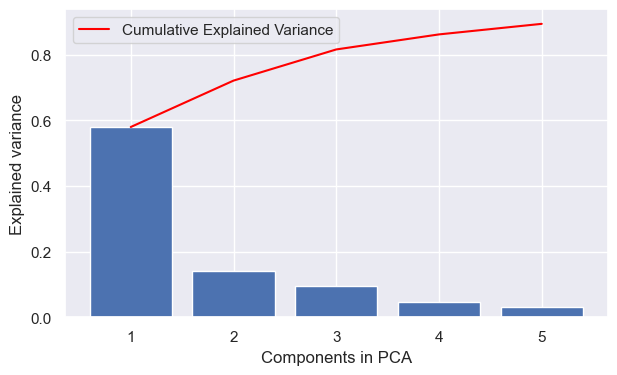

In [237]:
%matplotlib inline

# based on: https://ostwalprasad.github.io/machine-learning/PCA-using-python.html 
expl_var = model_PCA.named_steps['pca'].explained_variance_ratio_

fig, ax = plt.subplots(figsize=(7,4))
ax.bar(range(1,len(expl_var)+1),expl_var )

ax.plot(np.arange(len(expl_var))+1, expl_var.cumsum(), c='red', label="Cumulative Explained Variance")
plt.legend(loc='upper left')

plt.xlabel('Components in PCA')
plt.ylabel('Explained variance');

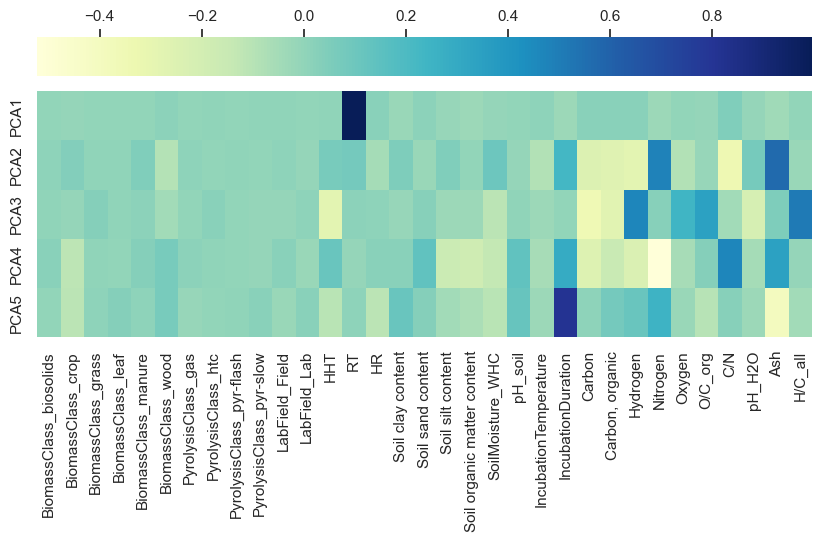

In [238]:
transformedfeatures = list(model_PCA.named_steps['columntransformer'].get_feature_names_out())
transformedfeatures = [x.removeprefix("one-hot-encoder__") for x in transformedfeatures]
transformedfeatures = [x.removeprefix("standard_scaler__") for x in transformedfeatures]
#transformedfeatures
## QUESTION: AM I SURE THAT THE ORDER OF THE COLUMNS HERE MATCH WITH WHAT IS PLOTTED 
pcamodel = model_PCA.named_steps['pca']

fig, ax = plt.subplots(figsize=(10,4))
ax = sns.heatmap(pcamodel.components_,
                 cmap='YlGnBu',
                 yticklabels=[ "PCA"+str(x) for x in range(1,pcamodel.n_components_+1)],
                 xticklabels=transformedfeatures,
                 cbar_kws={"orientation": "horizontal", "location":"top"})
#ax.set_aspect("equal")

0.7213882818389366

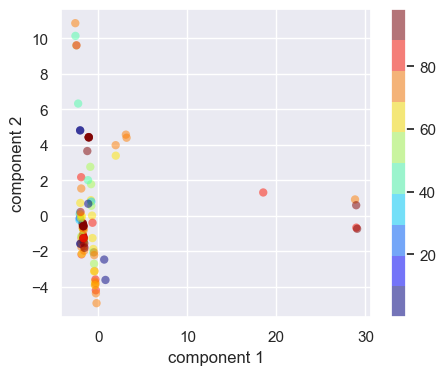

In [239]:
%matplotlib inline
fig, ax = plt.subplots(figsize=(5,4))
plt.scatter(projected[:, 0], projected[:, 1],
            c=Y, edgecolor='none', alpha=0.5,
            cmap=plt.cm.get_cmap('jet', 10))
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.colorbar();

expl_var[0:2].sum()

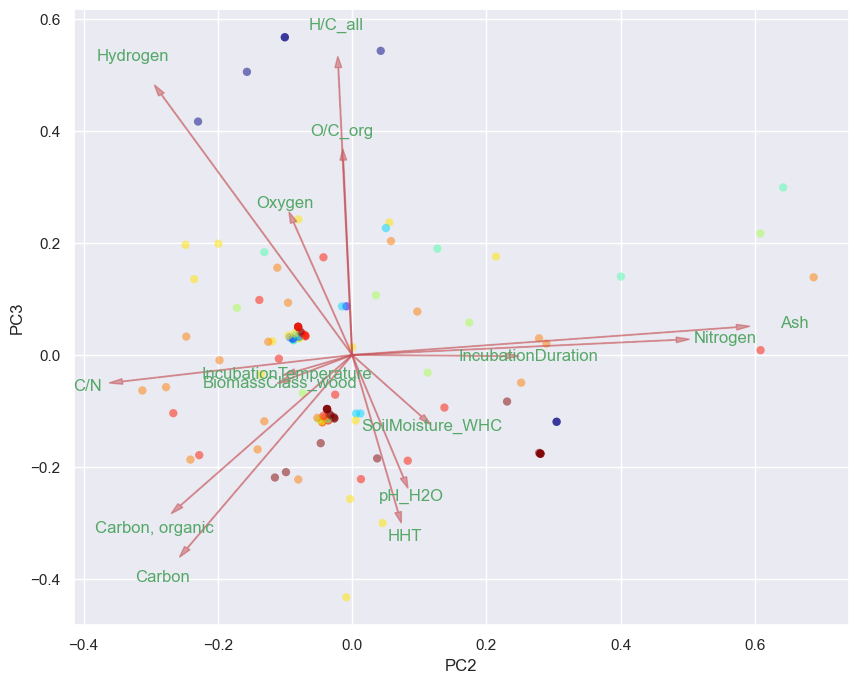

In [240]:
def plot_pca_biplot(projection, components, features, c1, c2, limfeat=5, Y=Y, fig=None, ax=None):
    '''
    For 2 given components c1 and c2 (numbered from 0), plots a PCA scatter plot & a loading plot (arrows, with max limfeat sorted by longer arrows).
    
    More info:
    https://ostwalprasad.github.io/machine-learning/PCA-using-python.html
    https://www.nonlinear.com/support/progenesis/comet/faq/v2.0/pca.aspx
    '''
    projection = projection[:,[c1,c2]] # shape 110 x 2, i.e. observations x selected components >> used for scatter
    components = np.transpose(components[[c1,c2],:]) # shape 33 x 2, i.e. features x selected components >> used for loading
    
    if ax is None:
        fig, ax = plt.subplots(1,1, figsize=(10,8))
    
    # SCATTER
    xs = projection[:,0] # scatter
    ys = projection[:,1] # scatter   
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    ax.scatter(xs * scalex, ys * scaley, c=Y, edgecolor='none', alpha=0.5, cmap=plt.cm.get_cmap('jet', 10))
    #plt.colorbar();
    
    # LOADING
    n = components.shape[0] # nb features, 33
    df = pd.DataFrame(components)
    df['length'] = np.sqrt(df[0]**2+df[1]**2)
    df['features'] = features
    df = df.sort_values(by='length', axis=0, ascending=False)
    components = df.values
    features = df['features'].values
    for i in range(min(n, limfeat)):
        ax.arrow(0, 0, components[i,0], components[i,1],color = 'r',alpha = 0.5, head_width=0.01, head_length=0.02)
        if features is None:
            ax.text(components[i,0]* 1.15, components[i,1] * 1.15, "Var"+str(i+1), color = 'green', ha = 'center', va = 'center')
        else:
            ax.text(components[i,0]* 1.15, components[i,1] * 1.15, features[i], color = 'g', ha = 'center', va = 'center')
     
    ax.set_xlabel("PC"+str(c1+1))
    ax.set_ylabel("PC"+str(c2+1))

    return None
 
plot_pca_biplot(projected, pcamodel.components_, transformedfeatures, 1, 2, 15)


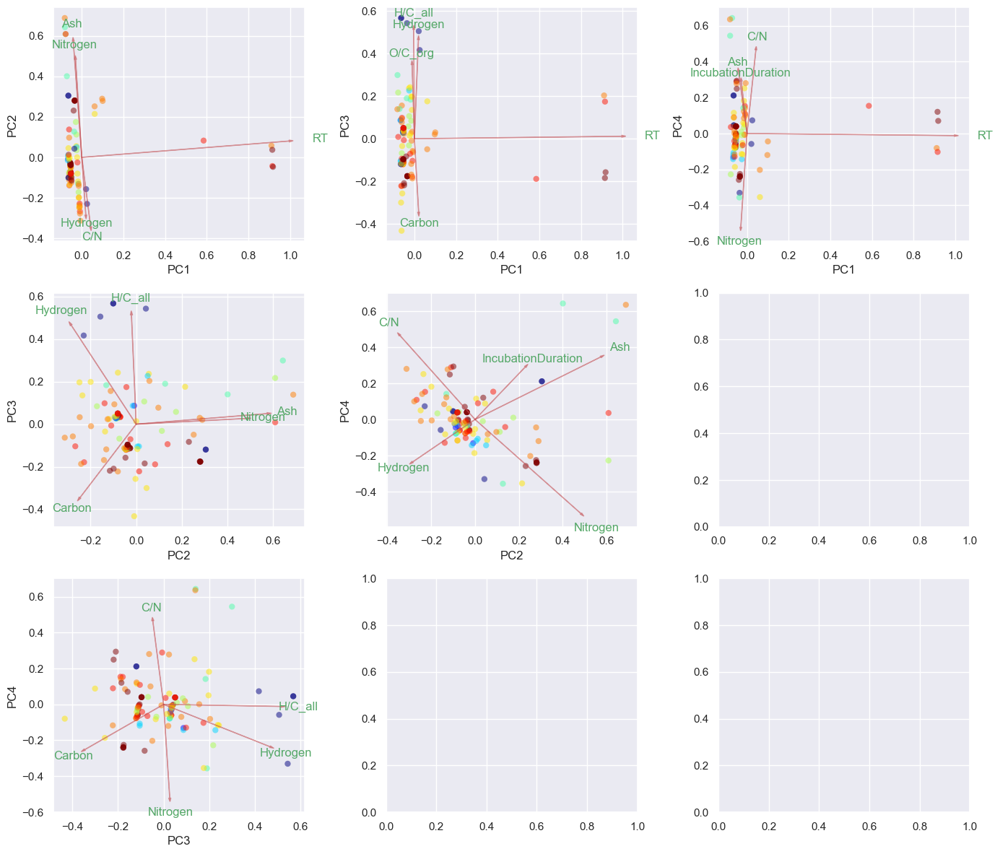

In [249]:
fig, ax = plt.subplots(3,3, figsize=(14, 4*3))
#row 1
plot_pca_biplot(projected, pcamodel.components_, transformedfeatures, 0, 1, 5, fig=fig, ax=ax[0,0])
plot_pca_biplot(projected, pcamodel.components_, transformedfeatures, 0, 2, 5, fig=fig, ax=ax[0,1])
plot_pca_biplot(projected, pcamodel.components_, transformedfeatures, 0, 3, 5, fig=fig, ax=ax[0,2])

#row 2
plot_pca_biplot(projected, pcamodel.components_, transformedfeatures, 1, 2, 5, fig=fig, ax=ax[1,0])
plot_pca_biplot(projected, pcamodel.components_, transformedfeatures, 1, 3, 5, fig=fig, ax=ax[1,1])

#row 3
plot_pca_biplot(projected, pcamodel.components_, transformedfeatures, 2, 3, 5, fig=fig, ax=ax[2,0])


fig.tight_layout()

0.8164306727739521

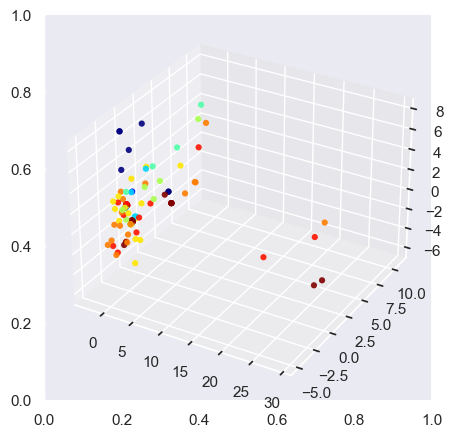

In [106]:
fig, ax = plt.subplots(figsize=(5,5),)# facecolor='white')
ax = plt.axes(projection ="3d")
ax.scatter3D(projected[:, 0], projected[:, 1],projected[:, 2],
            c=Y, edgecolor='none', alpha=0.9,
            cmap=plt.cm.get_cmap('jet', 10))
#ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 1.0))

#plt.colorbar();
expl_var[0:3].sum()


Conclusion form PCA:

- RobustScaler and StandardScalar do not provide the same PCA. RobustScaler reaches 80%+ with 3 features, while only 56% with StandardScaler. 
- When plotting in 2D or 3D, with BC100c target variable, some "groups" seem to emerge in the visualisation

Addition:
- Plotting loading of each features on the components was informative. In particular, we could learn that:
    - Residence Time: seems to be a distinguishing characteristics of 5 observations; but does not affect much BC100c
    - H/C_all, C, H: are informative, in PC2xPC3, but not fully covariant (arrows not aligned)
    - N content & ash content: are somewhat informative, in PC2xPC3, are pretty much covariant there, but not in PC2xPC4 
    - 

### Multivariate linear regression

#### On selected variables

In [255]:
model_multiLinear = make_pipeline(LinearRegression())

cols = ['H/C_all', 'O/C_org', 'HHT',]
model_multiLinear.fit(X=X[cols].values, y=Y.values)

r2_regMulti = model_multiLinear.score(X=X[cols].values, y=Y.values)
y_pred = model_multiLinear.predict(X=X[cols].values)

rmse_regMulti = np.sqrt(mean_squared_error(Y.values, y_pred))
print("Variables considered:", cols)
print("R2: ", r2_regMulti)
print("RMSE regression: ", rmse_regMulti)
exvar_regM = explained_variance_score(Y.values, y_pred)
print("Explained variance: ", exvar_regM)

Variables considered: ['H/C_all', 'O/C_org', 'HHT']
R2:  0.4281832306064034
RMSE regression:  19.237168453958613
Explained variance:  0.4281832306064033


In [256]:
model_multiLinear.named_steps['linearregression'].coef_, model_multiLinear.named_steps['linearregression'].intercept_

(array([-6.31361527e+01, -7.78005633e+01, -7.07903890e-02]), 156.1696978128208)

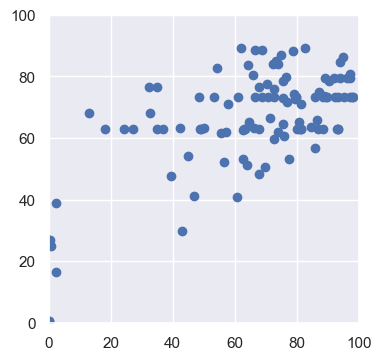

In [257]:
plt.subplots(figsize=(4,4))
plt.scatter(Y.values, y_pred)
plt.xlim([0,100])
plt.ylim([0,100]);

#### On PCA components

In [272]:
model_PCA_LR = make_pipeline(preprocessor, PCA(n_components=5), LinearRegression())
model_PCA_LR

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('one-hot-encoder',
                                                  OneHotEncoder(handle_unknown='ignore'),
                                                  ['BiomassClass',
                                                   'PyrolysisClass',
                                                   'LabField']),
                                                 ('standard_scaler',
                                                  RobustScaler(),
                                                  ['HHT', 'RT', 'HR',
                                                   'Soil clay content',
                                                   'Soil sand content',
                                                   'Soil silt content',
                                                   'Soil organic matter '
                                                   'content',
                                                   'SoilMoisture_WHC',
                                                   'pH_soil',
                                                   'IncubationTemperature',
                                                   'IncubationDuration',
                                                   'Carbon', 'Carbon, organic',
                                                   'Hydrogen', 'Nitrogen',
                                                   'Oxygen', 'O/C_org', 'C/N',
                                                   'pH_H2O', 'Ash',
                                                   'H/C_all'])])),
                ('pca', PCA(n_components=5)),
                ('linearregression', LinearRegression())])

In [279]:
_ = model_PCA_LR.fit(X=X, y=Y)
model_PCA_LR.score(X=X, y=Y)


(array([ 0.63284838,  0.00738542, -5.80272624,  0.02063291,  4.09410031]),
 66.12059429591544)

In [280]:
model_PCA_LR.named_steps['linearregression'].coef_, model_PCA_LR.named_steps['linearregression'].intercept_

(array([ 0.63284838,  0.00738542, -5.80272624,  0.02063291,  4.09410031]),
 66.12059429591544)

## Predictive Regression Analysis

### Multi-target regression

https://towardsdatascience.com/regression-models-with-multiple-target-variables-8baa75aacd
    
MULTI-TARGET REGRESSION    '

Why use multi-output models instead of a combination of single-output models like regression?
- Models using single outputs take longer to train and are computationally expensive
- They optimize for the single target rather than all the targets together
- They do not use relationships between the target variables (Y)
- MTR regression models are simpler than a stack of Single Target models
- MTR trees provide human-readable predictive models and the models are easily interpreted.


https://scikit-learn.org/stable/modules/generated/sklearn.multioutput.MultiOutputRegressor.html

https://scikit-learn.org/stable/modules/multiclass.html#multioutput-regression

MULTI-OUTPUT REGRESSOR

This example illustrates the use of the multioutput.MultiOutputRegressor meta-estimator to perform multi-output regression. A **random forest regressor is used, which supports multi-output regression natively**, so the results can be compared.

As MultiOutputRegressor fits one regressor per target it can not take advantage of correlations between targets.

Regressor chains (see RegressorChain) is analogous to ClassifierChain as a way of combining a number of regressions into a single multi-target model that is capable of exploiting correlations among targets.


TO READ 

Multi-target support vector regression via correlation regressor chains
https://www.sciencedirect.com/science/article/pii/S0020025517307946



In [331]:
fitdata, sub_metadata, obs = _align_dataframes(for_model, metadata, None)
vY, sigvY, vYnan = _calculateY(fitdata, sub_metadata, 15, 50)
MT_Y = pd.DataFrame({})
MT_Y['BC_50'] = vY
vY, sigvY, vYnan = _calculateY(fitdata, sub_metadata, 15, 100)
MT_Y['BC_100'] = vY
vY, sigvY, vYnan = _calculateY(fitdata, sub_metadata, 15, 150)
MT_Y['BC_150'] = vY
vY, sigvY, vYnan = _calculateY(fitdata, sub_metadata, 15, 200)
MT_Y['BC_200'] = vY

In [345]:
MT_Y

,BC_50,BC_100,BC_150,BC_200
ID_obs,,,,
1,90.047907,82.585799,75.742062,69.465453
3,95.814238,91.928379,88.200116,84.623056
4,98.577209,97.323450,96.085636,94.863566
5,98.027756,96.201094,94.408469,92.649249
6,96.867650,93.949720,91.119686,88.374901
...,...,...,...,...
125,92.477815,86.925212,81.706001,76.800165
126,98.587279,97.928427,97.273978,96.623903
127,98.337400,97.262558,96.199464,95.147990


In [346]:
MTLR = LinearRegression()
MTLR.fit(X= X[['H/C_all']].values, y = MT_Y.values)
MTLR.score(X= X[['H/C_all']].values, y = MT_Y.values)

0.30306368939378847

In [344]:
MTLR.predict(X=X[['H/C_all']])

C:\anaconda\envs\bw2\lib\site-packages\sklearn\base.py:443: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(


array([[ 96.47366213,  86.33770299,  77.54915653,  70.18618292],
       [ 92.28871999,  81.86223811,  73.10311072,  65.85247162],
       [ 92.28871999,  81.86223811,  73.10311072,  65.85247162],
       [ 92.28871999,  81.86223811,  73.10311072,  65.85247162],
       [ 92.28871999,  81.86223811,  73.10311072,  65.85247162],
       [ 92.28871999,  81.86223811,  73.10311072,  65.85247162],
       [ 76.05031818,  64.49655072,  55.85157512,  49.03681614],
       [ 76.05031818,  64.49655072,  55.85157512,  49.03681614],
       [ 76.05031818,  64.49655072,  55.85157512,  49.03681614],
       [ 84.14939251,  73.15787064,  64.45596063,  57.42380184],
       [ 84.14939251,  73.15787064,  64.45596063,  57.42380184],
       [ 84.14939251,  73.15787064,  64.45596063,  57.42380184],
       [ 76.05031818,  64.49655072,  55.85157512,  49.03681614],
       [ 76.05031818,  64.49655072,  55.85157512,  49.03681614],
       [ 76.05031818,  64.49655072,  55.85157512,  49.03681614],
       [ 84.14939251,  73

In [349]:
MTLR.coef_, MTLR.intercept_

(array([[-62.30057178],
        [-66.62553782],
        [-66.18758081],
        [-64.5152746 ]]),
 array([114.67667269, 105.80438417,  96.88787523,  89.03628639]))

## Bokeh static dashboard / app

In [ ]:
import numpy as np
import pandas as pd

from bokeh.plotting import figure, show, save, output_file
from bokeh.resources import CDN
from bokeh.embed import file_html, json_item, components
from bokeh.io import output_notebook 
from bokeh.layouts import column, grid, layout, gridplot, row
from bokeh.models import (ColumnDataSource, CustomJS, Slider, DataTable, DateFormatter,
                          TableColumn, LegendItem, Legend,  MultiChoice, Button, DataRange1d, Plot,
                          BasicTicker, Circle, LinearAxis, PanTool,WheelZoomTool, HoverTool, Grid)
from bokeh.palettes import all_palettes
import json
output_notebook()

# https://github.com/perrin-isir/xomx/issues/3 (multiple legends if not enough space)
# https://towardsdatascience.com/stunning-tables-using-bokeh-and-svg-e612a6f1c541 Table formatting
# https://docs.bokeh.org/en/latest/docs/user_guide/styling.html#selected-and-unselected-glyphs styling of selected/unselected


In [6]:
months, sets, sets_labels = bs.classify_observations_by_duration(metadata, months_cutoffs=[30, 20, 12, 0])

Incubation longer than 30 months --->  17  observations
Incubation longer than 20 months --->  38  observations
Incubation longer than 12 months --->  15  observations
Incubation longer than 0 months --->  58  observations


In [7]:
obs= sets[2]
raw_biomass = [49, 56,]
col_to_plot = 'k_bc_reld'
factor = 1
colorseq = all_palettes['Colorblind'][7] 

# setup bokeh figure
title = 'Decay rates over experimental duration'
x_axis_label = 'Time (days)'
y_axis_label = 'Decay rate (%d per day)'
pRates = figure(title=title, x_axis_label=x_axis_label, y_axis_label=y_axis_label, 
           width=550, height=450,  toolbar_location="right")

title = 'Cummulative decay over experimental duration'
x_axis_label = 'Time (days)'
y_axis_label = 'Cummulative decay (%)'
pDecay = figure(title=title, x_axis_label=x_axis_label, y_axis_label=y_axis_label, 
           width=550, height=450,  toolbar_location="right")

# get the data for each observation
for j, o in enumerate(obs):
    if o in raw_biomass:
        continue
    sub_df = bs.select_mineralization_data(ID_obs= o, data=data)
    if(len(sub_df) == 0):
        continue
    if(not sub_df[col_to_plot].isnull().values.any()):
        ## FIRST PLOT
        col_to_plot = 'k_bc_reld'
        factor = 1000
        pivot = pd.pivot_table(sub_df, columns=['ID_obs'], values=[col_to_plot],  index=['time'])*factor
        pivot['time'] = pivot.index
        # prepare the data for bokeh
        leg = str(o)
        x = pivot['time']
        y = pivot[col_to_plot][o]
        # plot the data in bokeh
        pRates.scatter(x,y, marker="square", color=colorseq[j % len(colorseq)], legend_label=leg,
                 muted_color=colorseq[j % len(colorseq)], muted_alpha=0.2)
        pRates.line(x,y, line_dash='dashed', line_width=0.5, color='grey', legend_label=leg,
              muted_color='grey', muted_alpha=0.2)
        
        ## SECOND PLOT
        col_to_plot = 'C_bc_rem_rel'
        factor = 100
        pivot = pd.pivot_table(sub_df, columns=['ID_obs'], values=[col_to_plot],  index=['time'])*factor
        pivot['time'] = pivot.index
        # prepare the data for bokeh
        leg = str(o)
        x = pivot['time']
        y = pivot[col_to_plot][o]
        pDecay.scatter(x,y, marker="square", color=colorseq[j % len(colorseq)], legend_label=leg,
                 muted_color=colorseq[j % len(colorseq)], muted_alpha=0.2)
        pDecay.line(x,y, line_dash='dashed', line_width=0.5, color='grey', legend_label=leg,
              muted_color='grey', muted_alpha=0.2)
        
# Legend interaction
pRates.legend.title = 'Observations'
pRates.legend.location = "top_right"
pRates.legend.click_policy="hide" # mute, hide


# Make a Table with some metadata
source = ColumnDataSource(metadata.loc[list(obs),:])
columns = [
        TableColumn(field="ID_obs", title="ID_obs"),
        TableColumn(field="AuthorDate", title="AuthorDate"),
        TableColumn(field="BiomassClass", title="Biomass"),
        TableColumn(field="PyrolysisClass", title="Pyrolysis"),
    
    ]
data_table = DataTable(source=source, columns=columns, height=450)


# Make a random figure with same source as the Table
p2 = figure(title='Random metadata scatter', 
           width=600, height=450)
p2.scatter(x='HHT', y='HR', source=source)

# show the results, in a given layout/grid
l = layout([
    [pRates, data_table],
    [pDecay, p2,]
], sizing_mode='stretch_both')
show(l)

In [8]:
obs = list(metadata.index) #sets[2]
raw_biomass = [49, 56,]
col_to_plot = 'k_bc_reld'
factor = 1
colorseq = all_palettes['Colorblind'][7] 

# setup bokeh figure
title = 'Decay rates over experimental duration'
x_axis_label = 'Time (days)'
y_axis_label = 'Decay rate (%d per day)'
pRates = figure(title=title, x_axis_label=x_axis_label, y_axis_label=y_axis_label, 
           width=500, height=400, toolbar_location=None,)

title = 'Cummulative decay over experimental duration'
x_axis_label = 'Time (days)'
y_axis_label = 'Cummulative decay (%)'
pDecay = figure(title=title, x_axis_label=x_axis_label, y_axis_label=y_axis_label, 
           width=500, height=400,  toolbar_location=None)


# get the data for each observation
renderer_dic = {} # list of renderer for each obs as key
legend_items = []

for j, o in enumerate(obs):
    if o in raw_biomass:
        continue
    sub_df = bs.select_mineralization_data(ID_obs= o, data=data)
    if(len(sub_df) == 0):
        continue
    
    if(not sub_df[col_to_plot].isnull().values.any()):
        renderer_dic[o] = [] # initalise the list of renderer for this observation
        ## FIRST PLOT
        col_to_plot = 'k_bc_reld'
        factor = 1000
        pivot = pd.pivot_table(sub_df, columns=['ID_obs'], values=[col_to_plot],  index=['time'])*factor
        pivot['time'] = pivot.index
        # prepare the data for bokeh
        leg = str(o)
        x = pivot['time']
        y = pivot[col_to_plot][o]
        # plot the data in bokeh
        R1 = pRates.scatter(x,y, marker="square", color=colorseq[j % len(colorseq)], legend_label=leg,
                 muted_color=colorseq[j % len(colorseq)], muted_alpha=0.2)
        R2 = pRates.line(x,y, line_dash='dashed', line_width=0.5, color='grey', legend_label=leg,
              muted_color='grey', muted_alpha=0.2)        
        
        ## SECOND PLOT
        col_to_plot = 'C_bc_rem_rel'
        factor = 100
        pivot = pd.pivot_table(sub_df, columns=['ID_obs'], values=[col_to_plot],  index=['time'])*factor
        pivot['time'] = pivot.index
        # prepare the data for bokeh
        leg = str(o)
        x = pivot['time']
        y = pivot[col_to_plot][o]
        R3 = pDecay.scatter(x,y, marker="square", color=colorseq[j % len(colorseq)], legend_label=leg,
                 muted_color=colorseq[j % len(colorseq)], muted_alpha=0.2)
        R4 = pDecay.line(x,y, line_dash='dashed', line_width=0.5, color='grey', legend_label=leg,
              muted_color='grey', muted_alpha=0.2)
        
        renderer_dic[o] += [R1, R2, R3, R4] #.append(R1).append(R2).append(R3).append(R4)
        legend_items.append(LegendItem(label=str(o), renderers=renderer_dic[o]))

## Use a dummy figure for the LEGEND
dum_fig = figure(plot_width=200,plot_height=800,outline_line_alpha=0,toolbar_location=None)
# set the components of the figure invisible
for fig_component in [dum_fig.grid[0],dum_fig.ygrid[0],dum_fig.xaxis[0],dum_fig.yaxis[0]]:
    fig_component.visible = False
# The glyphs referred by the legend need to be present in the figure that holds the legend, so we must add them to the figure renderers
for k,v in renderer_dic.items():
    dum_fig.renderers += v
# set the figure range outside of the range of all glyphs
dum_fig.x_range.end = -1005
dum_fig.x_range.start = -1000
# add the legend
dum_fig.add_layout( Legend(click_policy='mute',location='top_left',border_line_alpha=0,items=legend_items) )

dum_fig.legend.title = 'Observations'
pDecay.legend.visible=False
pRates.legend.visible=False

# Make a Table with some metadata
source = ColumnDataSource(metadata.loc[list(obs),:])
columns = [
        TableColumn(field="ID_obs", title="ID_obs"),
        TableColumn(field="AuthorDate", title="AuthorDate"),
        TableColumn(field="BiomassClass", title="Biomass"),
        TableColumn(field="PyrolysisClass", title="Pyrolysis"),
    TableColumn(field="HHT", title="Temperature (deg)"),
    TableColumn(field="HR", title="Heating rate (deg/min)"),
    TableColumn(field="RT", title="Residence time (min)"),
        
        TableColumn(field="LabField", title="LabField"),
    TableColumn(field="IncubationDuration", title="IncubationDuration"),
    TableColumn(field="IncubationTemperature", title="IncubationTemperature"),
    TableColumn(field="Cultivated", title="Cultivated"),
    TableColumn(field="SoilMoisture_WHC", title="SoilMoisture_WHC"),
    TableColumn(field="Soil clay content", title="Soil clay content"),
    
    TableColumn(field="Carbon", title="Carbon"),
    TableColumn(field="Carbon, organic", title="Carbon, organic"),
    TableColumn(field="Hydrogen", title="Hydrogen"),
    TableColumn(field="H/C_org", title="H/C_org"),
    
    ]    #TableColumn(field="", title=""),


TablesFig = DataTable(source=source, columns=columns, width=800, height=800)

leftcol = gridplot([TablesFig], ncols=1, toolbar_location=None)
middlecol = gridplot([pRates, pDecay],ncols=1,toolbar_location='left')
final = gridplot([[leftcol, middlecol,dum_fig]],toolbar_location=None)
show(final)

In [19]:
html = file_html(final, CDN, "quickplot_toLehmann")
with open('bokeh-app/forLehmann_decayData.html', 'w') as f:
    f.write(html)

In [38]:
from bokeh.io import show
from bokeh.models import CustomJS, MultiChoice, Button

output_file("multichoice-all-clear.html", title="Selectors")

OPTIONS = ["foo", "bar", "baz", "quux"]

## Define the widgets 
buttonAll = Button(label="Select all", button_type="primary")
buttonClear = Button(label="Clear selection", button_type="default")
multi_choice = MultiChoice(value=["foo", "baz"], options=OPTIONS)


## Define callbacks/interactivity
multi_choice.js_on_change("value", CustomJS(code="""
    console.log('multi_choice: value=' + this.value, this.toString())
"""))

button_callback = CustomJS(
    args=dict(s=multi_choice),
    code="""
    s.value= s.options;
    console.log('button: click!', this.toString());
    """)
buttonAll.js_on_click(button_callback)


button_callback = CustomJS(
    args=dict(s=multi_choice),
    code="""
    s.value= [];
    console.log('button: click!', this.toString());
    """)
buttonClear.js_on_click(button_callback)



la = layout([
    [buttonAll, buttonClear],
    multi_choice])

show(la)

### ex: table+plot+selectors interactive

In [61]:
# Data handling
import pandas as pd

# Bokeh libraries
from bokeh.plotting import figure, output_file, show
from bokeh.embed import components
from bokeh.models import Toggle, ColumnDataSource, FactorRange, Callback, CustomJS
from bokeh.models.widgets import DataTable, NumberFormatter, TableColumn, HTMLTemplateFormatter
from bokeh.io import curdoc
from bokeh.layouts import row, column
from bokeh.models.widgets import TextInput, MultiSelect

# test data
original_data = dict(species = ['A','A','A','A','A','A','A','A','A','A','A','A','A','A','A','A','A','B','C','D','E','A','A'],
length = [2, 10, 20, 40, 60, 80, 70, 50, 15, 36, 76, 74, 72, 44, 36, 18, 40, 64, 40, 64, 40, 30, 120],
weight = [2, 100, 150, 200, 420, 700, 600, 300, 200, 200, 620, 610, 601, 610, 601, 80, 205, 80, 800, 700, 240, 160, 800],
set_number = ['1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '1', '2', '3', '4', '1', '5', '1'],
sex_id = [2, 0, 0, 0, 2, 1, 1, 0, 2, 1, 1, 1, 0, 1, 1, 0, 2, 1, 1, 2, 1, 0, 2])

original_data = pd.DataFrame(original_data)
original_data['color'] = 'black' # adding color as a column!

original_source = ColumnDataSource(original_data)

# Empty source so the plot is empty before the data is selected
source = ColumnDataSource(dict(species = [], set_number = [], length = [], weight = [], sex_id = [], color = []))

### Main plot
plot = figure(title = 'Length-weight scatterplot', x_axis_label = 'length (cm)', y_axis_label = 'weight (g)',
        tools = "pan, hover, box_zoom, reset, save", toolbar_location = "right", 
        plot_width = 450, plot_height = 450)

plot.circle(x = 'length', y = 'weight', color = 'color', fill_alpha = 1, source = source, line_width = 2)

# Select species
available_species = list(set(original_data['species']))
available_species.sort()

code = """ 
    var data = original_source.data;
    var source_data = source.data;

    var species_data = data['species'];
    var length_data = data['length'];
    var weight_data = data['weight'];
    var sex_id_data = data['sex_id'];
    var set_number_data = data['set_number'];
    var color_data = data['color'];
    var selected_species = cb_obj.value;

    var source_length = source_data['length'];
    source_length.length = 0;

    var source_weight = source_data['weight'];
    source_weight.length = 0;

    var source_sex_id = source_data['sex_id'];
    source_sex_id.length = 0;

    var source_species = source_data['species'];
    source_species.length = 0;

    var source_set_number = source_data['set_number'];
    source_set_number.length = 0;

    var source_color = source_data['color'];
    source_color.length = 0;
    unique_sets = []
    for (var i = 0; i < length_data.length; i++) {
        if (selected_species.indexOf(species_data[i]) >= 0)  {
            source_length.push(length_data[i]);
            source_weight.push(weight_data[i]);
            source_species.push(species_data[i]);
            source_set_number.push(set_number_data[i]);
            source_sex_id.push(sex_id_data[i]);
            source_color.push(color_data[i]);

            if ( !unique_sets.includes(set_number_data[i]) ) {
                unique_sets.push(set_number_data[i])
            }
        }
    }

    source.change.emit();
    multiselect_set.options = unique_sets
"""

print(source.data['set_number'])

# species_callback = CustomJS(args = {'source': source, 
#                                     'original_source': original_source,
#                                     'multiselect_set': multiselect_set,
#                                     },
#                             code = code)

multiselect_species = MultiSelect(title = 'Species:', value = [], options = available_species, width = 240)
#multiselect_species.js_on_change('value', species_callback)

# Select set (multiselect)
#available_set = list(set(map(str, original_data['set_number'])))
available_set = list(set(original_data['set_number']))
available_set.sort()

set_callback = CustomJS(args = {'source': source, 'original_source': original_source},
code = """
var data = original_source.data;
var source_data = source.data;

var species_data = data['species'];
var length_data = data['length'];
var weight_data = data['weight'];
var sex_id_data = data['sex_id'];
var set_number_data = data['set_number'];
var color_data = data['color'];
var selected_species = cb_obj.value;

var source_length = source_data['length'];
source_length.length = 0;

var source_weight = source_data['weight'];
source_weight.length = 0;

var source_sex_id = source_data['sex_id'];
source_sex_id.length = 0;

var source_species = source_data['species'];
source_species.length = 0;

var source_set_number = source_data['set_number'];
source_set_number.length = 0;

var source_color = source_data['color'];
source_color.length = 0;

 for (var i = 0; i < length_data.length; i++) {
     if (selected_species.indexOf(set_number_data[i]) >= 0) { 
         source_length.push(length_data[i]);
         source_weight.push(weight_data[i]);
         source_species.push(species_data[i]);
         source_set_number.push(set_number_data[i]);
         source_sex_id.push(sex_id_data[i]);
         source_color.push(color_data[i]);
     }
 }
 source.change.emit();
 """)

multiselect_set = MultiSelect(title = 'Set:', value = [], options = available_set, width = 240)
multiselect_set.js_on_change('value', set_callback)


species_callback = CustomJS(args = {'source': source, 
                                    'original_source': original_source,
                                    'multiselect_set': multiselect_set,
                                    },
                            code = code)

# The sets available should be updated depending on the species chosen
multiselect_species.js_on_change('value', species_callback)

# Data table
columns = [TableColumn(field = "species", title = "common name", width = 100),
           TableColumn(field = "set_number", title = "set number", width = 100),
           TableColumn(field = "length", title = "length (cm)", width = 100),
           TableColumn(field = "weight", title = "weight (g)", width = 100),
           TableColumn(field = "sex_id", title = "sex", width = 100)]

data_table = DataTable(source = source, columns = columns, sortable = True, editable = True, width = 500, height = 450,
                        fit_columns = True)

# Set up widgets layout
widgets_layout = column(multiselect_species, multiselect_set)

# Set up figures layout
figures_layout = row(plot, data_table)

# Set up page layout
page_layout = row(widgets_layout, figures_layout)

show(page_layout)

[]


### data+metadata df

In [73]:
# data+metadata in same df and ColumnDataSource
datametadata = metadata.copy(deep=True)
newcols = data.columns.drop(['ID_obs', 'ID_art', 'date'])
for c in newcols:
    datametadata[c]=np.zeros(len(datametadata))

    L = []
    for i,r in datametadata.iterrows():
        L.append(bs.select_mineralization_data(i, data)[c].values)
    
    datametadata[c] = L
TheSource = ColumnDataSource(datametadata)

### cum decay interactive

In [33]:
# DEFINE COLUMN DATA SOURCE
datametadata = metadata.copy(deep=True)
newcols = data.columns.drop(['ID_obs', 'ID_art', 'date'])
for c in newcols:
    datametadata[c]=np.zeros(len(datametadata))

    L = []
    for i,r in datametadata.iterrows():
        L.append(bs.select_mineralization_data(i, data)[c].values)
    
    datametadata[c] = L
datametadata.sort_values('ID_obs', inplace=True)
TheSource = ColumnDataSource(datametadata)

# DEFINE OUTPUT FILE
output_file("decay-table-select.html", title="Selectors")


# DEFINE SELECTOR WIDGETS 
OPTIONS =  list(map(str, list(TheSource.data['ID_obs']))  )

## Define the widgets 
buttonAll = Button(label="Select all", button_type="primary", height=50, width=120)
buttonClear = Button(label="Clear selection", button_type="default", height=50, width=120)
multi_choice = MultiChoice(value=[], options=OPTIONS, height=50, width=900,
                          placeholder="Type observation IDs",
                          )
### https://docs.bokeh.org/en/latest/docs/reference/models/widgets.inputs.html#bokeh.models.widgets.inputs.MultiChoice 

raw_biomass = [49, 56,]
col_to_plot = 'C_bc_rem_rel'
factor = 1
title = 'Decay rates over experimental duration'
x_axis_label = 'Time (days)'
y_axis_label = 'Decay rate (%d per day)'


## TOOLTIP / HOVER https://docs.bokeh.org/en/latest/docs/user_guide/tools.html#hovertool
TOOLTIPS = [
    ("ID_obs", "@ID_obs"),
    ("AuthorDate", "@AuthorDate"),
    ("Biomass", "@BiomassClass"),
    ("Pyrolysis", "@PyrolysisClass"),
    ("HHT", "@HHT"),
    ("H/C_org ; H/C_tot", "@{H/C_org} ; @{H/C_tot}"),
    ("(x,y)", "($x, $y)"), 
]

# setup bokeh figure
p = figure(title=title, x_axis_label=x_axis_label, y_axis_label=y_axis_label, toolbar_location="left",
           tools="pan,wheel_zoom,box_zoom,reset,save,hover,tap",
           tooltips=TOOLTIPS)

p.multi_line(xs='time', ys=col_to_plot, line_dash='dashed', line_width=0.8, line_join="miter", color='black',
             source=TheSource,    
            # set visual properties for selected glyphs
            selection_color="firebrick",
            selection_line_width=1.5,
            # set visual properties for non-selected glyphs
            nonselection_line_color="grey",
            nonselection_line_alpha=0.1,
            nonselection_line_width=0.5,
            )

# DEFINE DATA TABLE 
columns = [
        TableColumn(field="ID_obs", title="ID_obs"),
        TableColumn(field="AuthorDate", title="AuthorDate"),
        TableColumn(field="BiomassClass", title="Biomass"),
        TableColumn(field="PyrolysisClass", title="Pyrolysis"),
    TableColumn(field="HHT", title="Temperature (deg)"),
    TableColumn(field="HR", title="Heating rate (deg/min)"),
    TableColumn(field="RT", title="Residence time (min)"),
        
        TableColumn(field="LabField", title="LabField"),
    TableColumn(field="IncubationDuration", title="IncubationDuration"),
    TableColumn(field="IncubationTemperature", title="IncubationTemperature"),
    TableColumn(field="Cultivated", title="Cultivated"),
    TableColumn(field="SoilMoisture_WHC", title="SoilMoisture_WHC"),
    TableColumn(field="Soil clay content", title="Soil clay content"),
    
    TableColumn(field="Carbon", title="Carbon"),
    TableColumn(field="Carbon, organic", title="Carbon, organic"),
    TableColumn(field="Hydrogen", title="Hydrogen"),
    TableColumn(field="H/C_org", title="H/C_org"),
    
    ]    #TableColumn(field="", title=""),

TablesFig = DataTable(source=TheSource, columns=columns)
# https://towardsdatascience.com/stunning-tables-using-bokeh-and-svg-e612a6f1c541 Table formatting

## CustomJS for selections https://docs.bokeh.org/en/latest/docs/user_guide/interaction/callbacks.html?highlight=selections#customjs-for-selections

## Define callbacks/interactivity
multi_choice.js_on_change("value", CustomJS(args=dict(s=TheSource, p=p, col_to_plot=col_to_plot), code="""
    console.log('multi_choice: value=' + this.value);
    console.log("cb_obs", cb_obj.value); // contains array of options selected [0 > 3, 1 > 6, ...] as STRING (because OPTIONS only takes in STRING)
    // convert cd_obj.value to an array of ints
    const inds = cb_obj.value;
    var selections = [];
    for(var i = 0; i<inds.length; i++){
        selections.push(parseInt(inds[i]));
    }
    console.log("selections", selections);
   s.selected.indices = selections;
"""))

button_callback = CustomJS(
    args=dict(s=multi_choice),
    code="""
    console.log("SelectAll triggered")
    s.value= s.options;
    console.log('button: click!', s.value);
    """)
buttonAll.js_on_click(button_callback)

button_callback = CustomJS(
    args=dict(s=multi_choice),
    code="""
    s.value= [];
    console.log('button: click!', this.toString());
    """)
buttonClear.js_on_click(button_callback)


TheSource.selected.js_on_change('indices', CustomJS(args=dict(s=TheSource, p=p, col_to_plot=col_to_plot), code="""
    console.log("Hello - we're updating the x & y ranges");
    const inds = cb_obj.indices; // list of the selected indices in the CDS, as a table [0 > 5, 1 > 6]
    console.log('inds',inds);
    var def_y_start =0.6;
    var def_y_end = 1.0;
    var def_x_start = 0.0;
    var def_x_end = 3100.0;
    var factor = 0.01;
    var offset = 10;
    
    console.log("selection", inds);
    if(inds.length == 0){
        // reset ranges
        p.y_range.start = def_y_start;
        p.y_range.end = def_y_end;
        p.x_range.start = def_x_start;
        p.x_range.end = def_x_end;
        
    }  else {
        // should be > 1, calculate max of x, and min of y
        var y_min = 1.;
        var x_max = 0.;
        
        for(var i = 0; i< inds.length; i++){
            // check that the "decay data" exists first
            if(typeof s['data'][col_to_plot][inds[i]] === 'undefined'){
                console.log("data not available for this observation");
            }else{
                console.log("i", i, "inds", inds[i]);
                var y = s['data'][col_to_plot][inds[i]].slice(-1)[0];
                console.log("y from data", y);
                var x = s['data']['time'][inds[i]].slice(-1)[0];
                console.log("x from data", x);
                if(y <= y_min){
                    var y_min = y;
                }
                if(x >= x_max){
                    var x_max = x;
                }
                console.log("x", x_max, "y", y_min);
            } 
            
        }
        console.log("x", x_max, "y", y_min);
        p.x_range.start = 0 - offset;
        p.x_range.end = x_max;
        
        p.y_range.start = y_min;
        p.y_range.end = 1.0 + 0.0;  
    }
    
   // s.change.emit(); // makes the changes on the CDS
"""))

## change range on some JS event https://discourse.bokeh.org/t/update-axis-bounds-in-callback/3968


col1 = column([buttonAll, buttonClear, multi_choice], width=200)
# DEFINE LAYOUT
# show the results, in a given layout/grid
#component_1 = layout([
#      [col1, p, TablesFig]
#], sizing_mode="scale_width")

component_1 = layout(
   #row([buttonAll, buttonClear, multi_choice], height=200, width=1000),
    row(
        column([p], sizing_mode='stretch_both'), # doesn't add any streching because of aspect rati onservation?
        column([TablesFig] , sizing_mode='stretch_both'), # if here, the table's height is 100%, but not wider, (because of aspect ratio conservation?)
        #sizing_mode="scale_width",
    ),

   # sizing_mode='stretch_both' if here > does not strech anything, table is smaller than the plot
   sizing_mode="scale_both" # does occupy full height and width (but not if alone! Also need the strech both on each column)
)

#show(l)
save(component_1)


generate_bokeh_app(   
    component_ids=[1, 2], # must be present in the template .md file used as input
    component_js_names=['component_1', 'component_2'], # free to choose the name of the js file
    bokeh_elements=[component_1, component_2],
    md_outpout_file = 'C:/github/biochar-systems-dev/content/en/stability/app.md',
    js_output_file_dir = 'C:/github/biochar-systems-dev/content/en/stability/',
) # must be active in the notebook


52 <div id="component_1" style="height:90vh; margin:0 5% 1% 5%; max-width: 90%;" >

98 <div id="component_2" style="height:90vh; margin:0 5% 1% 5%;" >



### Dashboard 1 - Expore the data

#### Timeseries

In [9]:
# DEFINE COLUMN DATA SOURCE
datametadata = metadata.copy(deep=True)
newcols = data.columns.drop(['ID_obs', 'ID_art', 'date'])
for c in newcols:
    datametadata[c]=np.zeros(len(datametadata))

    L = []
    for i,r in datametadata.iterrows():
        if c in ['C_bc_rem_rel', 'k_bc_reld']:
            L.append(bs.select_mineralization_data(i, data)[c].values*100)
            # in db, rates is saved as gC/gC/day, thus x100 for figure
            # in db, cum decay is saved as gC / gC ini, thus x100 for figure

        else:
            L.append(bs.select_mineralization_data(i, data)[c].values)
    
    datametadata[c] = L
datametadata.sort_values('ID_obs', inplace=True)
TheSource = ColumnDataSource(datametadata)


# DEFINE OUTPUT FILE
output_file("docs/app/dashboard-1.1.html", title="Dashboard 1.1")

# DEFINE SELECTOR WIDGETS 
OPTIONS =  list(map(str, list(TheSource.data['ID_obs']))  )

## Define the widgets 
#buttonAll = Button(label="Select all", button_type="primary", height=50, width=120)
#buttonClear = Button(label="Clear selection", button_type="default", height=50, width=120)
#multi_choice = MultiChoice(value=[], options=OPTIONS, height=50, width=900,
#                          placeholder="Type observation IDs",
#                          )

### https://docs.bokeh.org/en/latest/docs/reference/models/widgets.inputs.html#bokeh.models.widgets.inputs.MultiChoice 

raw_biomass = [49, 56,]


## TOOLTIP / HOVER https://docs.bokeh.org/en/latest/docs/user_guide/tools.html#hovertool
TOOLTIPS = [
    ("ID_obs", "@ID_obs"),
    ("AuthorDate", "@AuthorDate"),
    ("Biomass", "@BiomassClass"),
    ("Pyrolysis", "@PyrolysisClass"),
    ("HHT", "@HHT"),
    ("H/C_org ; H/C_tot", "@{H/C_org} ; @{H/C_tot}"),
    ("(x,y)", "($x, $y)"), 
]

# setup bokeh figure
col_to_plot = 'C_bc_rem_rel'
factor = 100
title = 'Decay rates over experimental duration'
x_axis_label = 'Time (days)'
y_axis_label = 'Decay rate (%d per day)'

title = 'Cummulative decay over experimental duration'
x_axis_label = 'Time (days)'
y_axis_label = 'Cummulative decay (%)'
pDecay = figure(title=title, x_axis_label=x_axis_label, y_axis_label=y_axis_label, toolbar_location="left",
           tools="pan,wheel_zoom,box_zoom,reset,save,hover,tap",
           tooltips=TOOLTIPS)

pDecay.multi_line(xs='time', ys=col_to_plot, line_dash='dashed', line_width=0.8, line_join="miter", color='black',
             source=TheSource,    
            # set visual properties for selected glyphs
            selection_color="firebrick",
            selection_line_width=1.5,
            # set visual properties for non-selected glyphs
            nonselection_line_color="grey",
            nonselection_line_alpha=0.1,
            nonselection_line_width=0.5,
            )

col_to_plot = 'k_bc_reld'
title = 'Decay rates over experimental duration'
x_axis_label = 'Time (days)'
y_axis_label = 'Decay rate (% per day)'

pRates = figure(title=title, x_axis_label=x_axis_label, y_axis_label=y_axis_label, 
                x_range=pDecay.x_range, y_range=[0, 0.005*factor],
                toolbar_location="left", tools="pan,wheel_zoom,box_zoom,reset,save,hover,tap",
                tooltips=TOOLTIPS)

pRates.multi_line(xs='time', ys=col_to_plot, line_dash='dashed', line_width=0.8, line_join="miter", color='black',
             source=TheSource,    
            # set visual properties for selected glyphs
            selection_color="firebrick",
            selection_line_width=1.5,
            # set visual properties for non-selected glyphs
            nonselection_line_color="grey",
            nonselection_line_alpha=0.1,
            nonselection_line_width=0.5,
            )

# DEFINE DATA TABLE 
columns = [
        TableColumn(field="ID_obs", title="ID_obs"),
        TableColumn(field="AuthorDate", title="AuthorDate"),
        TableColumn(field="BiomassClass", title="Biomass"),
        TableColumn(field="PyrolysisClass", title="Pyrolysis"),
    TableColumn(field="HHT", title="Temperature (deg)"),
    TableColumn(field="HR", title="Heating rate (deg/min)"),
    TableColumn(field="RT", title="Residence time (min)"),
        
        TableColumn(field="LabField", title="LabField"),
    TableColumn(field="IncubationDuration", title="IncubationDuration"),
    TableColumn(field="IncubationTemperature", title="IncubationTemperature"),
    TableColumn(field="Cultivated", title="Cultivated"),
    TableColumn(field="SoilMoisture_WHC", title="SoilMoisture_WHC"),
    TableColumn(field="Soil clay content", title="Soil clay content"),
    
    TableColumn(field="Carbon", title="Carbon"),
    TableColumn(field="Carbon, organic", title="Carbon, organic"),
    TableColumn(field="Hydrogen", title="Hydrogen"),
    TableColumn(field="H/C_org", title="H/C_org"),
    
    ]    #TableColumn(field="", title=""),

TablesFig = DataTable(source=TheSource, columns=columns)
# https://towardsdatascience.com/stunning-tables-using-bokeh-and-svg-e612a6f1c541 Table formatting

## CustomJS for selections https://docs.bokeh.org/en/latest/docs/user_guide/interaction/callbacks.html?highlight=selections#customjs-for-selections

col_to_plot = 'C_bc_rem_rel'
TheSource.selected.js_on_change('indices', CustomJS(args=dict(s=TheSource, p=pDecay, col_to_plot=col_to_plot, factor=factor), code="""
    console.log("Hello - we're updating the x & y ranges");
    const inds = cb_obj.indices; // list of the selected indices in the CDS, as a table [0 > 5, 1 > 6]
    console.log('inds',inds);
    var def_y_start =0.6*factor;
    var def_y_end = 1.0*factor;
    var def_x_start = 0.0;
    var def_x_end = 3100.0;
    var offset = 10;
    
    console.log("selection", inds);
    if(inds.length == 0){
        // reset ranges
        p.y_range.start = def_y_start;
        p.y_range.end = def_y_end;
        p.x_range.start = def_x_start;
        p.x_range.end = def_x_end;
        
    }  else {
        // should be > 1, calculate max of x, and min of y
        var y_min = 100.;
        var x_max = 0.;
        
        for(var i = 0; i< inds.length; i++){
            // check that the "decay data" exists first
            if(typeof s['data'][col_to_plot][inds[i]] === 'undefined'){
                console.log("data not available for this observation");
            }else{
                console.log("i", i, "inds", inds[i]);
                var y = s['data'][col_to_plot][inds[i]].slice(-1)[0];
                console.log("y from data", y);
                var x = s['data']['time'][inds[i]].slice(-1)[0];
                console.log("x from data", x);
                if(y <= y_min){
                    var y_min = y;
                }
                if(x >= x_max){
                    var x_max = x;
                }
                console.log("x", x_max, "y", y_min);
            } 
            
        }
        console.log("x", x_max, "y", y_min);
        p.x_range.start = 0 - offset;
        p.x_range.end = x_max;
        
        p.y_range.start = y_min;
        p.y_range.end = 1.0*factor + 0.0;  
    }
    
   // s.change.emit(); // makes the changes on the CDS
"""))

## change range on some JS event https://discourse.bokeh.org/t/update-axis-bounds-in-callback/3968

component_1 = layout(
   #row([buttonAll, buttonClear, multi_choice], height=200, width=1000),
    row(
        column([pDecay, pRates], sizing_mode='stretch_both'), # doesn't add any streching because of aspect rati onservation?
        column([TablesFig] , sizing_mode='stretch_both'), # if here, the table's height is 100%, but not wider, (because of aspect ratio conservation?)
        #sizing_mode="scale_width",
    ),

   # sizing_mode='stretch_both' if here > does not strech anything, table is smaller than the plot
   sizing_mode="scale_both" # does occupy full height and width (but not if alone! Also need the strech both on each column)
)

#show(l)
save(component_1)

'C:\\github\\biocharStability\\docs\\app\\dashboard-1.1.html'

#### Biomass

In [10]:
# vBar 
# DEFINE COLUMN DATA SOURCE
datametadata = metadata.copy(deep=True)
datametadata.replace(['na'], np.nan, inplace=True) # to get rid of "na", for average calculations
newcols = data.columns.drop(['ID_obs', 'ID_art', 'date'])
for c in newcols:
    datametadata[c]=np.zeros(len(datametadata))

    L = []
    for i,r in datametadata.iterrows():
        if c in ['C_bc_rem_rel', 'k_bc_reld']:
            L.append(bs.select_mineralization_data(i, data)[c].values*100)
            # in db, rates is saved as gC/gC/day, thus x100 for figure
            # in db, cum decay is saved as gC / gC ini, thus x100 for figure
        else:
            L.append(bs.select_mineralization_data(i, data)[c].values)
    
    datametadata[c] = L

datametadata['Carbon'] = datametadata['Carbon']*100
datametadata['Ash550'] = datametadata['Ash550']*100
datametadata['Ash700'] = datametadata['Ash700']*100
datametadata.sort_values('ID_obs', inplace=True)

output_file("docs/app/dashboard-1.2.html", title="Dashboard 1.2")

groupedBio = datametadata.groupby('BiomassClass').describe().sort_values(by=('ID_art', 'count'), ascending=False)
groupedBio['percentage'] = groupedBio['ID_art']['count'] / groupedBio['ID_art']['count'].sum()*100
TheSource = ColumnDataSource(groupedBio)

TOOLTIPS = [
    ("Type", "@BiomassClass"),
    ("Count", "@ID_art_count"),
    ("Percentage", "@percentage_"),
    ("Mean C content (dry basis)", "@Carbon_mean"),
    ("Std C content (dry basis)", "@Carbon_std"),
    ("Mean ash  content (dry basis) (550C ; 700C)", "@Ash550_mean ; @Ash700_mean"),
]


title='Number of observations for each type of biomass, and average properties'
pBiomassBars = figure(x_range=TheSource.data['BiomassClass'], title=title, toolbar_location="left", height=500,
                    tools="save,hover,tap", tooltips=TOOLTIPS)
pBiomassBars.vbar(x='BiomassClass', top='ID_art_count', width=0.9, source=TheSource, 
                  #line_color=cyl_cmap, fill_color=cyl_cmap
                 )

pBiomassBars.y_range.start = 0
pBiomassBars.xgrid.grid_line_color = None
pBiomassBars.xaxis.axis_label = "Biomass types"
pBiomassBars.outline_line_color = None

component_2 = layout([pBiomassBars], sizing_mode="stretch_width")
save(component_2)


'C:\\github\\biocharStability\\docs\\app\\dashboard-1.2.html'

#### Pyrolysis

In [11]:
# vBar 
# DEFINE COLUMN DATA SOURCE
datametadata = metadata.copy(deep=True)
datametadata.replace(['na'], np.nan, inplace=True) # to get rid of "na", for average calculations
newcols = data.columns.drop(['ID_obs', 'ID_art', 'date'])
for c in newcols:
    datametadata[c]=np.zeros(len(datametadata))

    L = []
    for i,r in datametadata.iterrows():
        if c in ['C_bc_rem_rel', 'k_bc_reld']:
            L.append(bs.select_mineralization_data(i, data)[c].values*100)
            # in db, rates is saved as gC/gC/day, thus x100 for figure
            # in db, cum decay is saved as gC / gC ini, thus x100 for figure
        else:
            L.append(bs.select_mineralization_data(i, data)[c].values)
    
    datametadata[c] = L

datametadata['Carbon'] = datametadata['Carbon']*100
datametadata['Ash550'] = datametadata['Ash550']*100
datametadata['Ash700'] = datametadata['Ash700']*100
datametadata.sort_values('ID_obs', inplace=True)

output_file("docs/app/dashboard-1.3.html", title="Dashboard 1.3")

groupedBio = datametadata.groupby('PyrolysisClass').describe().sort_values(by=('ID_art', 'count'), ascending=False)
groupedBio['percentage'] = groupedBio['ID_art']['count'] / groupedBio['ID_art']['count'].sum()*100
TheSource = ColumnDataSource(groupedBio)

TOOLTIPS = [
    ("Type", "@PyrolysisClass"),
    ("Count", "@ID_art_count"),
    ("Percentage", "@percentage_"),
]


title='Number of observations for each type of pyrolysis'
pBiomassBars = figure(x_range=TheSource.data['PyrolysisClass'], title=title, toolbar_location="left", height=500,
                    tools="save,hover,tap", tooltips=TOOLTIPS)
pBiomassBars.vbar(x='PyrolysisClass', top='ID_art_count', width=0.9, source=TheSource, 
                  #line_color=cyl_cmap, fill_color=cyl_cmap
                 )

pBiomassBars.y_range.start = 0
pBiomassBars.xgrid.grid_line_color = None
pBiomassBars.xaxis.axis_label = "Pyrolysis types"
pBiomassBars.outline_line_color = None

In [24]:
## http://docs.bokeh.org/en/latest/docs/gallery/iris_splom.html
# let's do scatter on HHT, RT, HR, with circles and a alpha value - color referring to gas/slow-pyr/etc whenever relevant
# as well as stand-alone histograms because of missing data

# grid 3 x 3 - populate only lower triangle
df = metadata.loc[~metadata['PyrolysisClass'].isin(['nan', 'no-treat'])].copy(deep=True) # https://stackoverflow.com/questions/17071871/how-do-i-select-rows-from-a-dataframe-based-on-column-values
df.replace(['na'], np.nan, inplace=True) 
colormap = {'pyr-slow': 'red', 'gas': 'green', 'htc': 'blue', 'pyr-flash':'orange'}
df['color'] = df['PyrolysisClass'].map(lambda x: colormap[x])

# TheData 
TheSource = ColumnDataSource(df)

# TheGrid - 
cols = ['HHT', 'HR', 'RT']

# Plotting scatters 
xRanges = dict(
    HHT= DataRange1d(bounds=None),
    HR=DataRange1d(bounds=None),
    RT=DataRange1d(bounds=None), 
)
yRanges = dict(
    HHT= DataRange1d(bounds=None),
    HR=DataRange1d(bounds=None),
    RT=DataRange1d(bounds=None),
)
#xdr = DataRange1d(bounds=None)
#ydr = DataRange1d(bounds=None)

def make_scatter(xname, yname, x_axis_label='X Axis', y_axis_label='Y Axis', xax=False, yax=False,):
    mbl = 40 if yax else 0
    mbb = 40 if xax else 0
    plot = figure(
        x_range=xRanges[xname], y_range=yRanges[yname], background_fill_color="#efe8e2",
        x_axis_label=x_axis_label, y_axis_label=y_axis_label, toolbar_location=None,
        border_fill_color='white', width=500 + mbl, height=500 + mbb,
        min_border_left=2+mbl, min_border_right=2, min_border_top=2, min_border_bottom=2+mbb)

    circle = Circle(x=xname, y=yname, fill_color="color", fill_alpha=0.2, size=4, line_color="color")
    r = plot.add_glyph(TheSource, circle)

    xRanges[xname].renderers.append(r)
    yRanges[yname].renderers.append(r)

    xticker = BasicTicker()
    if xax:
        xaxis = LinearAxis()
        xaxis.axis_label = xname
        plot.add_layout(xaxis, 'below')
        xticker = xaxis.ticker
    plot.add_layout(Grid(dimension=0, ticker=xticker))

    yticker = BasicTicker()
    if yax:
        yaxis = LinearAxis()
        yaxis.axis_label = yname
        yaxis.major_label_orientation = 'vertical'
        plot.add_layout(yaxis, 'left')
        yticker = yaxis.ticker
    plot.add_layout(Grid(dimension=1, ticker=yticker))

    plot.add_tools(PanTool(), WheelZoomTool())
    
    hover = HoverTool(tooltips = [('Observation', '@ID_obs'),
                                 ])
    plot.add_tools(hover)

    return plot

pHHTxRT = make_scatter(xname='HHT', yname='RT', x_axis_label='Temperature (°C)', y_axis_label='Residence time (min)')
pHHTxHR = make_scatter(xname='HHT', yname='HR', x_axis_label='Temperature (°C)', y_axis_label='Heating rate (°C/min)')
pRTxHR =  make_scatter(xname='RT', yname='HR', x_axis_label='Residence time (min)', y_axis_label='Heating rate (°C/min)')

# Plotting histograms
def make_histogram(x, df, x_axis_label='X Axis', y_axis_label='Y Axis', xax=False, yax=False):
    
    # calculate histogram properties using numpy
    arr_hist, edges = np.histogram(df[x].dropna(), bins = int(np.sqrt(len(df[x].dropna()))) )
    # Put the information in a dataframe
    dd = pd.DataFrame({'tops': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
    dd['interval'] = ['%d to %d' % (left, right) for left, right in zip(dd['left'], dd['right'])]
    src = ColumnDataSource(dd)
    
    # Create the blank plot
    p = figure(plot_height = 600, plot_width = 600, 
              x_axis_label = x_axis_label, 
               y_axis_label = y_axis_label)
    # Add a quad glyph with source this time
    p.quad(bottom=0, top='tops', left='left', right='right', source=src,
           fill_color='red', line_color='black', fill_alpha = 0.75,
           hover_fill_alpha = 1.0, hover_fill_color = 'navy')
    # Add a hover tool referring to the formatted columns
    hover = HoverTool(tooltips = [(x_axis_label, '@interval'),
                                 ('Count', '@tops')])
    # Style the plot
    #p = style(p)
    # Add the hover tool to the graph
    p.add_tools(hover)

    # Show the plot
    return p

pHHT = make_histogram('HHT', df, 'Temperature (°C)', 'Counts')
pRT = make_histogram('RT', df, 'Residence time (min)', 'Counts')
pHR = make_histogram('HR', df, 'Heating rate (°C/min)', 'Counts')


# Interactivity

# Layout & save
PairPlots = gridplot([[pHHT, None, None],
                      [pHHTxRT, pRT, None],
                      [pHHTxHR, pRTxHR, pHR]
                     ], width=250, height=250)
#save(PairPlots)

In [25]:
### TO DO : histograms - pd qcut and the other options! because, we have too wide spread in RT 
component_3 = column([pBiomassBars, 
                     PairPlots], sizing_mode="stretch_width")
save(component_3)

'C:\\github\\biocharStability\\docs\\app\\dashboard-1.3.html'

#### Biochar

In [46]:
## http://docs.bokeh.org/en/latest/docs/gallery/iris_splom.html
# let's do scatter on HHT, RT, HR, with circles and a alpha value - color referring to gas/slow-pyr/etc whenever relevant
# as well as stand-alone histograms because of missing data

# grid 3 x 3 - populate only lower triangle
df = metadata.loc[~metadata['PyrolysisClass'].isin(['nan', 'no-treat'])].copy(deep=True) # https://stackoverflow.com/questions/17071871/how-do-i-select-rows-from-a-dataframe-based-on-column-values
df.replace(['na'], np.nan, inplace=True) 
colormap = {'pyr-slow': 'red', 'gas': 'green', 'htc': 'blue', 'pyr-flash':'orange'}
df['color'] = df['PyrolysisClass'].map(lambda x: colormap[x])

# TheData 
TheSource = ColumnDataSource(df)

# Plotting histograms
def make_histogram(x, df, x_axis_label='X Axis', y_axis_label='Y Axis', xax=False, yax=False):
    
    # calculate histogram properties using numpy
    arr_hist, edges = np.histogram(df[x].dropna(), bins = int(np.sqrt(len(df[x].dropna()))) )
    # Put the information in a dataframe
    dd = pd.DataFrame({'tops': arr_hist, 
                       'left': edges[:-1], 
                       'right': edges[1:]})
    dd['interval'] = ['%.1f to %.1f' % (left, right) for left, right in zip(dd['left'], dd['right'])]
    src = ColumnDataSource(dd)
    
    # Create the blank plot
    p = figure(plot_height = 600, plot_width = 600, 
              x_axis_label = x_axis_label,
               x_range=(0, 60),
               y_axis_label = y_axis_label)
    # Add a quad glyph with source this time
    p.quad(bottom=0, top='tops', left='left', right='right', source=src,
           fill_color='red', line_color='black', fill_alpha = 0.75,
           hover_fill_alpha = 1.0, hover_fill_color = 'navy')
    # Add a hover tool referring to the formatted columns
    hover = HoverTool(tooltips = [(x_axis_label, '@interval'),
                                 ('Count', '@tops')])
    # Style the plot
    #p = style(p)
    # Add the hover tool to the graph
    p.add_tools(hover)

    # Show the plot
    return p

pHHT = make_histogram('H/C_org', df, r'$$H/C_{org}$$', 'Counts')
pRT = make_histogram('H/C_tot', df, r'$$H/C_{tot}$$', 'Counts')
pHR = make_histogram('IncubationTemperature', df, r'Incubation temperature (°C)', 'Counts')


# Interactivity

# Layout & save
PairPlots = gridplot([[pHHT, None, None],
                      [None, pRT, None],
                      [None, None, pHR]
                     ], width=250, height=250)
#save(PairPlots)

In [47]:
component_4 = column([PairPlots], sizing_mode="stretch_width")
save(component_4)

'C:\\github\\biocharStability\\docs\\app\\dashboard-1.3.html'

#### Soil & Incubation conditions

#### Generate app

In [28]:
# creates the html/js files needed for our webpage
generate_bokeh_app(
    component_ids=[1, 2, 3], # must be present in the template .md file used as input
    component_js_names=['component_1', 'component_2', 'component_3'], # free to choose the name of the js file
    bokeh_elements=[component_1, component_2, component_3],
    md_template_file = 'docs/app/app-template.md',
    md_outpout_file = 'C:/github/biochar-systems-dev/content/en/stability/app.md',
    js_output_file_dir = 'C:/github/biochar-systems-dev/content/en/stability/',
) # must be active in the notebook


52 <div id="component_1" style="height:90vh; margin:0 5% 1% 5%; max-width: 90%;" >

98 <div id="component_2" style="max-height:90vh; margin:0 5% 1% 5%;" >

144 <div id="component_3" style="max-height:90vh; margin:0 5% 1% 5%;" >



### 4 panels, 1 lenged

In [48]:
from bokeh.io import show
from bokeh.plotting import figure
from bokeh.models import LegendItem, Legend
from numpy.random import random, choice
from bokeh.layouts import gridplot
#from webcolors import html4_names_to_hex

#del html4_names_to_hex['white']
palette = all_palettes['Colorblind'][7] 

fig_list = [figure(plot_width=300,plot_height=300) for i in range(4)]

renderer_list = []
color_list = []
for fig in fig_list:
    for i in range(5):
        color = choice(palette)
        renderer = fig.line(range(10),random(10),line_width=2,color=color)
        renderer_list += [renderer]
        color_list += [color]

# Lines with the same color will share a same legend item
legend_items = [LegendItem(label=color,renderers=[renderer for renderer in renderer_list if renderer.glyph.line_color==color]) for color in set(color_list)]

## Use a dummy figure for the LEGEND
dum_fig = figure(plot_width=300,plot_height=600,outline_line_alpha=0,toolbar_location=None)
# set the components of the figure invisible
for fig_component in [dum_fig.grid[0],dum_fig.ygrid[0],dum_fig.xaxis[0],dum_fig.yaxis[0]]:
    fig_component.visible = False
# The glyphs referred by the legend need to be present in the figure that holds the legend, so we must add them to the figure renderers
dum_fig.renderers += renderer_list
# set the figure range outside of the range of all glyphs
dum_fig.x_range.end = 1005
dum_fig.x_range.start = 1000
# add the legend
dum_fig.add_layout( Legend(click_policy='hide',location='top_left',border_line_alpha=0,items=legend_items) )

figrid = gridplot(fig_list,ncols=2,toolbar_location='left')
final = gridplot([[figrid,dum_fig]],toolbar_location=None)
show(final)

### export html / json / component

In [17]:
html = file_html(plot, CDN, "myplot")
with open('bokeh-app/bokeh-app.html', 'w') as f:
    f.write(html)

In [22]:
text = json.dumps(json_item(plot, "myplot"))
with open('bokeh-app/bokeh-plot.json', 'w') as f:
    f.write(text)

In [215]:
script, div = components(plot, wrap_script=False)
with open('bokeh-app/bokeh-component-script.js', 'w') as f:
    f.write(script) # .split('\n', 1)[1].rsplit('\n', 2)[0] # equivalent to wrap_script=False
div

'<div class="bk-root" id="31a37e3f-be05-43d5-8d8b-6a30215d4f5f" data-root-id="803264"></div>'

### write in html template

In [216]:
md_template_file = 'bokeh-app/app-template.md'
md_outpout_file = 'bokeh-app/app-todeploy.md'

with open(md_template_file, 'r') as mdf:
    contents = mdf.readlines()
    # type(contents), len(contents) # list with 1 element for each line of the document

component_id = 2
component_js_name = 'bokeh-component-script.js'

script, div = components(plot, wrap_script=False)
with open('bokeh-app/'+component_js_name, 'w') as f:
    f.write(script) # .split('\n', 1)[1].rsplit('\n', 2)[0] # equivalent to wrap_script=False

# find the marker in the list
index = contents.index('<div id="component_'+str(component_id)+'">\n')
value = "    "+div
contents.insert(index+1, value)

# find the marker in the list
index = contents.index('<div id="bokeh_component_scripts">\n')
value = '<script type="text/javascript" src="../'+component_js_name+'"></script>\n'
contents.insert(index+1, value)

with open(md_outpout_file, "w") as f:
    contents = "".join(contents)
    f.write(contents)

In [ ]:
def generate_bokeh_app(
    component_ids=[],
    component_js_names=[],
    bokeh_elements=[],
    md_template_file = 'bokeh-app/app-template.md',
    md_outpout_file = 'bokeh-app/app.md',
    js_output_file_dir = 'bokeh-app/'
):
    
    with open(md_template_file, 'r') as mdf:
        contents = mdf.readlines()
        # type(contents), len(contents) # list with 1 element for each line of the document
    for component_id, component_js_name, bokeh_elem in zip(component_ids, component_js_names, bokeh_elements):
        script, div = components(bokeh_elem, wrap_script=False)
        with open(js_output_file_dir+component_js_name+'.js', 'w') as f:
            f.write(script) # .split('\n', 1)[1].rsplit('\n', 2)[0] # equivalent to wrap_script=False

        # find the marker in the list
        i=0
        while i < len(contents):
            if 'component_'+str(component_id) in contents[i]:
                print(i, contents[i])
                index=i
                break
            i+=1
        #index = contents.index('<div id="component_'+str(component_id)+'" style="height:90vh;" >\n')
        value = "    "+div
        contents.insert(index+1, value)

        # find the marker in the list
        index = contents.index('<div id="bokeh_component_scripts">\n')
        value = '<script type="text/javascript" src="../'+component_js_name+'.js"></script>\n'
        contents.insert(index+1, value)

    with open(md_outpout_file, "w") as f:
        contents = "".join(contents)
        f.write(contents)

In [299]:
generate_bokeh_app(   
    component_ids=[1, 2], # must be present in the template .md file used as input
    component_js_names=['component_1', 'component_2'], # free to choose the name of the js file
    bokeh_elements=[component_1, component_2],
    md_outpout_file = 'C:/github/biochar-systems-dev/content/en/stability/app.md',
    js_output_file_dir = 'C:/github/biochar-systems-dev/content/en/stability/',
) # must be active in the notebook


47 <div id="component_1" style="height:90vh; width:100vh;" >

92 <div id="component_2" style="height:90vh;" >



In [240]:
md_template_file = 'bokeh-app/app-template.md'

with open(md_template_file, 'r') as mdf:
    contents = mdf.readlines()
contents

['---\n',
 'title: "Biochar Stability Dashboard"\n',
 'description: "\n',
 '<p>\n',
 '<b>Part 1 / 3   -   Exploring the data</b>\n',
 '<p/>\n',
 '<p>\n',
 'This first dashboard allows to explore the biochar incubation data and the associated metadata, which were collected from the litterature and compiled in a single consistent format. The result of many hours of work.\n',
 '</p>\n',
 '\n',
 '"\n',
 'bg_image: "/img/lin-field.JPG"\n',
 'draft: false\n',
 '\n',
 'type : dashboard\n',
 'layout : dashbord\n',
 '\n',
 'menu:\n',
 '  main:\n',
 '    parent: "More"\n',
 '    name: "Biochar stability dashboard"\n',
 '    weight: 2\n',
 '\n',
 '# Page-specific JavaScript & CSS, from static folder #ESA\n',
 'js : ["bokehapp/bokeh-2.4.3.min", "bokehapp/bokeh-widgets-2.4.3.min", "bokehapp/bokeh-tables-2.4.3.min", "bokehapp/bokeh-gl-2.4.3.min", "bokehapp/bokeh-mathjax-2.4.3.min", ]\n',
 'css : ["bokehapp/bokehapp-custom"]\n',
 '\n',
 '---\n',
 '<div class="col-md-12">\n',
 '{{% notice warning %}}\

### ex: bollinger 

In [29]:
import numpy as np

from bokeh.layouts import column, grid
from bokeh.models import ColumnDataSource, CustomJS, Slider
from bokeh.plotting import figure, output_file, show

output_file('bokeh-app/dashboard.html')

tools = 'pan'

def bollinger():
    # Define Bollinger Bands.
    upperband = np.random.randint(100, 150+1, size=100)
    lowerband = upperband - 100
    x_data = np.arange(1, 101)

    # Bollinger shading glyph:
    band_x = np.append(x_data, x_data[::-1])
    band_y = np.append(lowerband, upperband[::-1])

    p = figure(x_axis_type='datetime', tools=tools)
    p.patch(band_x, band_y, color='#7570B3', fill_alpha=0.2)

    p.title.text = 'Bollinger Bands'
    p.title_location = 'left'
    p.title.align = 'left'
    p.width = 800
    p.height = 600
    p.grid.grid_line_alpha = 0.4
    return [p]


def slider():
    x = np.linspace(0, 10, 100)
    y = np.sin(x)

    source = ColumnDataSource(data=dict(x=x, y=y))

    plot = figure(
        y_range=(-10, 10), tools='', toolbar_location=None,
        title="Sliders example")
    plot.line('x', 'y', source=source, line_width=3, line_alpha=0.6)

    amp_slider = Slider(start=0.1, end=10, value=1, step=.1, title="Amplitude")
    freq_slider = Slider(start=0.1, end=10, value=1, step=.1, title="Frequency")
    phase_slider = Slider(start=0, end=6.4, value=0, step=.1, title="Phase")
    offset_slider = Slider(start=-5, end=5, value=0, step=.1, title="Offset")

    callback = CustomJS(args=dict(source=source, amp=amp_slider, freq=freq_slider, phase=phase_slider, offset=offset_slider),
                        code="""
        const data = source.data;
        const A = amp.value;
        const k = freq.value;
        const phi = phase.value;
        const B = offset.value;
        const x = data['x']
        const y = data['y']
        for (let i = 0; i < x.length; i++) {
            y[i] = B + A*Math.sin(k*x[i]+phi);
        }
        source.change.emit();
    """)

    amp_slider.js_on_change('value', callback)
    freq_slider.js_on_change('value', callback)
    phase_slider.js_on_change('value', callback)
    offset_slider.js_on_change('value', callback)

    widgets = column(amp_slider, freq_slider, phase_slider, offset_slider)
    return [widgets, plot]


def linked_panning():
    N = 100
    x = np.linspace(0, 4 * np.pi, N)
    y1 = np.sin(x)
    y2 = np.cos(x)
    y3 = np.sin(x) + np.cos(x)

    s1 = figure(tools=tools)
    s1.circle(x, y1, color="navy", size=8, alpha=0.5)
    s2 = figure(tools=tools, x_range=s1.x_range, y_range=s1.y_range)
    s2.circle(x, y2, color="firebrick", size=8, alpha=0.5)
    s3 = figure(tools='pan, box_select', x_range=s1.x_range)
    s3.circle(x, y3, color="olive", size=8, alpha=0.5)
    return [s1, s2, s3]

l = grid([
    bollinger(),
    slider(),
    linked_panning(),
], sizing_mode='stretch_both')

show(l)

In [30]:
script, div = components(l)
with open('bokeh-app/bokeh-component-gridlayout.js', 'w') as f:
    f.write(script.split('\n', 1)[1].rsplit('\n', 2)[0])
div

'<div class="bk-root" id="c21d7509-539c-476c-b590-0dae9fe061ab" data-root-id="2135"></div>'